# Complex model

In [1]:
import mne
import numpy as np 
import matplotlib.pyplot as plt
import torch
import os
import sklearn
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.model_selection import ShuffleSplit, cross_val_score, train_test_split
from torch.utils.data import DataLoader, Dataset
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from sklearn.preprocessing import MinMaxScaler
from torch.utils.data import TensorDataset, DataLoader
def average_across_arrays(generated_data):
    return generated_data.mean(dim=0)

def compute_psd(data, fs, nperseg=256, noverlap=None):
    """
    Compute Power Spectral Density (PSD) using the Welch method.

    Parameters:
        data (array): EEG data array with shape (n_channels, n_samples).
        fs (float): Sampling frequency.
        nperseg (int): Length of each segment for PSD estimation.
        noverlap (int): Number of overlapping samples between segments.
    
    Returns:
        freqs (array): Frequency values.
        psd (array): Power Spectral Density values.
    """
    n_channels, n_samples = data.shape
    psd = np.zeros((n_channels, nperseg // 2 + 1))

    for ch_idx in range(n_channels):
        f, Pxx = plt.psd(data[ch_idx], Fs=fs, NFFT=nperseg, noverlap=noverlap)
        # Add a small epsilon to avoid zero values
        psd[ch_idx] = Pxx + 1e-10

    return f, psd


NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 5

def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty


def plot_everything(generated_data, gen_err, critic_err):
    generated_data = generated_data.detach()
    
    # plotting generated data
    values = generated_data[0, 0, :]
    plt.plot(values.tolist())
    plt.show()

    # plotting PSD
    averaged_data = average_across_arrays(generated_data)
    freqs, psd = compute_psd(averaged_data, 160.0)
    plt.figure(figsize=(10, 6))  # Add this line to create a single figure
    for ch_idx in range(64):
        plt.semilogy(freqs, psd[ch_idx], label=f'Channel {ch_idx + 1}')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Power/Frequency (dB/Hz)')
    plt.show()

    # plotting G vs D losses
    plt.figure(figsize=(10,5))
    plt.title("Generator and Discriminator Loss During Training")
    plt.plot(gen_err,label="Generator")
    plt.plot(critic_err,label="Critic")
    plt.xlabel("iterations")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

# Final model (Lightweight)

Epoch 0: Critic error ([0.94231070787466]) Generator err ([0.049831878393888474])


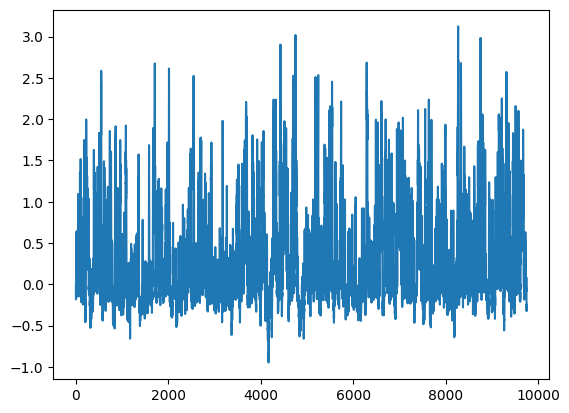

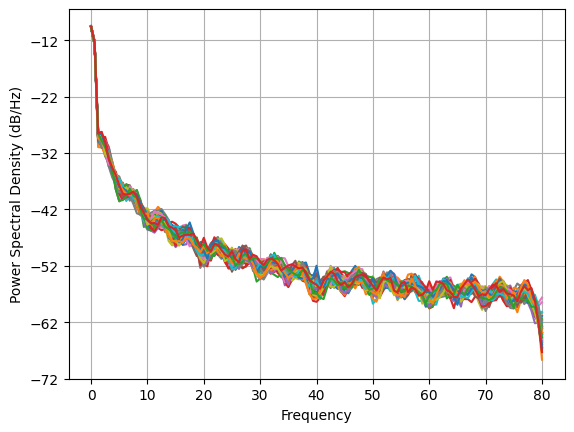

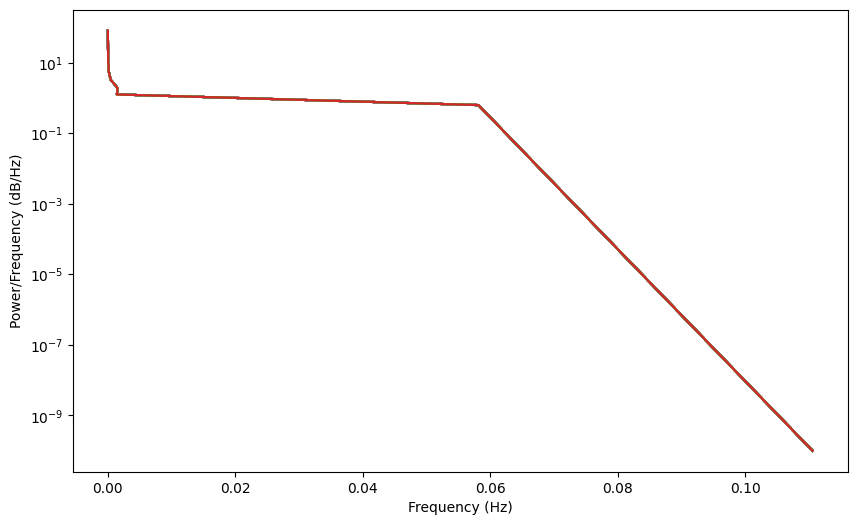

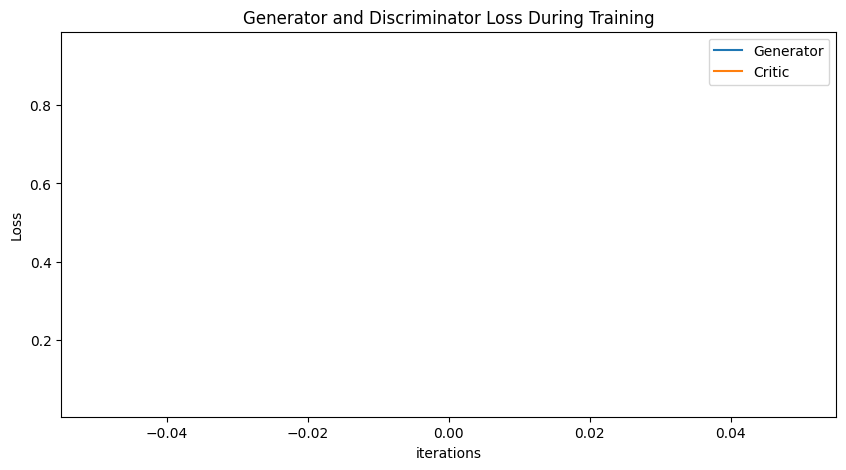

Epoch 10: Critic error ([0.94231070787466, 0.369181814513447, 0.3289887604870674, 0.4941267345625826, 0.21872300068356598, 0.38319712202123646, 0.5709589312031075, 0.5705251739520091, 0.32707255530512724, 0.6388877891069119, 0.6186505702573131]) Generator err ([0.049831878393888474, -0.18126577138900757, -0.22209730744361877, -0.30555859208106995, -0.041823193430900574, -0.2147442251443863, -0.2960839569568634, -0.2837845981121063, -0.13312257826328278, -0.33178362250328064, -0.34094661474227905])


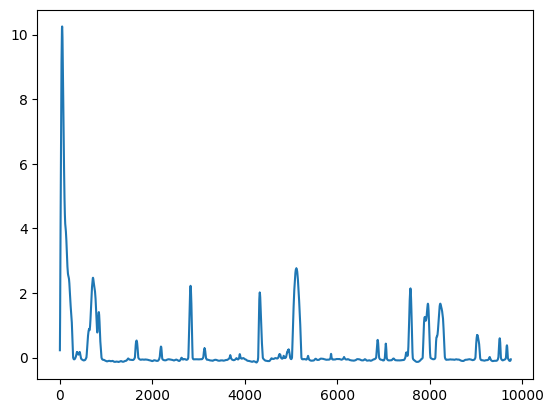

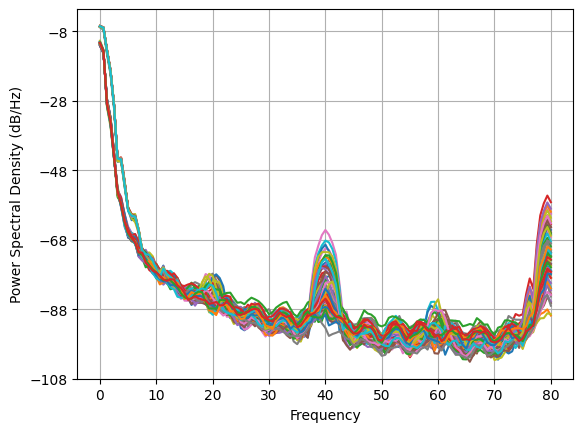

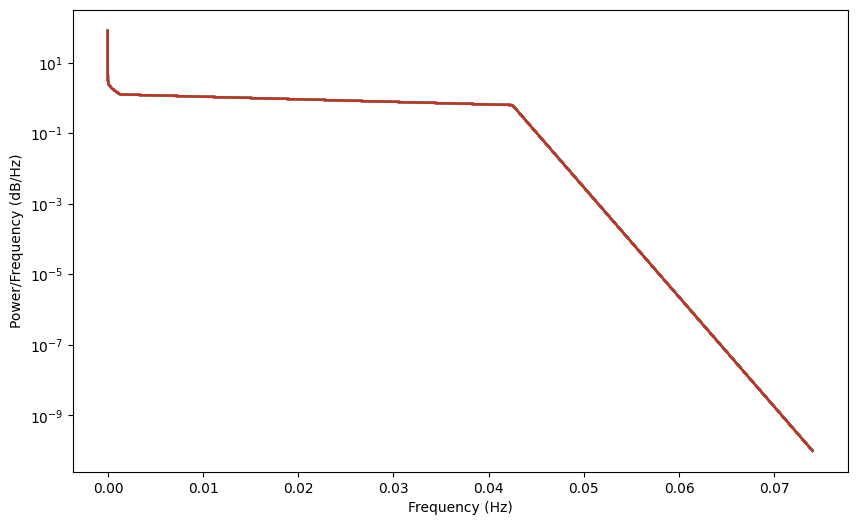

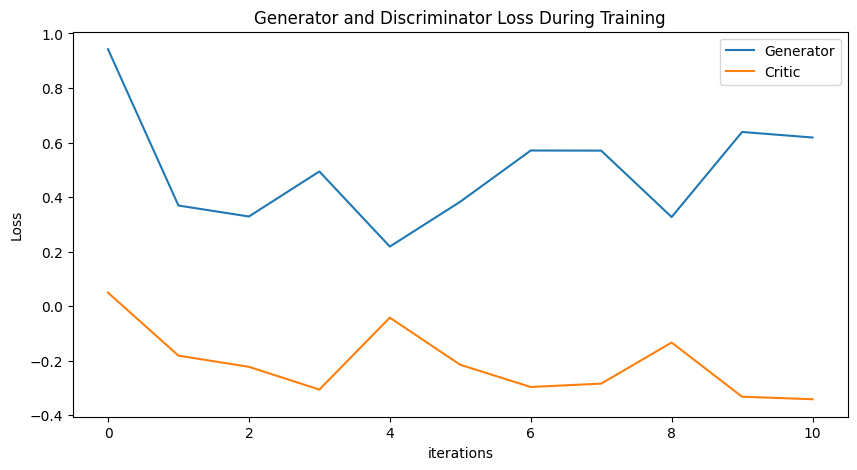

Epoch 20: Critic error ([0.94231070787466, 0.369181814513447, 0.3289887604870674, 0.4941267345625826, 0.21872300068356598, 0.38319712202123646, 0.5709589312031075, 0.5705251739520091, 0.32707255530512724, 0.6388877891069119, 0.6186505702573131, 0.6374394302365118, 0.4569801616623107, 0.33007392096408905, 0.29888773252300443, 0.45335293301451396, 0.39689713261741644, 0.5084071679752777, 0.24296961673044623, 0.2565138905419401, 0.24109623949180664]) Generator err ([0.049831878393888474, -0.18126577138900757, -0.22209730744361877, -0.30555859208106995, -0.041823193430900574, -0.2147442251443863, -0.2960839569568634, -0.2837845981121063, -0.13312257826328278, -0.33178362250328064, -0.34094661474227905, -0.3510991930961609, -0.20366044342517853, -0.10685563087463379, -0.043578073382377625, -0.13041861355304718, -0.0667278990149498, -0.10799891501665115, 0.020959002897143364, 0.10712314397096634, 0.16305629909038544])


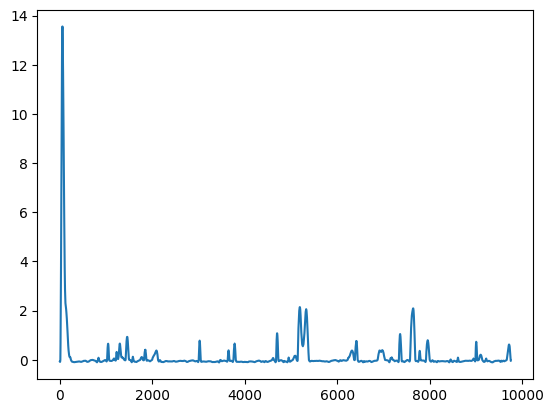

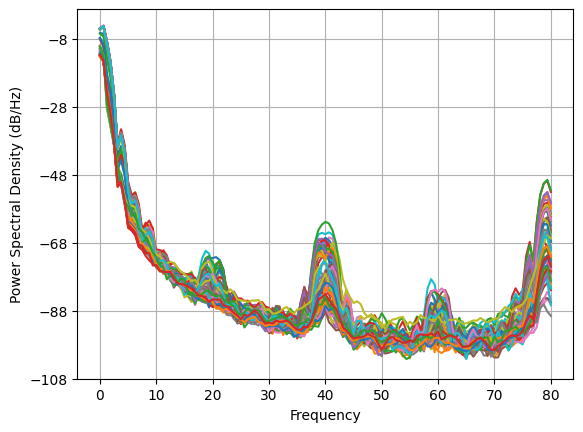

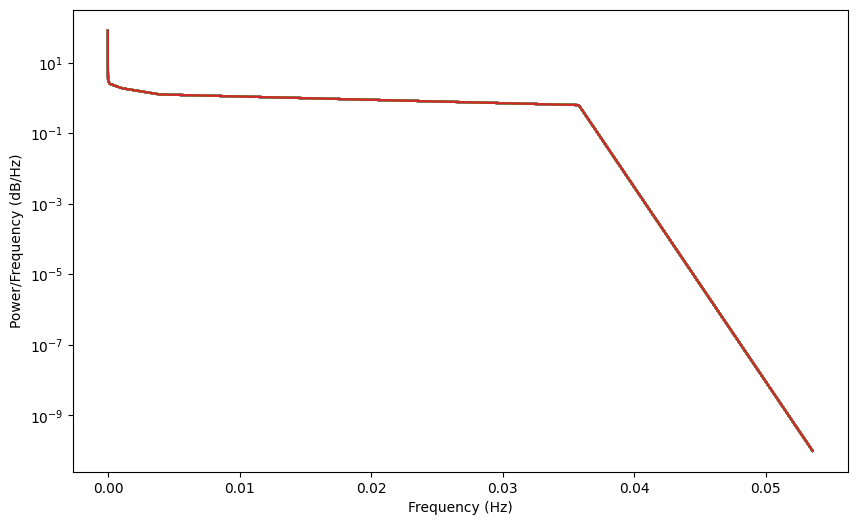

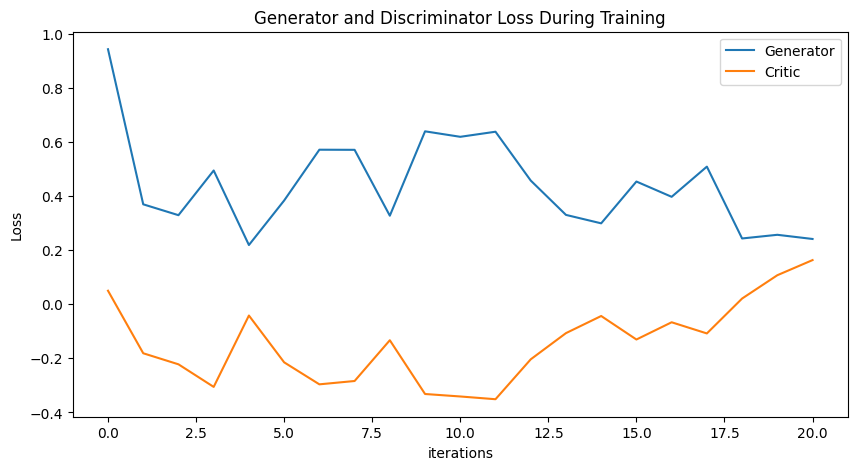

Epoch 30: Critic error ([0.94231070787466, 0.369181814513447, 0.3289887604870674, 0.4941267345625826, 0.21872300068356598, 0.38319712202123646, 0.5709589312031075, 0.5705251739520091, 0.32707255530512724, 0.6388877891069119, 0.6186505702573131, 0.6374394302365118, 0.4569801616623107, 0.33007392096408905, 0.29888773252300443, 0.45335293301451396, 0.39689713261741644, 0.5084071679752777, 0.24296961673044623, 0.2565138905419401, 0.24109623949180664, 0.18080984973567926, 0.1436387228806117, 0.4145900140288542, 0.35605035141883773, 0.0616813166380043, 0.218890907704274, 0.25524456413388125, 0.11037034918998309, 0.04883549201076566, -0.0015766085466065727]) Generator err ([0.049831878393888474, -0.18126577138900757, -0.22209730744361877, -0.30555859208106995, -0.041823193430900574, -0.2147442251443863, -0.2960839569568634, -0.2837845981121063, -0.13312257826328278, -0.33178362250328064, -0.34094661474227905, -0.3510991930961609, -0.20366044342517853, -0.10685563087463379, -0.0435780733823776

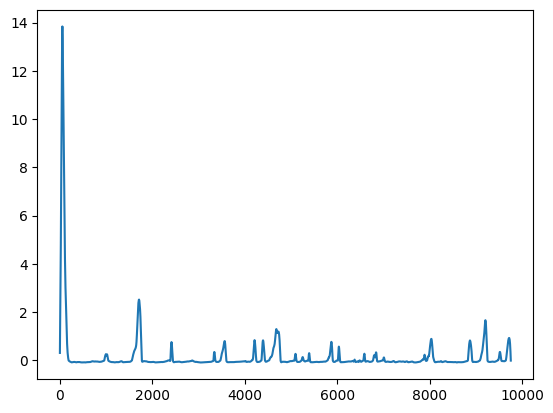

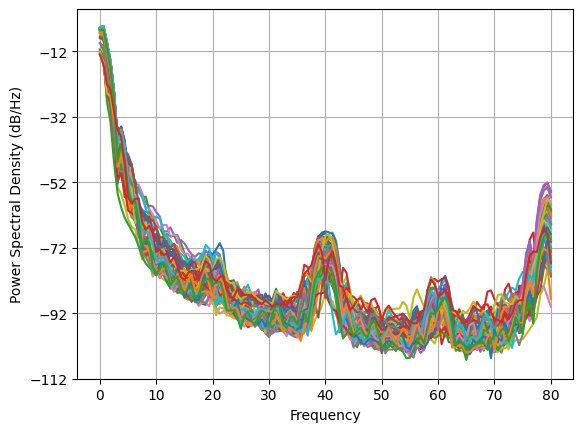

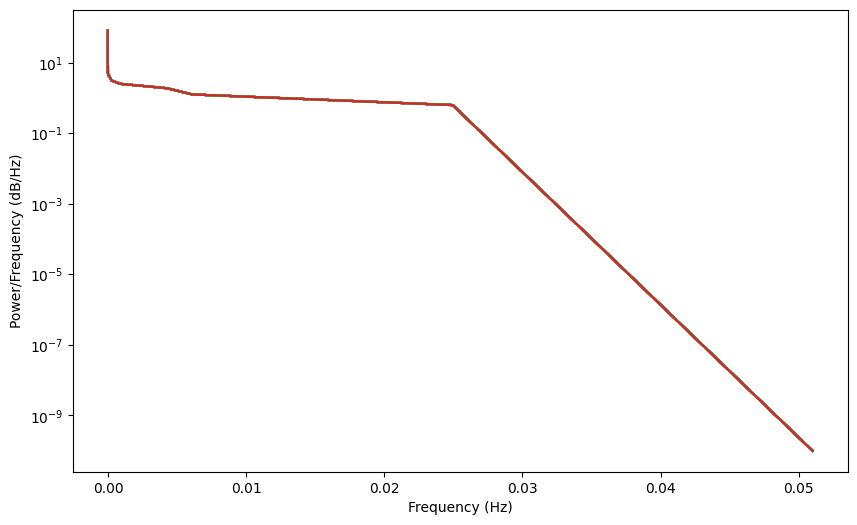

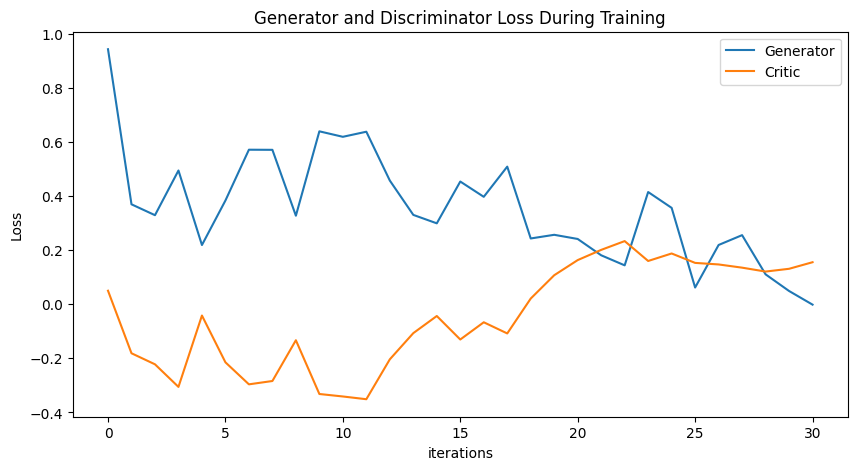

Epoch 40: Critic error ([0.94231070787466, 0.369181814513447, 0.3289887604870674, 0.4941267345625826, 0.21872300068356598, 0.38319712202123646, 0.5709589312031075, 0.5705251739520091, 0.32707255530512724, 0.6388877891069119, 0.6186505702573131, 0.6374394302365118, 0.4569801616623107, 0.33007392096408905, 0.29888773252300443, 0.45335293301451396, 0.39689713261741644, 0.5084071679752777, 0.24296961673044623, 0.2565138905419401, 0.24109623949180664, 0.18080984973567926, 0.1436387228806117, 0.4145900140288542, 0.35605035141883773, 0.0616813166380043, 0.218890907704274, 0.25524456413388125, 0.11037034918998309, 0.04883549201076566, -0.0015766085466065727, 0.024793924240147924, -0.09287206918901308, -0.09170397516778539, -0.2046766109913099, -0.2238980792999306, -0.3249462455474432, -0.4591052325269224, -0.7974590646716815, -0.8713906627426978, -1.0627688776830242]) Generator err ([0.049831878393888474, -0.18126577138900757, -0.22209730744361877, -0.30555859208106995, -0.041823193430900574, 

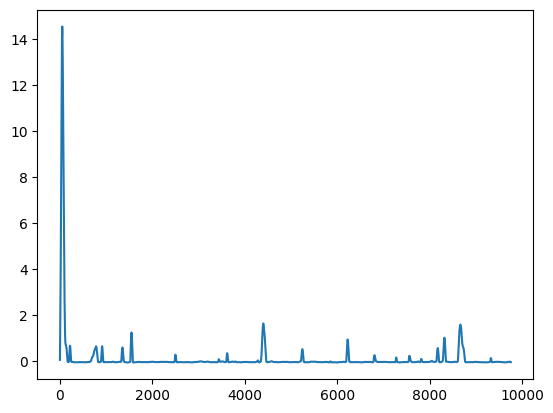

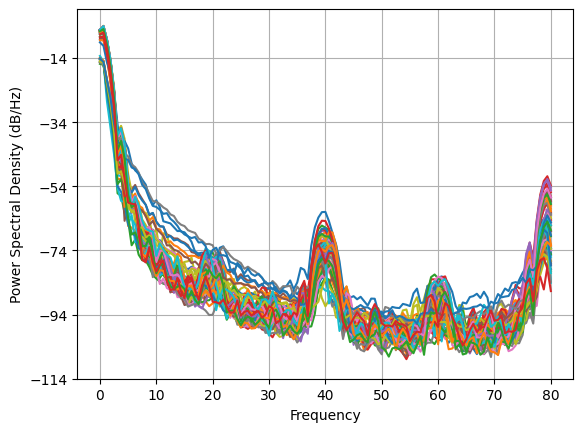

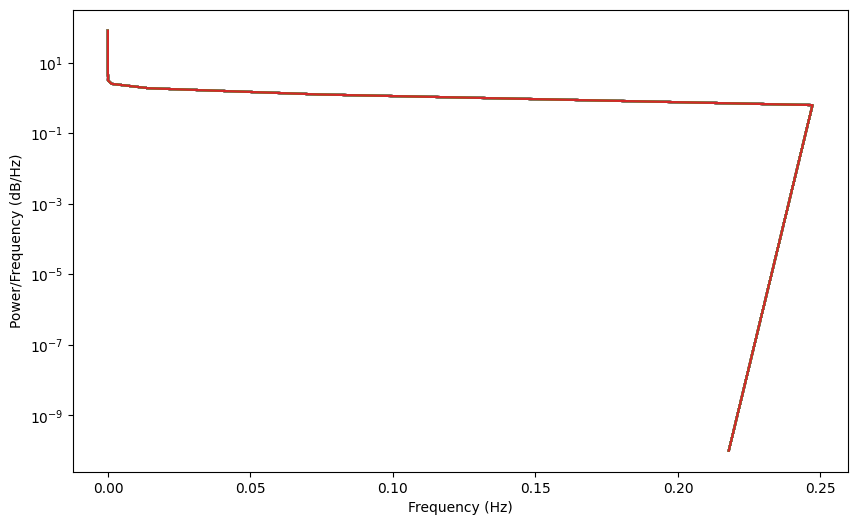

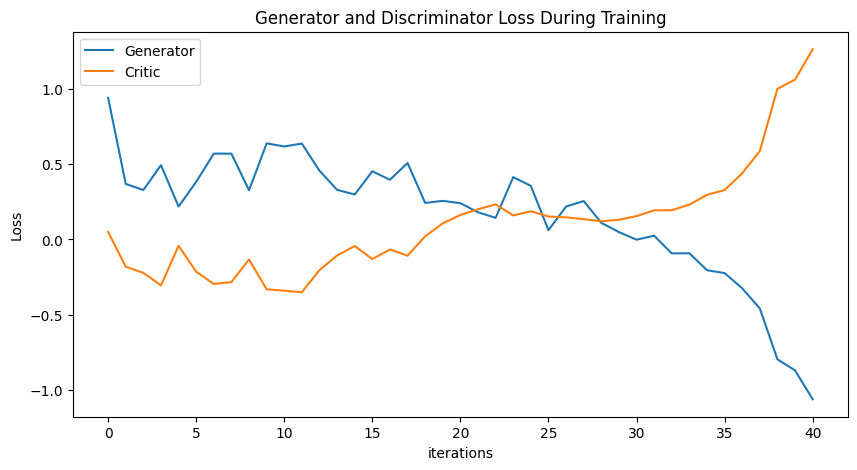

Epoch 50: Critic error ([0.94231070787466, 0.369181814513447, 0.3289887604870674, 0.4941267345625826, 0.21872300068356598, 0.38319712202123646, 0.5709589312031075, 0.5705251739520091, 0.32707255530512724, 0.6388877891069119, 0.6186505702573131, 0.6374394302365118, 0.4569801616623107, 0.33007392096408905, 0.29888773252300443, 0.45335293301451396, 0.39689713261741644, 0.5084071679752777, 0.24296961673044623, 0.2565138905419401, 0.24109623949180664, 0.18080984973567926, 0.1436387228806117, 0.4145900140288542, 0.35605035141883773, 0.0616813166380043, 0.218890907704274, 0.25524456413388125, 0.11037034918998309, 0.04883549201076566, -0.0015766085466065727, 0.024793924240147924, -0.09287206918901308, -0.09170397516778539, -0.2046766109913099, -0.2238980792999306, -0.3249462455474432, -0.4591052325269224, -0.7974590646716815, -0.8713906627426978, -1.0627688776830242, -1.4318141376270859, -2.1110331633455135, -2.235952123189871, -2.7268593524926668, -1.9291597408751893, -1.36855299506188, -1.65

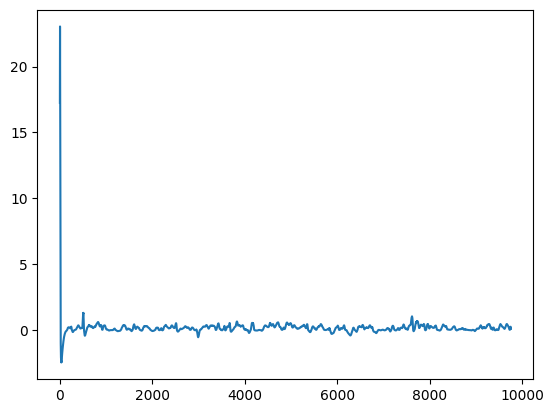

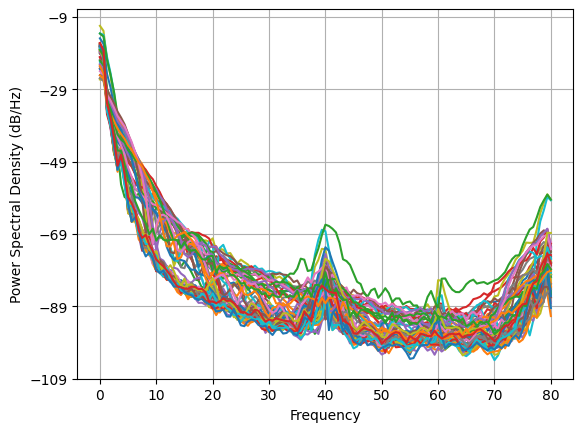

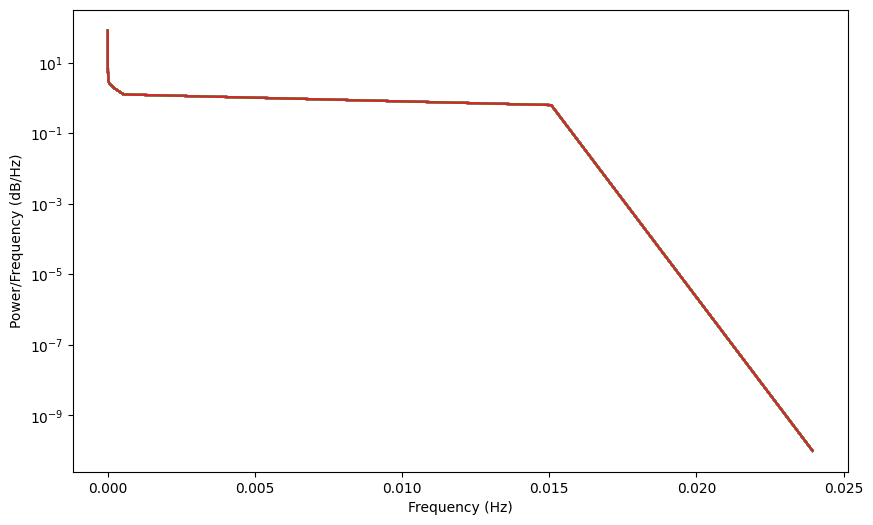

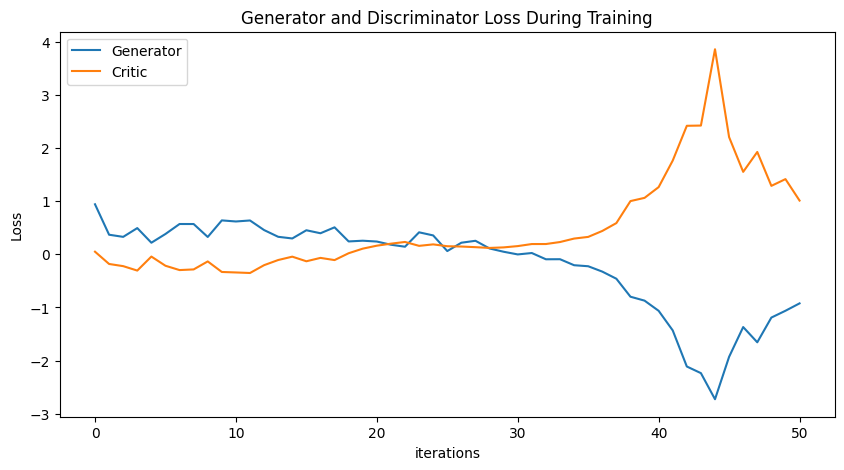

Epoch 60: Critic error ([0.94231070787466, 0.369181814513447, 0.3289887604870674, 0.4941267345625826, 0.21872300068356598, 0.38319712202123646, 0.5709589312031075, 0.5705251739520091, 0.32707255530512724, 0.6388877891069119, 0.6186505702573131, 0.6374394302365118, 0.4569801616623107, 0.33007392096408905, 0.29888773252300443, 0.45335293301451396, 0.39689713261741644, 0.5084071679752777, 0.24296961673044623, 0.2565138905419401, 0.24109623949180664, 0.18080984973567926, 0.1436387228806117, 0.4145900140288542, 0.35605035141883773, 0.0616813166380043, 0.218890907704274, 0.25524456413388125, 0.11037034918998309, 0.04883549201076566, -0.0015766085466065727, 0.024793924240147924, -0.09287206918901308, -0.09170397516778539, -0.2046766109913099, -0.2238980792999306, -0.3249462455474432, -0.4591052325269224, -0.7974590646716815, -0.8713906627426978, -1.0627688776830242, -1.4318141376270859, -2.1110331633455135, -2.235952123189871, -2.7268593524926668, -1.9291597408751893, -1.36855299506188, -1.65

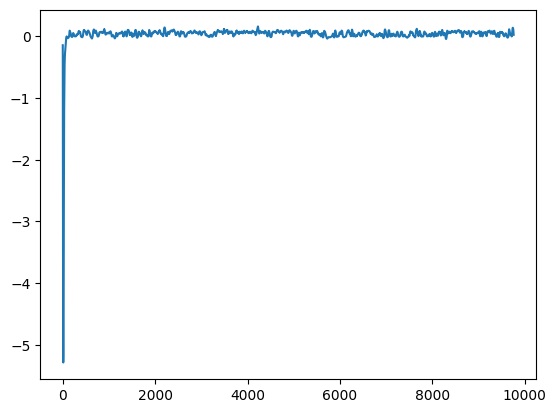

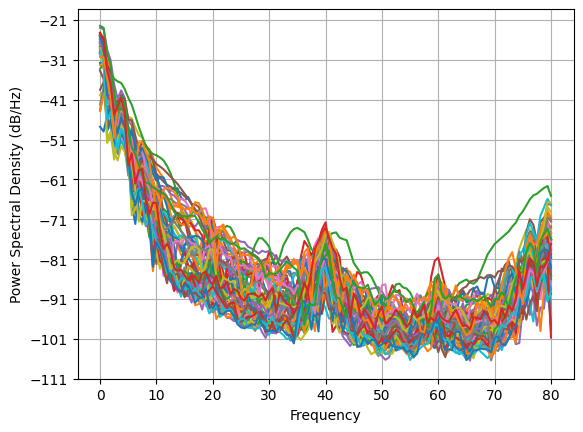

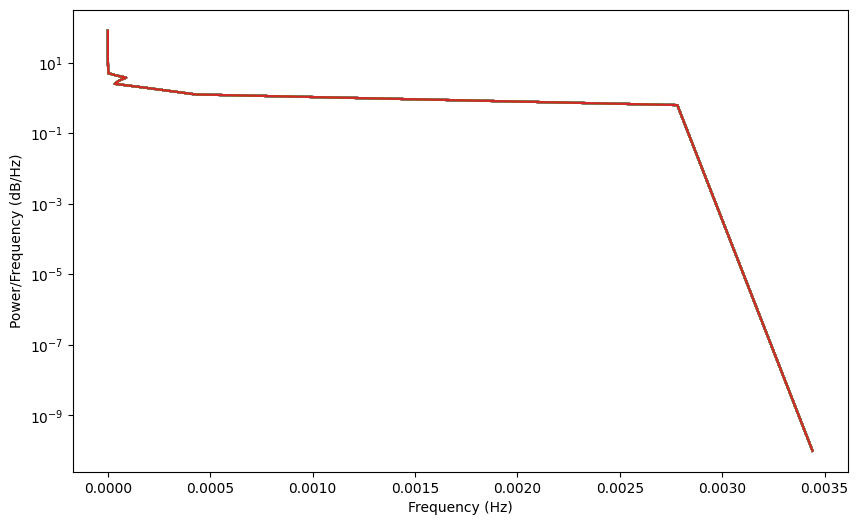

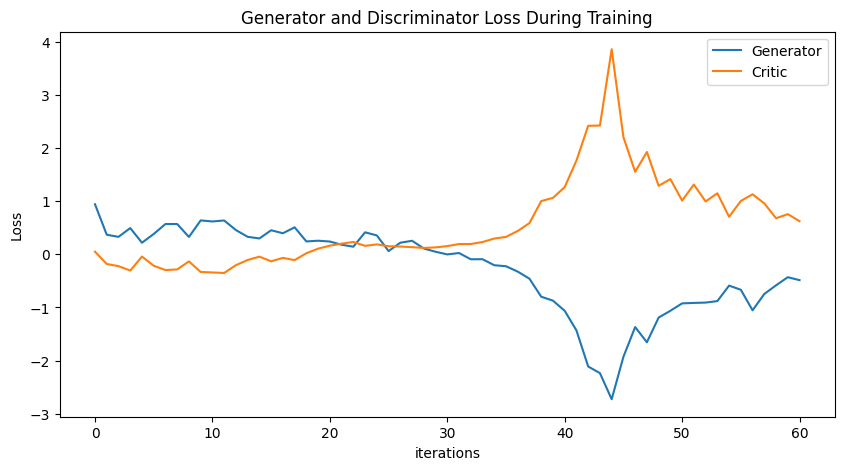

Epoch 70: Critic error ([0.94231070787466, 0.369181814513447, 0.3289887604870674, 0.4941267345625826, 0.21872300068356598, 0.38319712202123646, 0.5709589312031075, 0.5705251739520091, 0.32707255530512724, 0.6388877891069119, 0.6186505702573131, 0.6374394302365118, 0.4569801616623107, 0.33007392096408905, 0.29888773252300443, 0.45335293301451396, 0.39689713261741644, 0.5084071679752777, 0.24296961673044623, 0.2565138905419401, 0.24109623949180664, 0.18080984973567926, 0.1436387228806117, 0.4145900140288542, 0.35605035141883773, 0.0616813166380043, 0.218890907704274, 0.25524456413388125, 0.11037034918998309, 0.04883549201076566, -0.0015766085466065727, 0.024793924240147924, -0.09287206918901308, -0.09170397516778539, -0.2046766109913099, -0.2238980792999306, -0.3249462455474432, -0.4591052325269224, -0.7974590646716815, -0.8713906627426978, -1.0627688776830242, -1.4318141376270859, -2.1110331633455135, -2.235952123189871, -2.7268593524926668, -1.9291597408751893, -1.36855299506188, -1.65

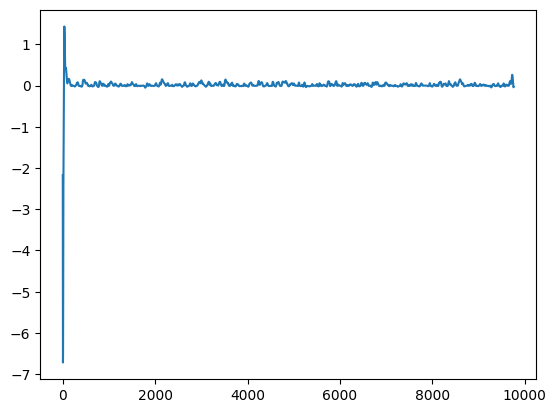

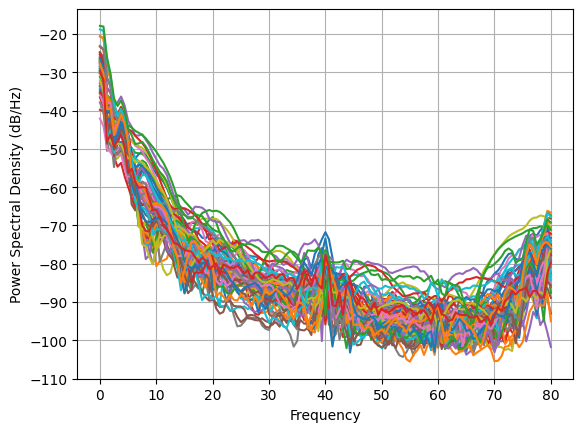

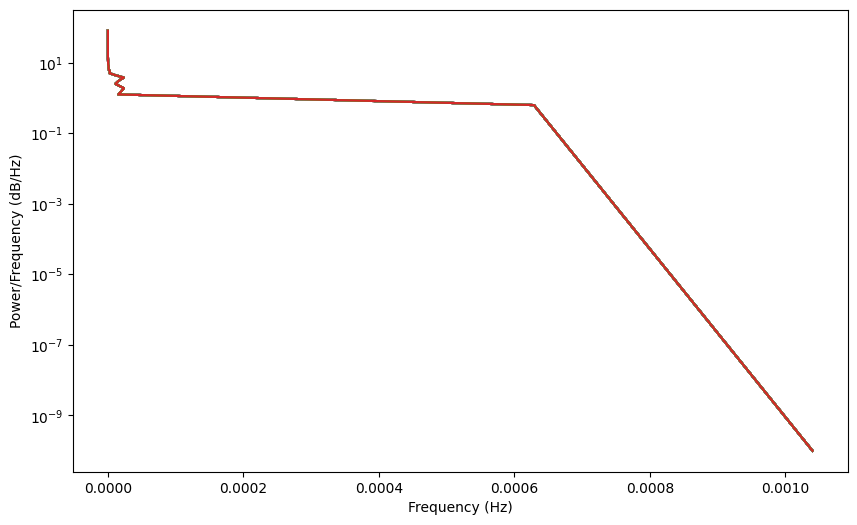

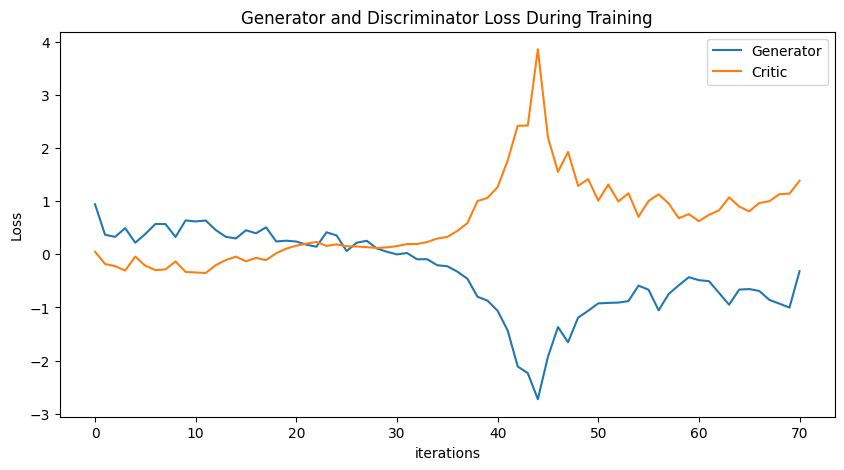

Epoch 80: Critic error ([0.94231070787466, 0.369181814513447, 0.3289887604870674, 0.4941267345625826, 0.21872300068356598, 0.38319712202123646, 0.5709589312031075, 0.5705251739520091, 0.32707255530512724, 0.6388877891069119, 0.6186505702573131, 0.6374394302365118, 0.4569801616623107, 0.33007392096408905, 0.29888773252300443, 0.45335293301451396, 0.39689713261741644, 0.5084071679752777, 0.24296961673044623, 0.2565138905419401, 0.24109623949180664, 0.18080984973567926, 0.1436387228806117, 0.4145900140288542, 0.35605035141883773, 0.0616813166380043, 0.218890907704274, 0.25524456413388125, 0.11037034918998309, 0.04883549201076566, -0.0015766085466065727, 0.024793924240147924, -0.09287206918901308, -0.09170397516778539, -0.2046766109913099, -0.2238980792999306, -0.3249462455474432, -0.4591052325269224, -0.7974590646716815, -0.8713906627426978, -1.0627688776830242, -1.4318141376270859, -2.1110331633455135, -2.235952123189871, -2.7268593524926668, -1.9291597408751893, -1.36855299506188, -1.65

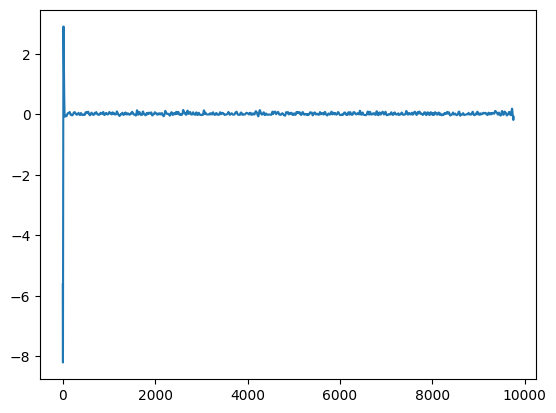

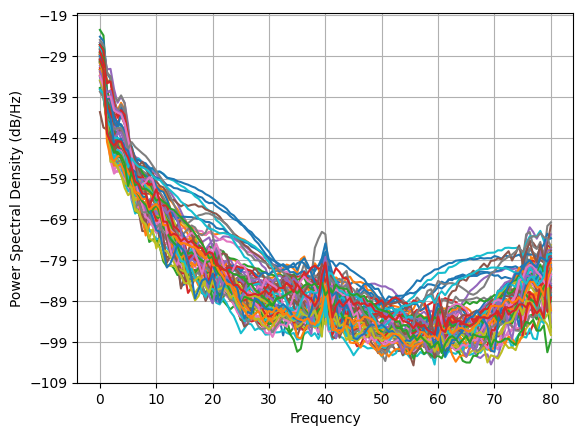

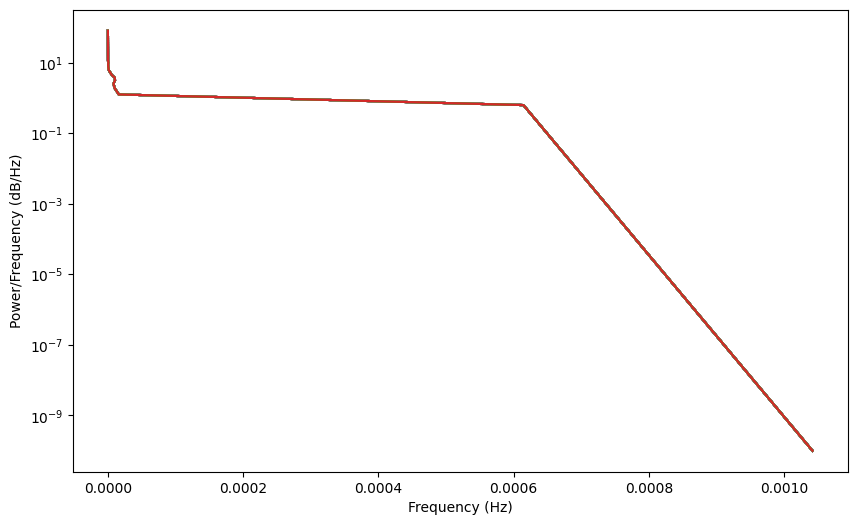

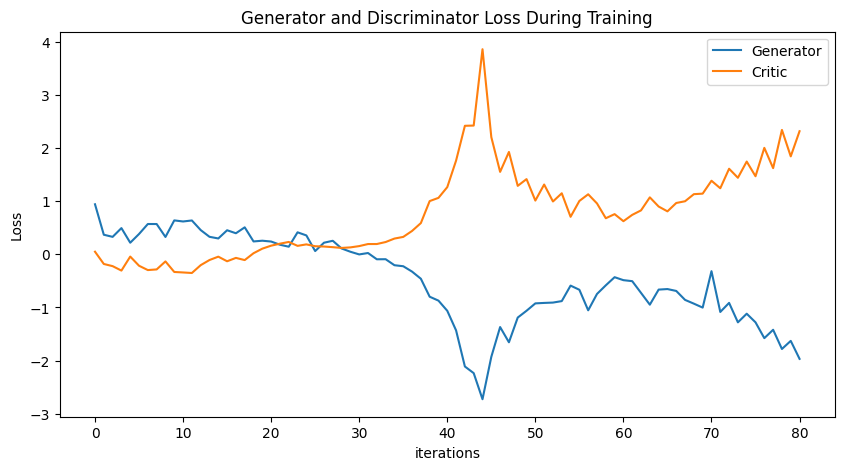

Epoch 90: Critic error ([0.94231070787466, 0.369181814513447, 0.3289887604870674, 0.4941267345625826, 0.21872300068356598, 0.38319712202123646, 0.5709589312031075, 0.5705251739520091, 0.32707255530512724, 0.6388877891069119, 0.6186505702573131, 0.6374394302365118, 0.4569801616623107, 0.33007392096408905, 0.29888773252300443, 0.45335293301451396, 0.39689713261741644, 0.5084071679752777, 0.24296961673044623, 0.2565138905419401, 0.24109623949180664, 0.18080984973567926, 0.1436387228806117, 0.4145900140288542, 0.35605035141883773, 0.0616813166380043, 0.218890907704274, 0.25524456413388125, 0.11037034918998309, 0.04883549201076566, -0.0015766085466065727, 0.024793924240147924, -0.09287206918901308, -0.09170397516778539, -0.2046766109913099, -0.2238980792999306, -0.3249462455474432, -0.4591052325269224, -0.7974590646716815, -0.8713906627426978, -1.0627688776830242, -1.4318141376270859, -2.1110331633455135, -2.235952123189871, -2.7268593524926668, -1.9291597408751893, -1.36855299506188, -1.65

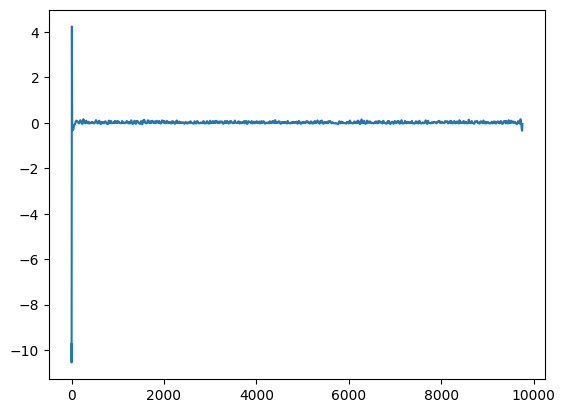

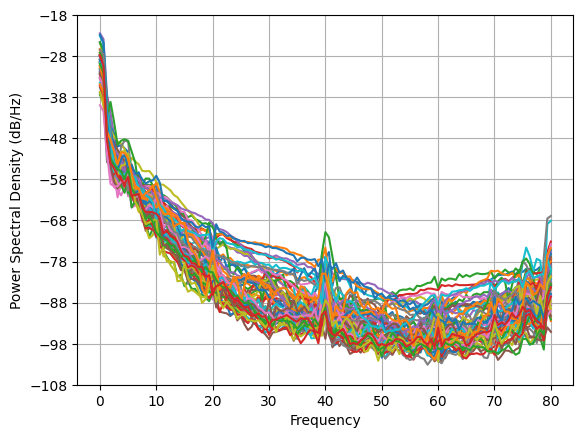

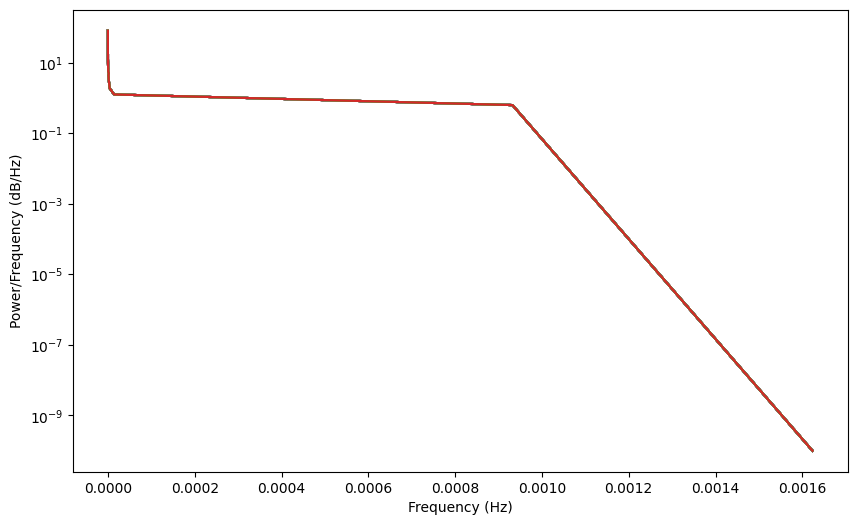

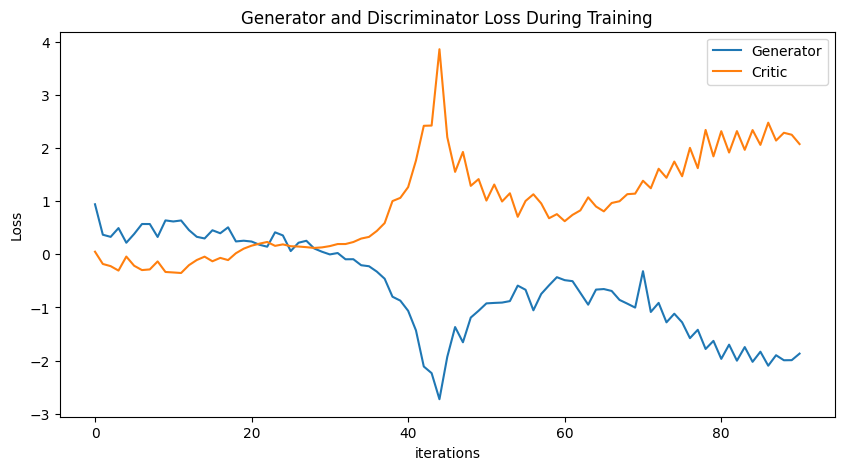

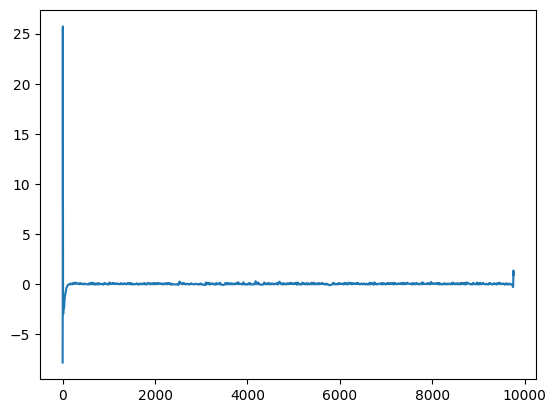

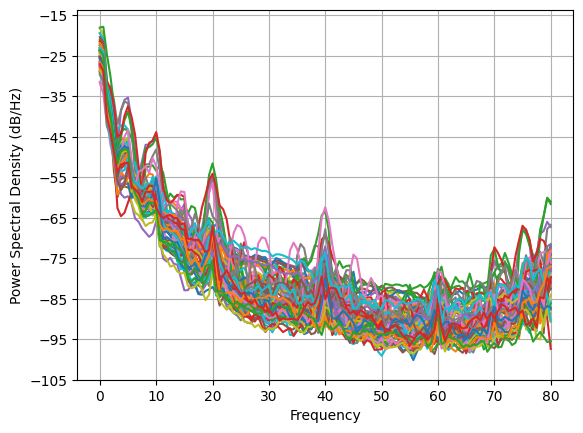

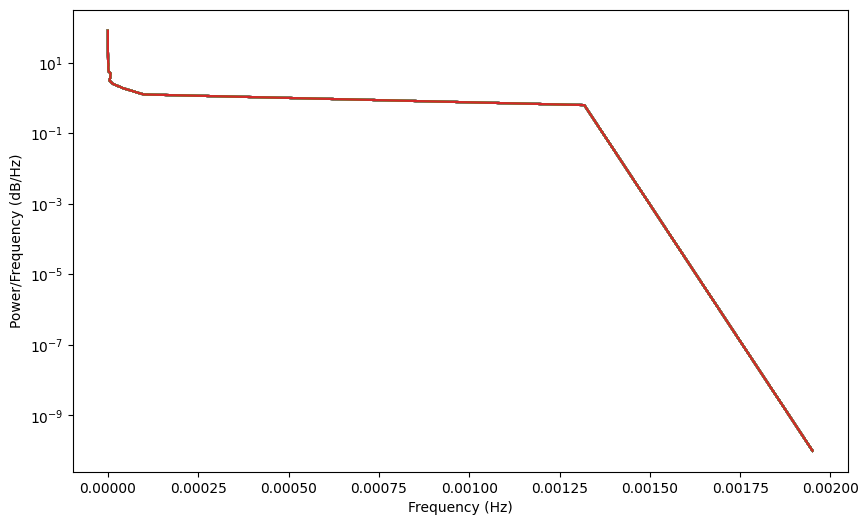

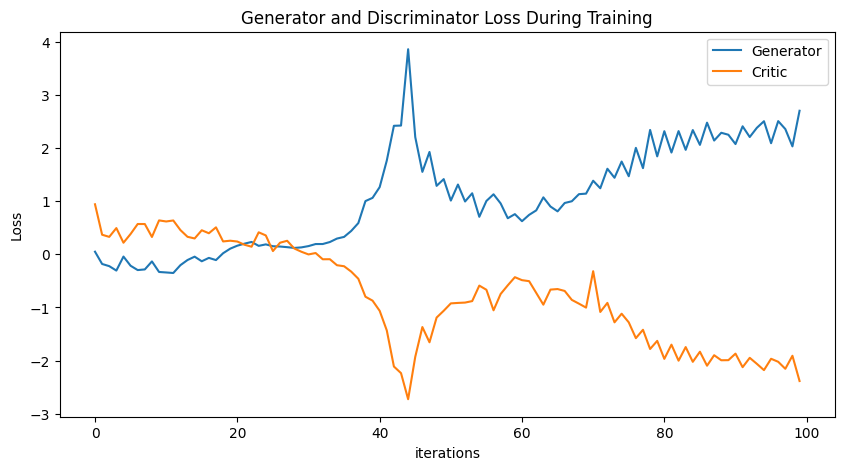

In [10]:
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
training_data = torch.tensor(np.load('training_open.npy'))
BATCH_SIZE = np.shape(training_data)[0]

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 640, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1)
            critic_fake = D(fake).reshape(-1)
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()
            critic_optimizer.zero_grad()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        gen_optimizer.zero_grad()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(generated_data, critic_err, gen_err)

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data_open, disc, gen = train()

torch.save(gen, 'gen_FINAL1_open.pt')
torch.save(disc, 'disc_FINAL1_open.pt')
np.save('complex-open.npy', generated_data_open.detach())
plot_everything(generated_data_open, gen_err, critic_err)
generated_data_open = None

# Closed 

Epoch 0: Critic error ([0.97843294517341]) Generator err ([-0.006950368173420429])


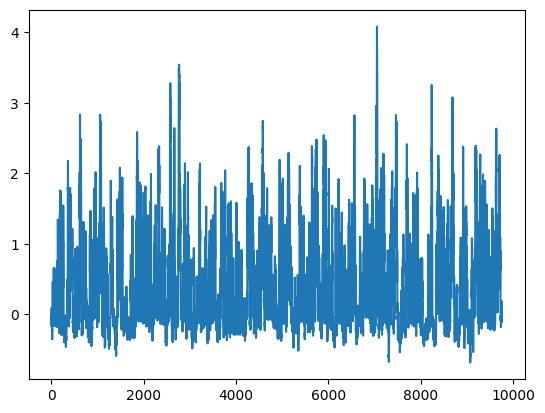

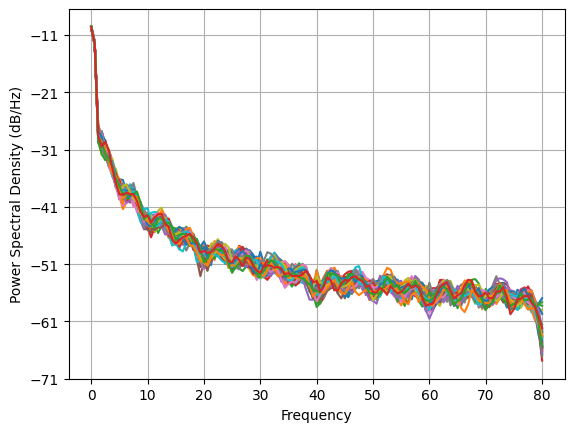

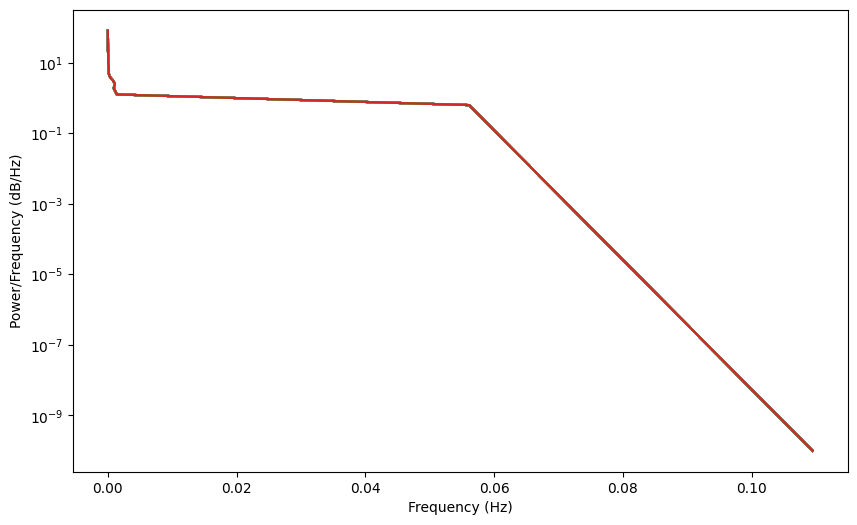

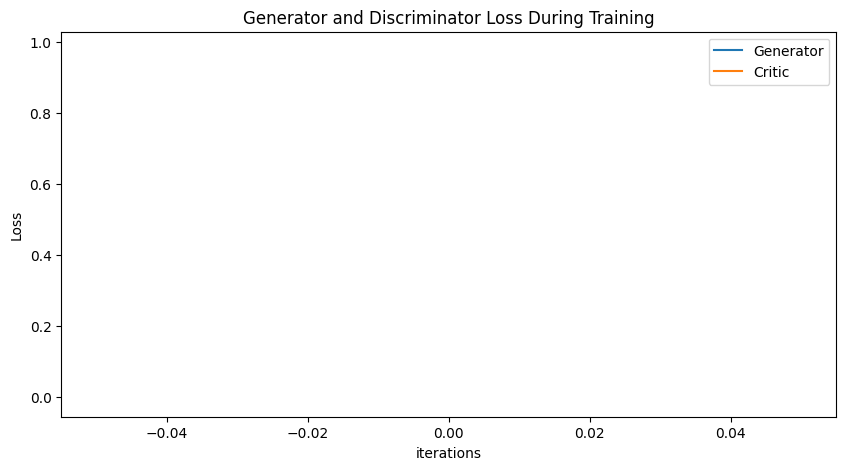

Epoch 10: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044]) Generator err ([-0.006950368173420429, -0.18932895362377167, -0.34385037422180176, -0.2585371434688568, -0.10859932750463486, -0.1888900250196457, -0.17536261677742004, -0.022552823647856712, -0.1486898958683014, -0.026217464357614517, -0.19596657156944275])


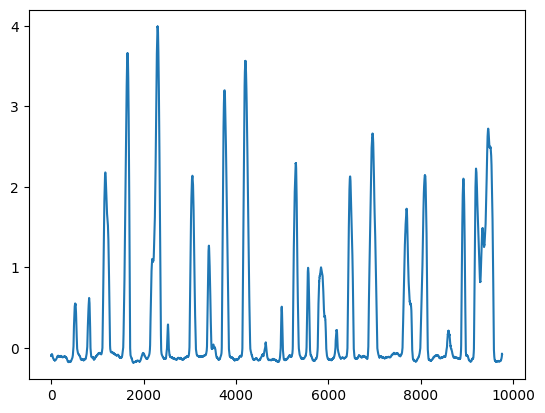

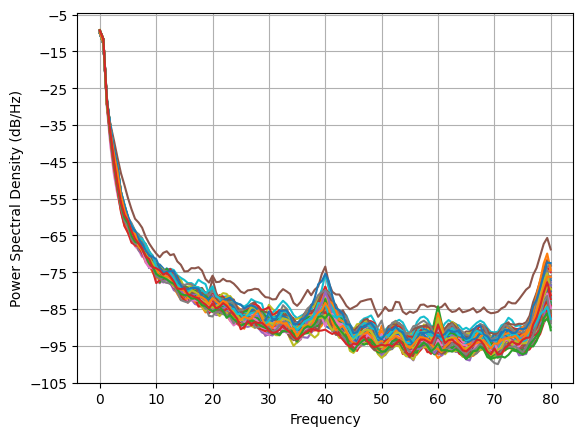

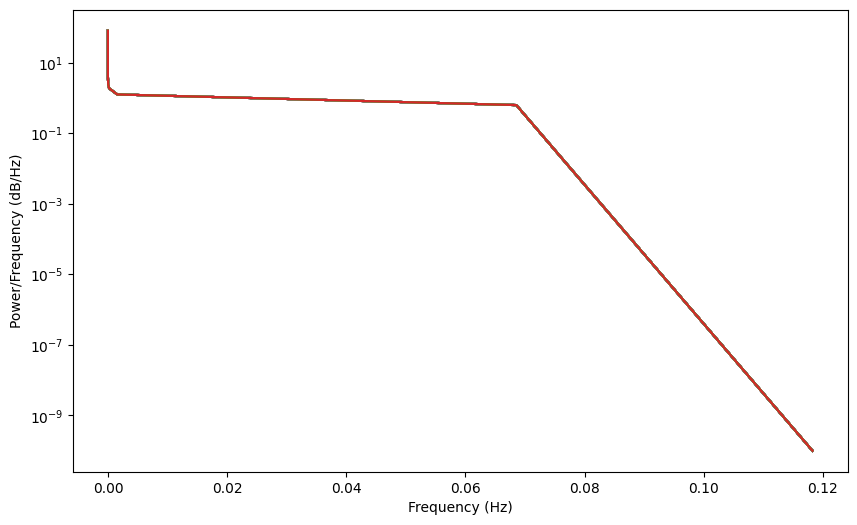

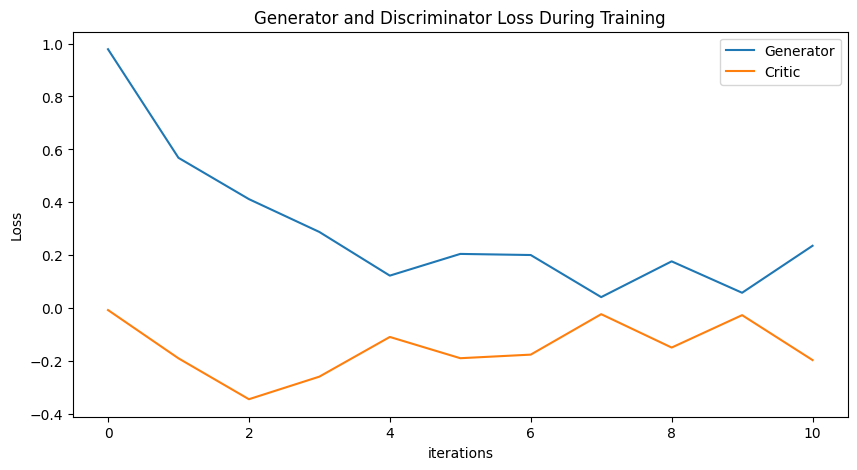

Epoch 20: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327]) Generator err ([-0.006950368173420429, -0.18932895362377167, -0.34385037422180176, -0.2585371434688568, -0.10859932750463486, -0.1888900250196457, -0.17536261677742004, -0.022552823647856712, -0.1486898958683014, -0.026217464357614517, -0.19596657156944275, 0.04941048473119736, 0.002525447169318795, 0.03322054073214531, -0.05979594960808754, 0.19380135834217072, 0.020345492288470268, 0.09433791041374207, 0.03655746579170227, 0.040663380175828934, 0.004408254288136959])


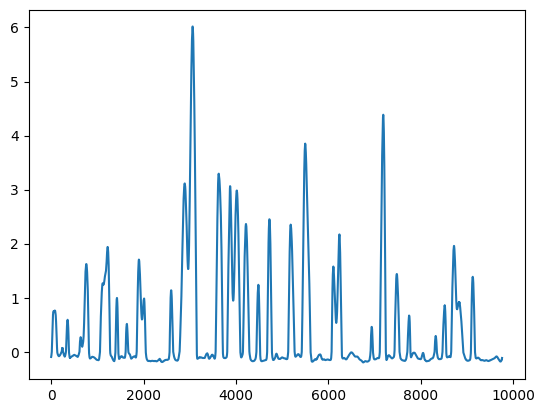

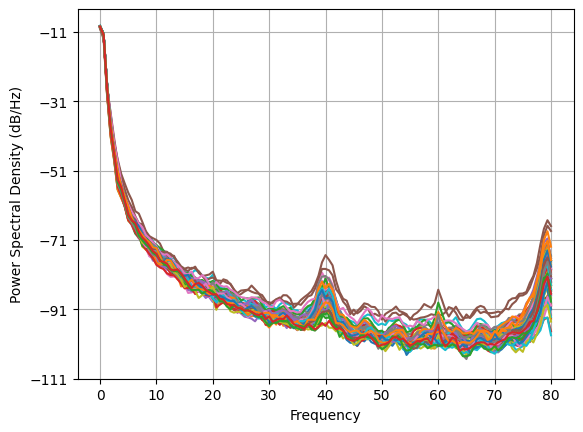

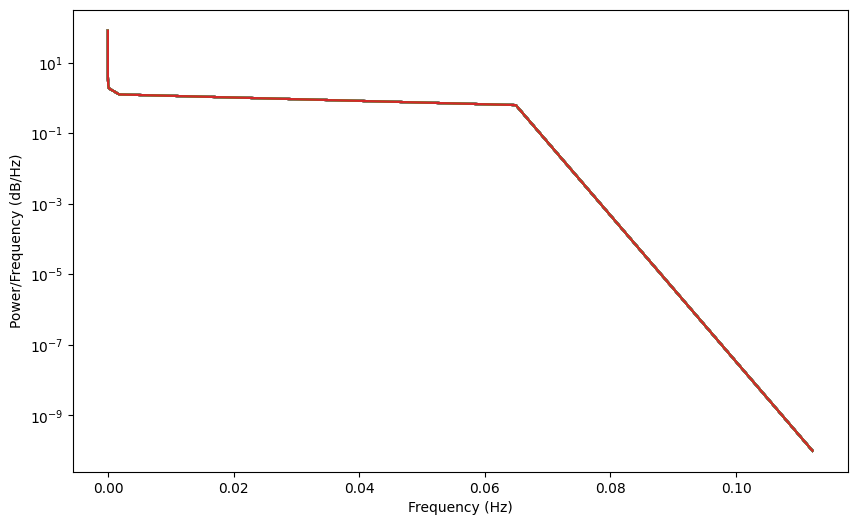

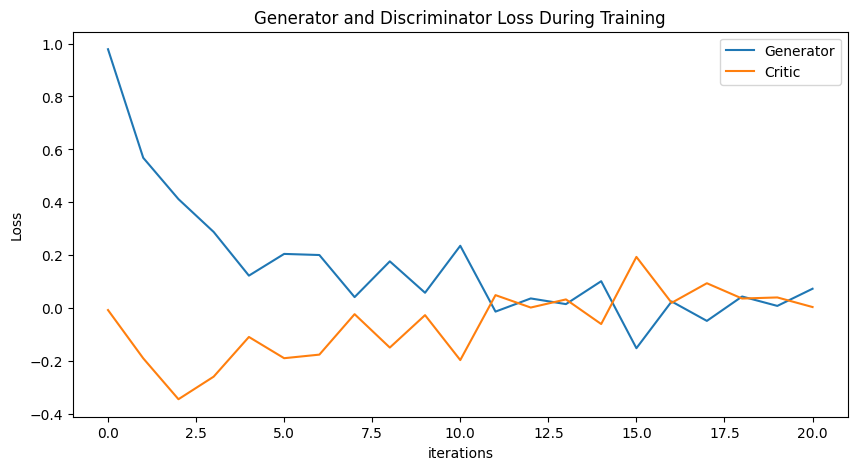

Epoch 30: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192]) Generator err ([-0.006950368173420429, -0.18932895362377167, -0.34385037422180176, -0.2585371434688568, -0.10859932750463486, -0.1888900250196457, -0.17536261677742004, -0.022552823647856712, -0.1486898958683014, -0.026217464357614517, -0.19596657156944275, 0.04941048473119736, 0.002525447169318795, 0.0332205407

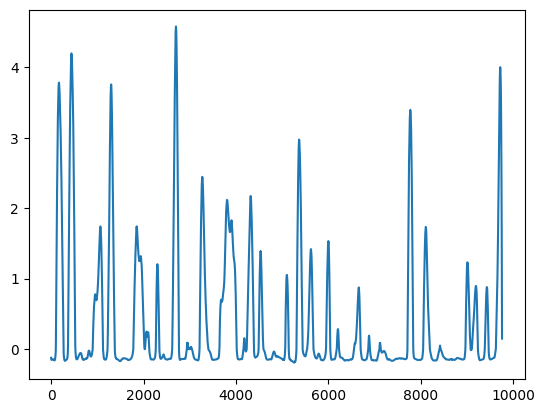

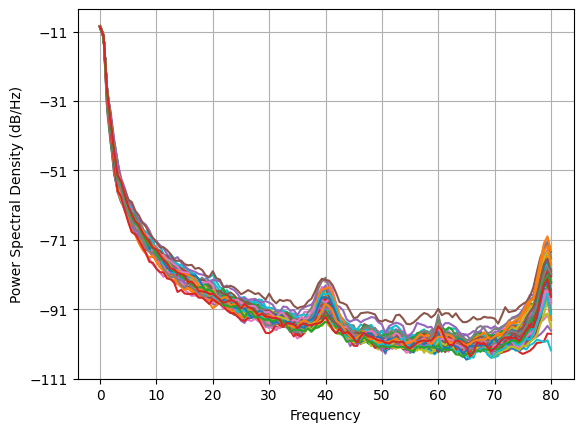

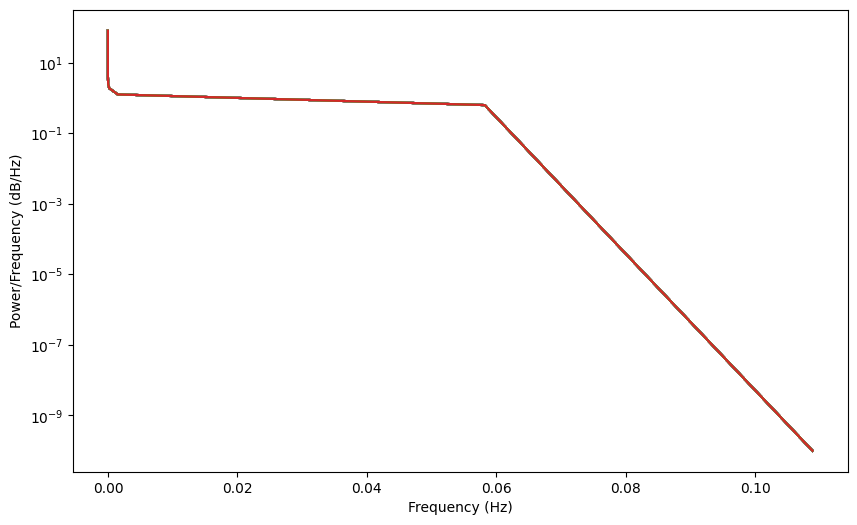

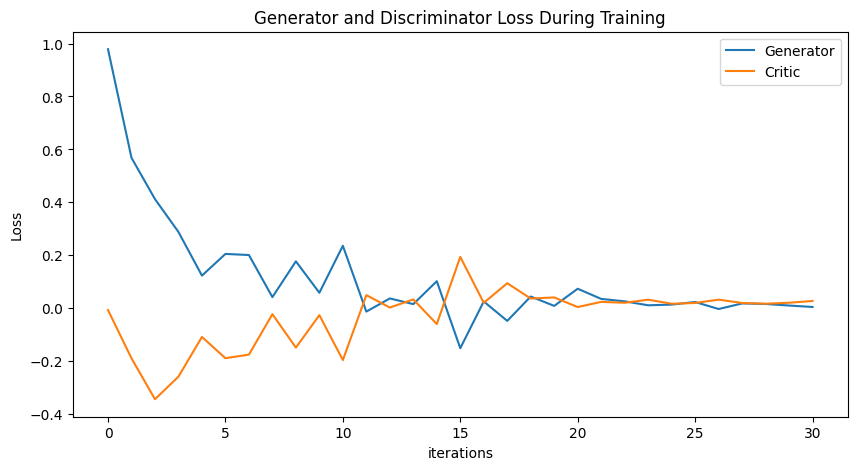

Epoch 40: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649]) Generator err ([-0.006950368173420429, -0.18932895362377167, -0.34385037422180176, -0.258537143

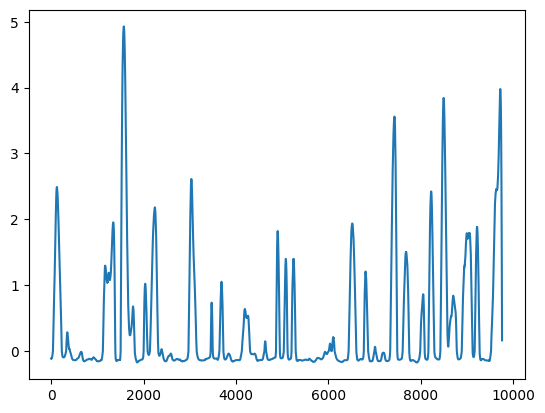

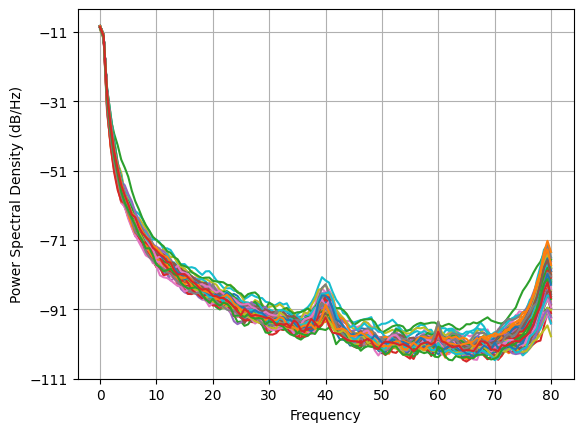

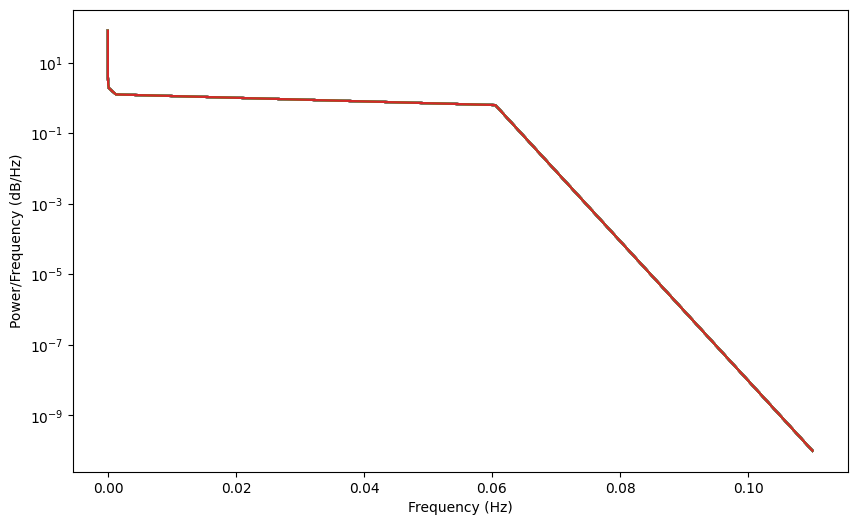

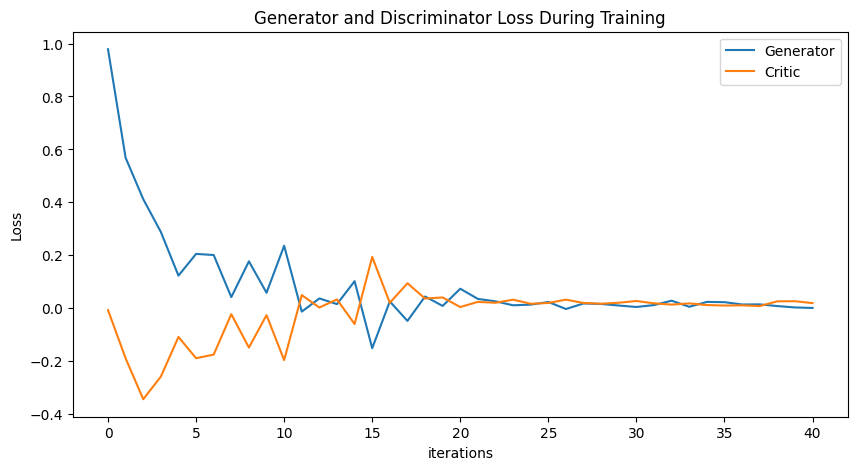

Epoch 50: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.017

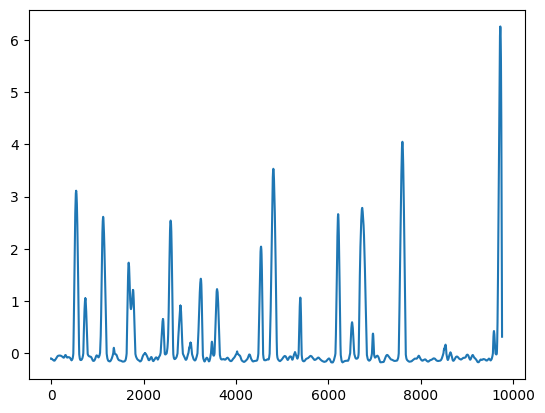

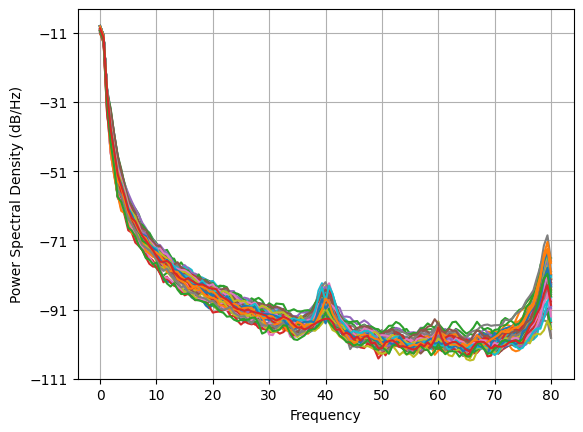

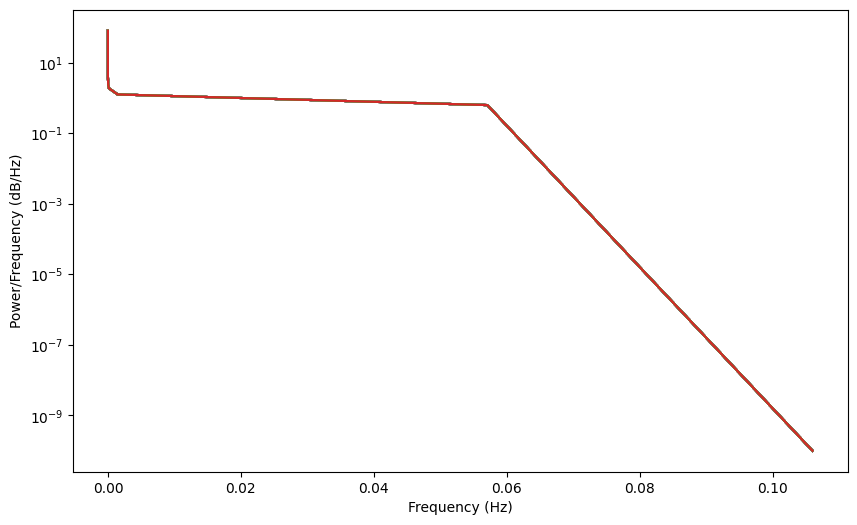

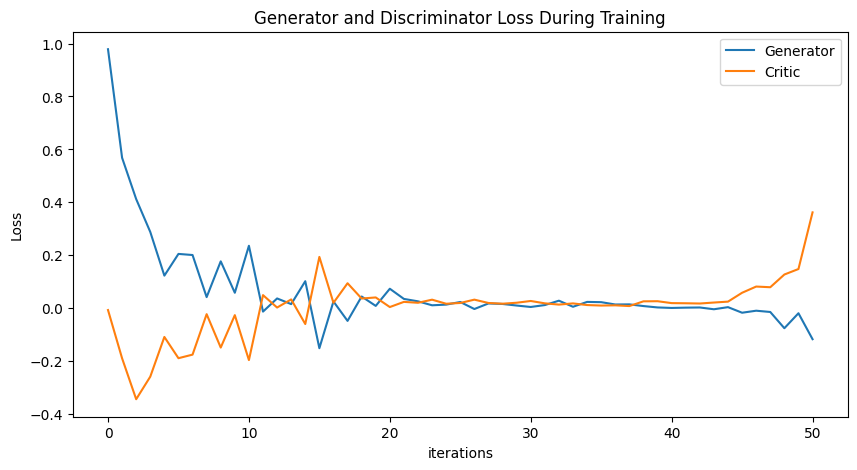

Epoch 60: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.017

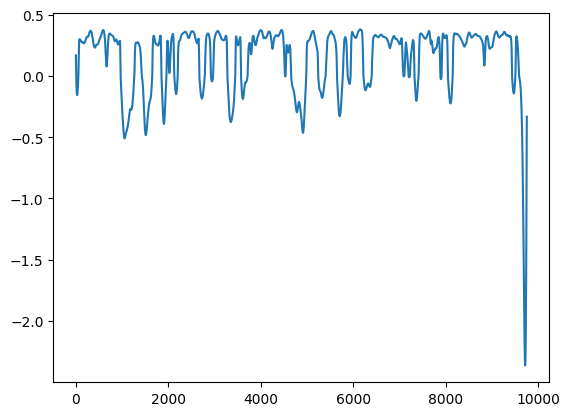

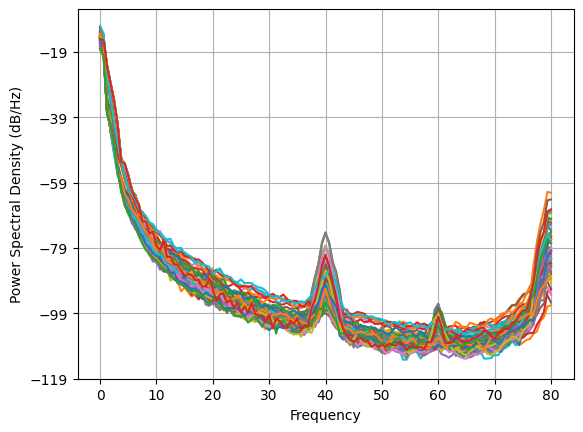

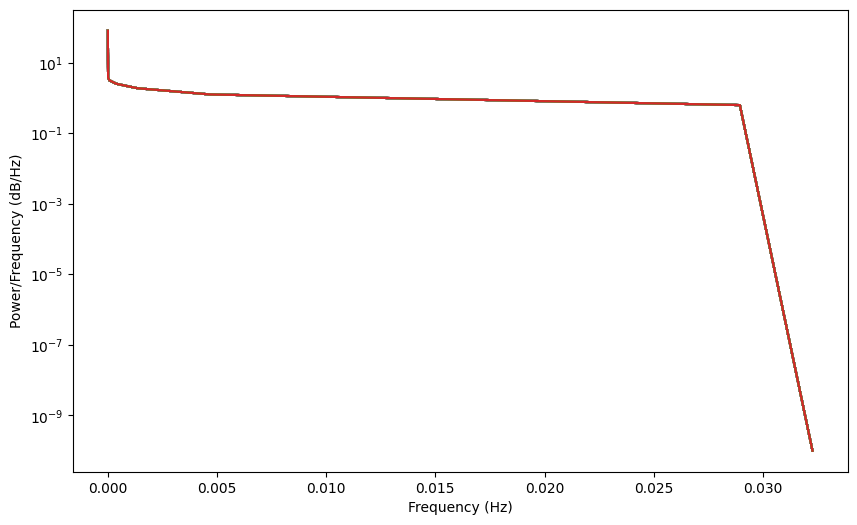

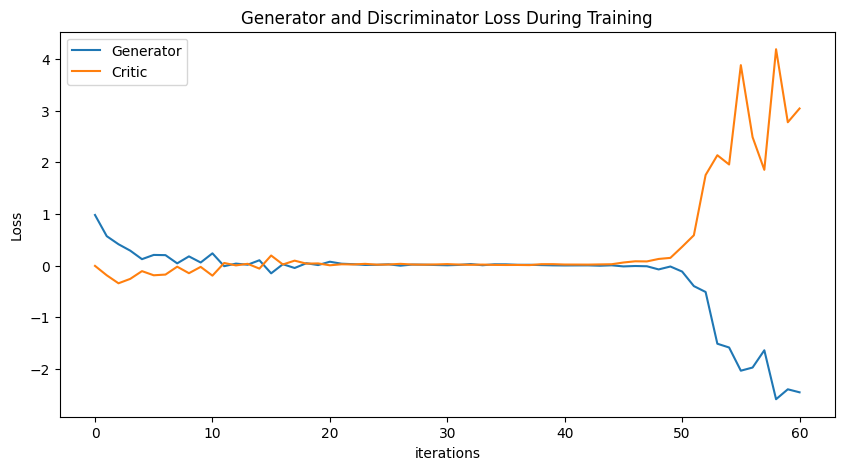

Epoch 70: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.017

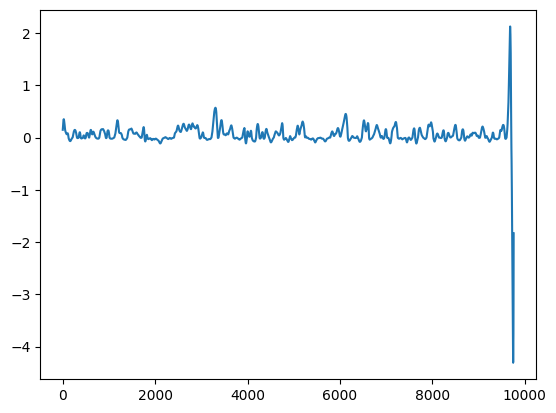

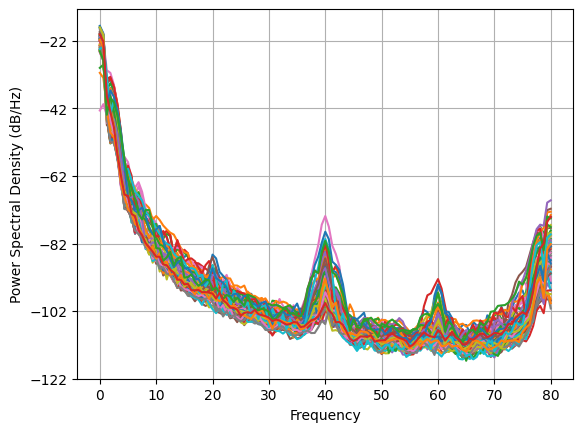

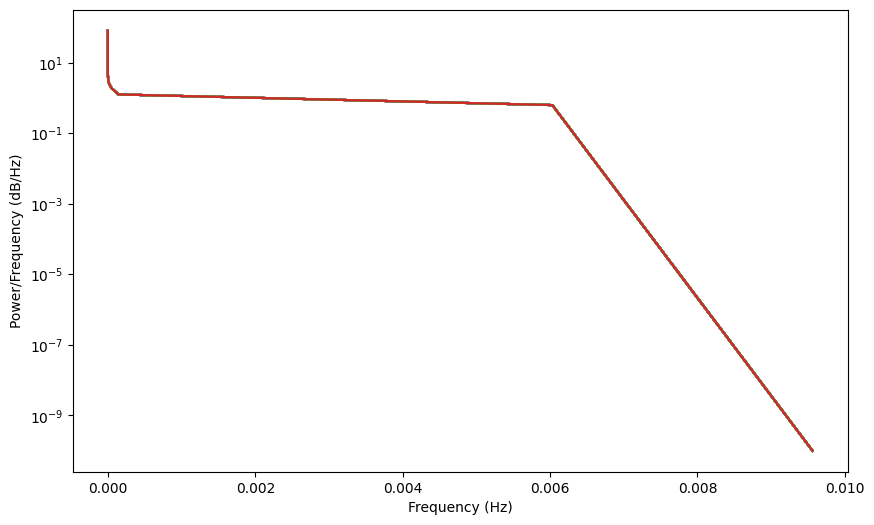

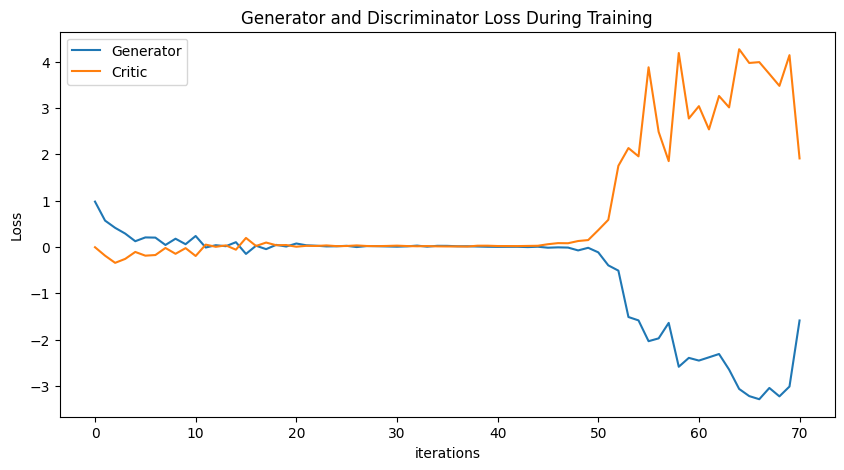

Epoch 80: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.017

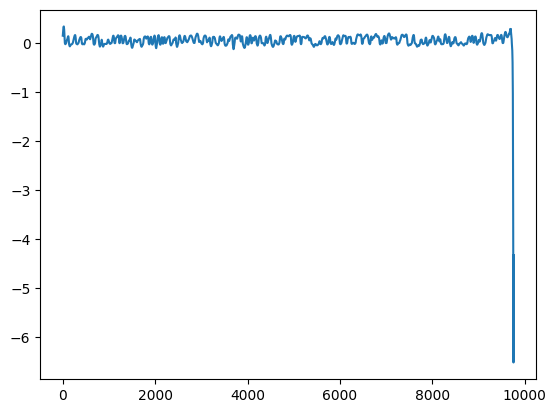

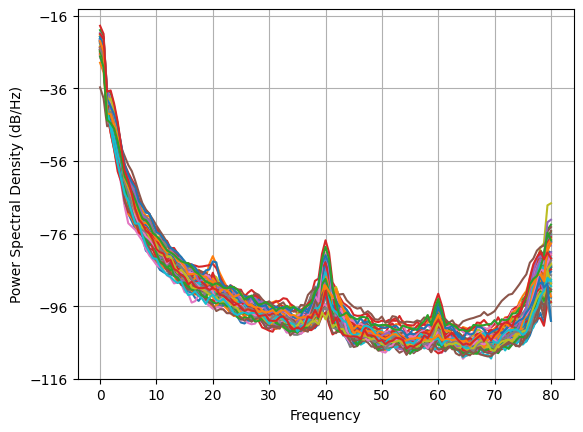

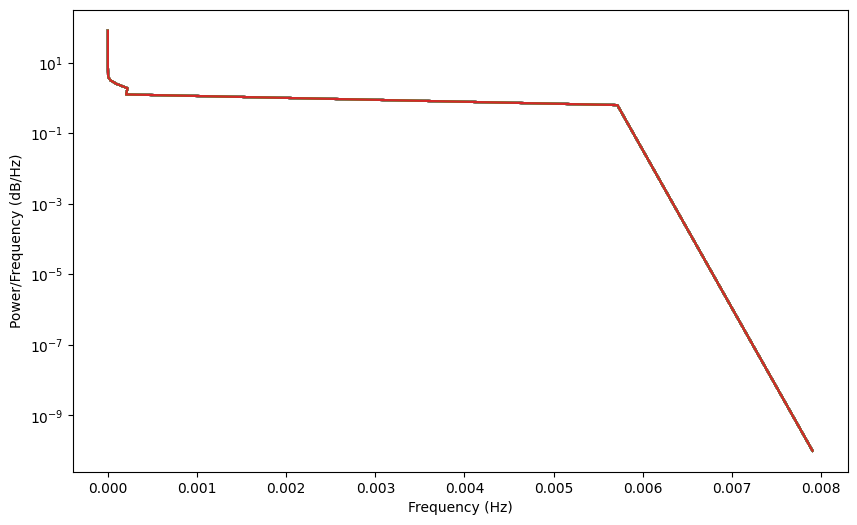

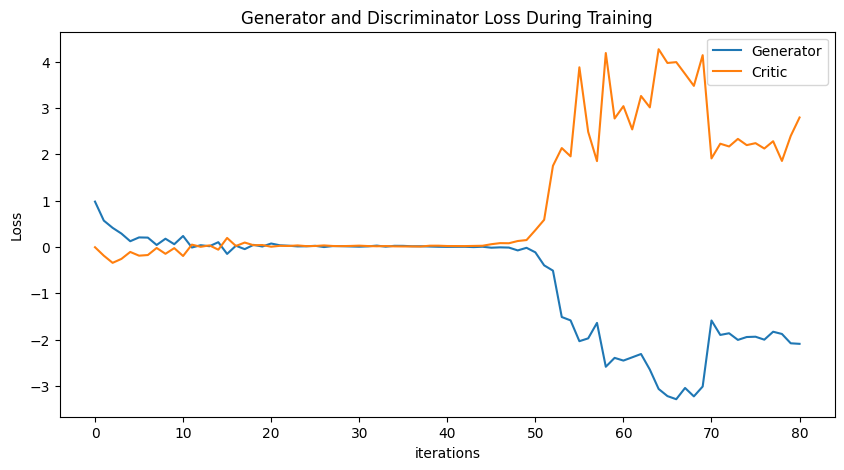

Epoch 90: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.017

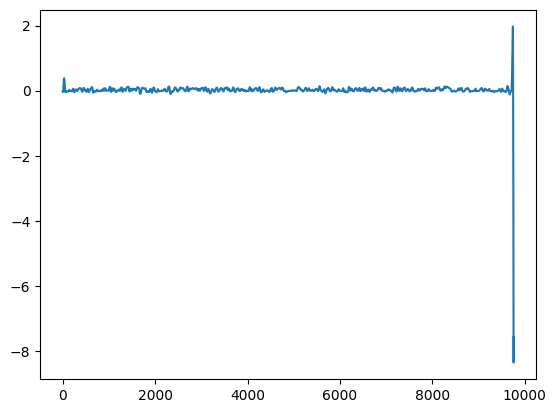

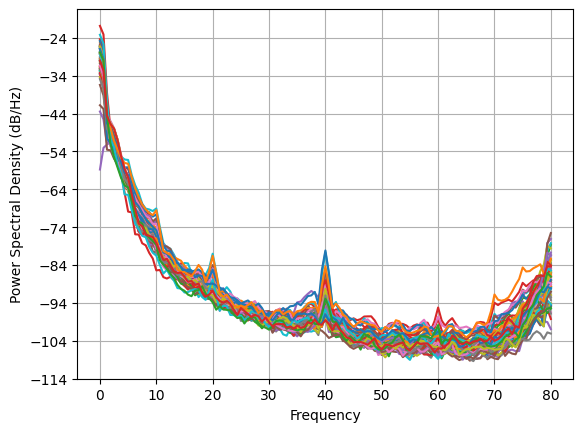

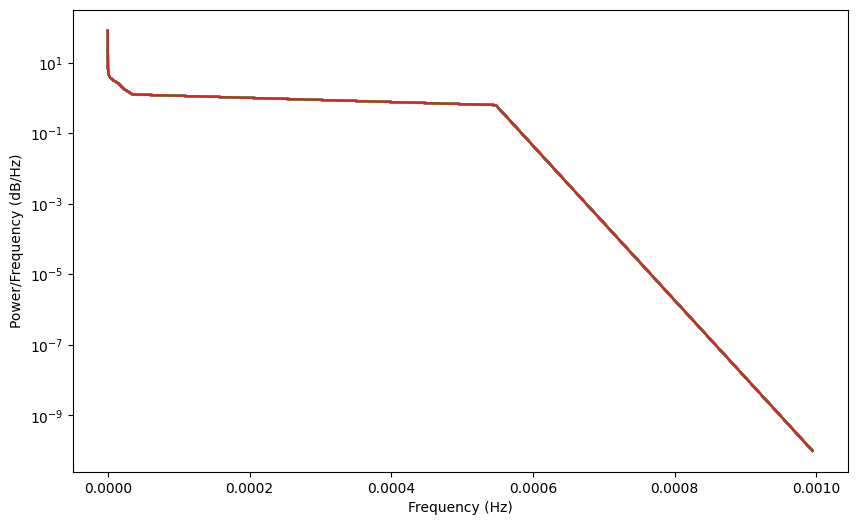

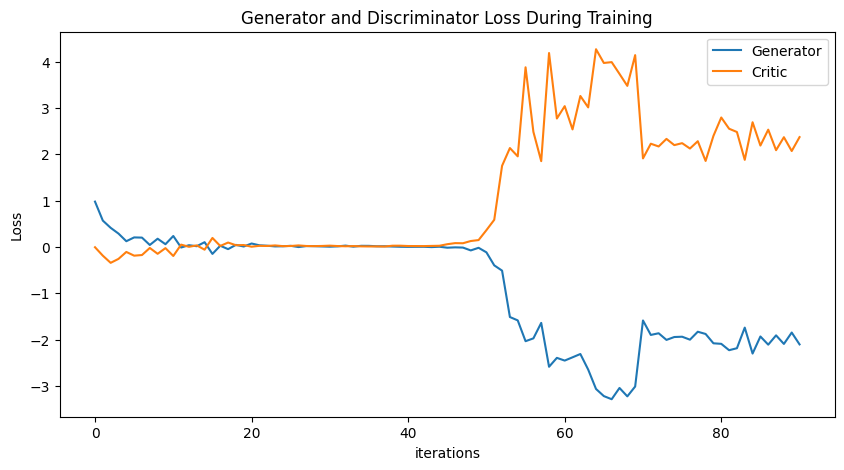

Epoch 100: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.01

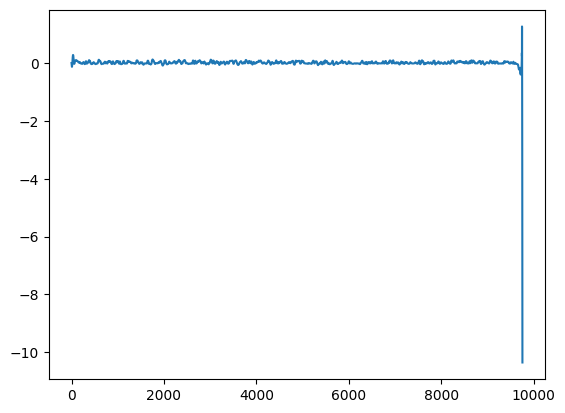

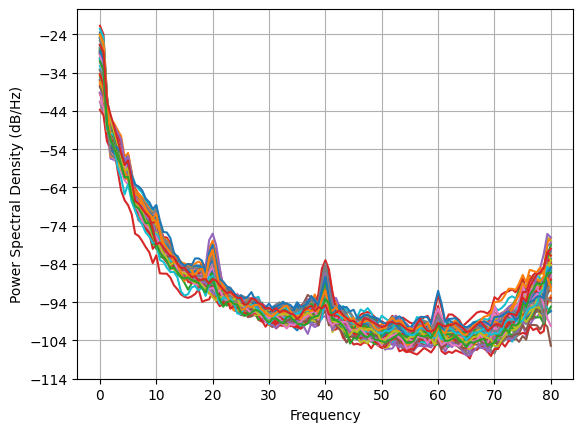

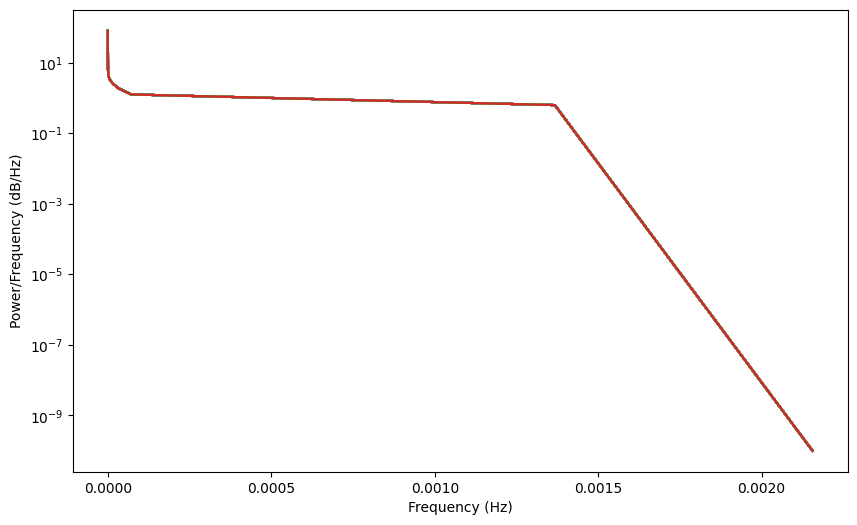

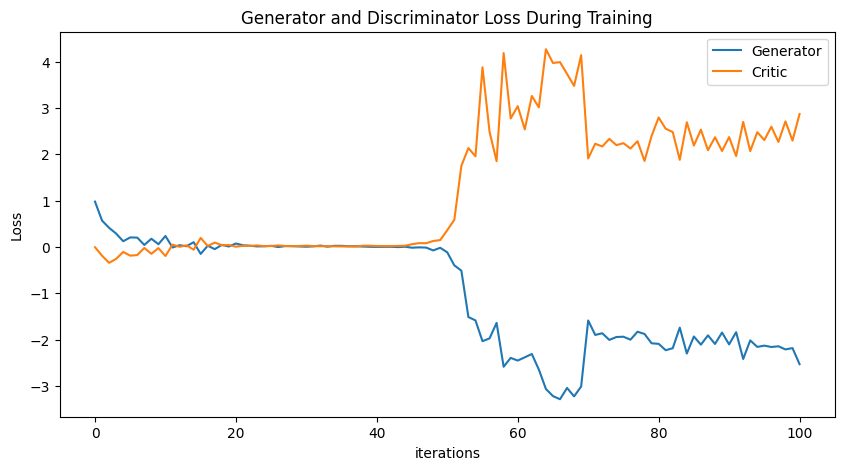

Epoch 110: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.01

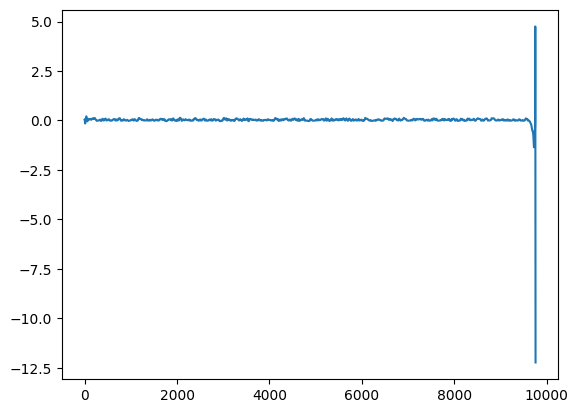

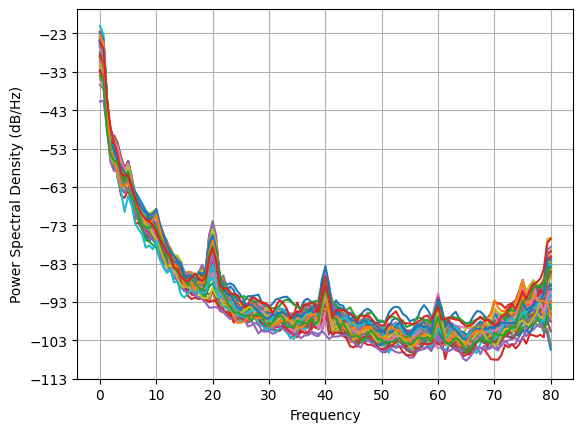

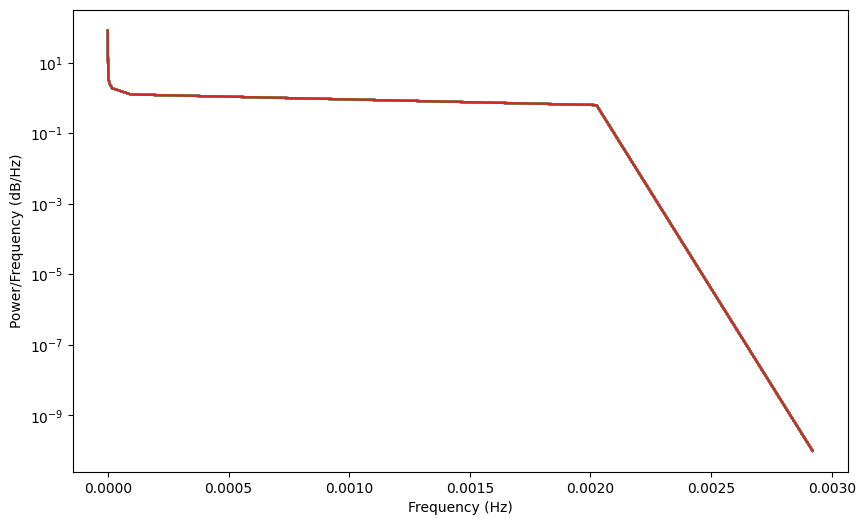

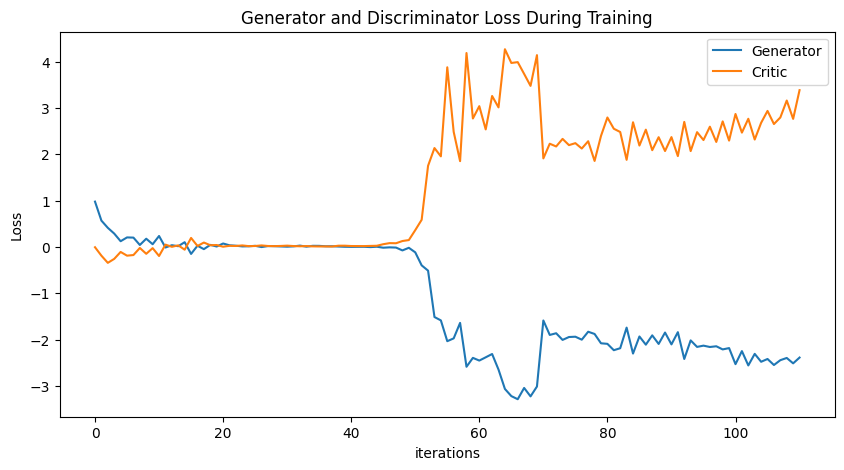

Epoch 120: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.01

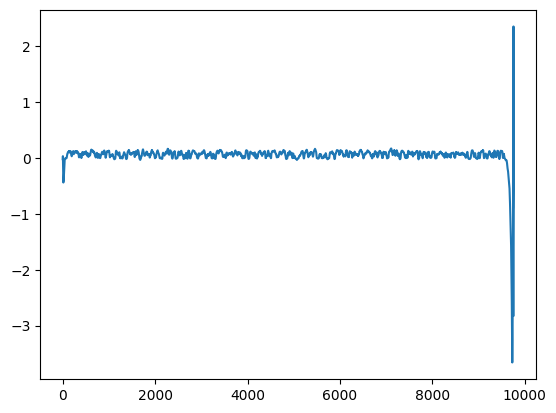

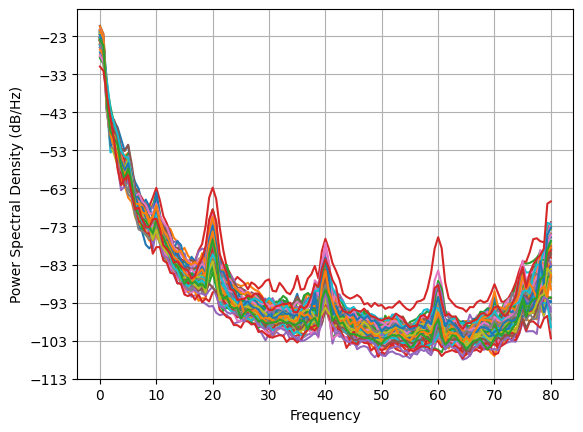

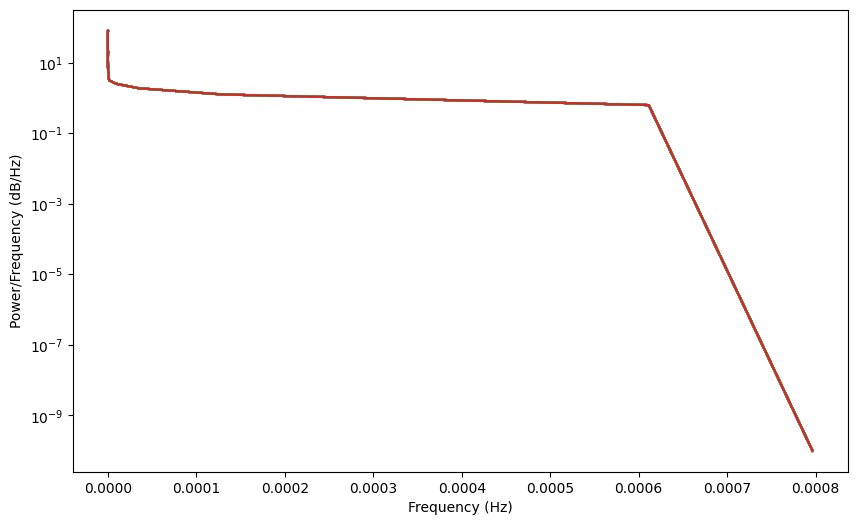

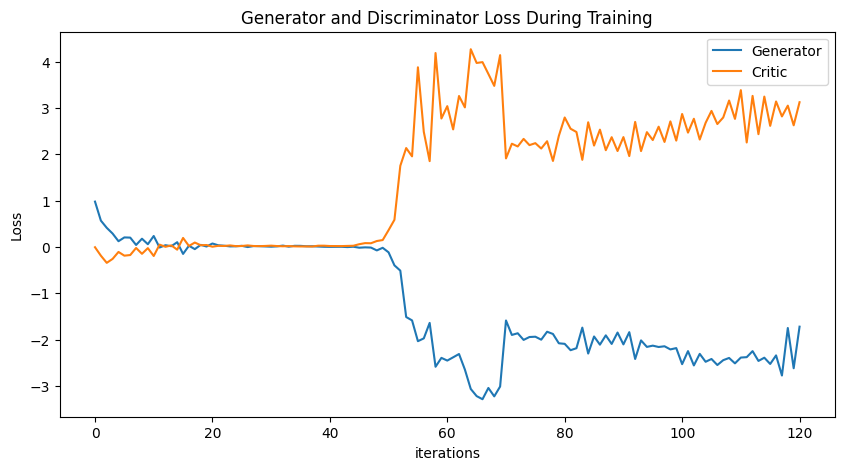

Epoch 130: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.01

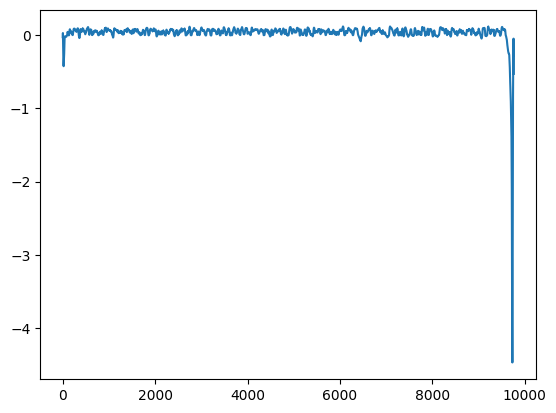

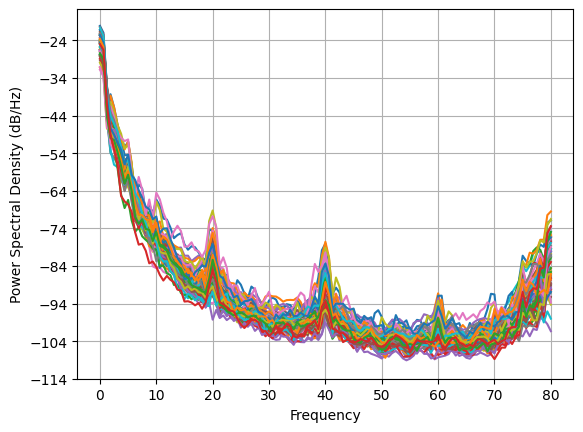

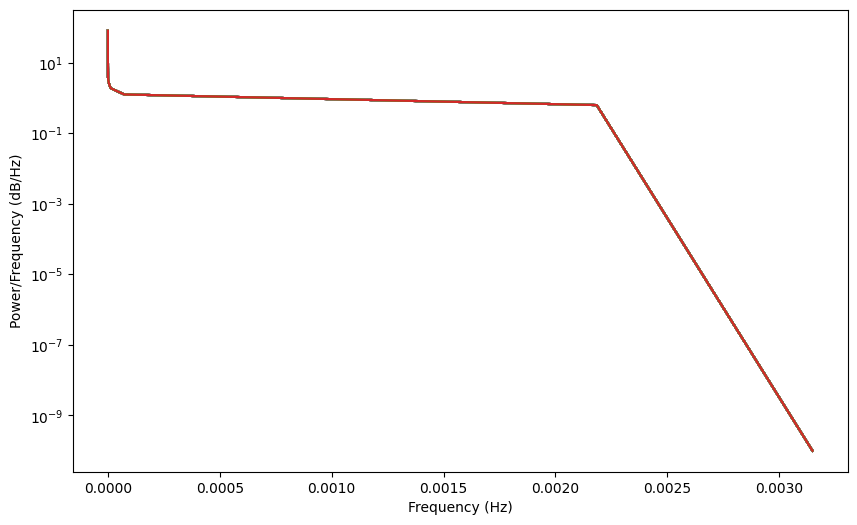

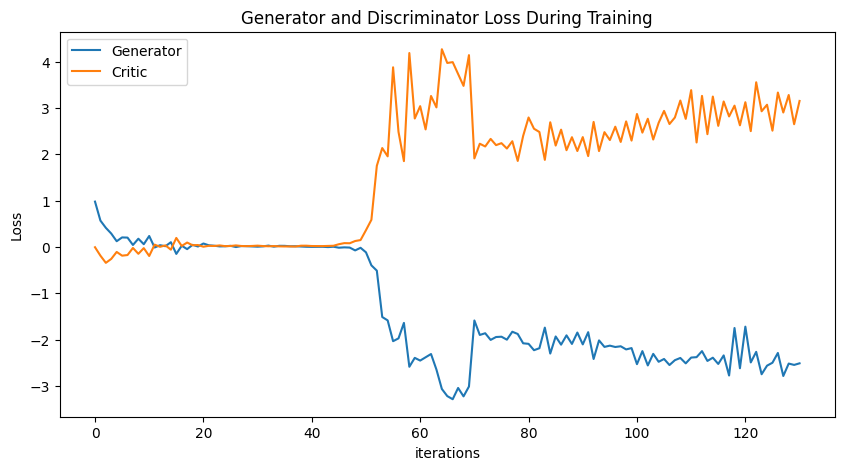

Epoch 140: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.01

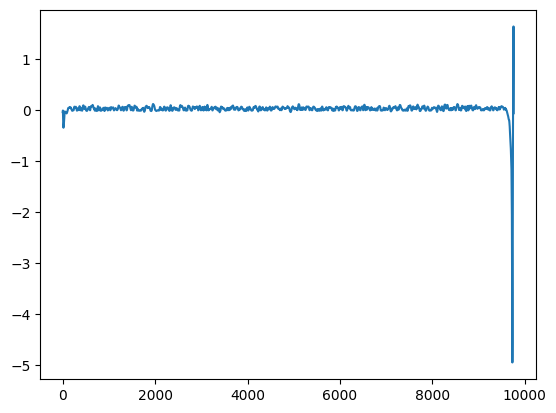

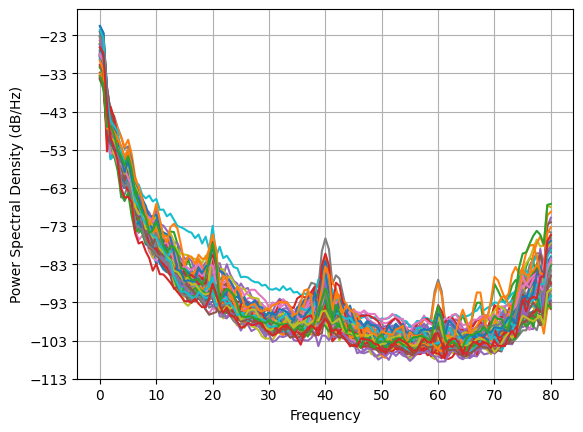

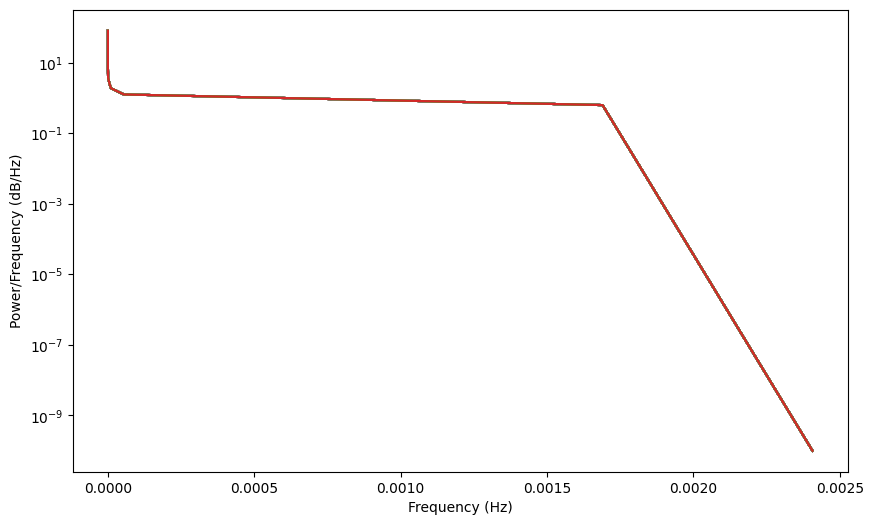

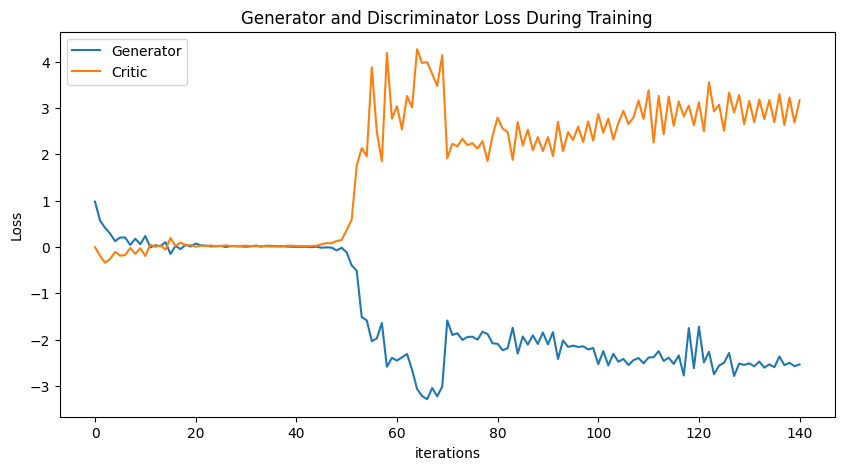

Epoch 150: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.01

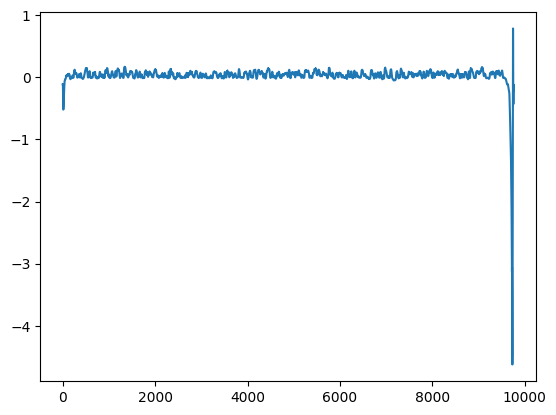

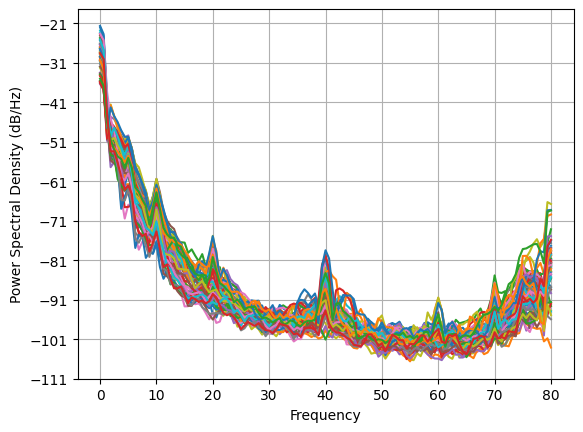

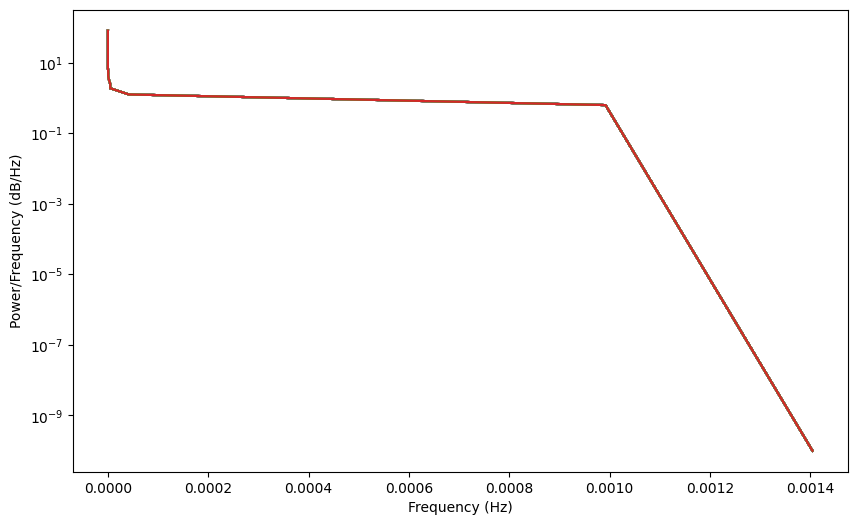

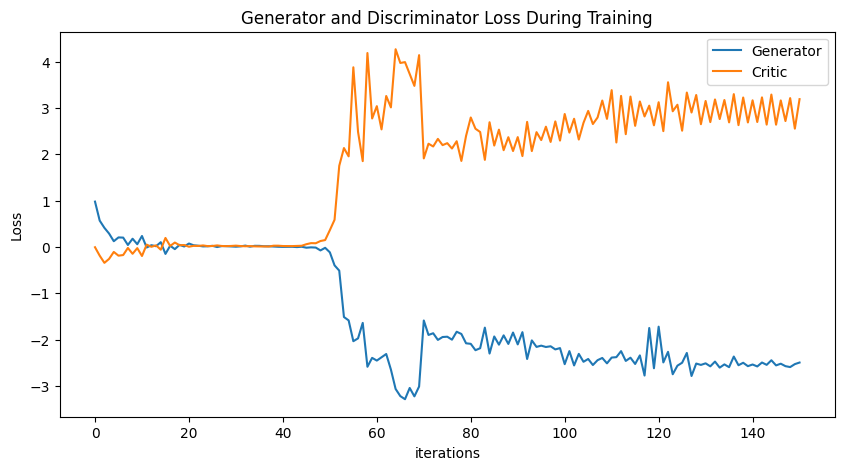

Epoch 160: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.01

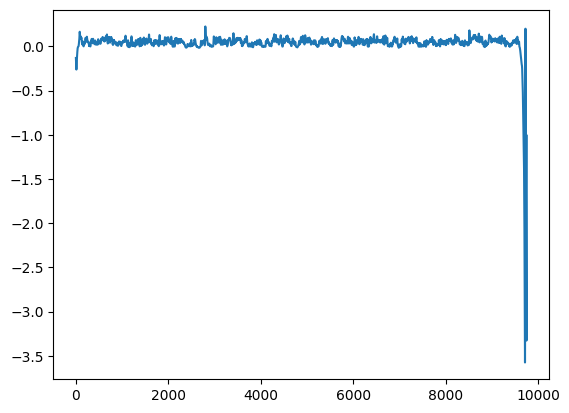

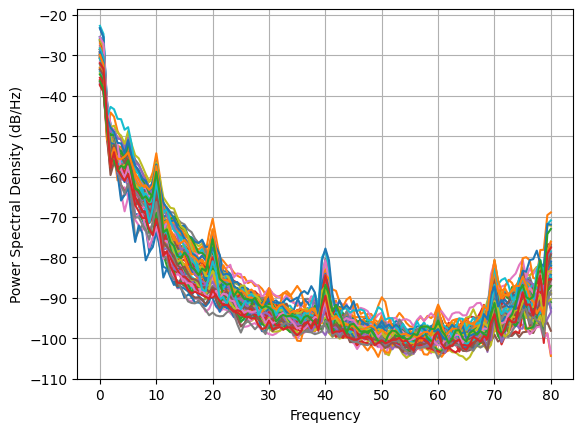

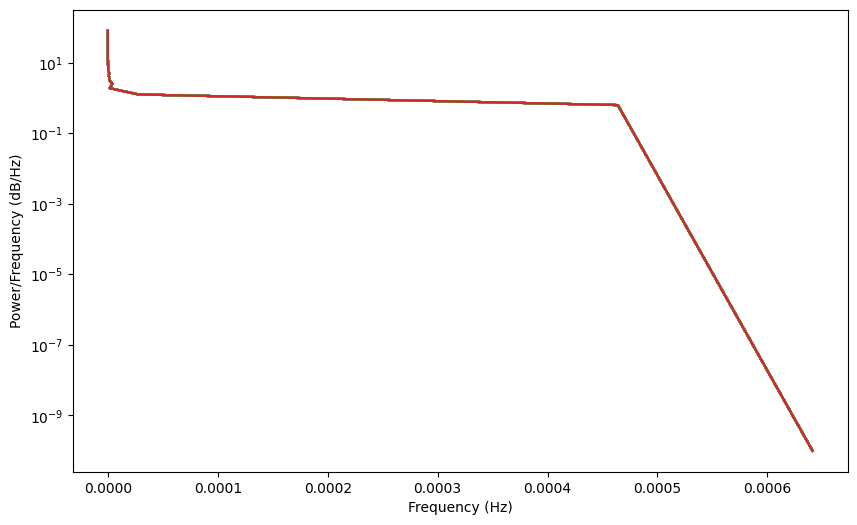

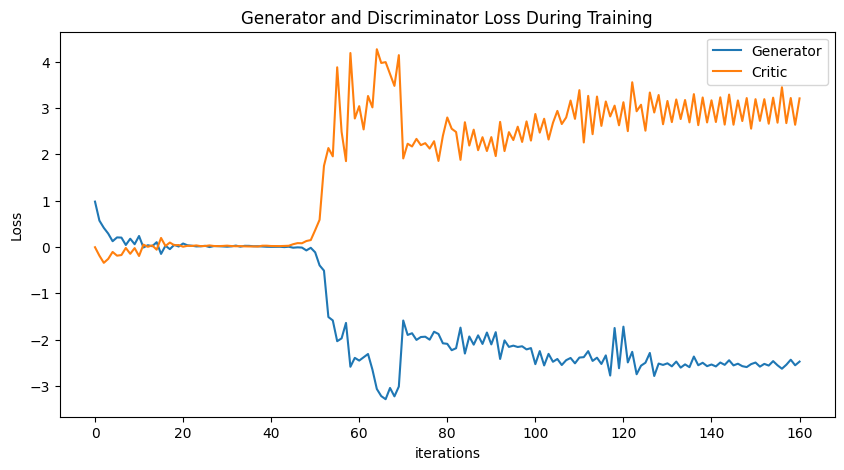

Epoch 170: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.01

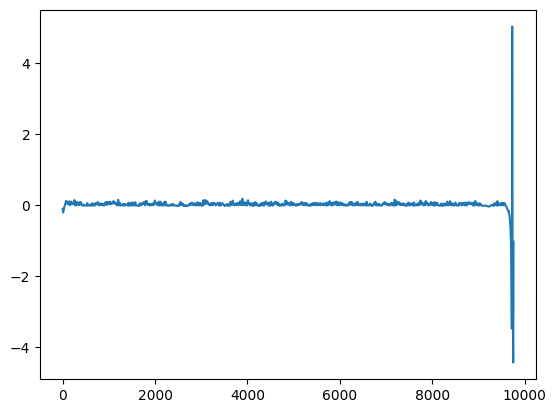

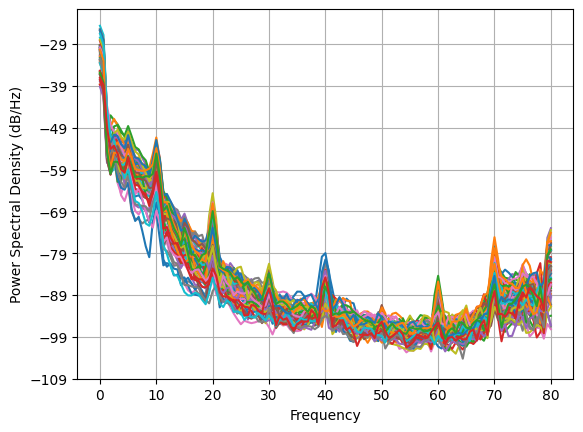

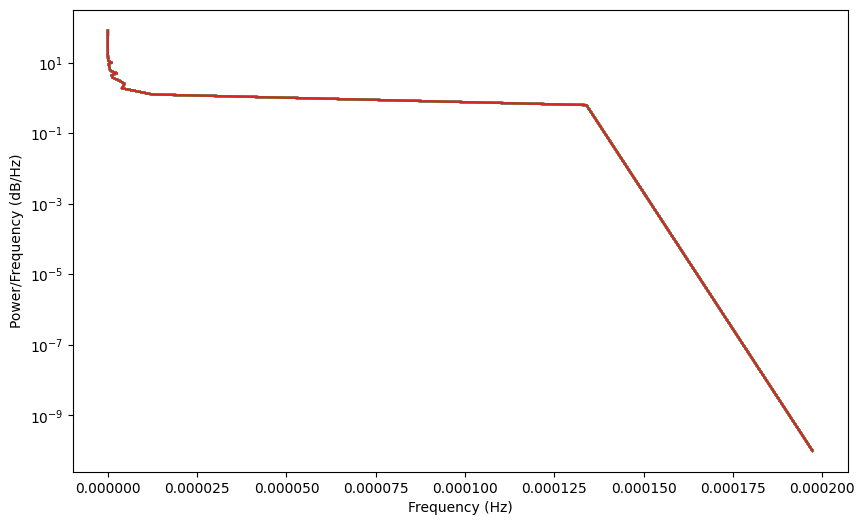

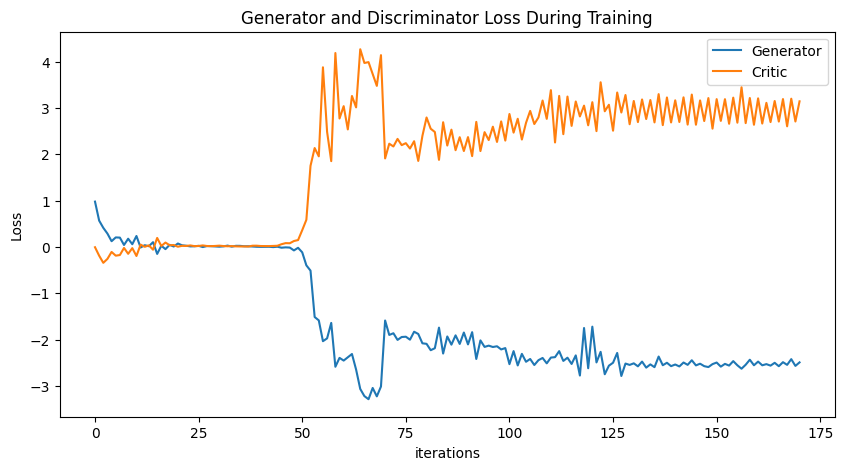

Epoch 180: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.01

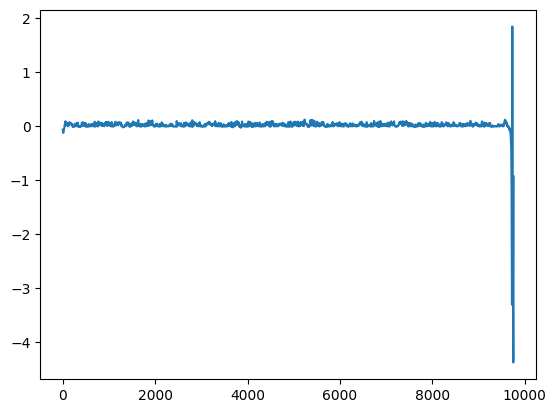

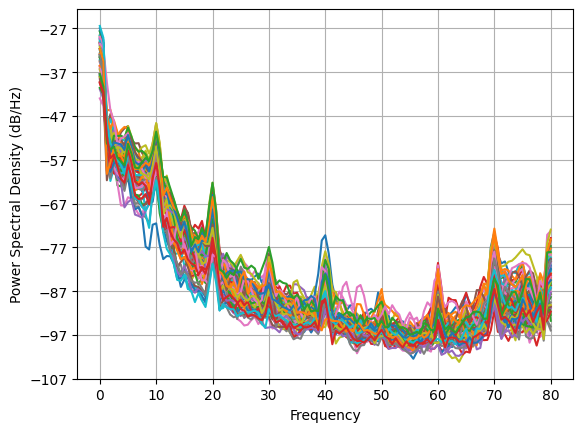

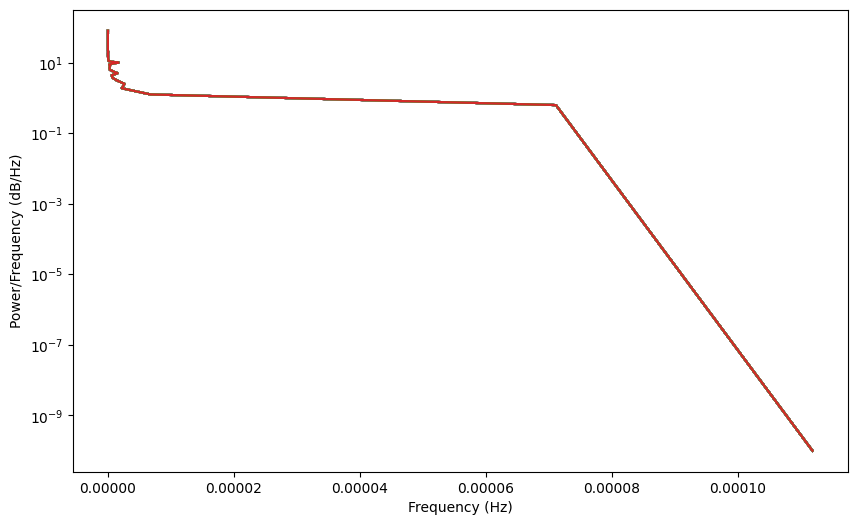

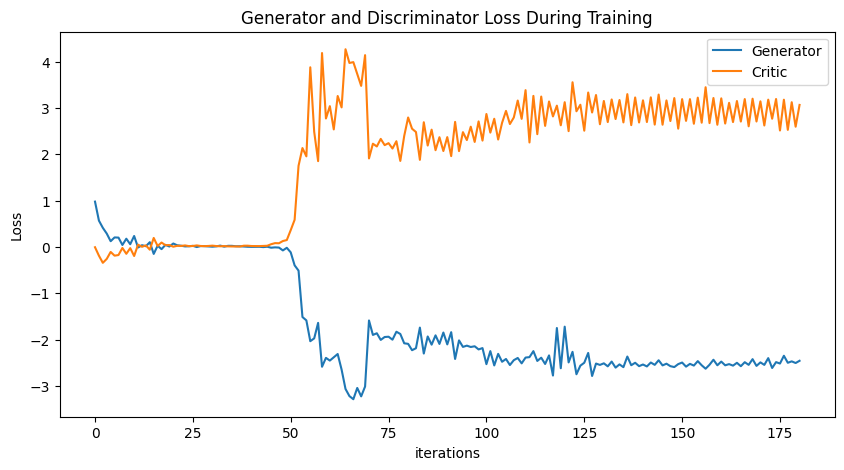

Epoch 190: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.01

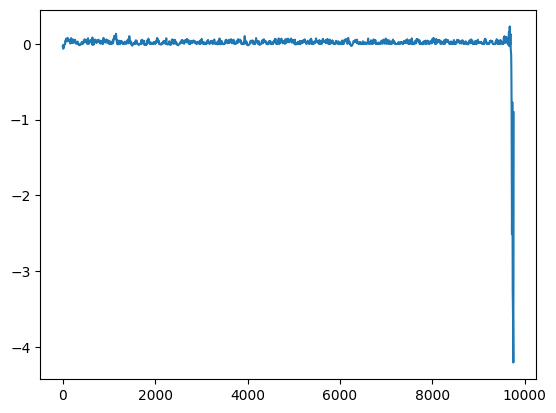

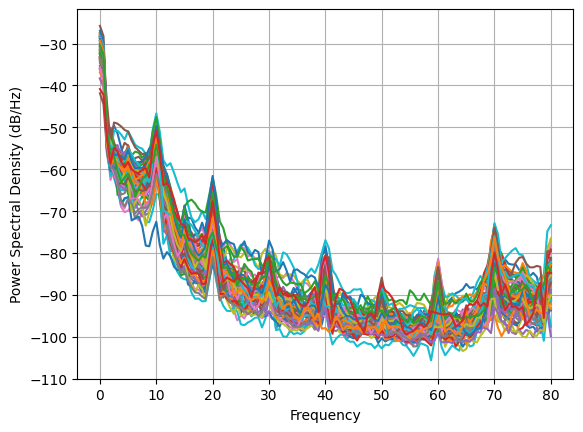

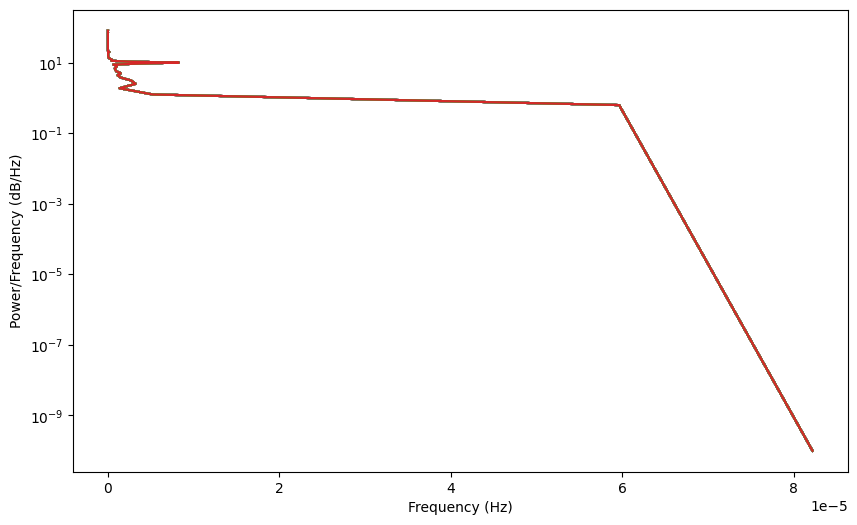

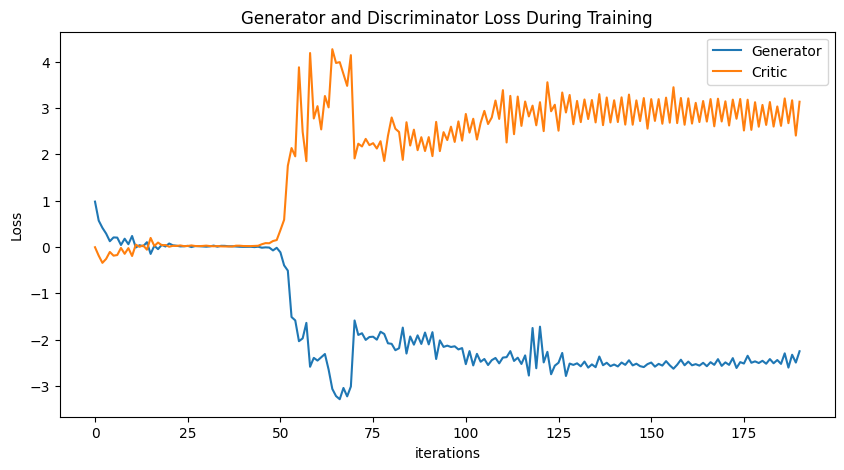

Epoch 200: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.01

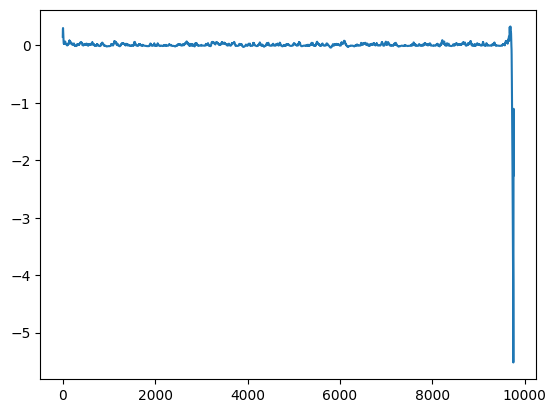

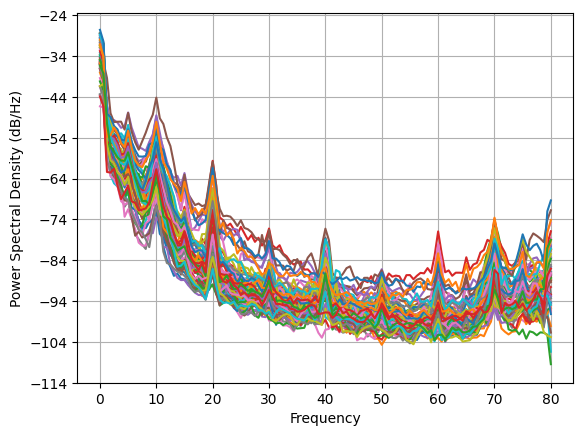

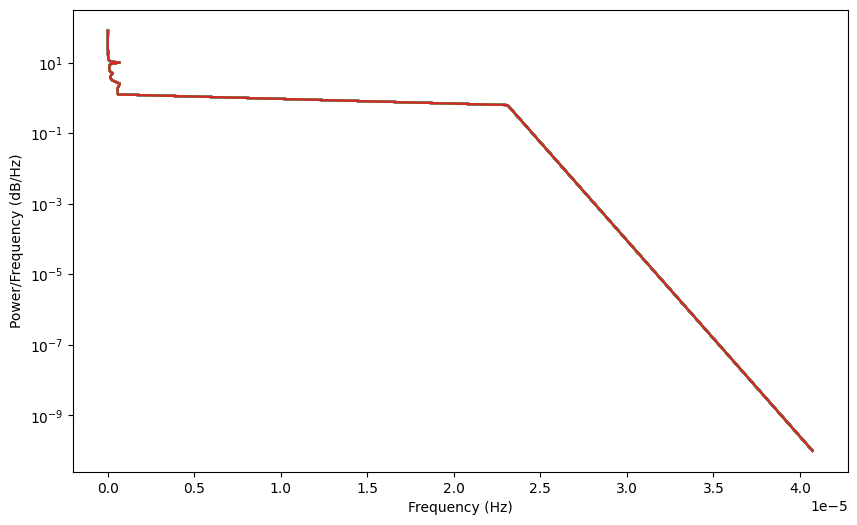

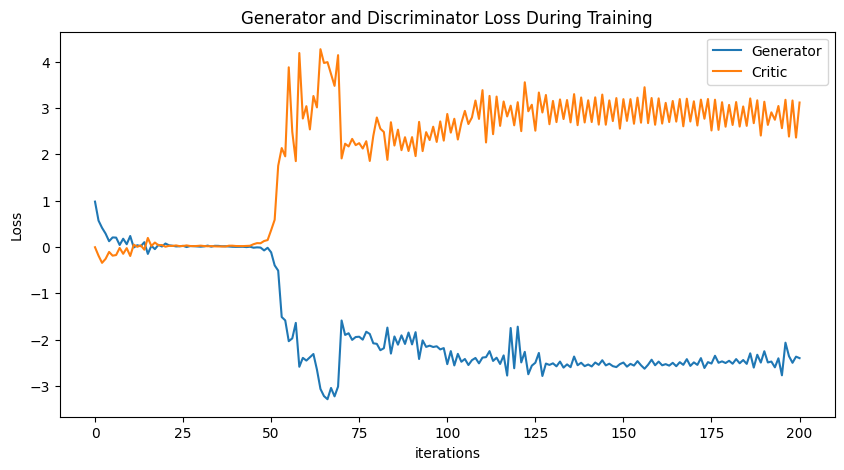

Epoch 210: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.01

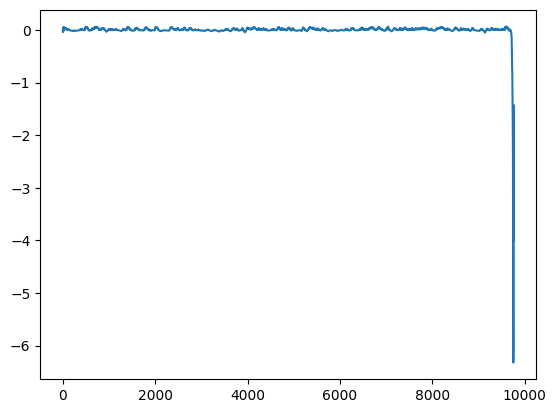

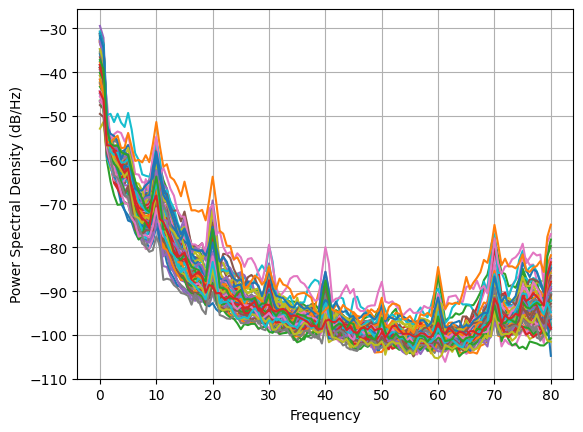

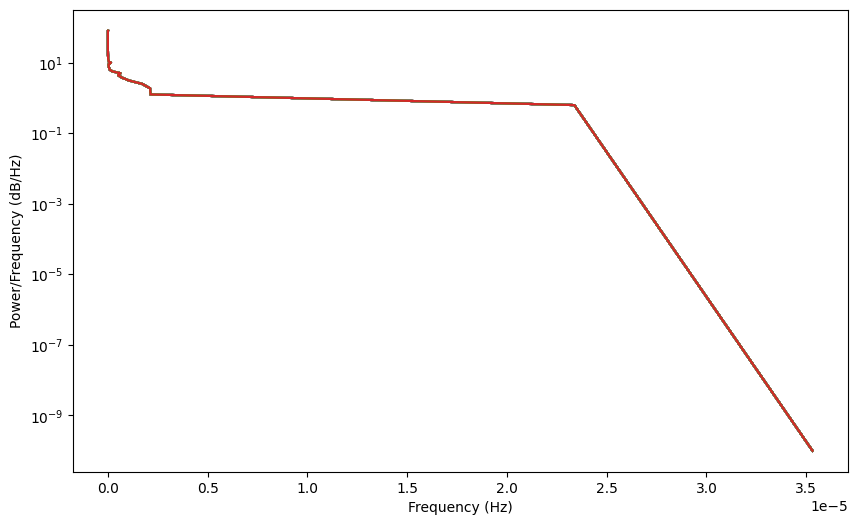

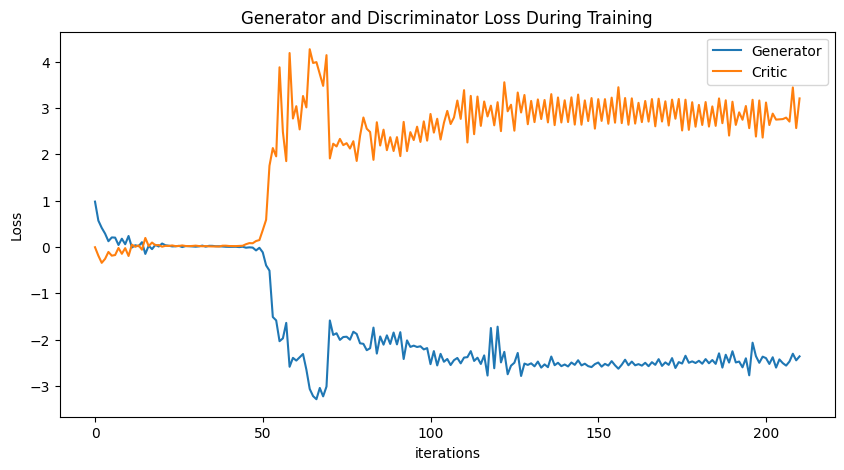

Epoch 220: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.01

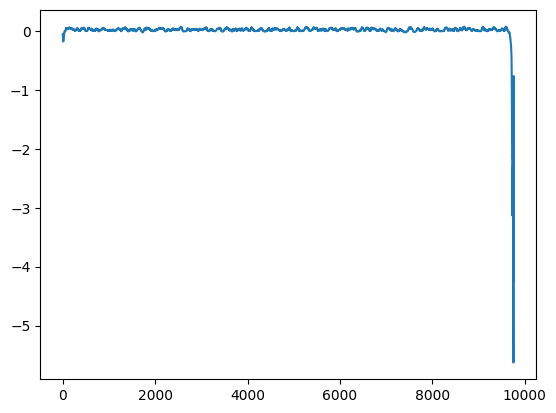

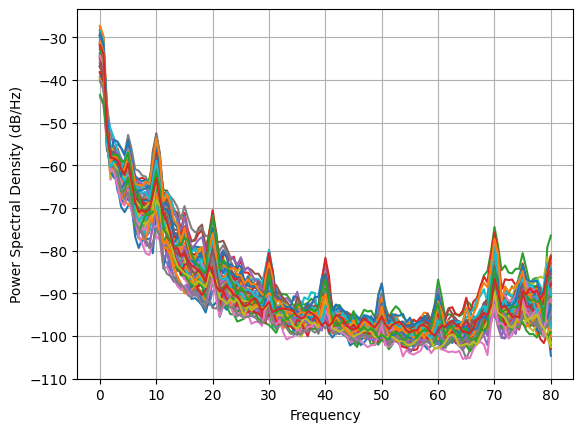

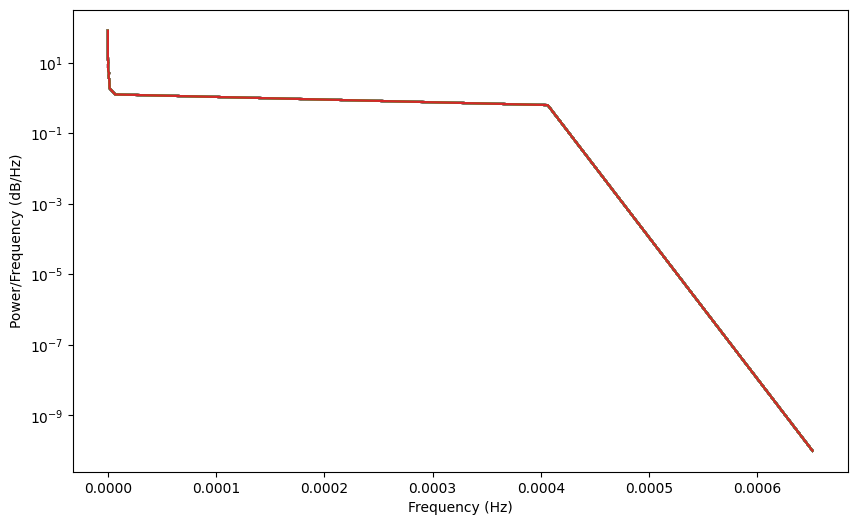

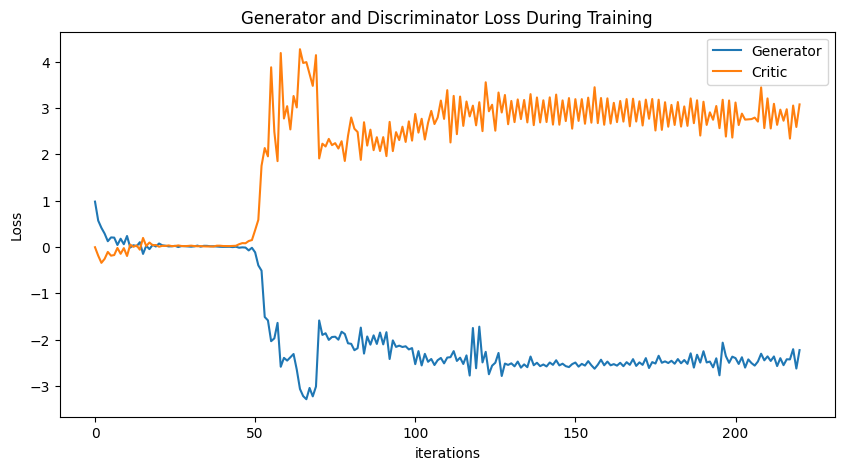

Epoch 230: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.01

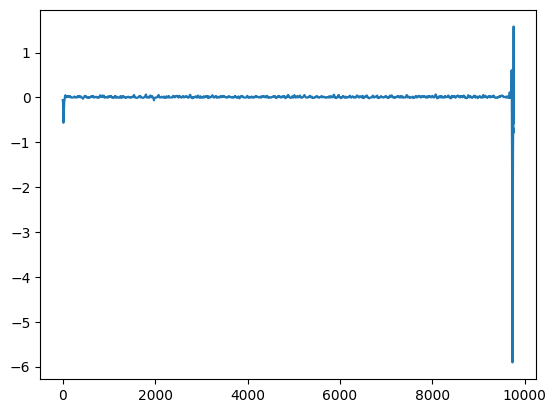

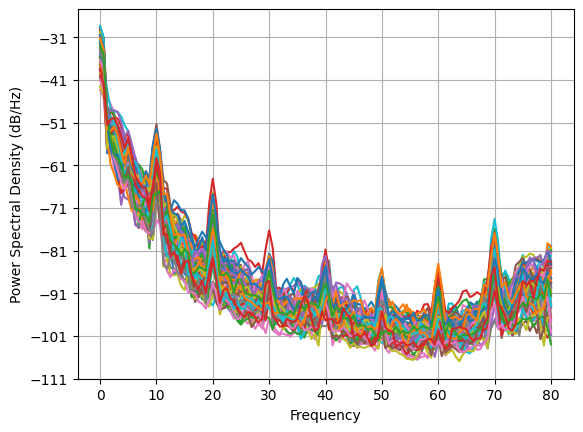

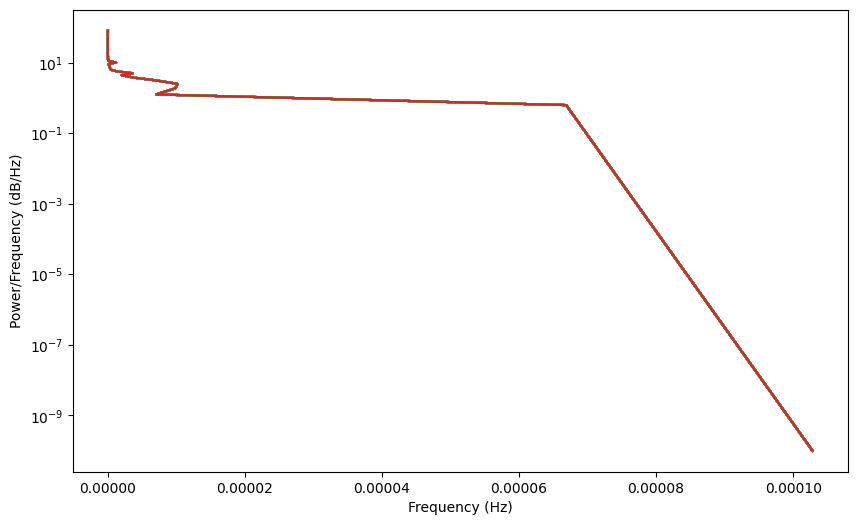

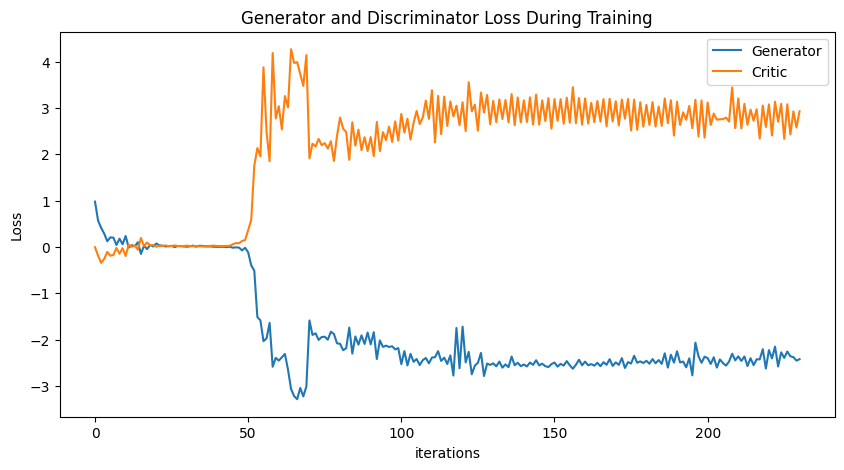

Epoch 240: Critic error ([0.97843294517341, 0.5682453562162849, 0.412144564743663, 0.2880314669499432, 0.12305601531733018, 0.2051265590848349, 0.2009352511077479, 0.04191209050009369, 0.17702178402789565, 0.058367456687144756, 0.23588418685703044, -0.01284051159841832, 0.036895441241983795, 0.015453492606275133, 0.10202907690708021, -0.15113757861957458, 0.025484744230057074, -0.04793929589387947, 0.04421603593260538, 0.008691017205996979, 0.07354753921794327, 0.035110643142030905, 0.025956982741121605, 0.011020439536698696, 0.013585558997901512, 0.023456317813677158, -0.003068020438227237, 0.017955927832566592, 0.015999724245774963, 0.010101431532804517, 0.004656478661728192, 0.011852909446926178, 0.02841285402791866, 0.005421127109048712, 0.02379807997726908, 0.022827244886748713, 0.014032579919041027, 0.014510360296508693, 0.008091211900180851, 0.002892400736677722, 0.000984367919383649, 0.002116691310246655, 0.0027443375691299093, -0.003975244244432415, 0.003996413827366763, -0.01

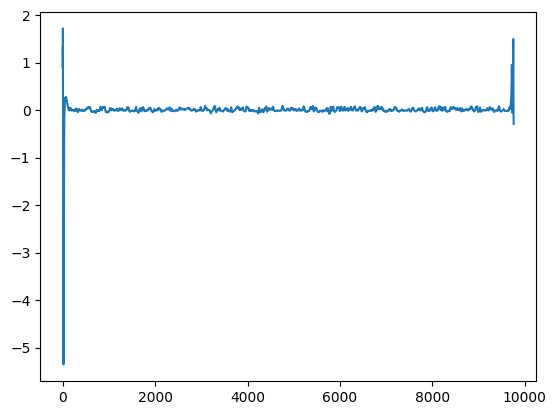

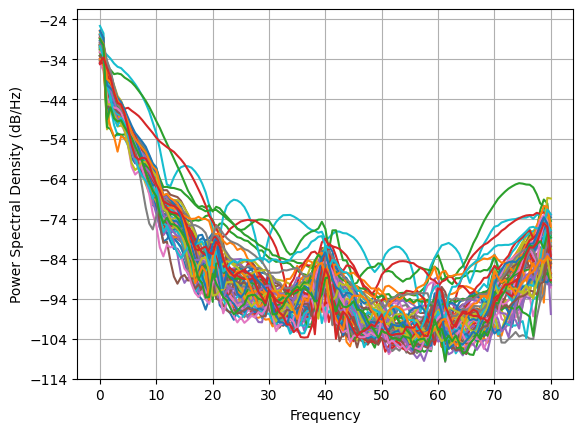

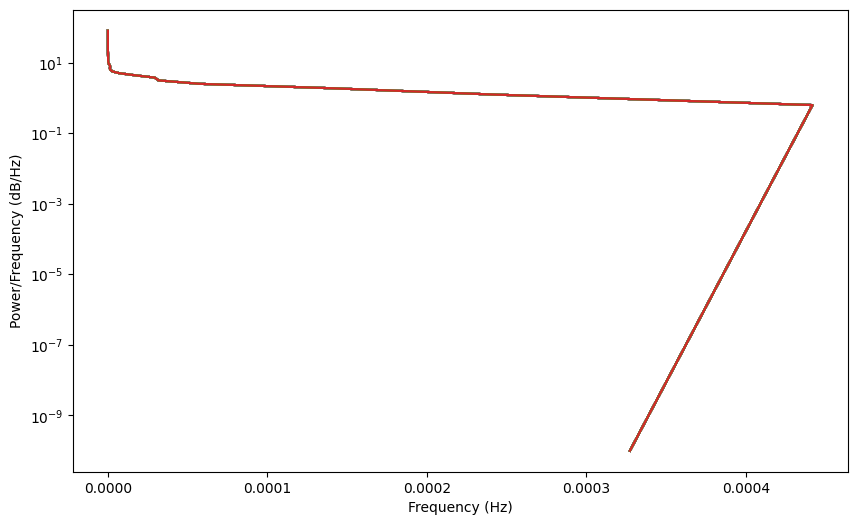

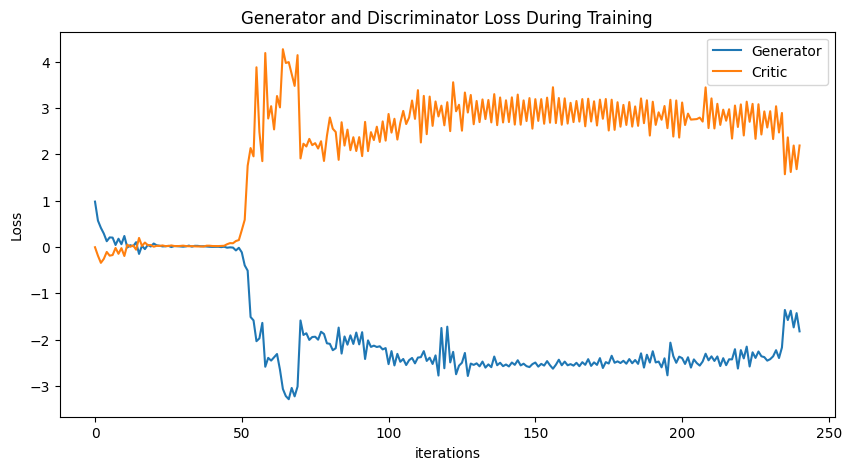

KeyboardInterrupt: 

In [15]:
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
training_data = torch.tensor(np.load('training_closed.npy'))
BATCH_SIZE = np.shape(training_data)[0]

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 640, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1)
            critic_fake = D(fake).reshape(-1)
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()
            critic_optimizer.zero_grad()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        gen_optimizer.zero_grad()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(generated_data, critic_err, gen_err)

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data_closed, disc, gen = train()

torch.save(gen, 'gen_FINA1L_closed.pt')
torch.save(disc, 'disc_FINAL1_closed.pt')
np.save('complex-closed.npy', generated_data_closed.detach())
plot_everything(generated_data_closed, gen_err, critic_err)

# Zero weights before optimizer step (fixed)

Epoch 0: Critic error ([1.3351855210010803]) Generator err ([0.06840544939041138])


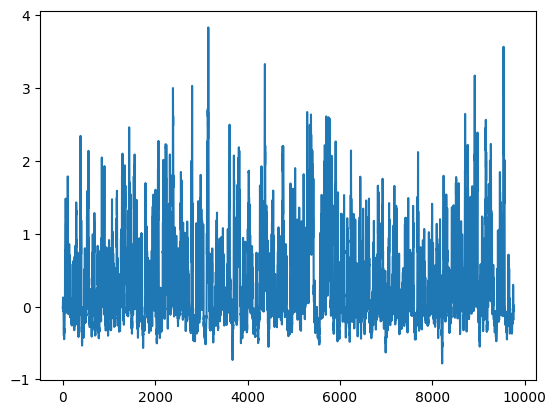

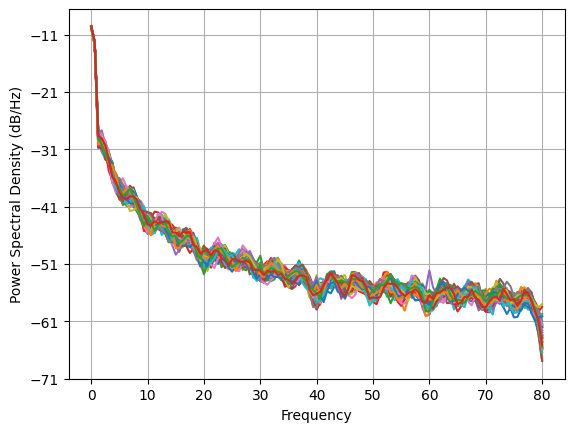

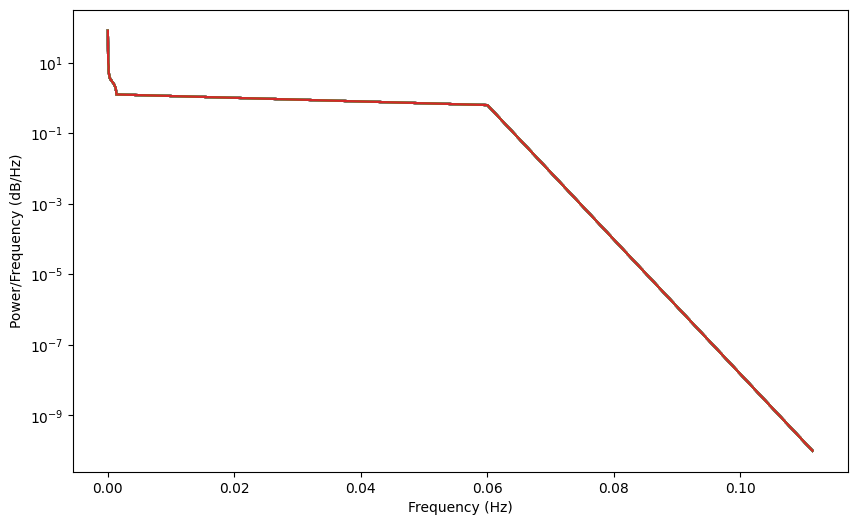

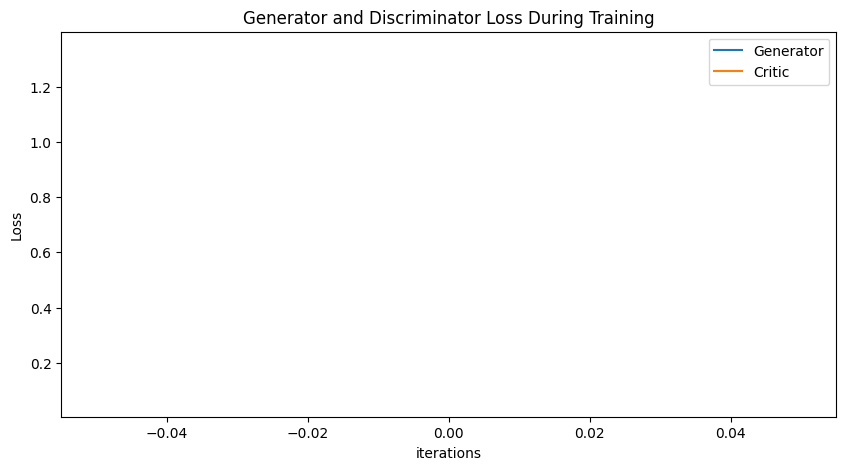

Epoch 10: Critic error ([1.3351855210010803, 1.1454546821519997, 0.23895989472068882, -0.14441030949818118, -0.0547241054929004, 0.05018282443223861, -0.0569371693437401, 0.0965026775725221, -0.015188734136256599, 0.0757810015051624, 0.10522698311417755]) Generator err ([0.06840544939041138, 0.07365499436855316, 0.05319008231163025, 0.2462330162525177, 0.17179955542087555, 0.0881878137588501, 0.17144547402858734, 0.11959154158830643, 0.170691579580307, 0.09376632422208786, 0.13354989886283875])


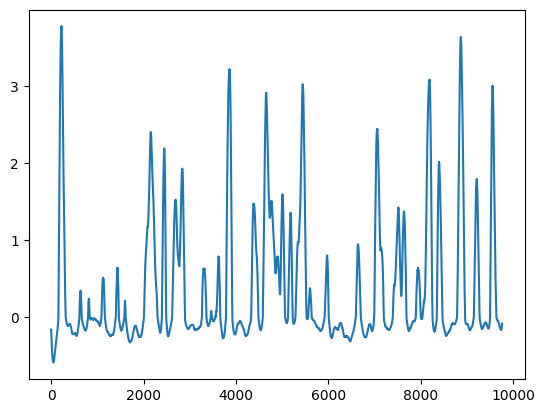

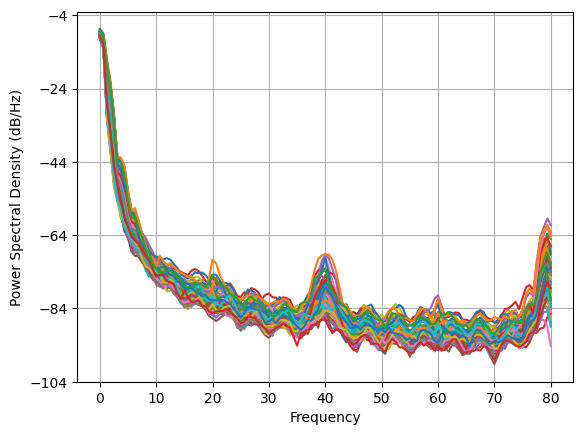

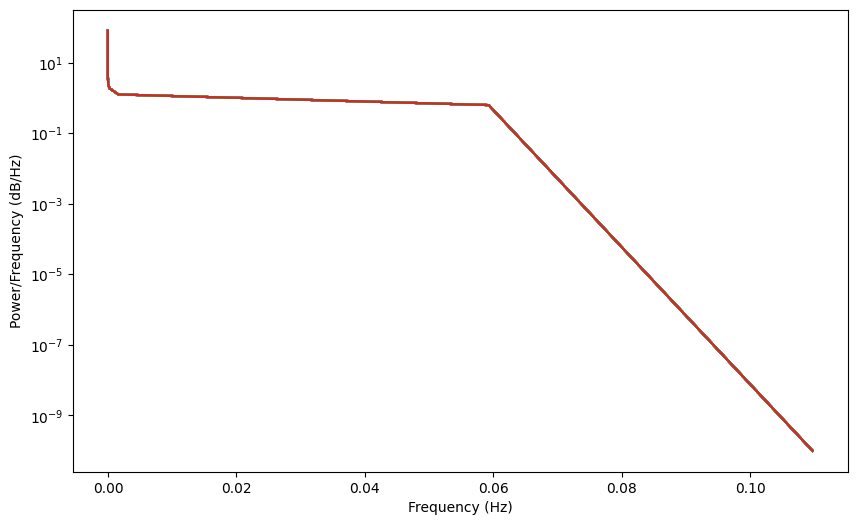

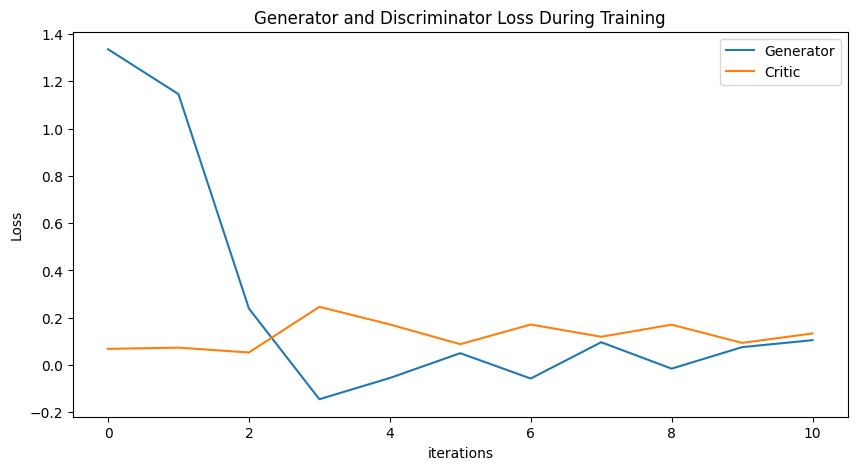

Epoch 20: Critic error ([1.3351855210010803, 1.1454546821519997, 0.23895989472068882, -0.14441030949818118, -0.0547241054929004, 0.05018282443223861, -0.0569371693437401, 0.0965026775725221, -0.015188734136256599, 0.0757810015051624, 0.10522698311417755, 0.044883081377492, 0.09055948293566674, 0.015579117076589433, 0.03971737365776011, 0.06942058231304918, 0.010981199929381139, 0.11303119867816389, -0.0053947597041621165, 0.04042767971234011, 0.010426053633104157]) Generator err ([0.06840544939041138, 0.07365499436855316, 0.05319008231163025, 0.2462330162525177, 0.17179955542087555, 0.0881878137588501, 0.17144547402858734, 0.11959154158830643, 0.170691579580307, 0.09376632422208786, 0.13354989886283875, 0.1055336445569992, 0.0914362370967865, 0.13261927664279938, 0.10522592812776566, 0.09574921429157257, 0.12042488157749176, 0.1098674088716507, 0.12998047471046448, 0.13461340963840485, 0.16044993698596954])


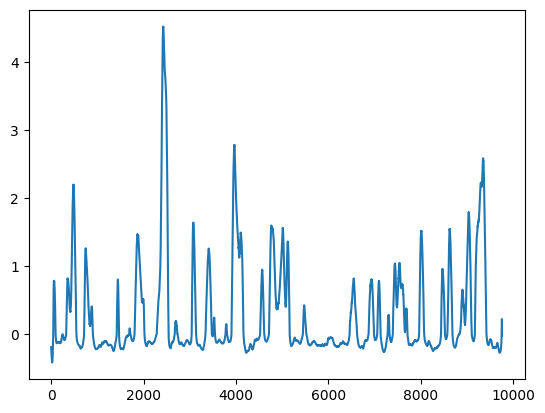

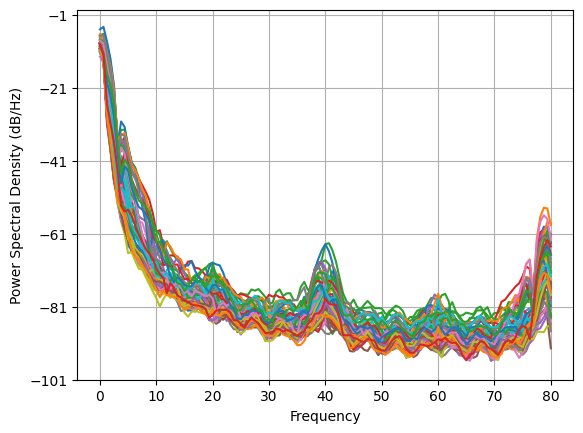

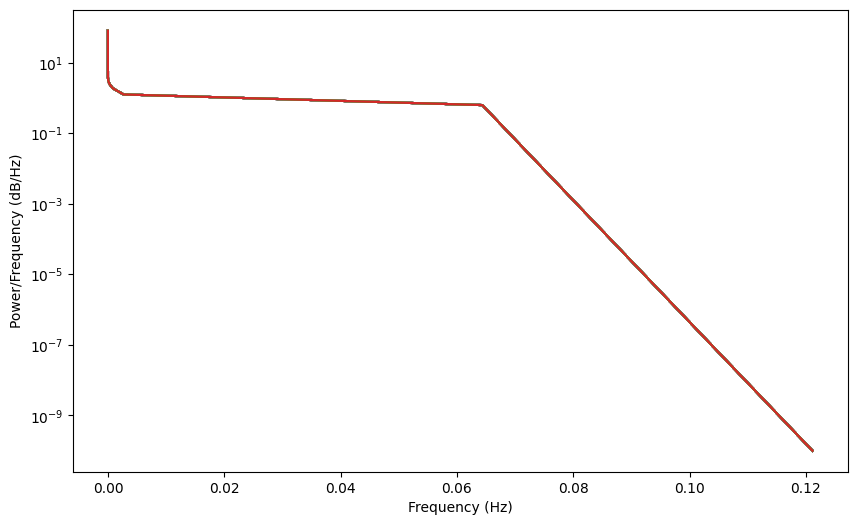

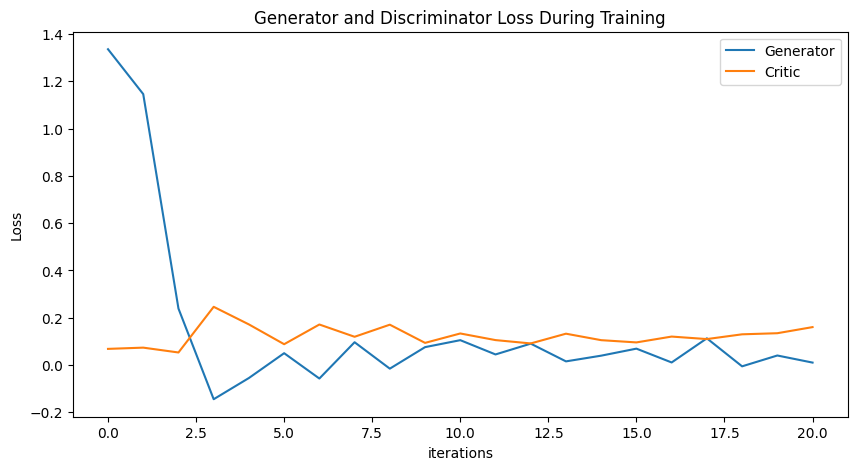

Epoch 30: Critic error ([1.3351855210010803, 1.1454546821519997, 0.23895989472068882, -0.14441030949818118, -0.0547241054929004, 0.05018282443223861, -0.0569371693437401, 0.0965026775725221, -0.015188734136256599, 0.0757810015051624, 0.10522698311417755, 0.044883081377492, 0.09055948293566674, 0.015579117076589433, 0.03971737365776011, 0.06942058231304918, 0.010981199929381139, 0.11303119867816389, -0.0053947597041621165, 0.04042767971234011, 0.010426053633104157, -0.15420087472995683, -0.028438796394360283, -0.16530946774731178, -0.19684792691976072, -0.5665998218929676, -0.7780401535161873, -0.8727111444726007, -1.0484508704778472, -1.204531719783672, -1.692393697903823]) Generator err ([0.06840544939041138, 0.07365499436855316, 0.05319008231163025, 0.2462330162525177, 0.17179955542087555, 0.0881878137588501, 0.17144547402858734, 0.11959154158830643, 0.170691579580307, 0.09376632422208786, 0.13354989886283875, 0.1055336445569992, 0.0914362370967865, 0.13261927664279938, 0.10522592812

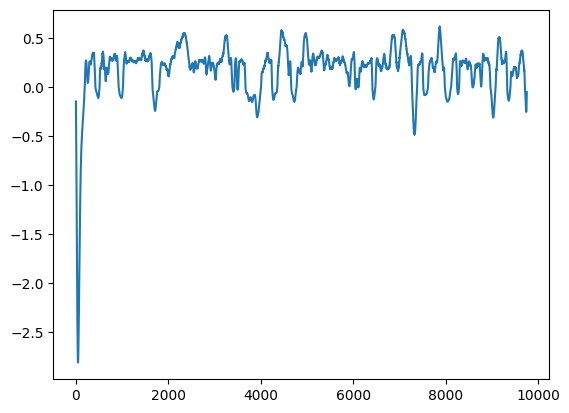

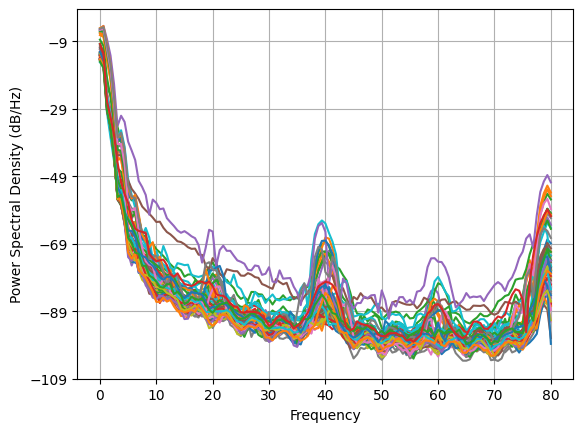

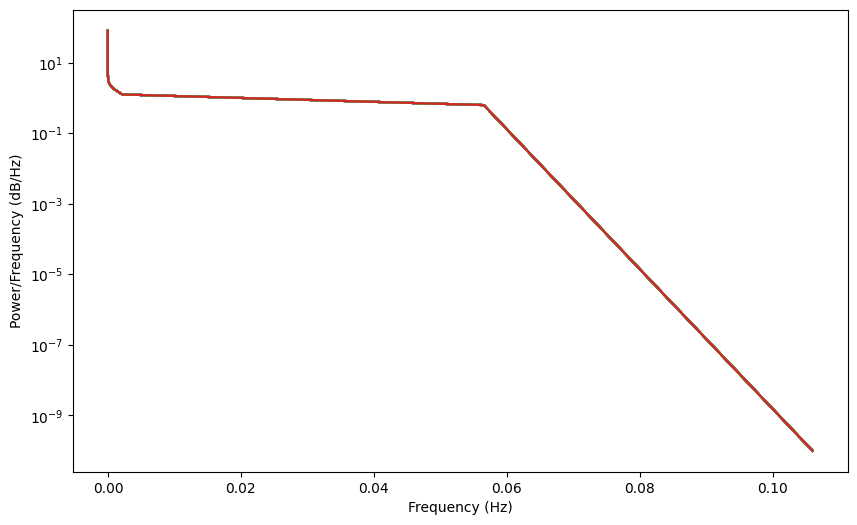

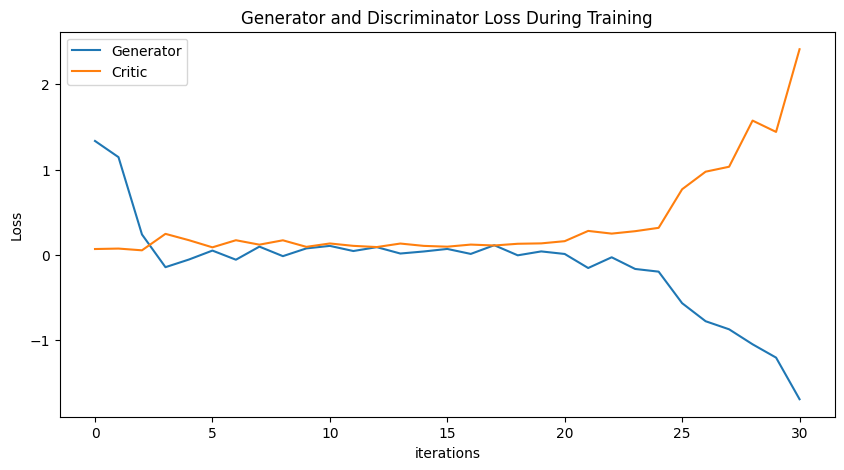

Epoch 40: Critic error ([1.3351855210010803, 1.1454546821519997, 0.23895989472068882, -0.14441030949818118, -0.0547241054929004, 0.05018282443223861, -0.0569371693437401, 0.0965026775725221, -0.015188734136256599, 0.0757810015051624, 0.10522698311417755, 0.044883081377492, 0.09055948293566674, 0.015579117076589433, 0.03971737365776011, 0.06942058231304918, 0.010981199929381139, 0.11303119867816389, -0.0053947597041621165, 0.04042767971234011, 0.010426053633104157, -0.15420087472995683, -0.028438796394360283, -0.16530946774731178, -0.19684792691976072, -0.5665998218929676, -0.7780401535161873, -0.8727111444726007, -1.0484508704778472, -1.204531719783672, -1.692393697903823, -1.8446691202121464, -1.9729912761413242, -1.880282863207143, -2.049501202708115, -1.8446753221112513, -1.8611464965157236, -1.6276686406674827, -1.42375811949698, -1.6103235493648431, -1.5268971707797259]) Generator err ([0.06840544939041138, 0.07365499436855316, 0.05319008231163025, 0.2462330162525177, 0.1717995554

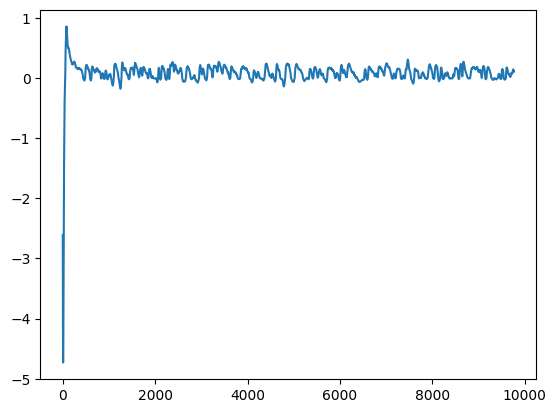

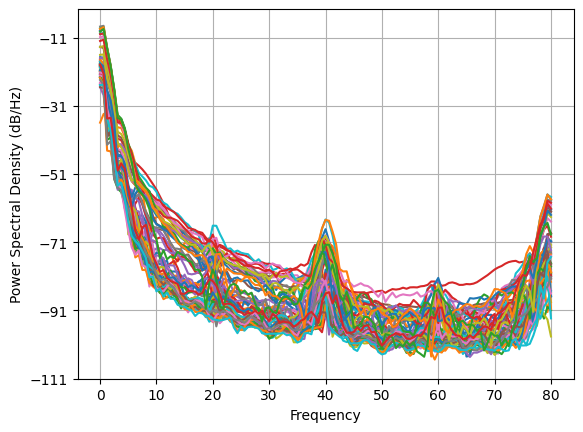

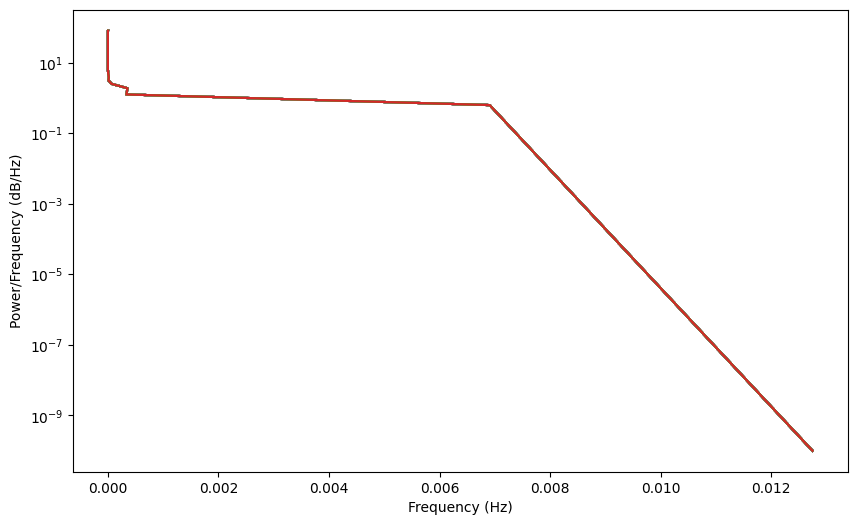

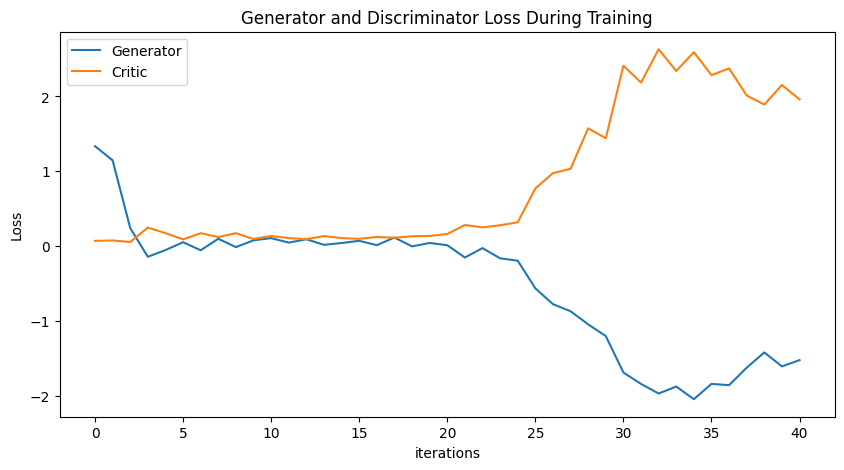

Epoch 50: Critic error ([1.3351855210010803, 1.1454546821519997, 0.23895989472068882, -0.14441030949818118, -0.0547241054929004, 0.05018282443223861, -0.0569371693437401, 0.0965026775725221, -0.015188734136256599, 0.0757810015051624, 0.10522698311417755, 0.044883081377492, 0.09055948293566674, 0.015579117076589433, 0.03971737365776011, 0.06942058231304918, 0.010981199929381139, 0.11303119867816389, -0.0053947597041621165, 0.04042767971234011, 0.010426053633104157, -0.15420087472995683, -0.028438796394360283, -0.16530946774731178, -0.19684792691976072, -0.5665998218929676, -0.7780401535161873, -0.8727111444726007, -1.0484508704778472, -1.204531719783672, -1.692393697903823, -1.8446691202121464, -1.9729912761413242, -1.880282863207143, -2.049501202708115, -1.8446753221112513, -1.8611464965157236, -1.6276686406674827, -1.42375811949698, -1.6103235493648431, -1.5268971707797259, -1.5370890893282096, -1.5051424388867836, -1.2660006413869016, -1.2544148349465625, -1.1370651914760148, -1.5342

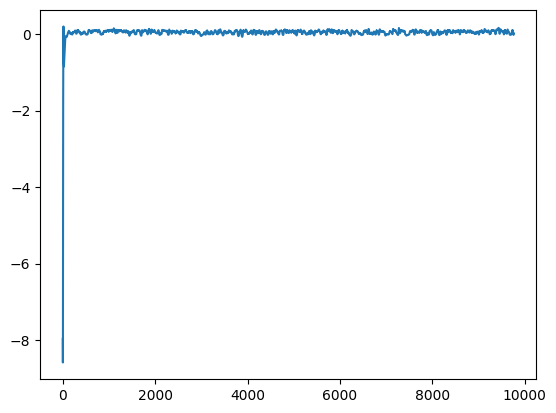

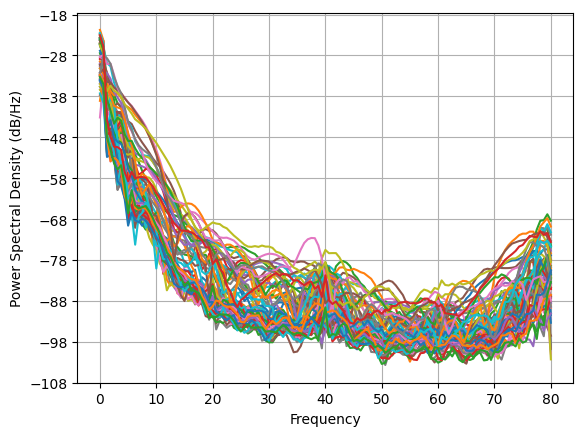

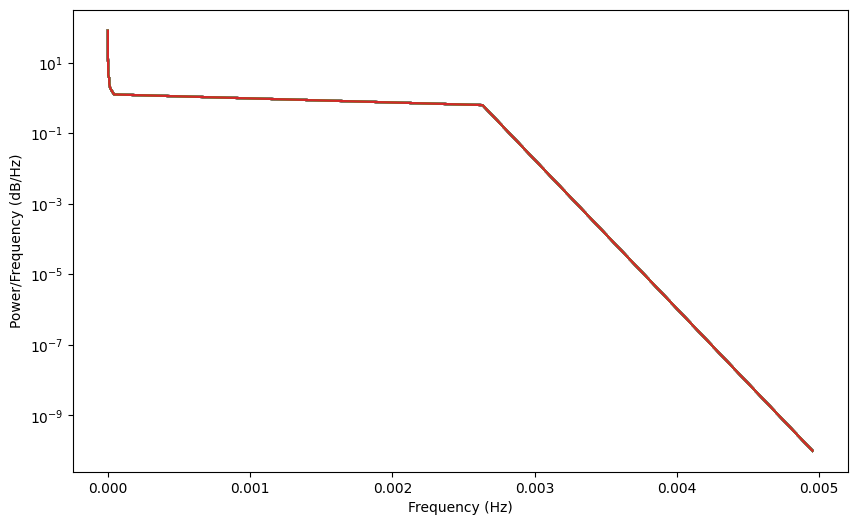

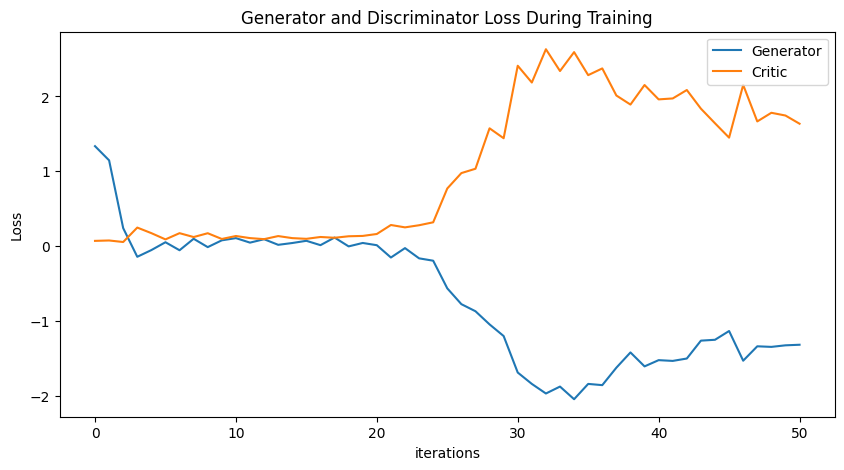

Epoch 60: Critic error ([1.3351855210010803, 1.1454546821519997, 0.23895989472068882, -0.14441030949818118, -0.0547241054929004, 0.05018282443223861, -0.0569371693437401, 0.0965026775725221, -0.015188734136256599, 0.0757810015051624, 0.10522698311417755, 0.044883081377492, 0.09055948293566674, 0.015579117076589433, 0.03971737365776011, 0.06942058231304918, 0.010981199929381139, 0.11303119867816389, -0.0053947597041621165, 0.04042767971234011, 0.010426053633104157, -0.15420087472995683, -0.028438796394360283, -0.16530946774731178, -0.19684792691976072, -0.5665998218929676, -0.7780401535161873, -0.8727111444726007, -1.0484508704778472, -1.204531719783672, -1.692393697903823, -1.8446691202121464, -1.9729912761413242, -1.880282863207143, -2.049501202708115, -1.8446753221112513, -1.8611464965157236, -1.6276686406674827, -1.42375811949698, -1.6103235493648431, -1.5268971707797259, -1.5370890893282096, -1.5051424388867836, -1.2660006413869016, -1.2544148349465625, -1.1370651914760148, -1.5342

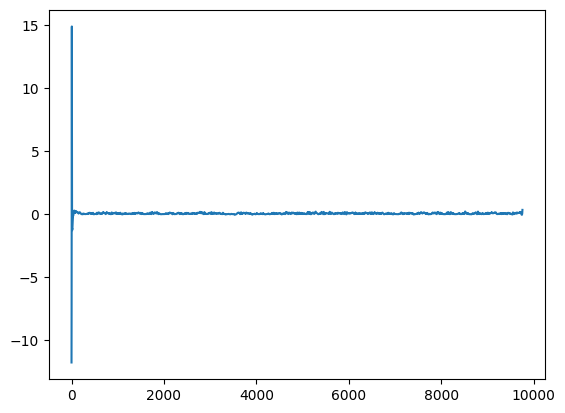

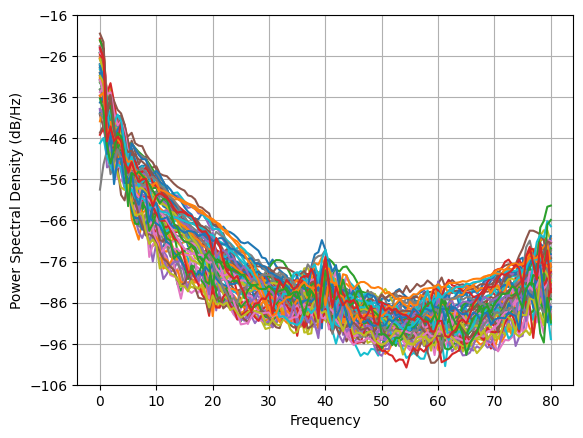

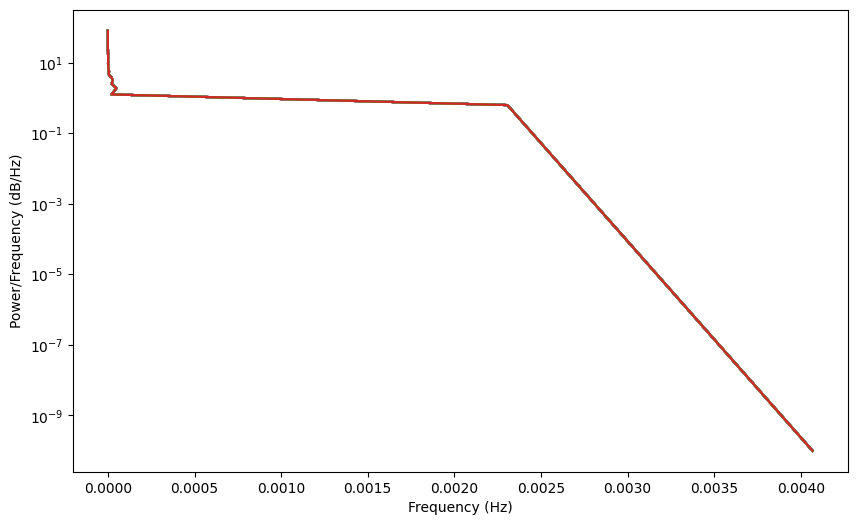

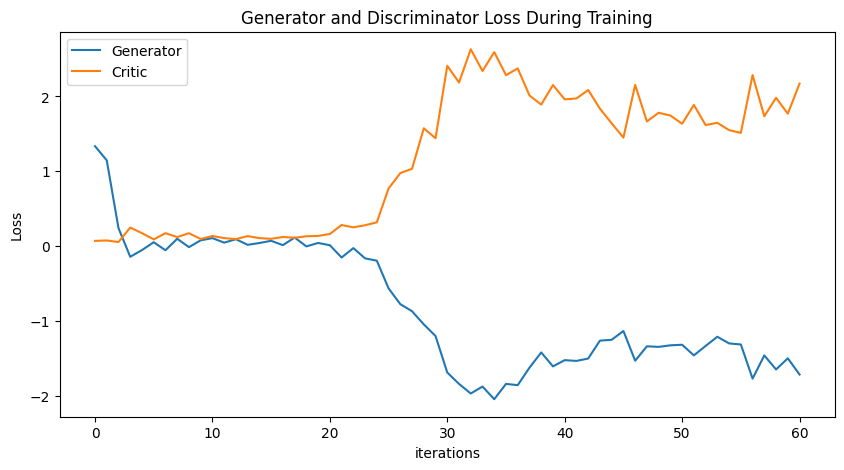

Epoch 70: Critic error ([1.3351855210010803, 1.1454546821519997, 0.23895989472068882, -0.14441030949818118, -0.0547241054929004, 0.05018282443223861, -0.0569371693437401, 0.0965026775725221, -0.015188734136256599, 0.0757810015051624, 0.10522698311417755, 0.044883081377492, 0.09055948293566674, 0.015579117076589433, 0.03971737365776011, 0.06942058231304918, 0.010981199929381139, 0.11303119867816389, -0.0053947597041621165, 0.04042767971234011, 0.010426053633104157, -0.15420087472995683, -0.028438796394360283, -0.16530946774731178, -0.19684792691976072, -0.5665998218929676, -0.7780401535161873, -0.8727111444726007, -1.0484508704778472, -1.204531719783672, -1.692393697903823, -1.8446691202121464, -1.9729912761413242, -1.880282863207143, -2.049501202708115, -1.8446753221112513, -1.8611464965157236, -1.6276686406674827, -1.42375811949698, -1.6103235493648431, -1.5268971707797259, -1.5370890893282096, -1.5051424388867836, -1.2660006413869016, -1.2544148349465625, -1.1370651914760148, -1.5342

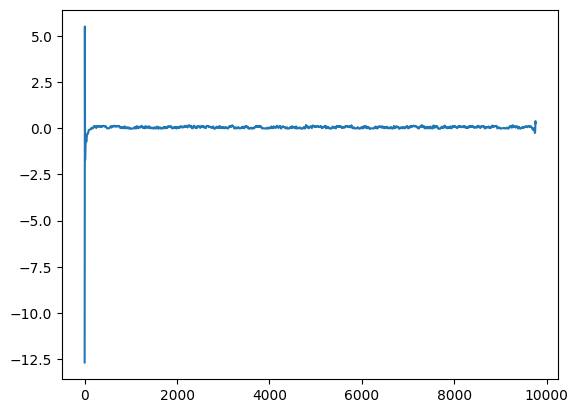

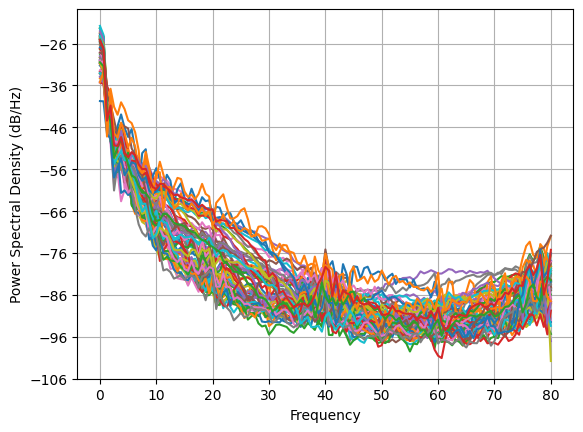

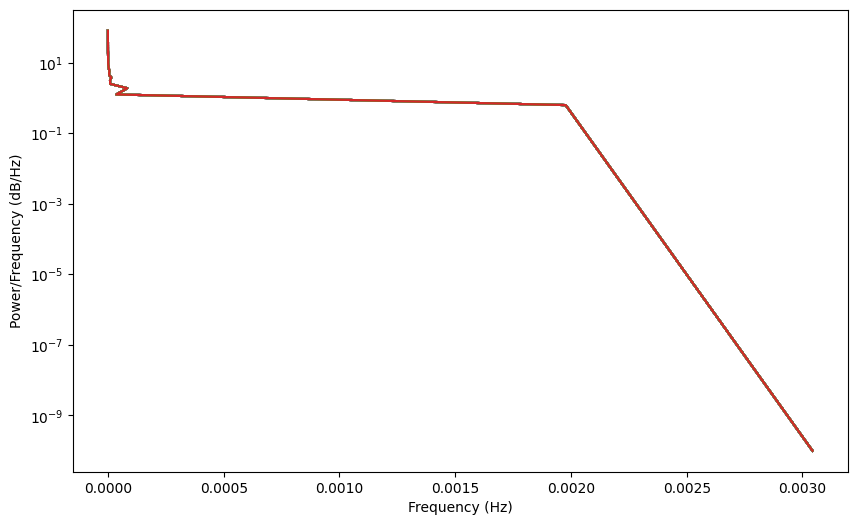

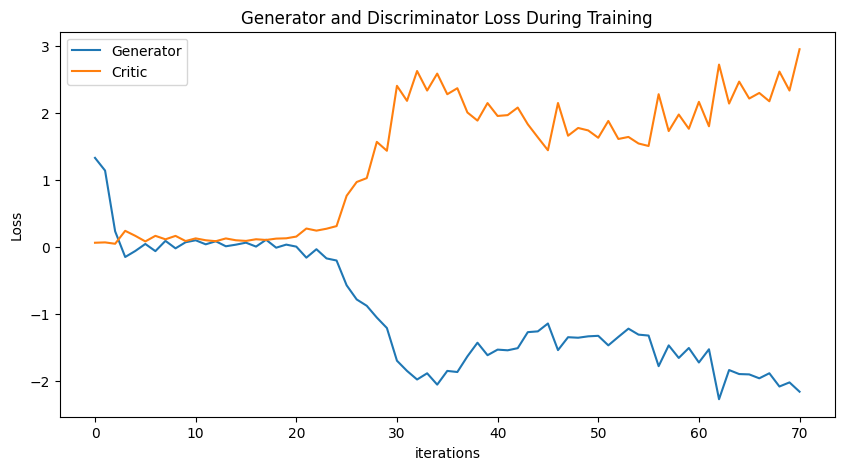

Epoch 80: Critic error ([1.3351855210010803, 1.1454546821519997, 0.23895989472068882, -0.14441030949818118, -0.0547241054929004, 0.05018282443223861, -0.0569371693437401, 0.0965026775725221, -0.015188734136256599, 0.0757810015051624, 0.10522698311417755, 0.044883081377492, 0.09055948293566674, 0.015579117076589433, 0.03971737365776011, 0.06942058231304918, 0.010981199929381139, 0.11303119867816389, -0.0053947597041621165, 0.04042767971234011, 0.010426053633104157, -0.15420087472995683, -0.028438796394360283, -0.16530946774731178, -0.19684792691976072, -0.5665998218929676, -0.7780401535161873, -0.8727111444726007, -1.0484508704778472, -1.204531719783672, -1.692393697903823, -1.8446691202121464, -1.9729912761413242, -1.880282863207143, -2.049501202708115, -1.8446753221112513, -1.8611464965157236, -1.6276686406674827, -1.42375811949698, -1.6103235493648431, -1.5268971707797259, -1.5370890893282096, -1.5051424388867836, -1.2660006413869016, -1.2544148349465625, -1.1370651914760148, -1.5342

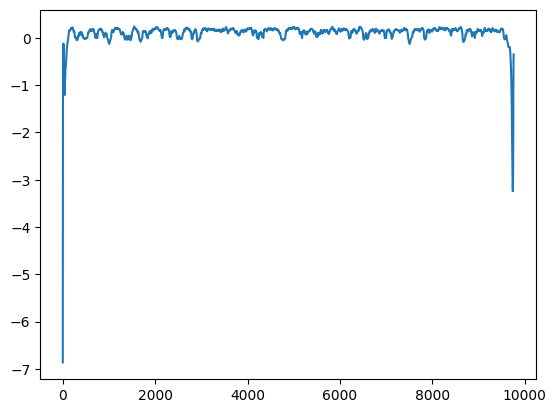

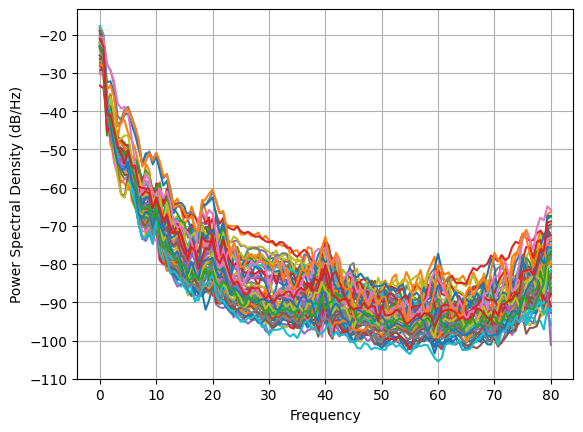

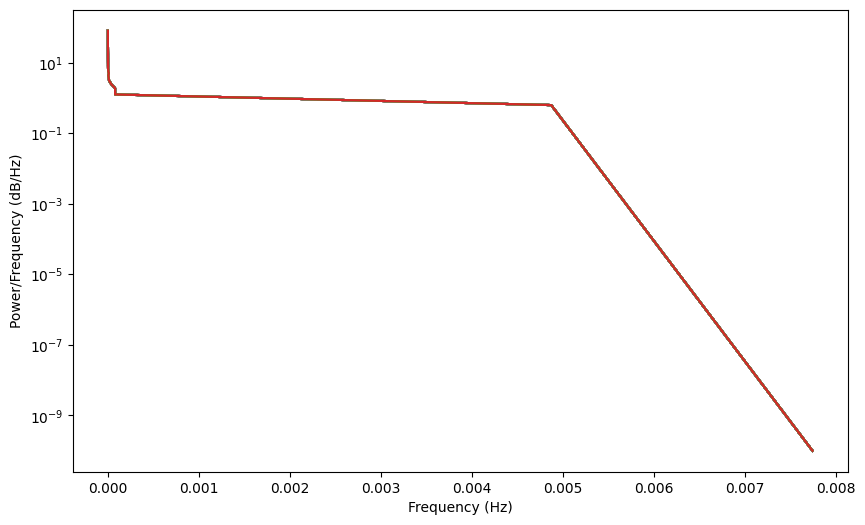

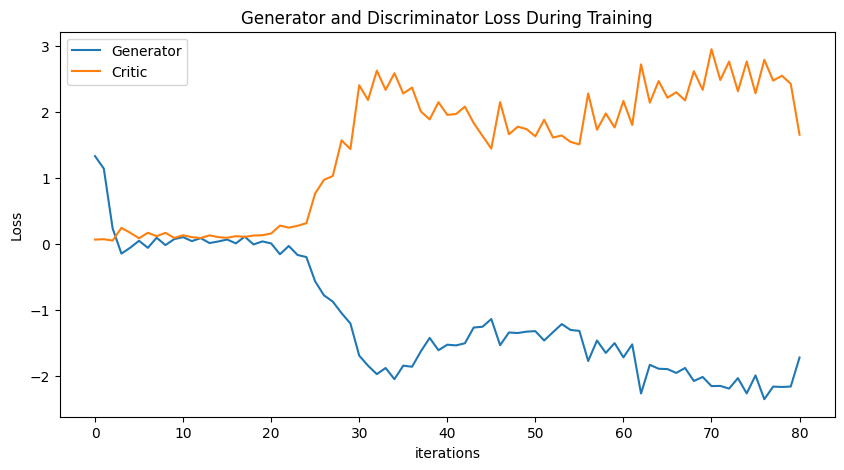

Epoch 90: Critic error ([1.3351855210010803, 1.1454546821519997, 0.23895989472068882, -0.14441030949818118, -0.0547241054929004, 0.05018282443223861, -0.0569371693437401, 0.0965026775725221, -0.015188734136256599, 0.0757810015051624, 0.10522698311417755, 0.044883081377492, 0.09055948293566674, 0.015579117076589433, 0.03971737365776011, 0.06942058231304918, 0.010981199929381139, 0.11303119867816389, -0.0053947597041621165, 0.04042767971234011, 0.010426053633104157, -0.15420087472995683, -0.028438796394360283, -0.16530946774731178, -0.19684792691976072, -0.5665998218929676, -0.7780401535161873, -0.8727111444726007, -1.0484508704778472, -1.204531719783672, -1.692393697903823, -1.8446691202121464, -1.9729912761413242, -1.880282863207143, -2.049501202708115, -1.8446753221112513, -1.8611464965157236, -1.6276686406674827, -1.42375811949698, -1.6103235493648431, -1.5268971707797259, -1.5370890893282096, -1.5051424388867836, -1.2660006413869016, -1.2544148349465625, -1.1370651914760148, -1.5342

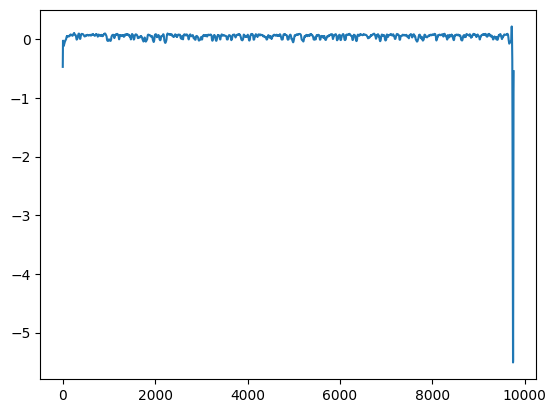

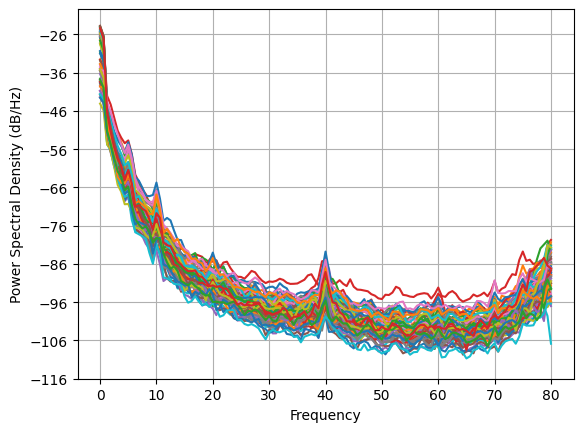

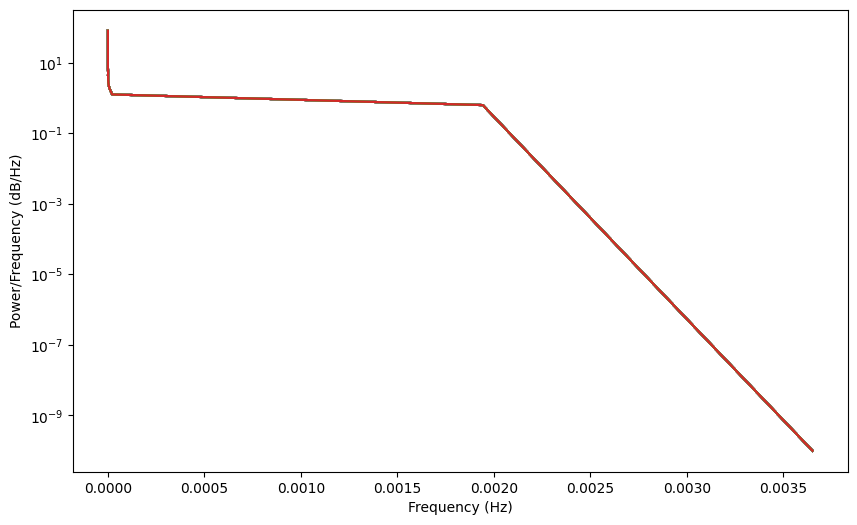

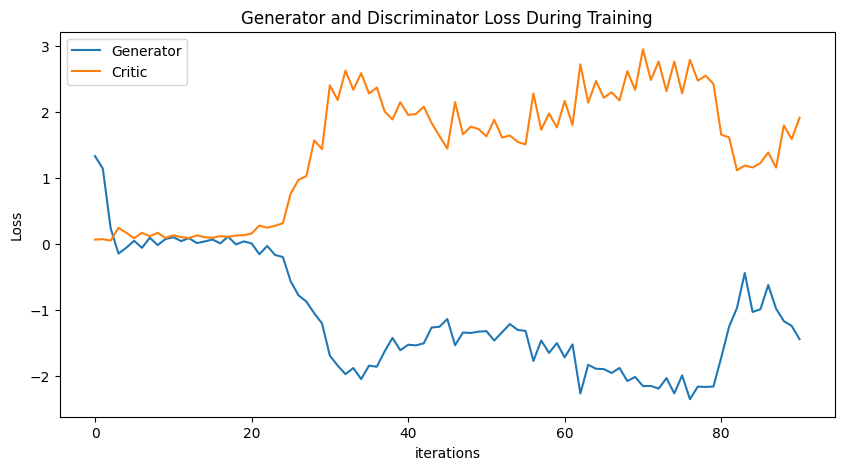

Epoch 100: Critic error ([1.3351855210010803, 1.1454546821519997, 0.23895989472068882, -0.14441030949818118, -0.0547241054929004, 0.05018282443223861, -0.0569371693437401, 0.0965026775725221, -0.015188734136256599, 0.0757810015051624, 0.10522698311417755, 0.044883081377492, 0.09055948293566674, 0.015579117076589433, 0.03971737365776011, 0.06942058231304918, 0.010981199929381139, 0.11303119867816389, -0.0053947597041621165, 0.04042767971234011, 0.010426053633104157, -0.15420087472995683, -0.028438796394360283, -0.16530946774731178, -0.19684792691976072, -0.5665998218929676, -0.7780401535161873, -0.8727111444726007, -1.0484508704778472, -1.204531719783672, -1.692393697903823, -1.8446691202121464, -1.9729912761413242, -1.880282863207143, -2.049501202708115, -1.8446753221112513, -1.8611464965157236, -1.6276686406674827, -1.42375811949698, -1.6103235493648431, -1.5268971707797259, -1.5370890893282096, -1.5051424388867836, -1.2660006413869016, -1.2544148349465625, -1.1370651914760148, -1.534

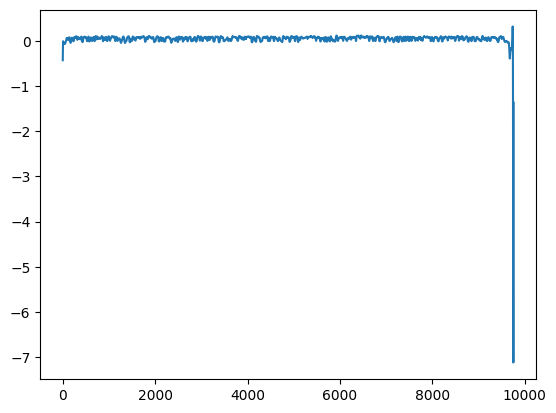

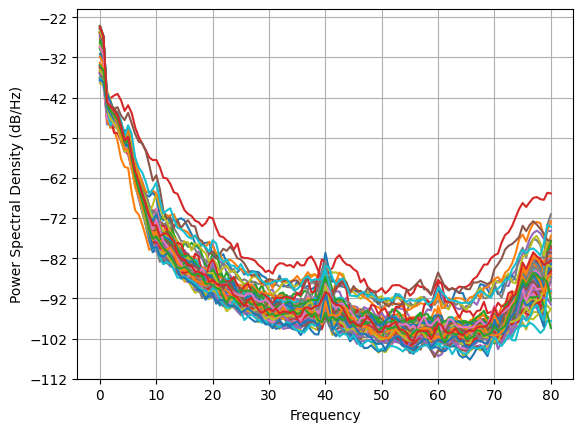

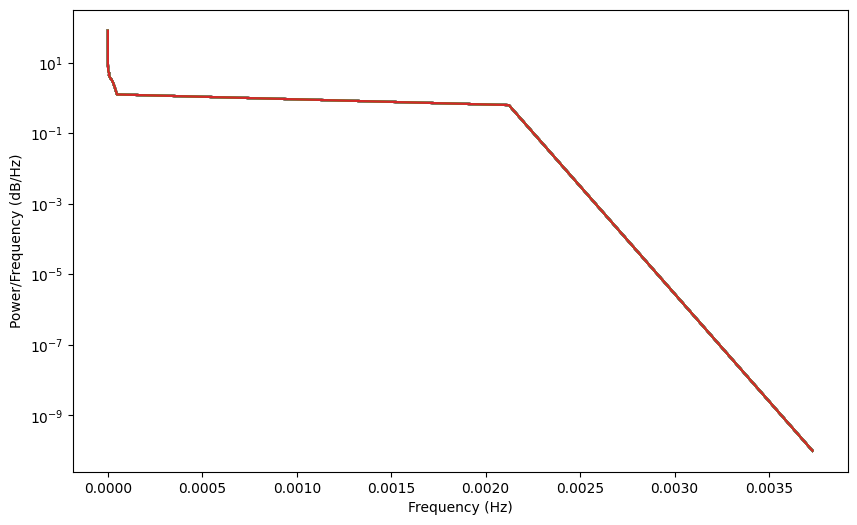

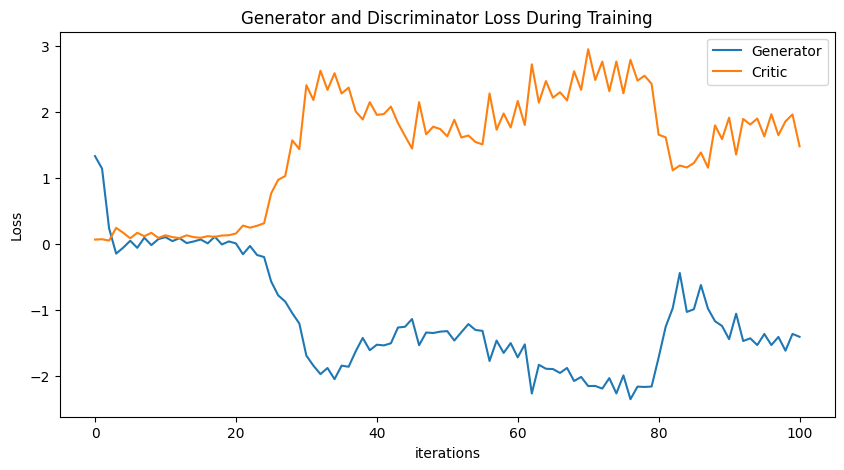

Epoch 110: Critic error ([1.3351855210010803, 1.1454546821519997, 0.23895989472068882, -0.14441030949818118, -0.0547241054929004, 0.05018282443223861, -0.0569371693437401, 0.0965026775725221, -0.015188734136256599, 0.0757810015051624, 0.10522698311417755, 0.044883081377492, 0.09055948293566674, 0.015579117076589433, 0.03971737365776011, 0.06942058231304918, 0.010981199929381139, 0.11303119867816389, -0.0053947597041621165, 0.04042767971234011, 0.010426053633104157, -0.15420087472995683, -0.028438796394360283, -0.16530946774731178, -0.19684792691976072, -0.5665998218929676, -0.7780401535161873, -0.8727111444726007, -1.0484508704778472, -1.204531719783672, -1.692393697903823, -1.8446691202121464, -1.9729912761413242, -1.880282863207143, -2.049501202708115, -1.8446753221112513, -1.8611464965157236, -1.6276686406674827, -1.42375811949698, -1.6103235493648431, -1.5268971707797259, -1.5370890893282096, -1.5051424388867836, -1.2660006413869016, -1.2544148349465625, -1.1370651914760148, -1.534

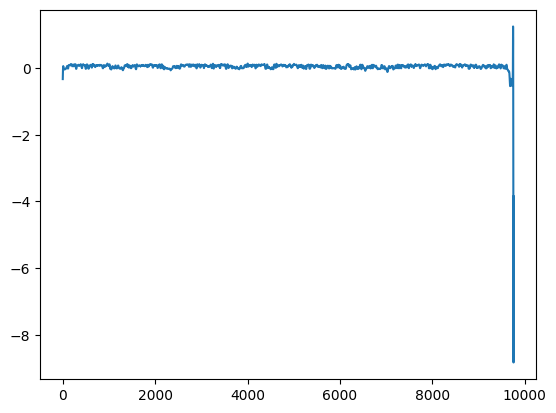

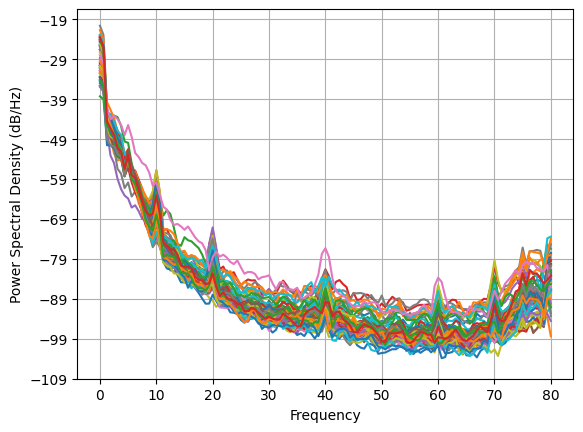

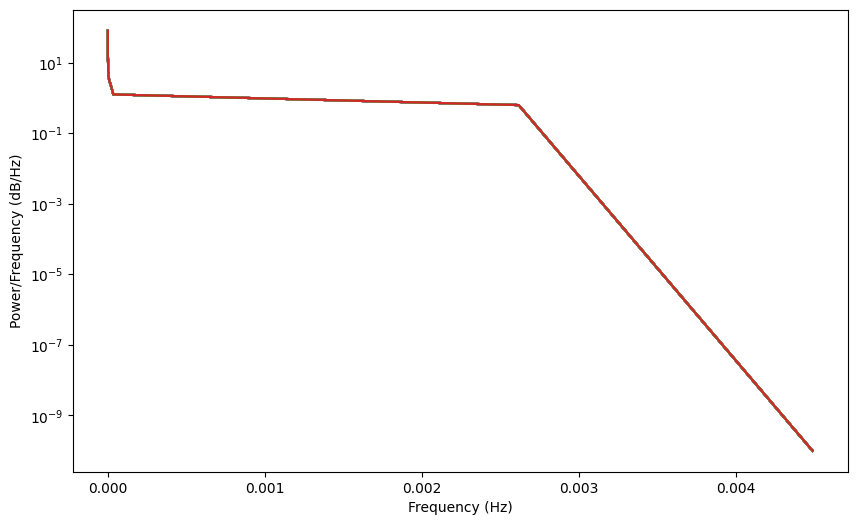

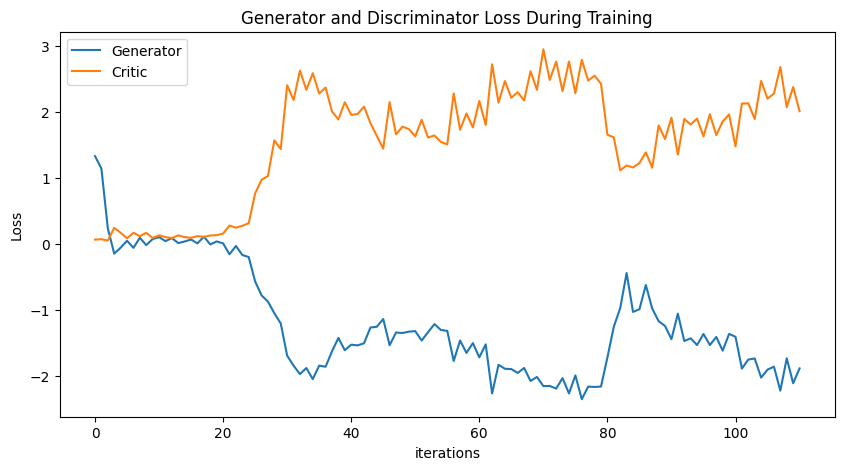

Epoch 120: Critic error ([1.3351855210010803, 1.1454546821519997, 0.23895989472068882, -0.14441030949818118, -0.0547241054929004, 0.05018282443223861, -0.0569371693437401, 0.0965026775725221, -0.015188734136256599, 0.0757810015051624, 0.10522698311417755, 0.044883081377492, 0.09055948293566674, 0.015579117076589433, 0.03971737365776011, 0.06942058231304918, 0.010981199929381139, 0.11303119867816389, -0.0053947597041621165, 0.04042767971234011, 0.010426053633104157, -0.15420087472995683, -0.028438796394360283, -0.16530946774731178, -0.19684792691976072, -0.5665998218929676, -0.7780401535161873, -0.8727111444726007, -1.0484508704778472, -1.204531719783672, -1.692393697903823, -1.8446691202121464, -1.9729912761413242, -1.880282863207143, -2.049501202708115, -1.8446753221112513, -1.8611464965157236, -1.6276686406674827, -1.42375811949698, -1.6103235493648431, -1.5268971707797259, -1.5370890893282096, -1.5051424388867836, -1.2660006413869016, -1.2544148349465625, -1.1370651914760148, -1.534

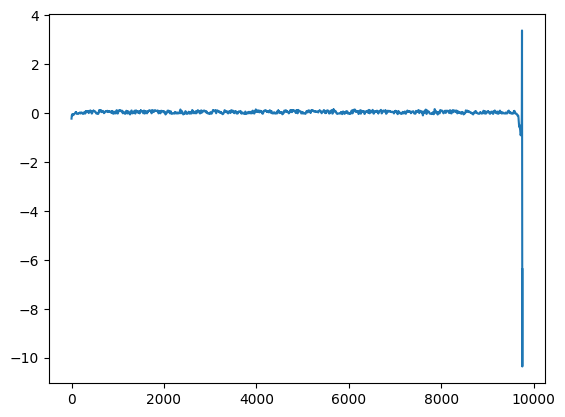

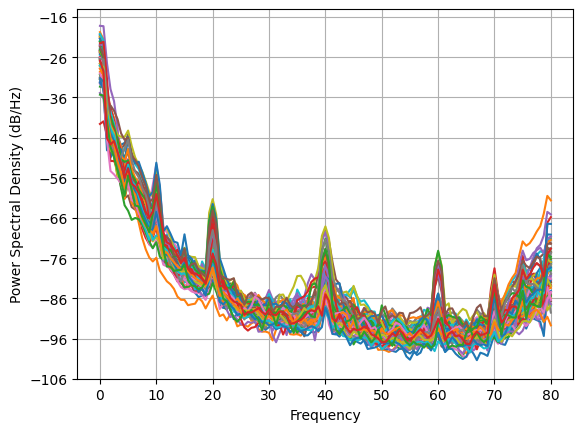

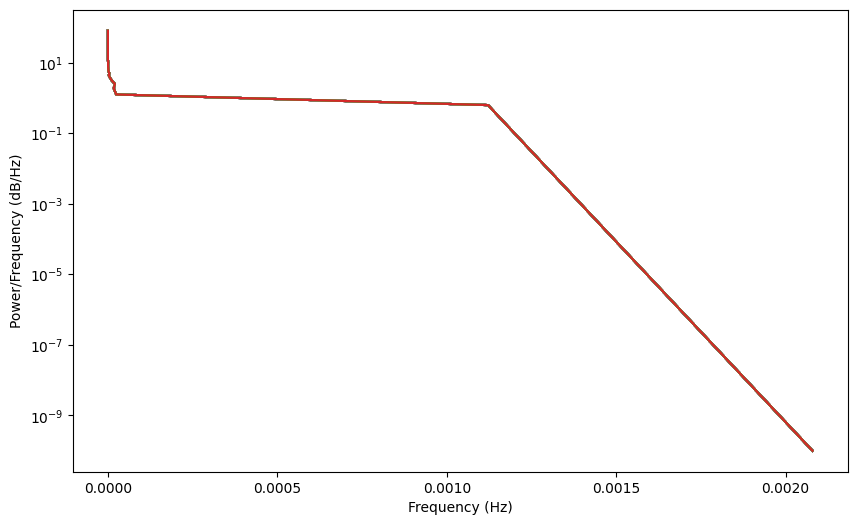

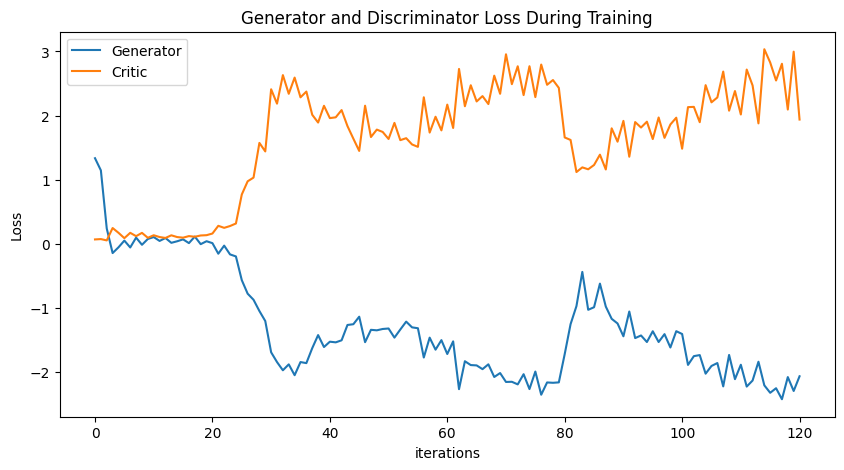

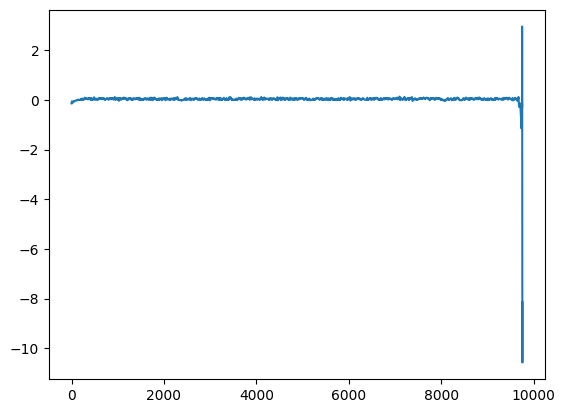

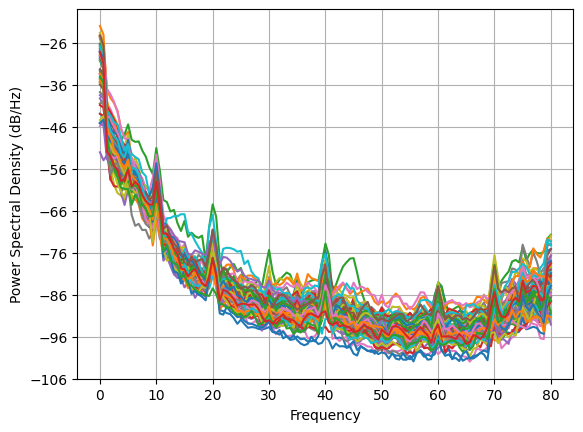

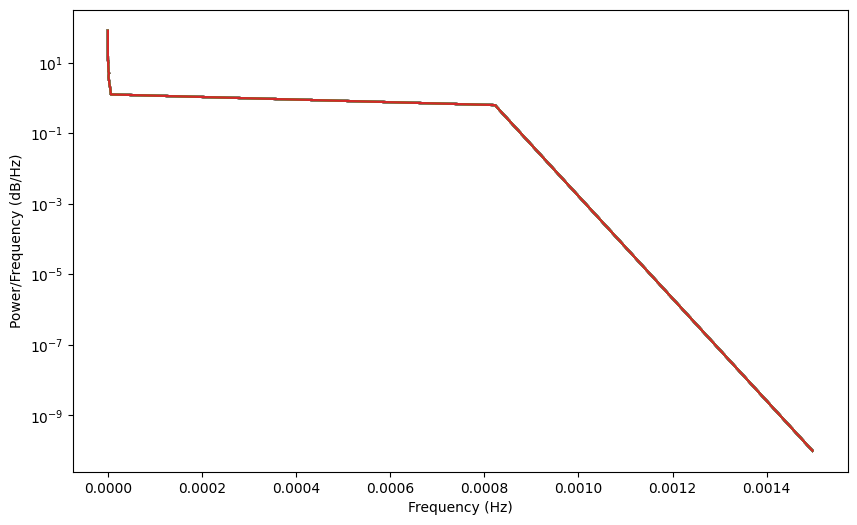

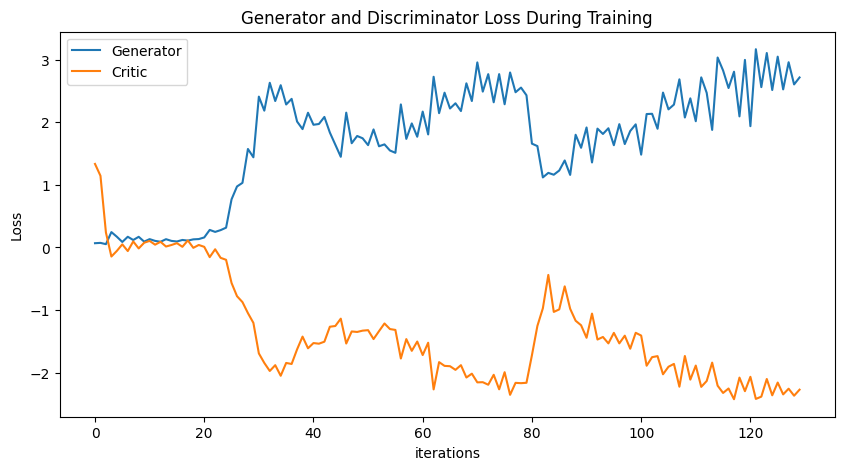

In [16]:
NUM_EPOCHS = 130
PRINT_INTERVAL = 10
training_data = torch.tensor(np.load('training_open.npy'))
BATCH_SIZE = np.shape(training_data)[0]

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 640, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1)
            critic_fake = D(fake).reshape(-1)
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()
            critic_optimizer.zero_grad()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        gen_optimizer.zero_grad()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(generated_data, critic_err, gen_err)

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data_open, disc, gen = train()

torch.save(gen, 'gen_FINAL1_open.pt')
torch.save(disc, 'disc_FINAL1_open.pt')
np.save('complex-open.npy', generated_data_open.detach())
plot_everything(generated_data_open, gen_err, critic_err)
generated_data_open = None

Epoch 0: Critic error ([1.8264334089185883]) Generator err ([0.03248031064867973])


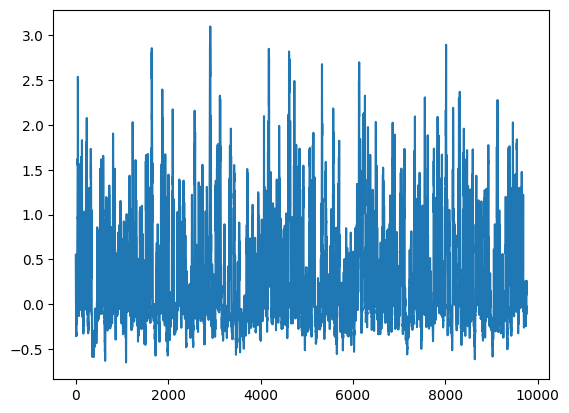

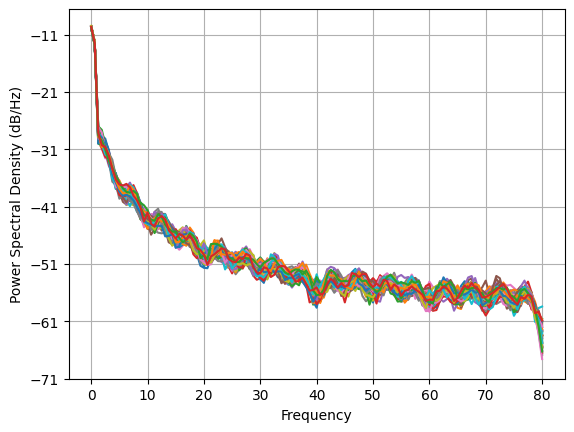

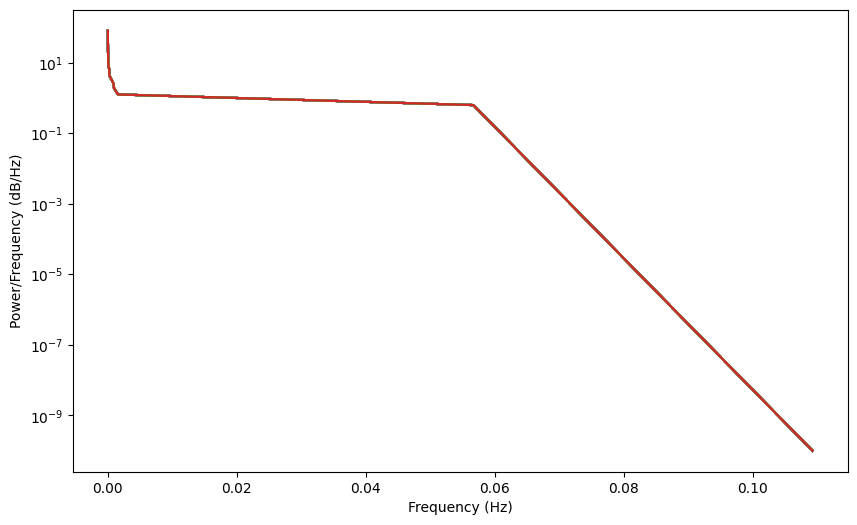

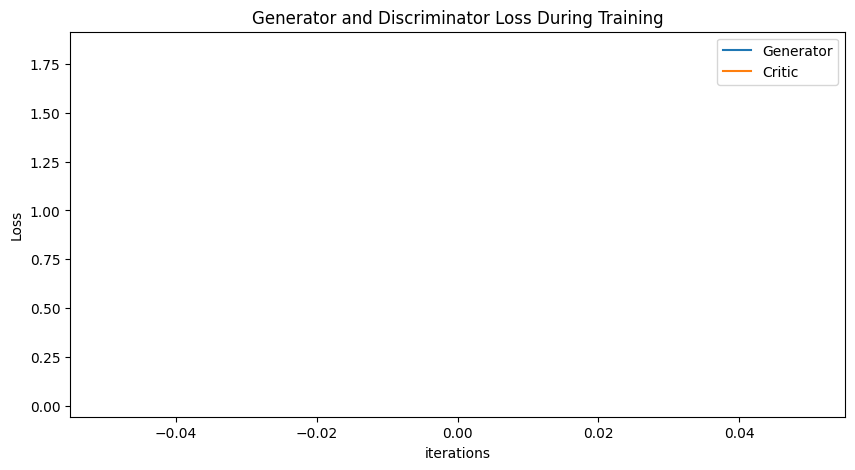

Epoch 10: Critic error ([1.8264334089185883, 1.2423659678178414, 0.12389627473788711, 0.012056891487889253, -0.04358463147655253, -0.2500785090806069, -0.14515403450987696, -0.2808616029379748, 0.012696776924949638, -0.08024498345545034, 0.01345730847284099]) Generator err ([0.03248031064867973, 0.010544486343860626, 0.018888967111706734, 0.049192264676094055, 0.11244716495275497, 0.36432573199272156, 0.3154541552066803, 0.39667245745658875, 0.2738531529903412, 0.2566761374473572, 0.22425274550914764])


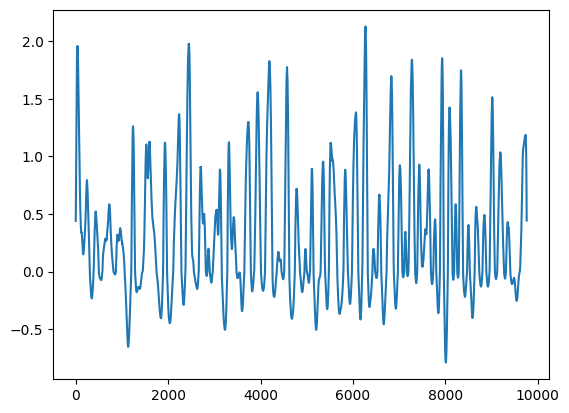

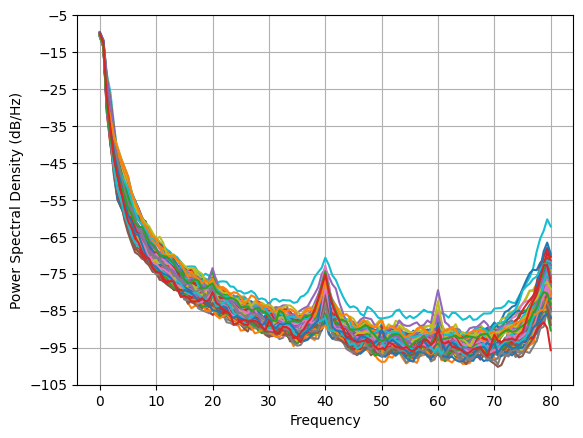

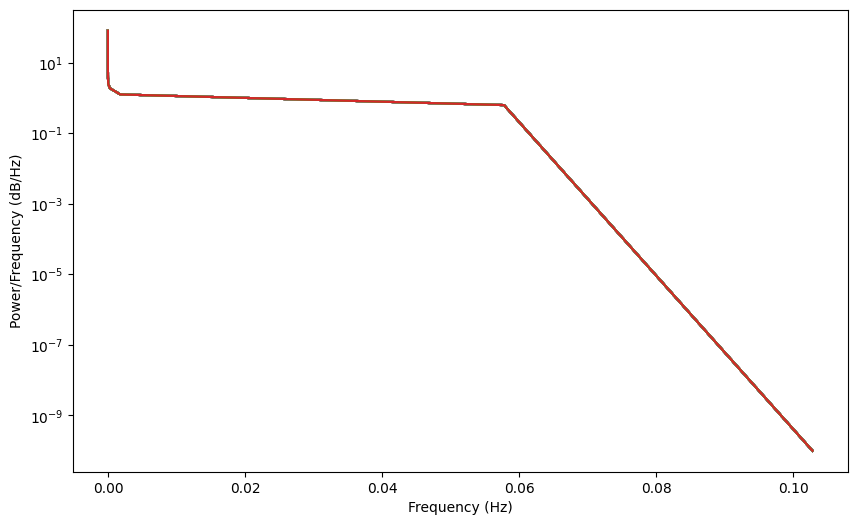

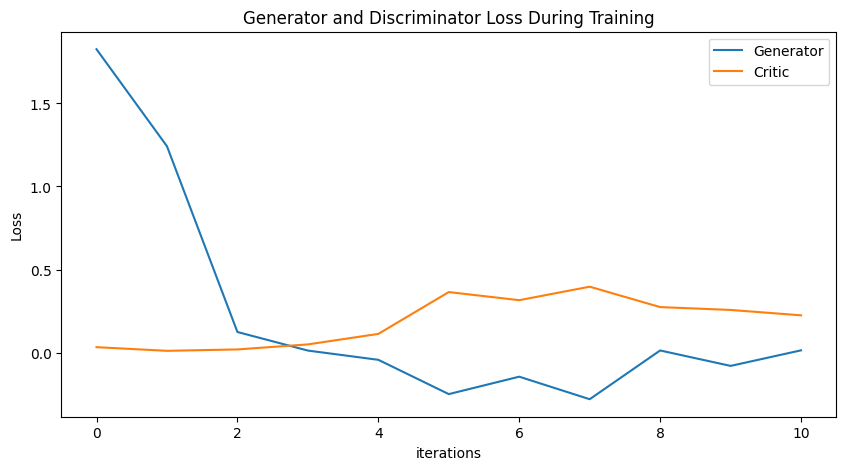

Epoch 20: Critic error ([1.8264334089185883, 1.2423659678178414, 0.12389627473788711, 0.012056891487889253, -0.04358463147655253, -0.2500785090806069, -0.14515403450987696, -0.2808616029379748, 0.012696776924949638, -0.08024498345545034, 0.01345730847284099, -0.053555110911149145, -0.1490088985829475, -0.481653089647959, -0.6459408744589094, -0.8110857214240685, -0.8191183042887766, -1.191360196023375, -1.3923246099509072, -1.4939039839104153, -0.9867567959728697]) Generator err ([0.03248031064867973, 0.010544486343860626, 0.018888967111706734, 0.049192264676094055, 0.11244716495275497, 0.36432573199272156, 0.3154541552066803, 0.39667245745658875, 0.2738531529903412, 0.2566761374473572, 0.22425274550914764, 0.25953012704849243, 0.3996976613998413, 0.7165892720222473, 0.8342934846878052, 0.9797831177711487, 1.3363510370254517, 1.3103665113449097, 1.9843136072158813, 1.5057618618011475, 1.4787108898162842])


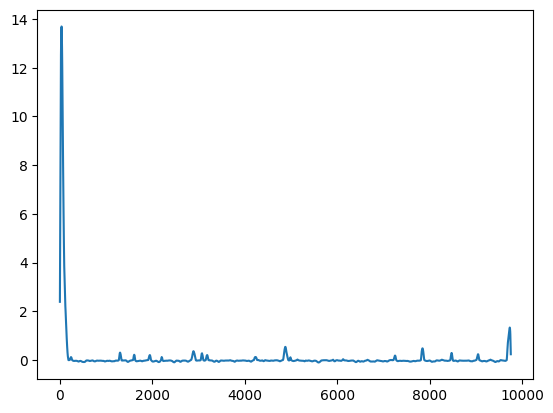

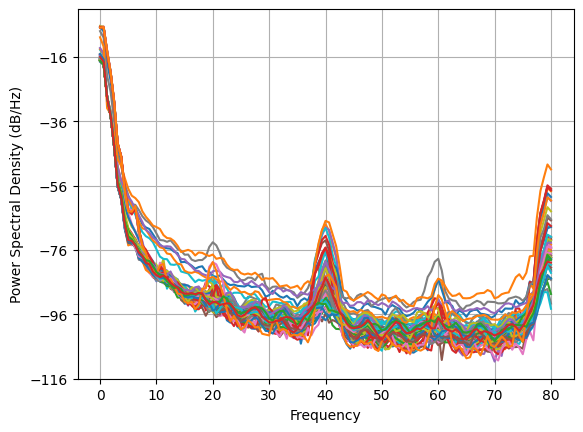

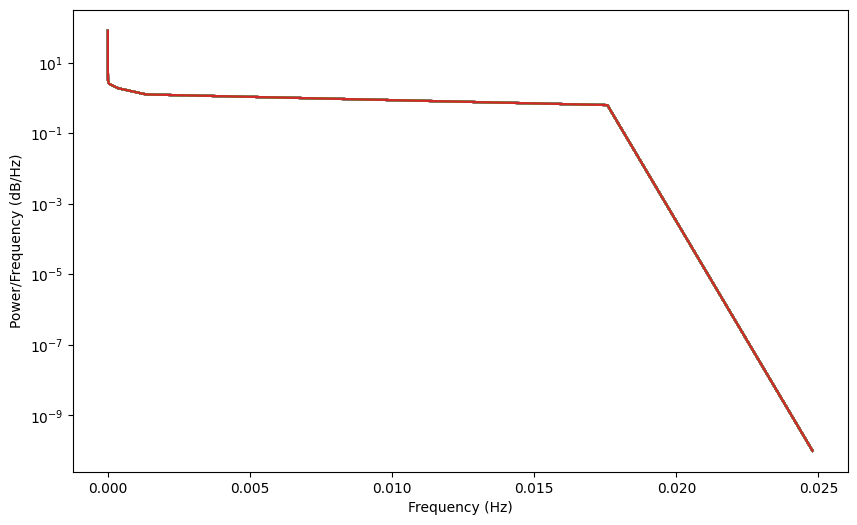

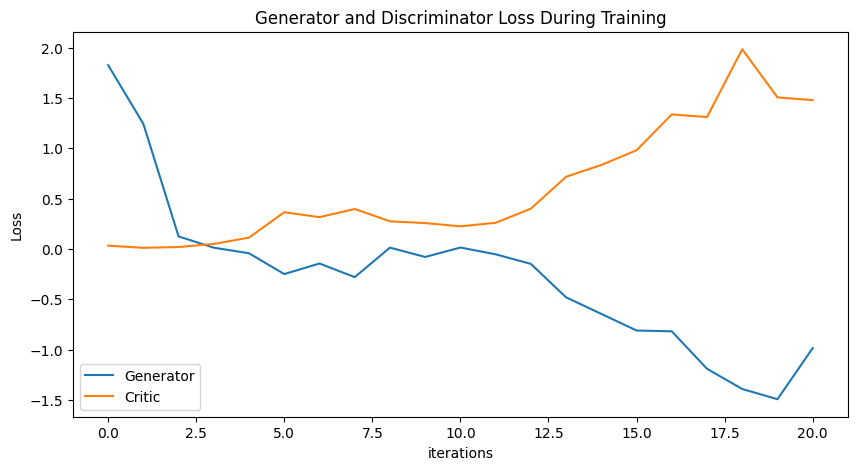

Epoch 30: Critic error ([1.8264334089185883, 1.2423659678178414, 0.12389627473788711, 0.012056891487889253, -0.04358463147655253, -0.2500785090806069, -0.14515403450987696, -0.2808616029379748, 0.012696776924949638, -0.08024498345545034, 0.01345730847284099, -0.053555110911149145, -0.1490088985829475, -0.481653089647959, -0.6459408744589094, -0.8110857214240685, -0.8191183042887766, -1.191360196023375, -1.3923246099509072, -1.4939039839104153, -0.9867567959728697, -0.939174374033741, -0.9439010985909159, -1.130508398141421, -1.2797913014053697, -1.8091860329912755, -2.106912181630736, -2.073371218945991, -1.741611448713781, -1.4749941620700076, -1.5638996464619386]) Generator err ([0.03248031064867973, 0.010544486343860626, 0.018888967111706734, 0.049192264676094055, 0.11244716495275497, 0.36432573199272156, 0.3154541552066803, 0.39667245745658875, 0.2738531529903412, 0.2566761374473572, 0.22425274550914764, 0.25953012704849243, 0.3996976613998413, 0.7165892720222473, 0.834293484687805

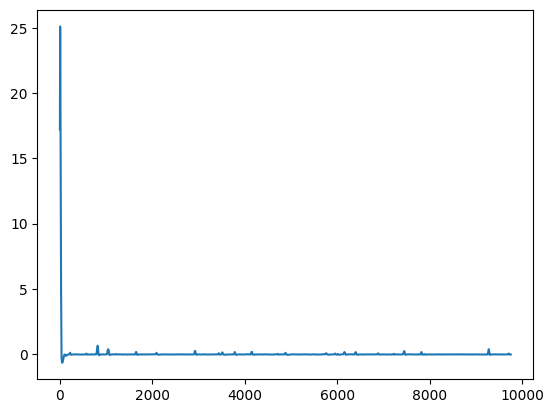

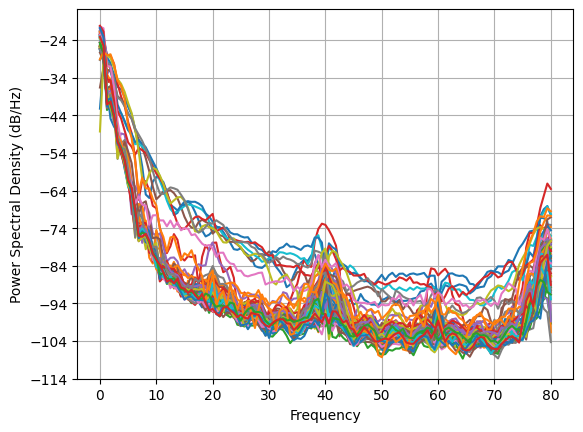

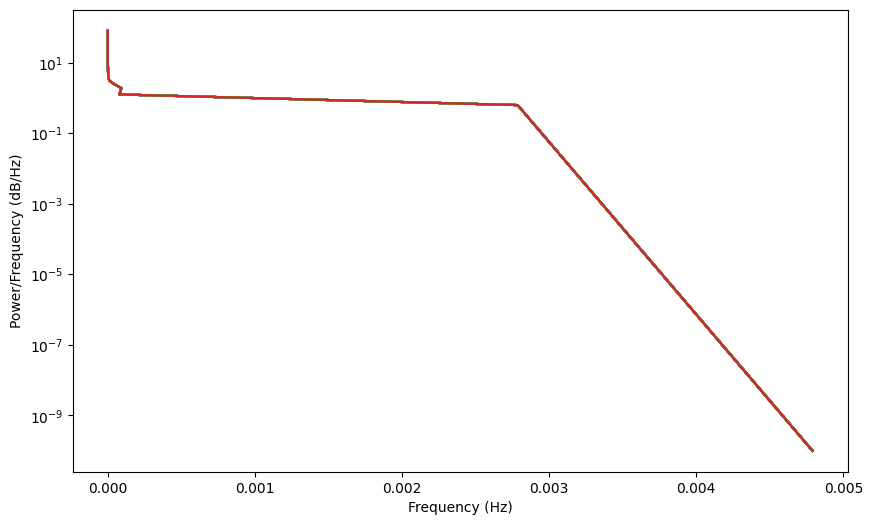

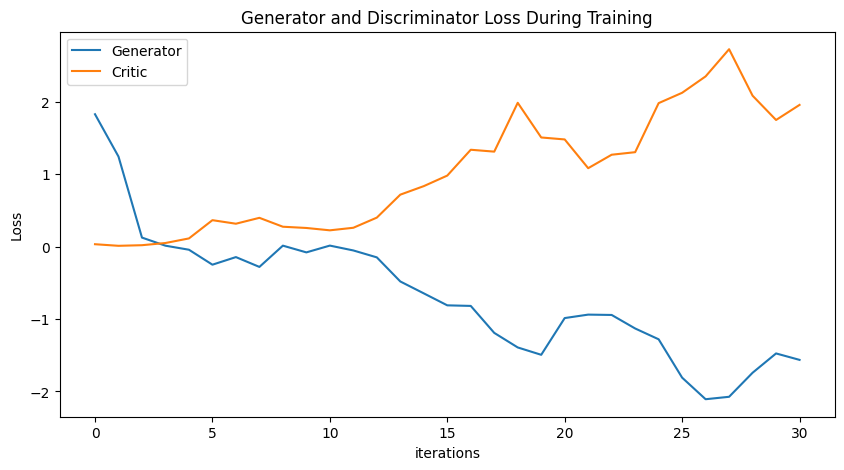

Epoch 40: Critic error ([1.8264334089185883, 1.2423659678178414, 0.12389627473788711, 0.012056891487889253, -0.04358463147655253, -0.2500785090806069, -0.14515403450987696, -0.2808616029379748, 0.012696776924949638, -0.08024498345545034, 0.01345730847284099, -0.053555110911149145, -0.1490088985829475, -0.481653089647959, -0.6459408744589094, -0.8110857214240685, -0.8191183042887766, -1.191360196023375, -1.3923246099509072, -1.4939039839104153, -0.9867567959728697, -0.939174374033741, -0.9439010985909159, -1.130508398141421, -1.2797913014053697, -1.8091860329912755, -2.106912181630736, -2.073371218945991, -1.741611448713781, -1.4749941620700076, -1.5638996464619386, -0.8591007689606854, -0.8477450651678754, -0.8787081461593661, -0.9150682154765513, -0.9567433858882582, -0.9079217926209503, -1.0857234871312753, -0.9976619999427864, -1.1894297568119283, -1.0704649147753322]) Generator err ([0.03248031064867973, 0.010544486343860626, 0.018888967111706734, 0.049192264676094055, 0.1124471649

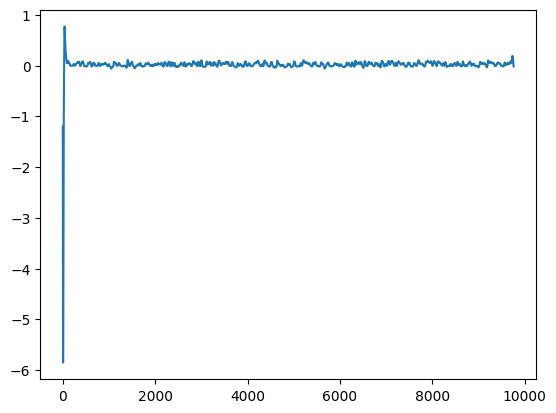

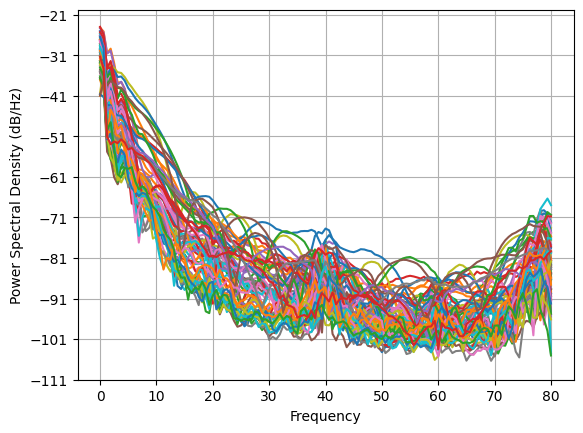

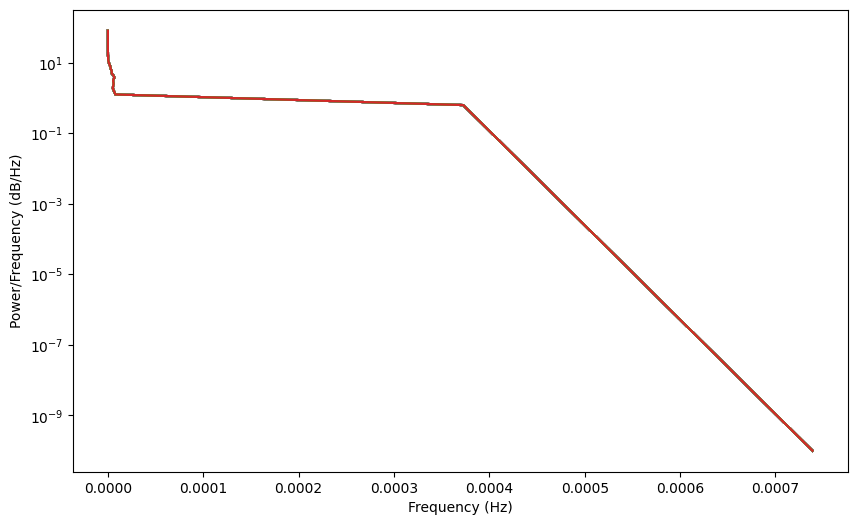

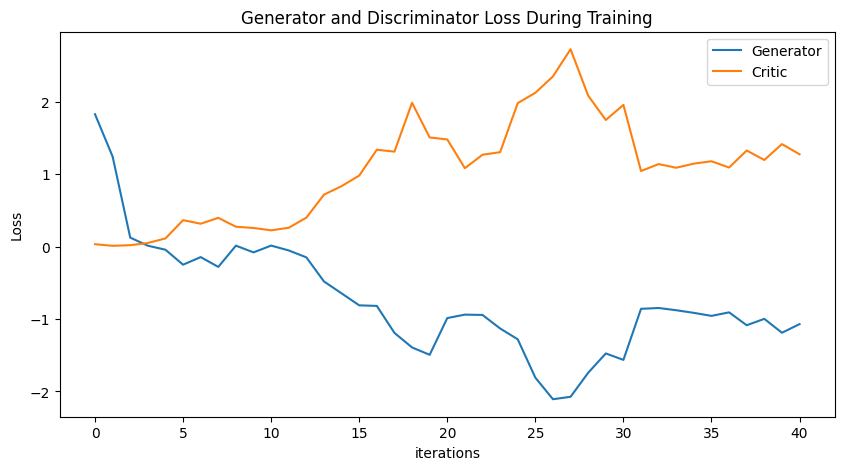

Epoch 50: Critic error ([1.8264334089185883, 1.2423659678178414, 0.12389627473788711, 0.012056891487889253, -0.04358463147655253, -0.2500785090806069, -0.14515403450987696, -0.2808616029379748, 0.012696776924949638, -0.08024498345545034, 0.01345730847284099, -0.053555110911149145, -0.1490088985829475, -0.481653089647959, -0.6459408744589094, -0.8110857214240685, -0.8191183042887766, -1.191360196023375, -1.3923246099509072, -1.4939039839104153, -0.9867567959728697, -0.939174374033741, -0.9439010985909159, -1.130508398141421, -1.2797913014053697, -1.8091860329912755, -2.106912181630736, -2.073371218945991, -1.741611448713781, -1.4749941620700076, -1.5638996464619386, -0.8591007689606854, -0.8477450651678754, -0.8787081461593661, -0.9150682154765513, -0.9567433858882582, -0.9079217926209503, -1.0857234871312753, -0.9976619999427864, -1.1894297568119283, -1.0704649147753322, -1.2627880827572628, -1.2160270206575645, -1.3097102167428694, -1.249192655442032, -1.321075664299302, -1.2940571259

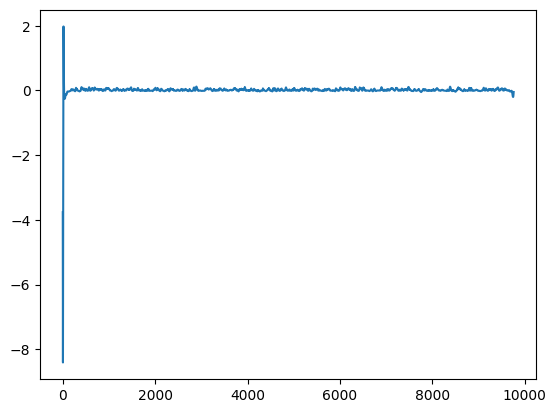

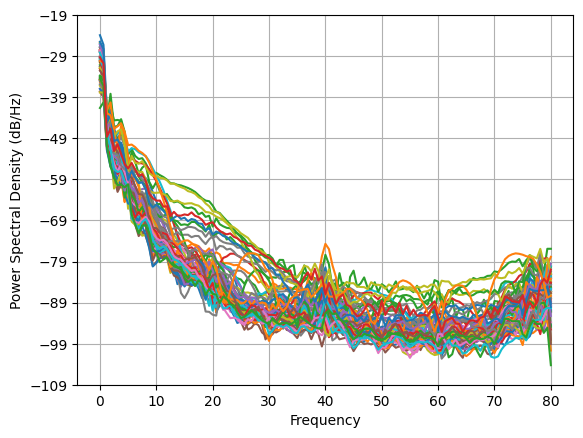

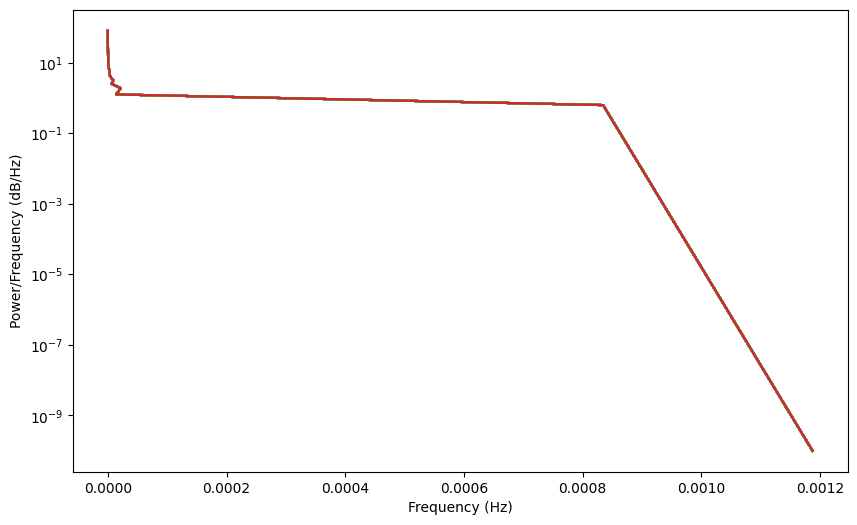

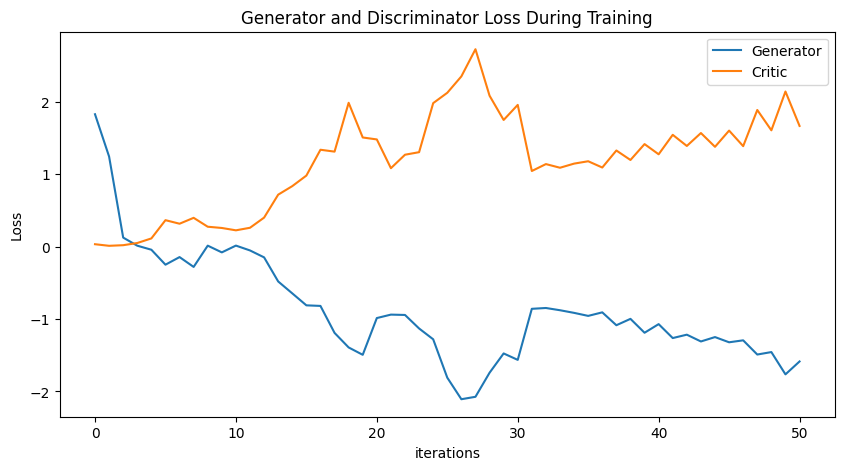

Epoch 60: Critic error ([1.8264334089185883, 1.2423659678178414, 0.12389627473788711, 0.012056891487889253, -0.04358463147655253, -0.2500785090806069, -0.14515403450987696, -0.2808616029379748, 0.012696776924949638, -0.08024498345545034, 0.01345730847284099, -0.053555110911149145, -0.1490088985829475, -0.481653089647959, -0.6459408744589094, -0.8110857214240685, -0.8191183042887766, -1.191360196023375, -1.3923246099509072, -1.4939039839104153, -0.9867567959728697, -0.939174374033741, -0.9439010985909159, -1.130508398141421, -1.2797913014053697, -1.8091860329912755, -2.106912181630736, -2.073371218945991, -1.741611448713781, -1.4749941620700076, -1.5638996464619386, -0.8591007689606854, -0.8477450651678754, -0.8787081461593661, -0.9150682154765513, -0.9567433858882582, -0.9079217926209503, -1.0857234871312753, -0.9976619999427864, -1.1894297568119283, -1.0704649147753322, -1.2627880827572628, -1.2160270206575645, -1.3097102167428694, -1.249192655442032, -1.321075664299302, -1.2940571259

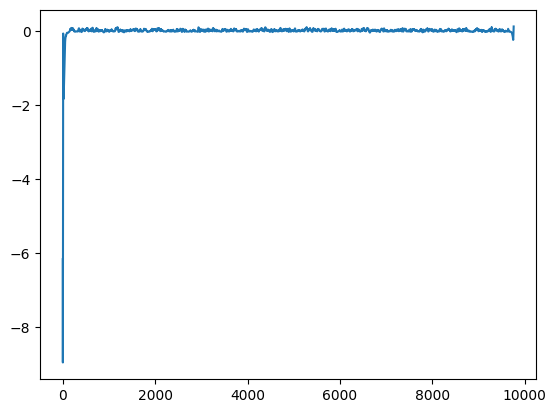

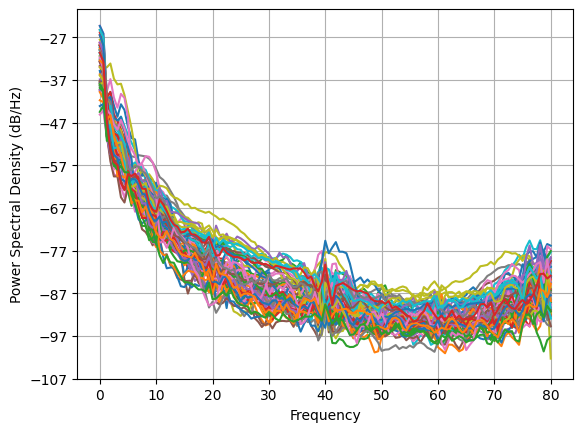

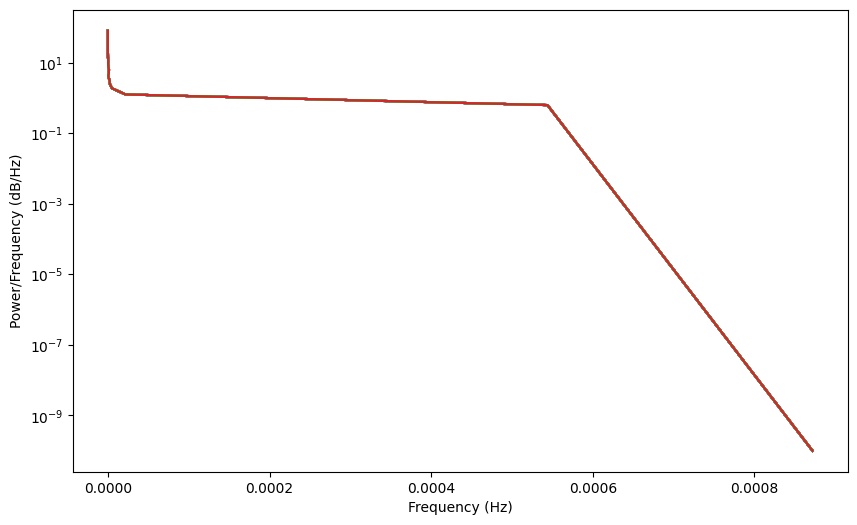

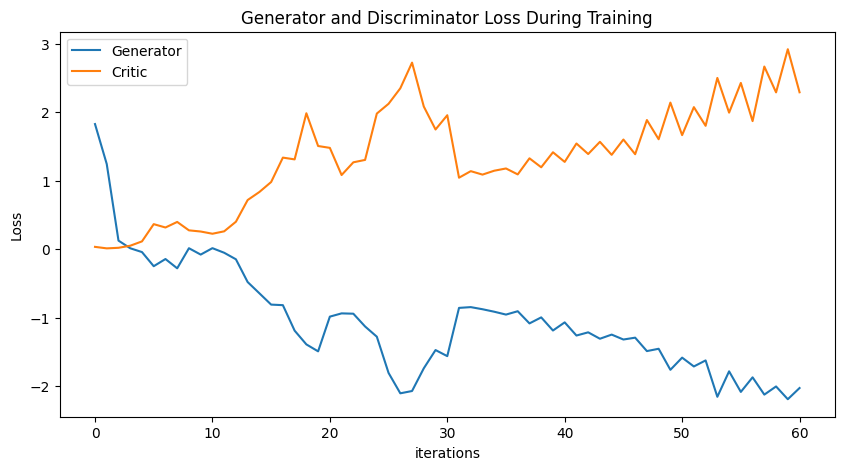

Epoch 70: Critic error ([1.8264334089185883, 1.2423659678178414, 0.12389627473788711, 0.012056891487889253, -0.04358463147655253, -0.2500785090806069, -0.14515403450987696, -0.2808616029379748, 0.012696776924949638, -0.08024498345545034, 0.01345730847284099, -0.053555110911149145, -0.1490088985829475, -0.481653089647959, -0.6459408744589094, -0.8110857214240685, -0.8191183042887766, -1.191360196023375, -1.3923246099509072, -1.4939039839104153, -0.9867567959728697, -0.939174374033741, -0.9439010985909159, -1.130508398141421, -1.2797913014053697, -1.8091860329912755, -2.106912181630736, -2.073371218945991, -1.741611448713781, -1.4749941620700076, -1.5638996464619386, -0.8591007689606854, -0.8477450651678754, -0.8787081461593661, -0.9150682154765513, -0.9567433858882582, -0.9079217926209503, -1.0857234871312753, -0.9976619999427864, -1.1894297568119283, -1.0704649147753322, -1.2627880827572628, -1.2160270206575645, -1.3097102167428694, -1.249192655442032, -1.321075664299302, -1.2940571259

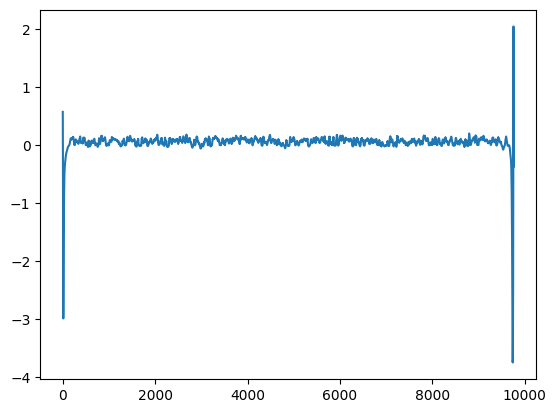

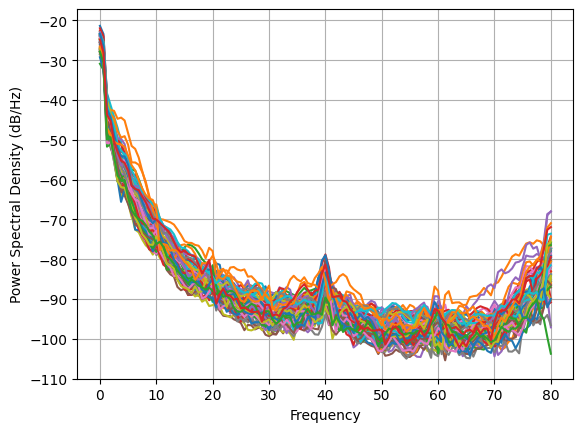

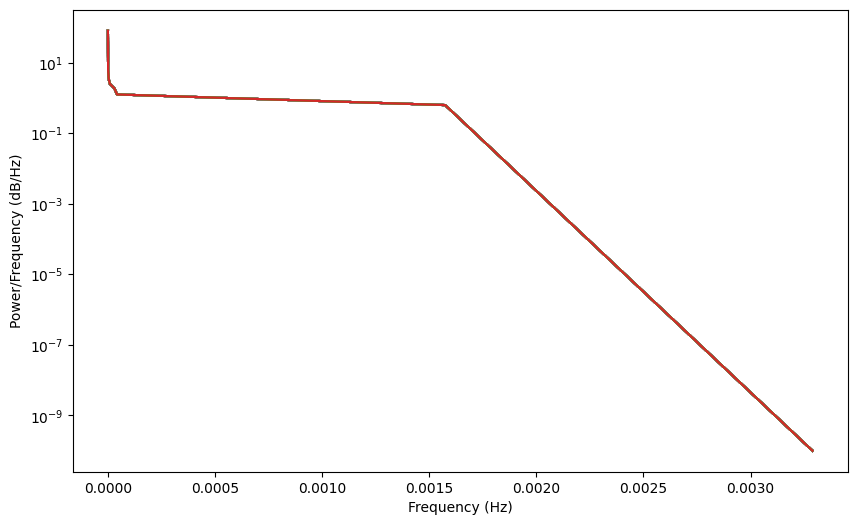

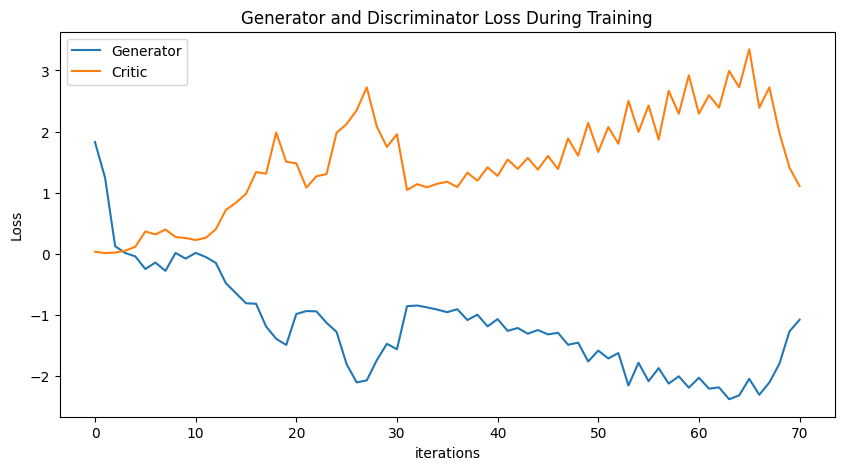

Epoch 80: Critic error ([1.8264334089185883, 1.2423659678178414, 0.12389627473788711, 0.012056891487889253, -0.04358463147655253, -0.2500785090806069, -0.14515403450987696, -0.2808616029379748, 0.012696776924949638, -0.08024498345545034, 0.01345730847284099, -0.053555110911149145, -0.1490088985829475, -0.481653089647959, -0.6459408744589094, -0.8110857214240685, -0.8191183042887766, -1.191360196023375, -1.3923246099509072, -1.4939039839104153, -0.9867567959728697, -0.939174374033741, -0.9439010985909159, -1.130508398141421, -1.2797913014053697, -1.8091860329912755, -2.106912181630736, -2.073371218945991, -1.741611448713781, -1.4749941620700076, -1.5638996464619386, -0.8591007689606854, -0.8477450651678754, -0.8787081461593661, -0.9150682154765513, -0.9567433858882582, -0.9079217926209503, -1.0857234871312753, -0.9976619999427864, -1.1894297568119283, -1.0704649147753322, -1.2627880827572628, -1.2160270206575645, -1.3097102167428694, -1.249192655442032, -1.321075664299302, -1.2940571259

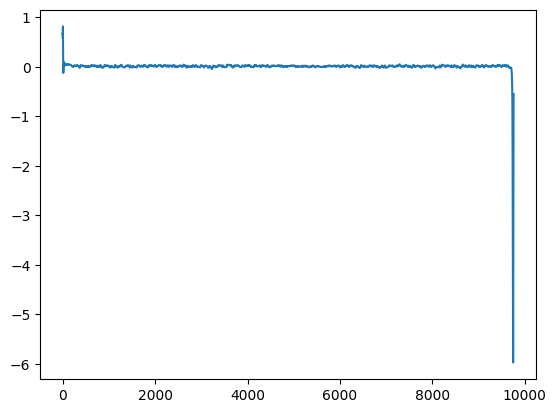

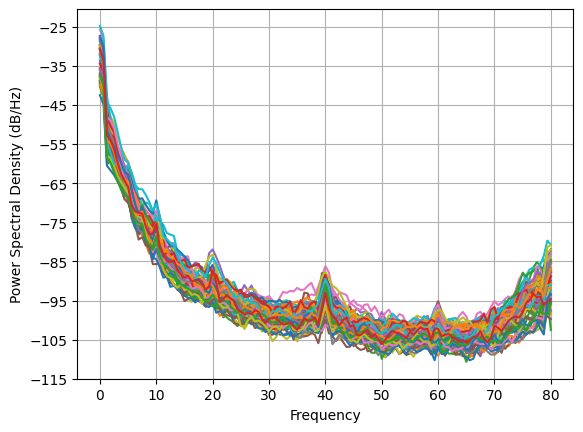

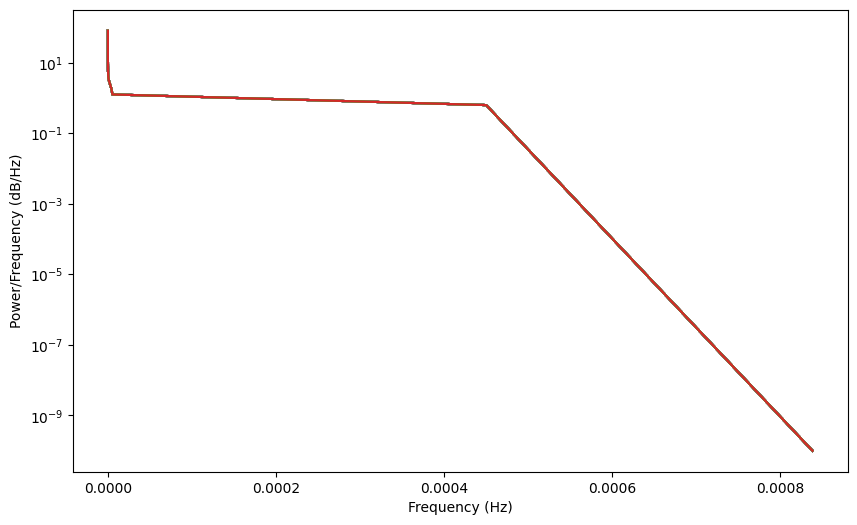

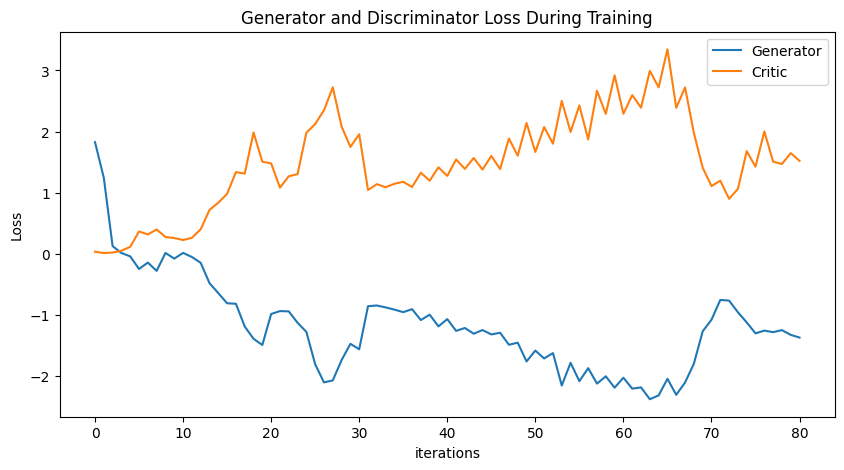

Epoch 90: Critic error ([1.8264334089185883, 1.2423659678178414, 0.12389627473788711, 0.012056891487889253, -0.04358463147655253, -0.2500785090806069, -0.14515403450987696, -0.2808616029379748, 0.012696776924949638, -0.08024498345545034, 0.01345730847284099, -0.053555110911149145, -0.1490088985829475, -0.481653089647959, -0.6459408744589094, -0.8110857214240685, -0.8191183042887766, -1.191360196023375, -1.3923246099509072, -1.4939039839104153, -0.9867567959728697, -0.939174374033741, -0.9439010985909159, -1.130508398141421, -1.2797913014053697, -1.8091860329912755, -2.106912181630736, -2.073371218945991, -1.741611448713781, -1.4749941620700076, -1.5638996464619386, -0.8591007689606854, -0.8477450651678754, -0.8787081461593661, -0.9150682154765513, -0.9567433858882582, -0.9079217926209503, -1.0857234871312753, -0.9976619999427864, -1.1894297568119283, -1.0704649147753322, -1.2627880827572628, -1.2160270206575645, -1.3097102167428694, -1.249192655442032, -1.321075664299302, -1.2940571259

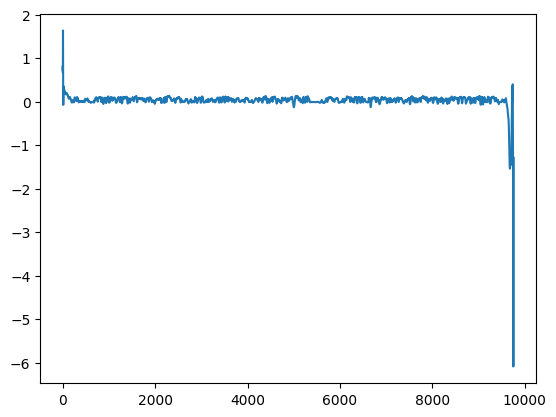

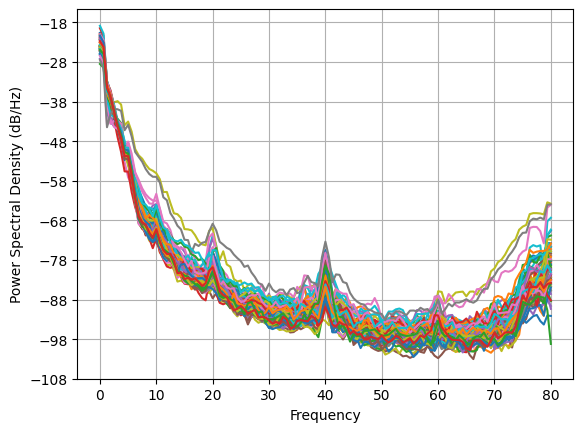

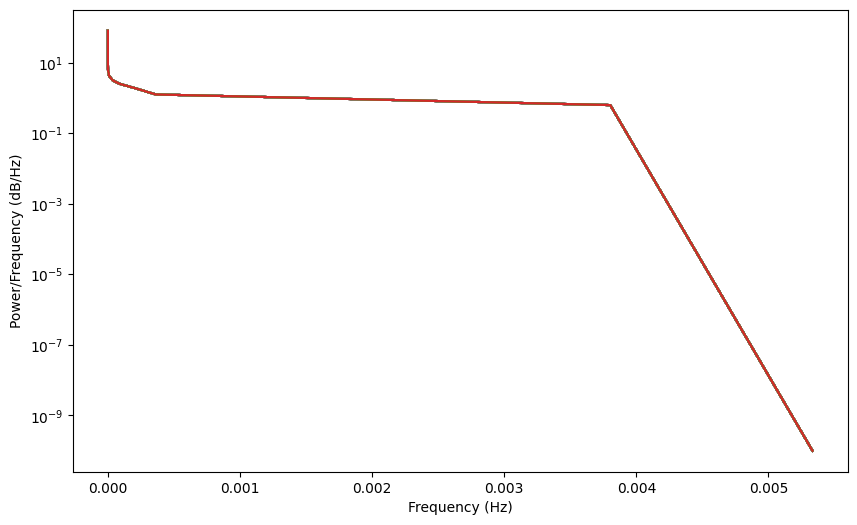

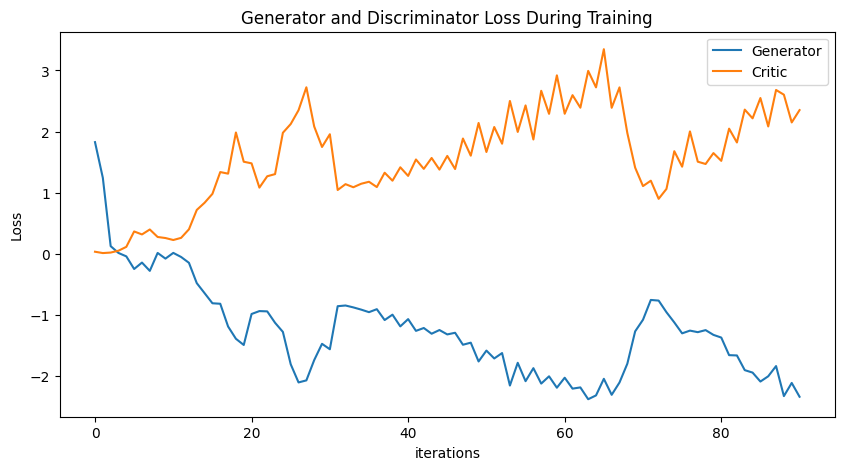

Epoch 100: Critic error ([1.8264334089185883, 1.2423659678178414, 0.12389627473788711, 0.012056891487889253, -0.04358463147655253, -0.2500785090806069, -0.14515403450987696, -0.2808616029379748, 0.012696776924949638, -0.08024498345545034, 0.01345730847284099, -0.053555110911149145, -0.1490088985829475, -0.481653089647959, -0.6459408744589094, -0.8110857214240685, -0.8191183042887766, -1.191360196023375, -1.3923246099509072, -1.4939039839104153, -0.9867567959728697, -0.939174374033741, -0.9439010985909159, -1.130508398141421, -1.2797913014053697, -1.8091860329912755, -2.106912181630736, -2.073371218945991, -1.741611448713781, -1.4749941620700076, -1.5638996464619386, -0.8591007689606854, -0.8477450651678754, -0.8787081461593661, -0.9150682154765513, -0.9567433858882582, -0.9079217926209503, -1.0857234871312753, -0.9976619999427864, -1.1894297568119283, -1.0704649147753322, -1.2627880827572628, -1.2160270206575645, -1.3097102167428694, -1.249192655442032, -1.321075664299302, -1.294057125

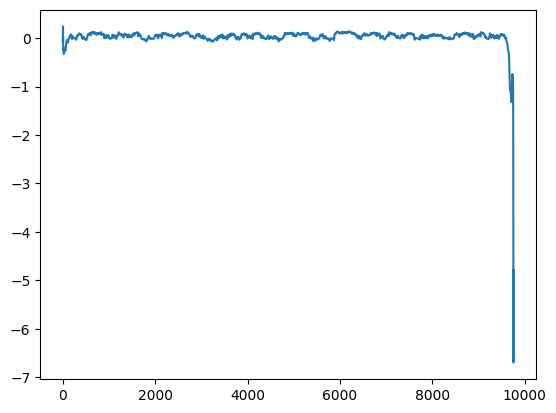

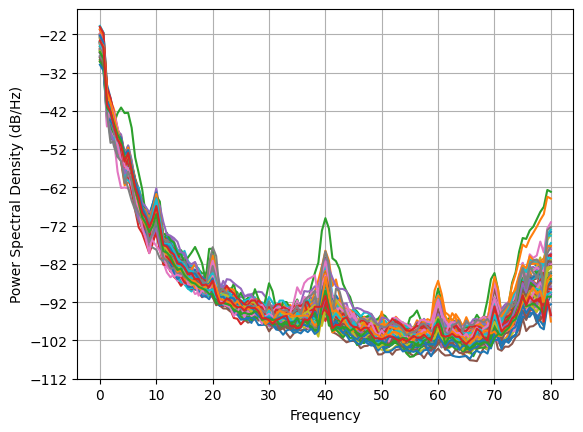

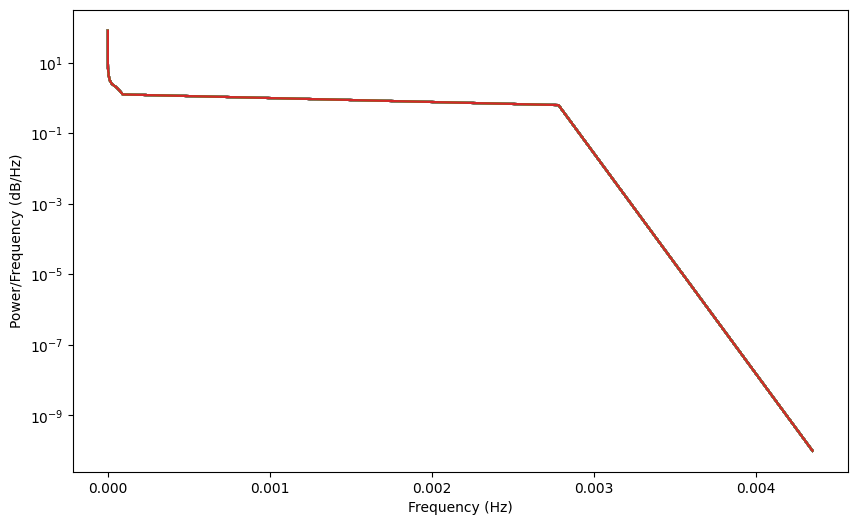

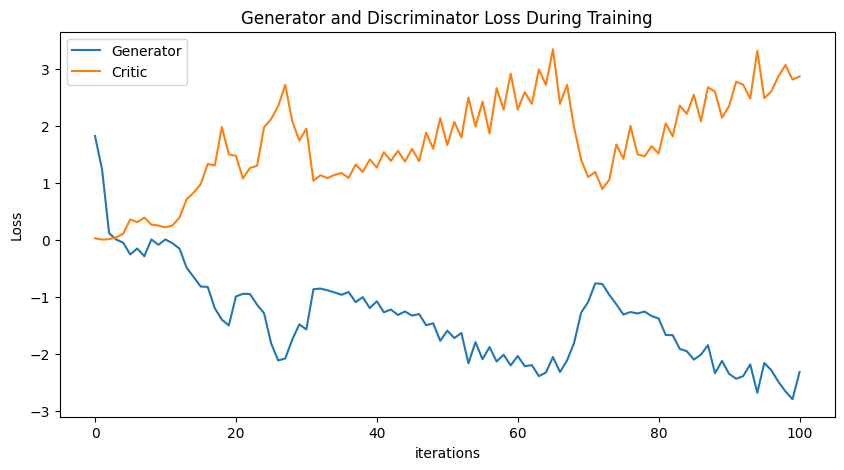

Epoch 110: Critic error ([1.8264334089185883, 1.2423659678178414, 0.12389627473788711, 0.012056891487889253, -0.04358463147655253, -0.2500785090806069, -0.14515403450987696, -0.2808616029379748, 0.012696776924949638, -0.08024498345545034, 0.01345730847284099, -0.053555110911149145, -0.1490088985829475, -0.481653089647959, -0.6459408744589094, -0.8110857214240685, -0.8191183042887766, -1.191360196023375, -1.3923246099509072, -1.4939039839104153, -0.9867567959728697, -0.939174374033741, -0.9439010985909159, -1.130508398141421, -1.2797913014053697, -1.8091860329912755, -2.106912181630736, -2.073371218945991, -1.741611448713781, -1.4749941620700076, -1.5638996464619386, -0.8591007689606854, -0.8477450651678754, -0.8787081461593661, -0.9150682154765513, -0.9567433858882582, -0.9079217926209503, -1.0857234871312753, -0.9976619999427864, -1.1894297568119283, -1.0704649147753322, -1.2627880827572628, -1.2160270206575645, -1.3097102167428694, -1.249192655442032, -1.321075664299302, -1.294057125

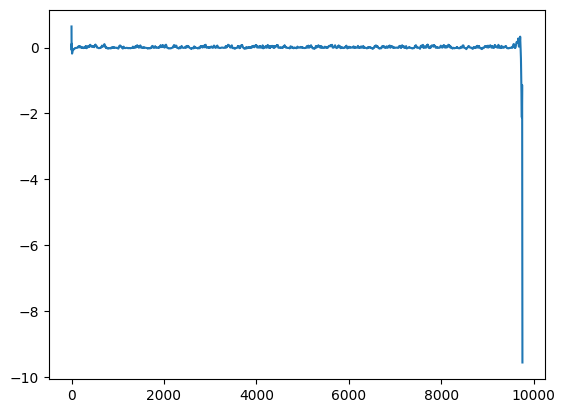

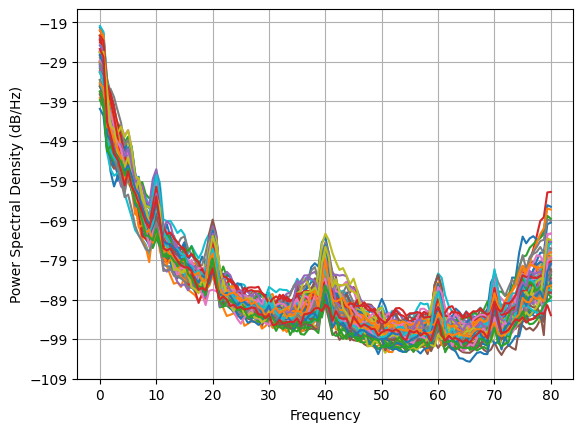

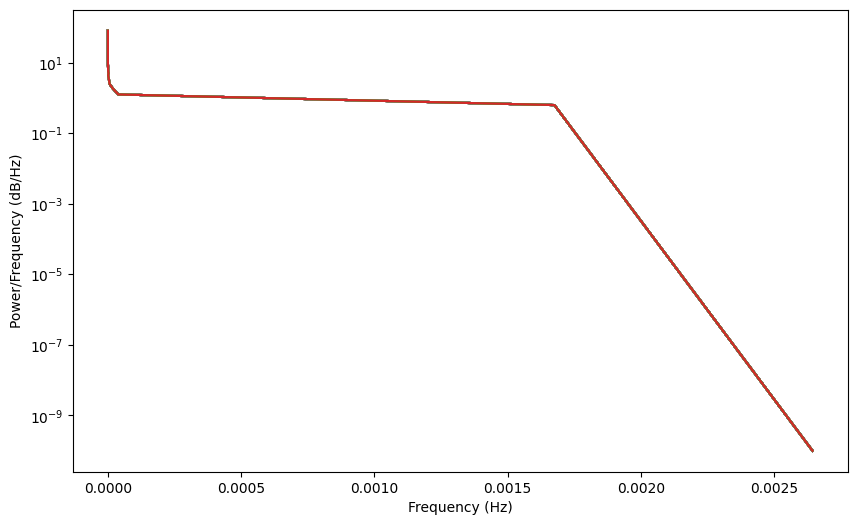

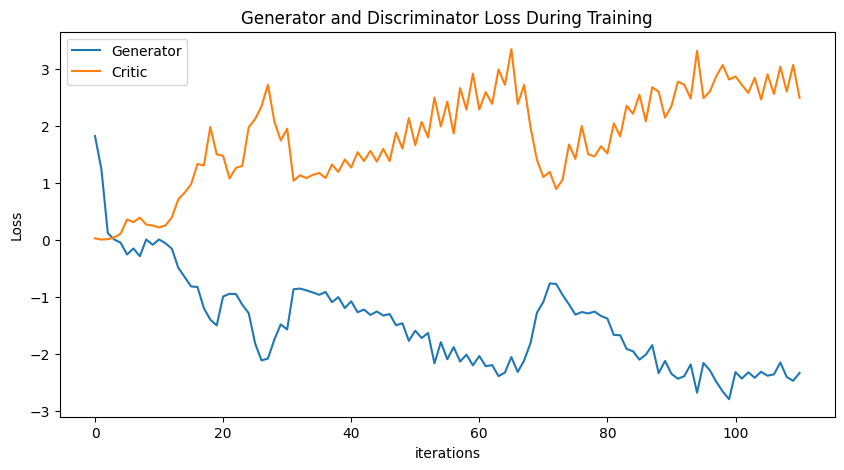

Epoch 120: Critic error ([1.8264334089185883, 1.2423659678178414, 0.12389627473788711, 0.012056891487889253, -0.04358463147655253, -0.2500785090806069, -0.14515403450987696, -0.2808616029379748, 0.012696776924949638, -0.08024498345545034, 0.01345730847284099, -0.053555110911149145, -0.1490088985829475, -0.481653089647959, -0.6459408744589094, -0.8110857214240685, -0.8191183042887766, -1.191360196023375, -1.3923246099509072, -1.4939039839104153, -0.9867567959728697, -0.939174374033741, -0.9439010985909159, -1.130508398141421, -1.2797913014053697, -1.8091860329912755, -2.106912181630736, -2.073371218945991, -1.741611448713781, -1.4749941620700076, -1.5638996464619386, -0.8591007689606854, -0.8477450651678754, -0.8787081461593661, -0.9150682154765513, -0.9567433858882582, -0.9079217926209503, -1.0857234871312753, -0.9976619999427864, -1.1894297568119283, -1.0704649147753322, -1.2627880827572628, -1.2160270206575645, -1.3097102167428694, -1.249192655442032, -1.321075664299302, -1.294057125

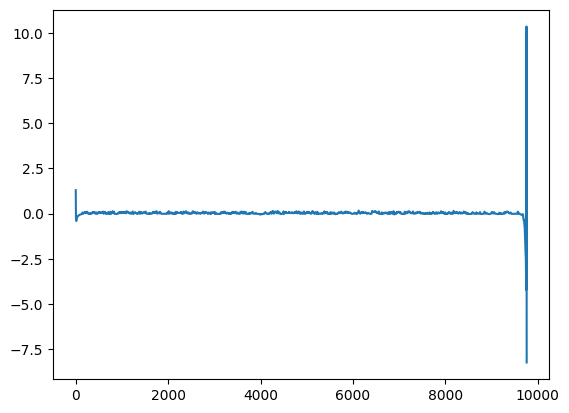

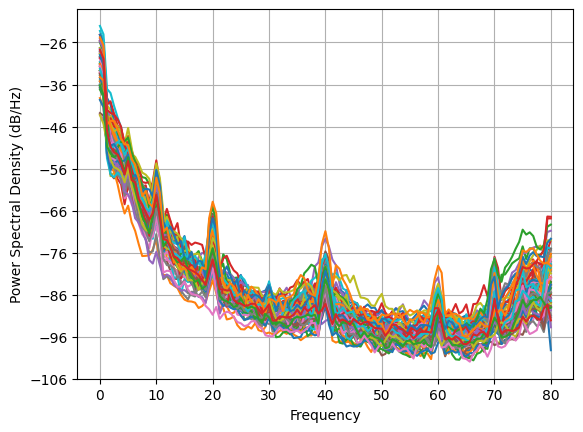

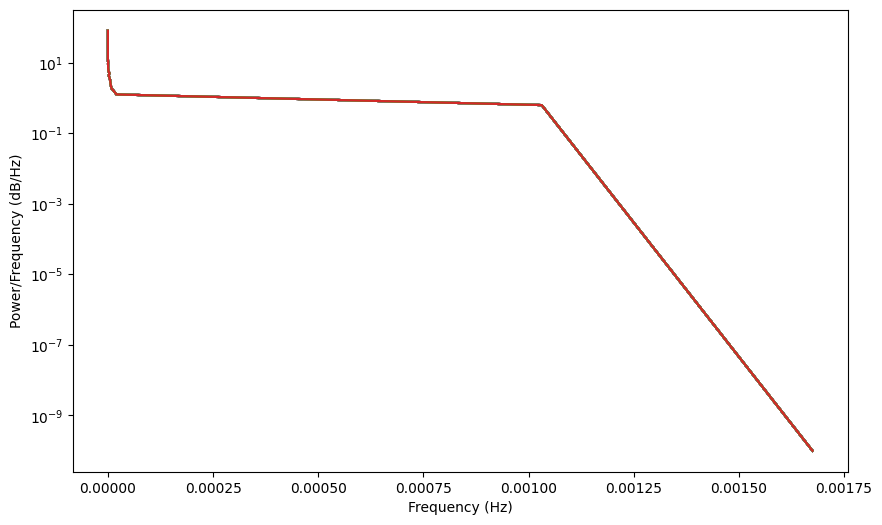

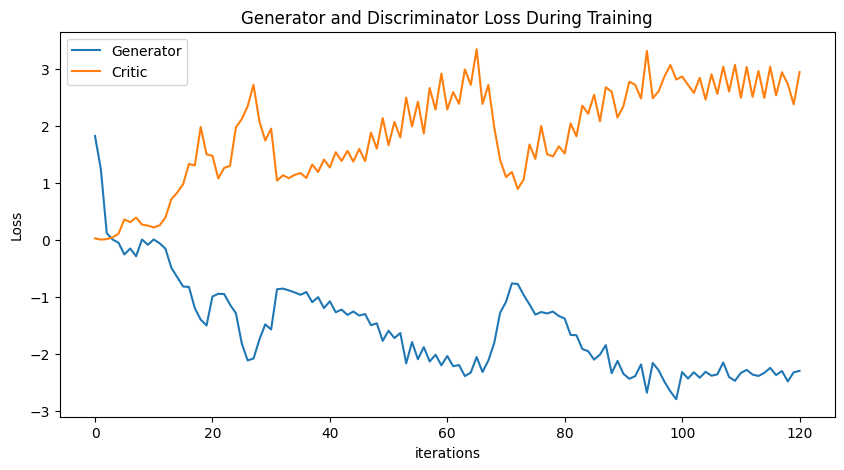

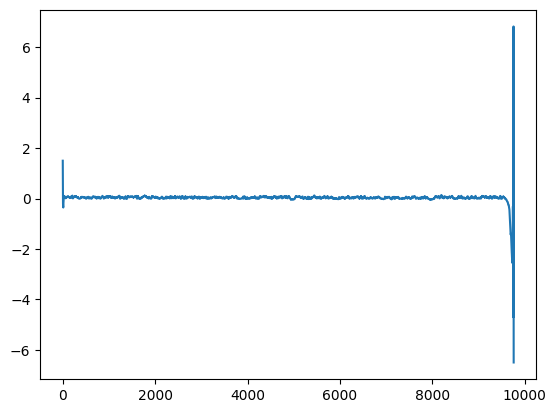

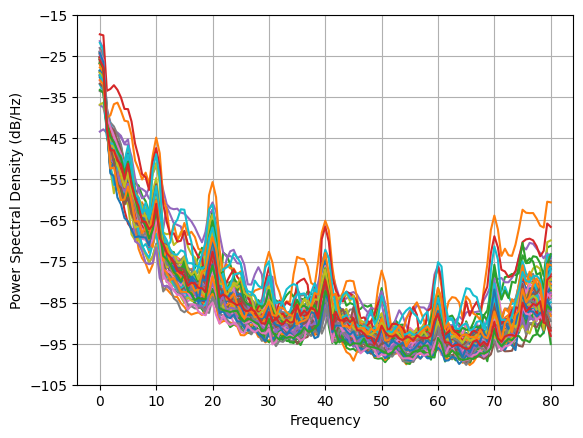

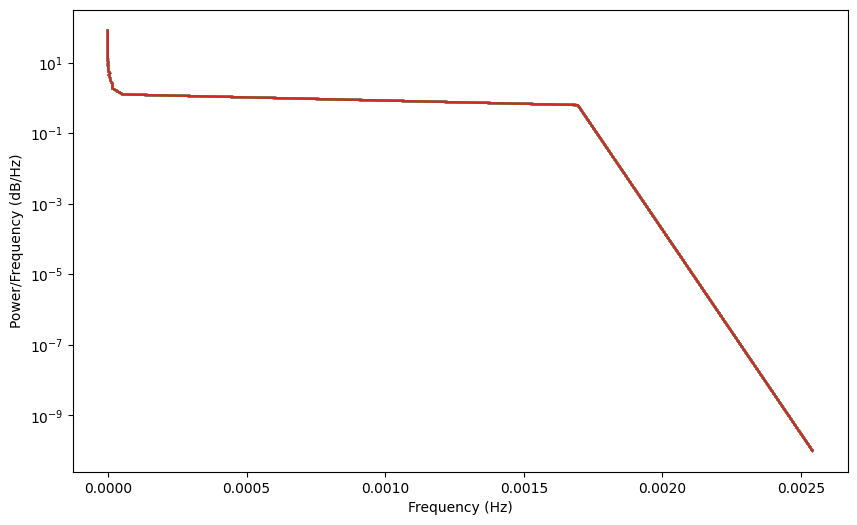

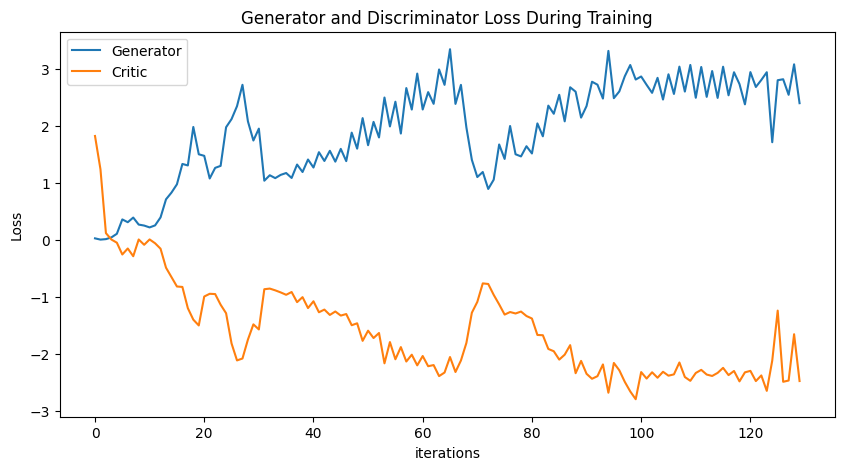

In [17]:
NUM_EPOCHS = 130
PRINT_INTERVAL = 10
training_data = torch.tensor(np.load('training_closed.npy'))
BATCH_SIZE = np.shape(training_data)[0]

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            critic_real = D(real).reshape(-1)
            loss_critic_real = -torch.mean(critic_real)
            noise = sample_normal_distribution(BATCH_SIZE, 640, 305)
            fake = G(noise)
            critic_fake = D(fake).reshape(-1)
            loss_critic_fake = torch.mean(critic_fake)
            gp = gradient_penalty(D, real, fake) * LAMBDA_GP
            D.zero_grad()
            loss_critic = loss_critic_real + loss_critic_fake + gp
            loss_critic.backward()
            critic_optimizer.step()  

        noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
        fake = G(noise)
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated_data_closed, disc, gen = train()

torch.save(gen, 'gen_FINA1L_closed.pt')
torch.save(disc, 'disc_FINAL1_closed.pt')
np.save('complex-closed.npy', generated_data_closed.detach())
plot_everything(generated_data_closed, gen_err, critic_err)

In [18]:
generated_data_closed = None

# same as above, more epoch

# same as above, normalized

Epoch 0: Critic error ([1.021696020304355]) Generator err ([0.008901560679078102])


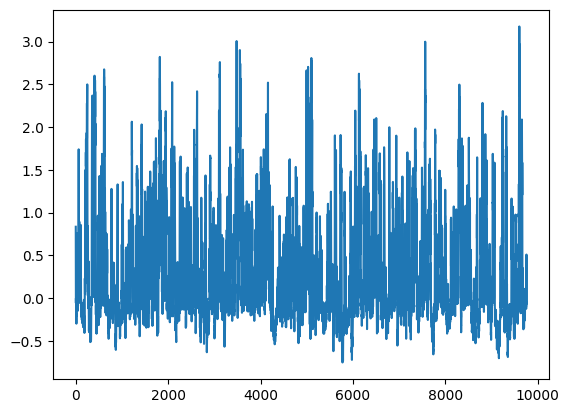

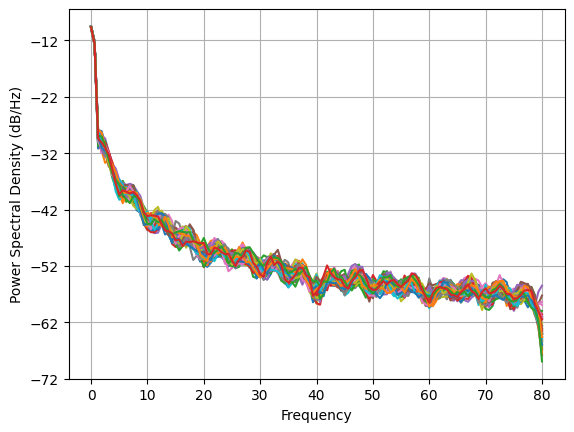

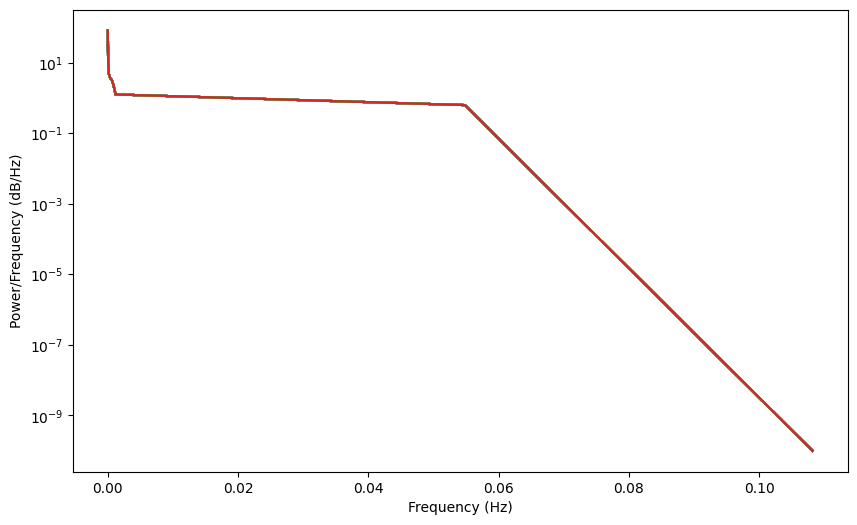

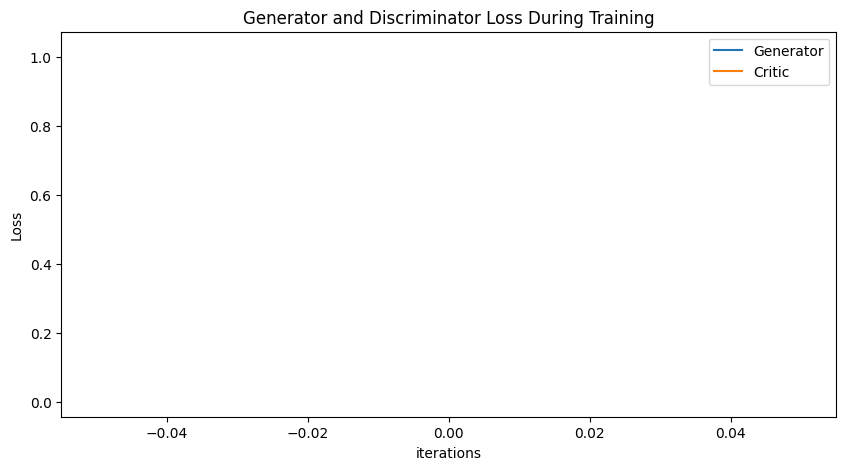

Epoch 10: Critic error ([1.021696020304355, 0.5751790099648636, 0.28241174729364693, 0.2671411554521002, 0.16571580514837497, 0.24568861597661698, 0.3278158144628937, 0.2741599461598232, 0.3287549453933505, 0.2755864759899904, 0.2705972449798348]) Generator err ([0.008901560679078102, -0.05360204726457596, -0.20881448686122894, -0.21448107063770294, -0.09685173630714417, -0.15295538306236267, -0.23460395634174347, -0.21271578967571259, -0.21906721591949463, -0.17293700575828552, -0.199885293841362])


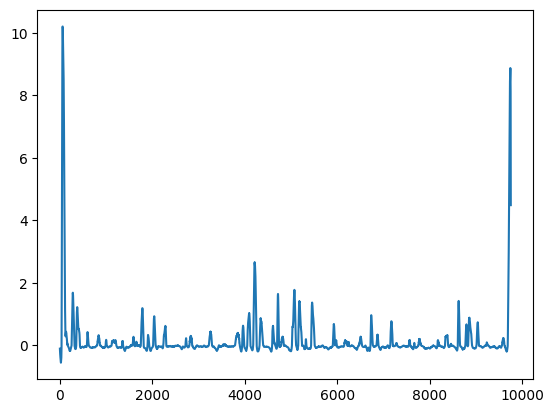

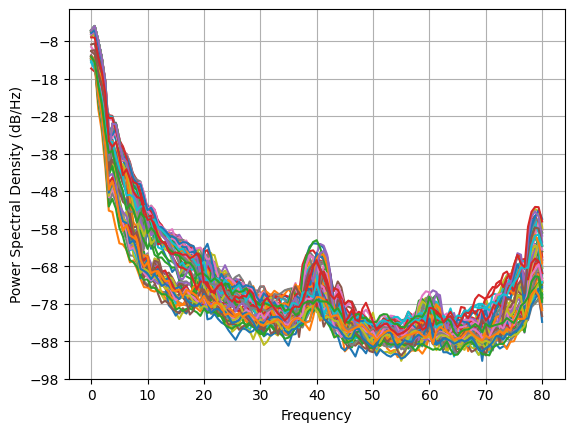

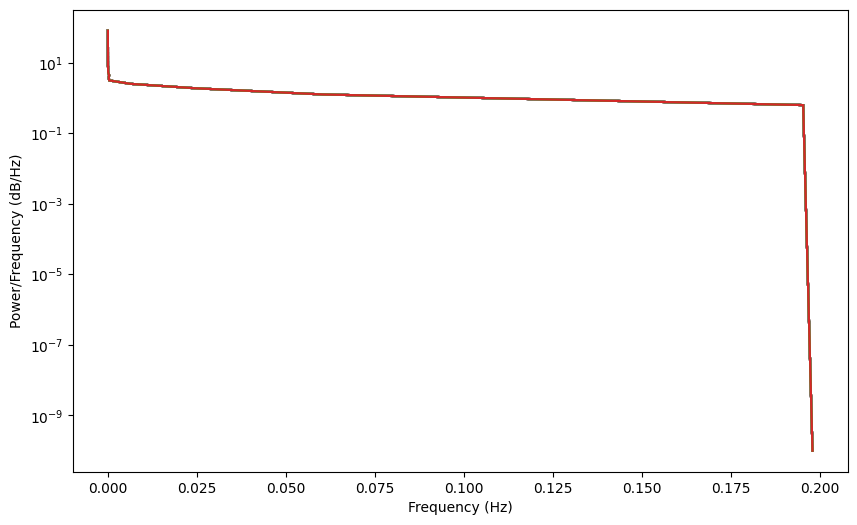

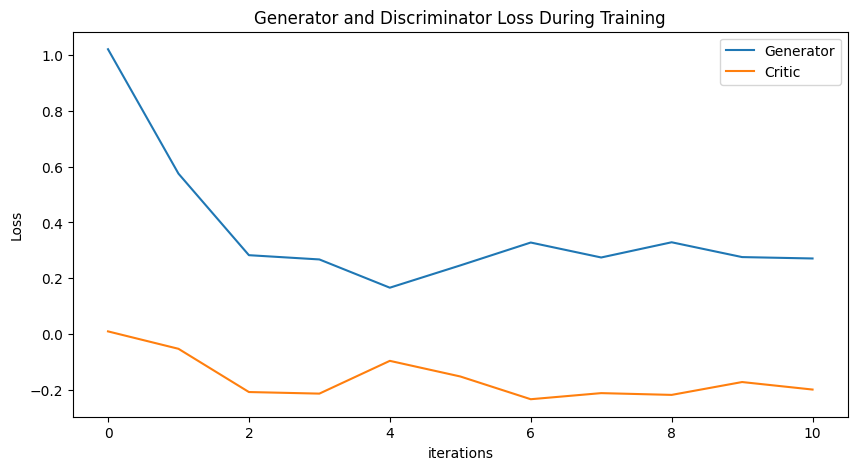

Epoch 20: Critic error ([1.021696020304355, 0.5751790099648636, 0.28241174729364693, 0.2671411554521002, 0.16571580514837497, 0.24568861597661698, 0.3278158144628937, 0.2741599461598232, 0.3287549453933505, 0.2755864759899904, 0.2705972449798348, 0.2729851596078793, 0.2900732391498444, 0.21192772622978023, 0.18585596222397838, 0.10299627371870293, 0.11265718278210908, 0.08287444210203201, 0.024252402105886806, 0.011330095416299715, -0.00525239867733697]) Generator err ([0.008901560679078102, -0.05360204726457596, -0.20881448686122894, -0.21448107063770294, -0.09685173630714417, -0.15295538306236267, -0.23460395634174347, -0.21271578967571259, -0.21906721591949463, -0.17293700575828552, -0.199885293841362, -0.18969841301441193, -0.21539971232414246, -0.15508976578712463, -0.10850358009338379, -0.05212803930044174, -0.05678141117095947, -0.033396389335393906, 0.0069901770912110806, 0.02209922857582569, 0.04427153244614601])


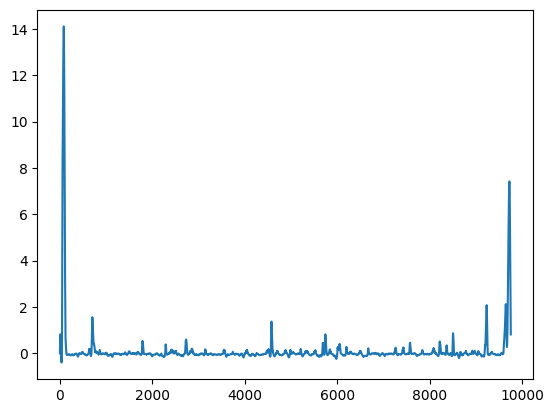

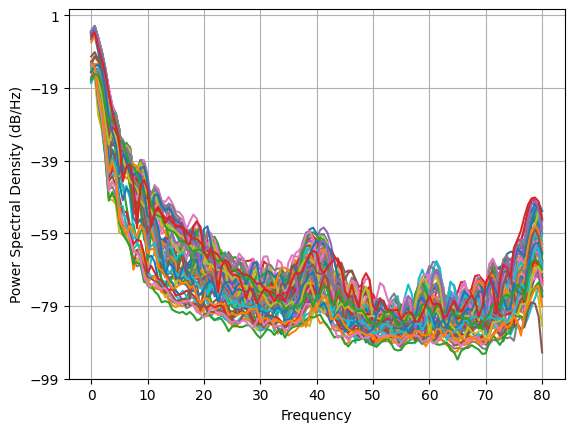

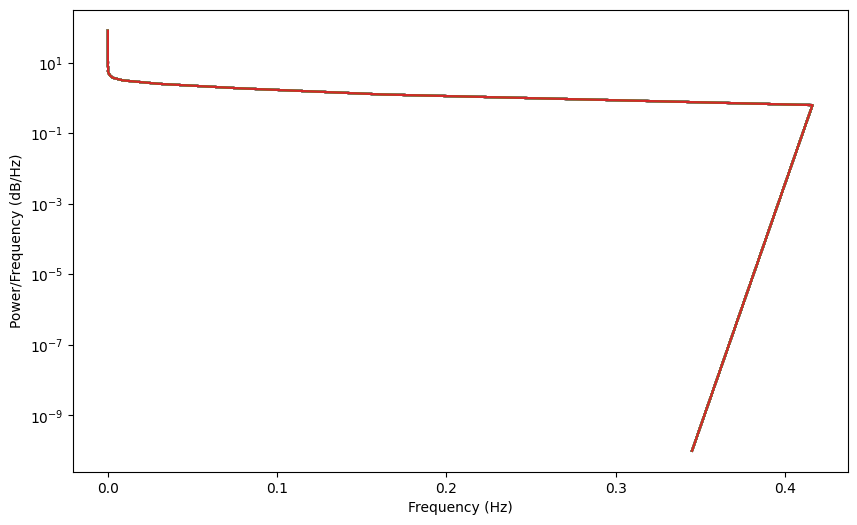

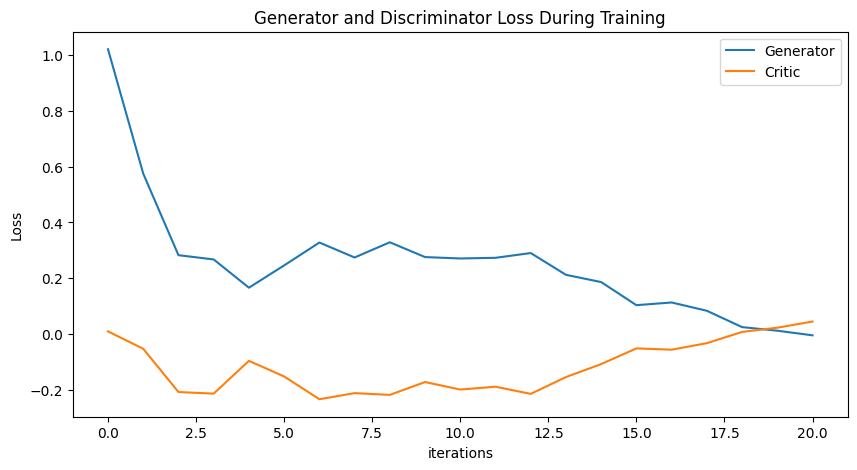

Epoch 30: Critic error ([1.021696020304355, 0.5751790099648636, 0.28241174729364693, 0.2671411554521002, 0.16571580514837497, 0.24568861597661698, 0.3278158144628937, 0.2741599461598232, 0.3287549453933505, 0.2755864759899904, 0.2705972449798348, 0.2729851596078793, 0.2900732391498444, 0.21192772622978023, 0.18585596222397838, 0.10299627371870293, 0.11265718278210908, 0.08287444210203201, 0.024252402105886806, 0.011330095416299715, -0.00525239867733697, -0.02905297038661378, -0.04174596744786184, -0.0617084636633795, -0.0736481869754706, -0.06987606024481585, -0.07489530999912447, -0.08887276613938691, -0.07662745968524705, -0.11120218262816847, -0.13357053300025334]) Generator err ([0.008901560679078102, -0.05360204726457596, -0.20881448686122894, -0.21448107063770294, -0.09685173630714417, -0.15295538306236267, -0.23460395634174347, -0.21271578967571259, -0.21906721591949463, -0.17293700575828552, -0.199885293841362, -0.18969841301441193, -0.21539971232414246, -0.15508976578712463, -

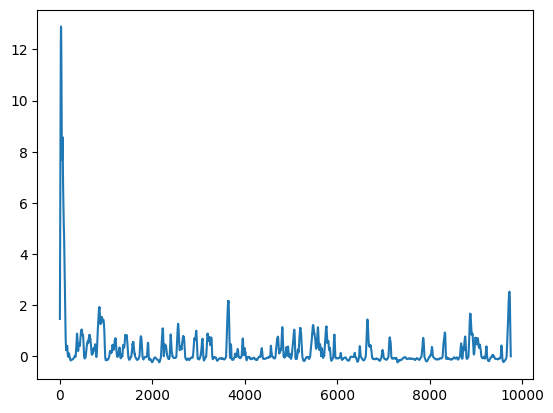

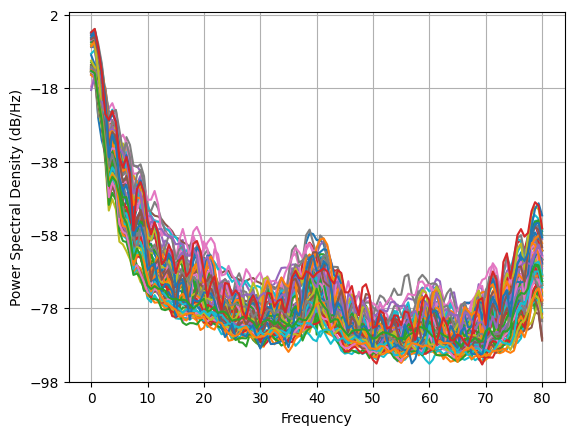

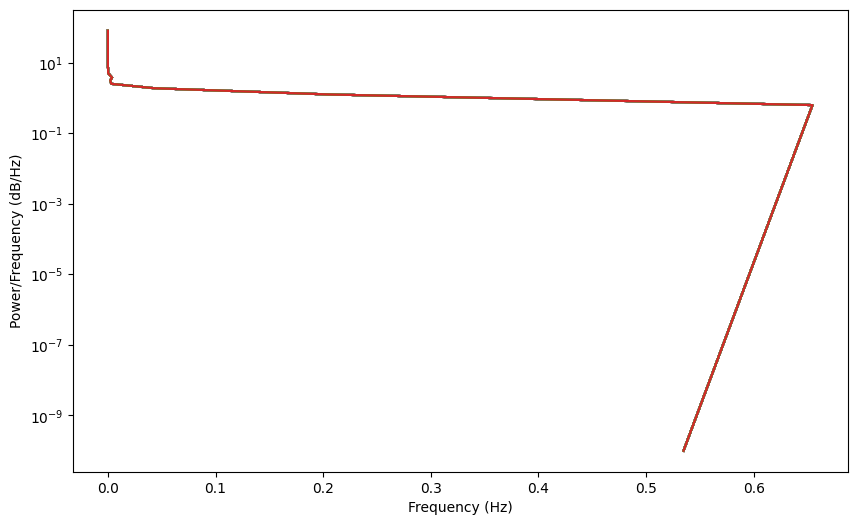

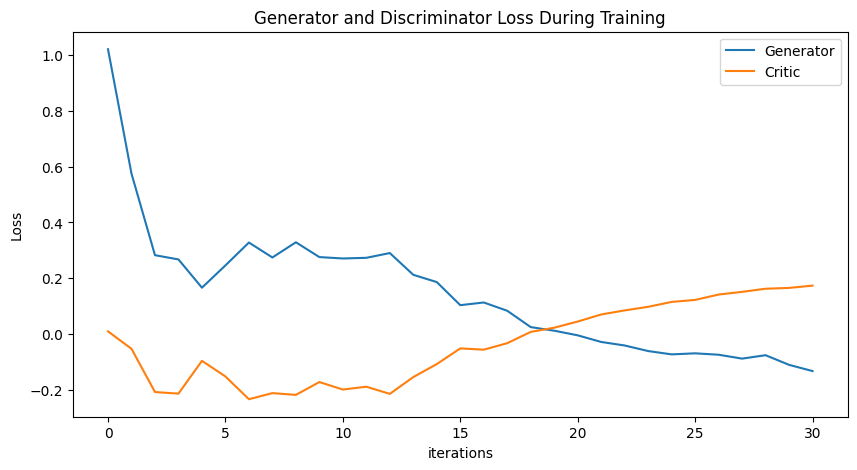

Epoch 40: Critic error ([1.021696020304355, 0.5751790099648636, 0.28241174729364693, 0.2671411554521002, 0.16571580514837497, 0.24568861597661698, 0.3278158144628937, 0.2741599461598232, 0.3287549453933505, 0.2755864759899904, 0.2705972449798348, 0.2729851596078793, 0.2900732391498444, 0.21192772622978023, 0.18585596222397838, 0.10299627371870293, 0.11265718278210908, 0.08287444210203201, 0.024252402105886806, 0.011330095416299715, -0.00525239867733697, -0.02905297038661378, -0.04174596744786184, -0.0617084636633795, -0.0736481869754706, -0.06987606024481585, -0.07489530999912447, -0.08887276613938691, -0.07662745968524705, -0.11120218262816847, -0.13357053300025334, -0.13752825256067444, -0.14061189603258686, -0.16444867069255342, -0.19728295204536384, -0.252883012515175, -0.2901617006441156, -0.33452732852185896, -0.3551721873182914, -0.36083041613811595, -0.42391723413793403]) Generator err ([0.008901560679078102, -0.05360204726457596, -0.20881448686122894, -0.21448107063770294, -0.

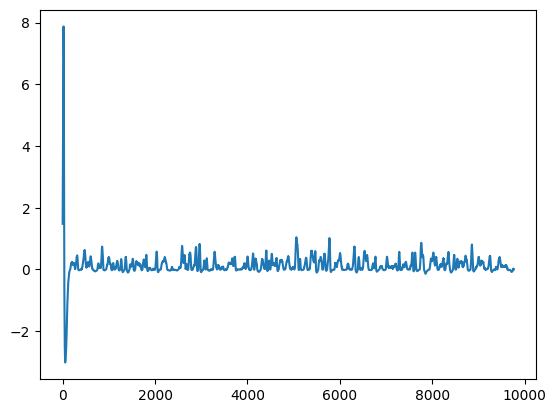

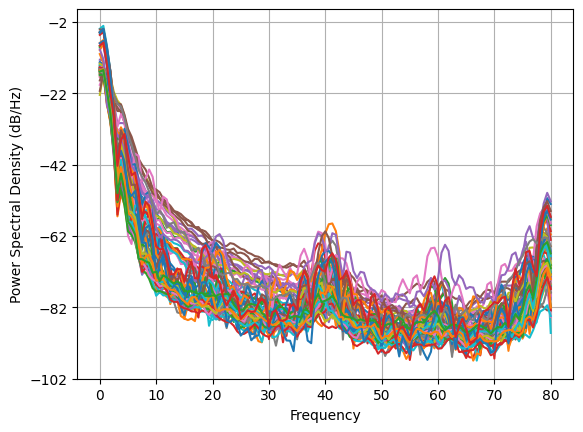

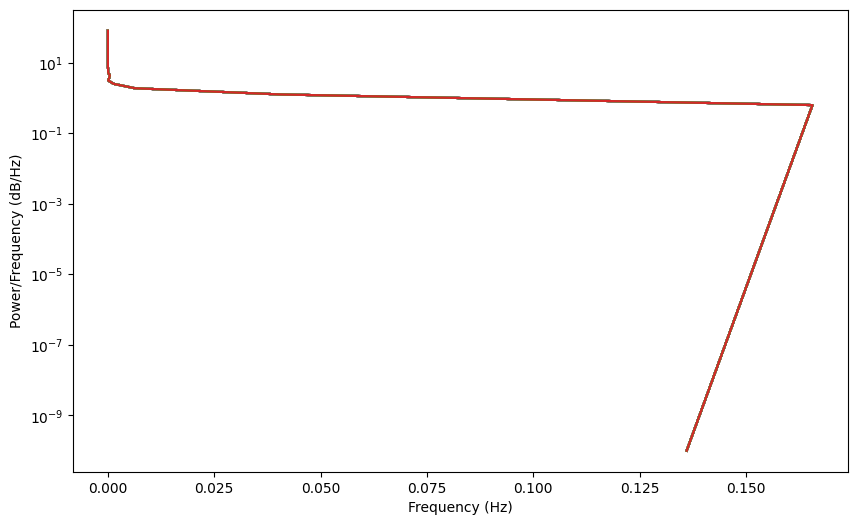

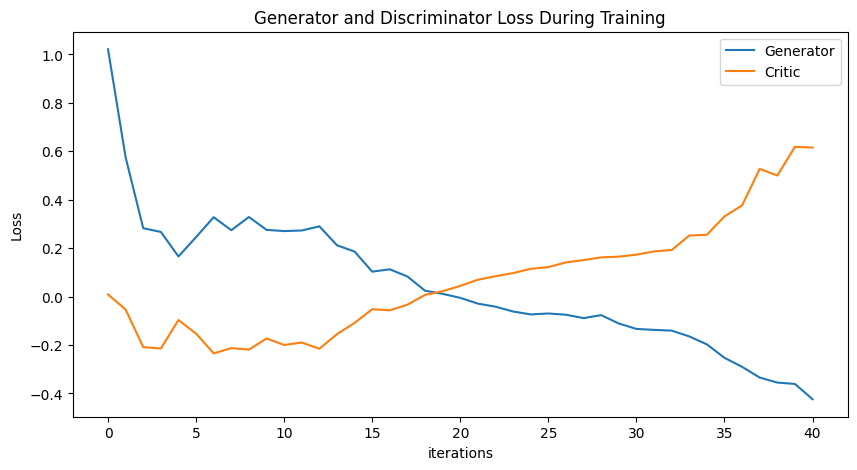

Epoch 50: Critic error ([1.021696020304355, 0.5751790099648636, 0.28241174729364693, 0.2671411554521002, 0.16571580514837497, 0.24568861597661698, 0.3278158144628937, 0.2741599461598232, 0.3287549453933505, 0.2755864759899904, 0.2705972449798348, 0.2729851596078793, 0.2900732391498444, 0.21192772622978023, 0.18585596222397838, 0.10299627371870293, 0.11265718278210908, 0.08287444210203201, 0.024252402105886806, 0.011330095416299715, -0.00525239867733697, -0.02905297038661378, -0.04174596744786184, -0.0617084636633795, -0.0736481869754706, -0.06987606024481585, -0.07489530999912447, -0.08887276613938691, -0.07662745968524705, -0.11120218262816847, -0.13357053300025334, -0.13752825256067444, -0.14061189603258686, -0.16444867069255342, -0.19728295204536384, -0.252883012515175, -0.2901617006441156, -0.33452732852185896, -0.3551721873182914, -0.36083041613811595, -0.42391723413793403, -0.4606565382901305, -0.5132359495855876, -0.5791282342751517, -0.6422781975985904, -0.5574482949995955, -0.

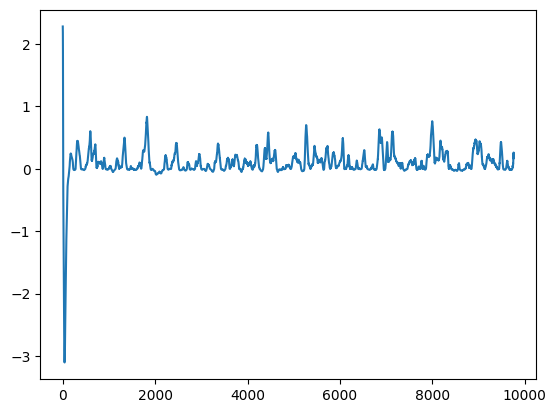

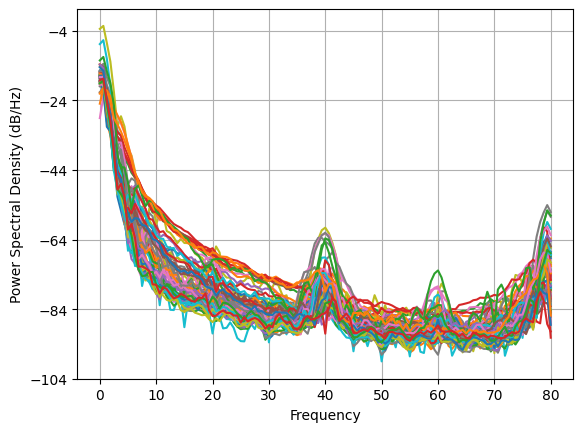

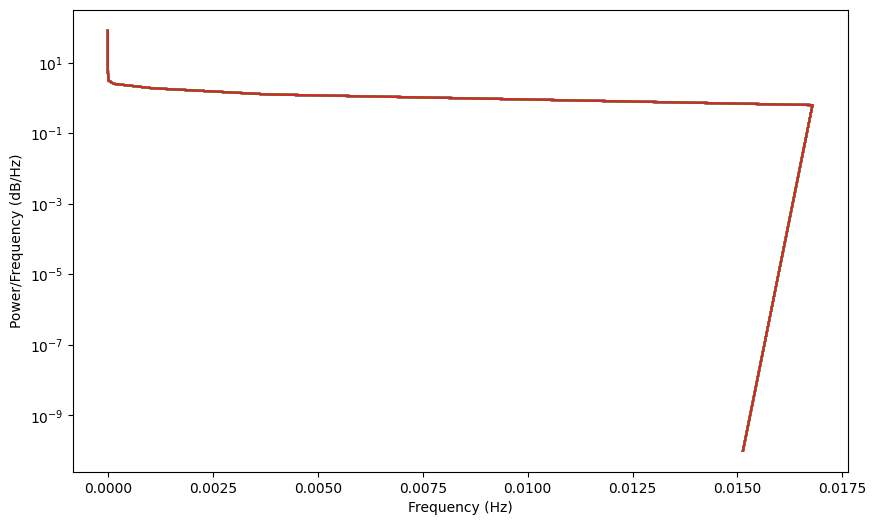

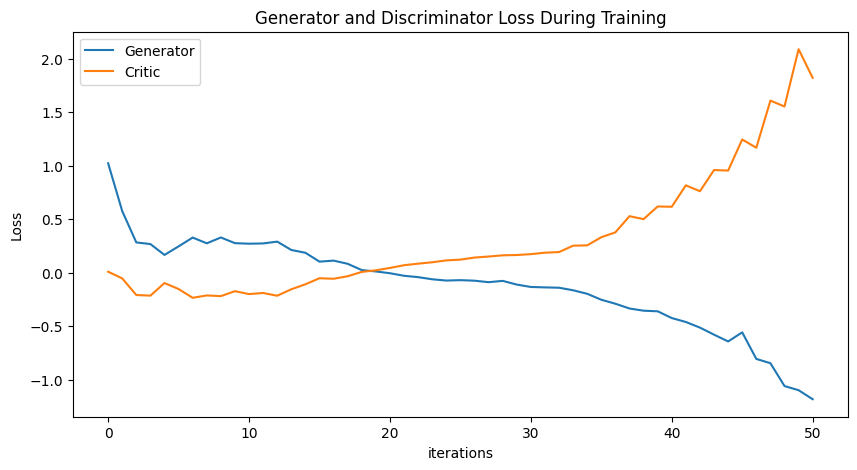

Epoch 60: Critic error ([1.021696020304355, 0.5751790099648636, 0.28241174729364693, 0.2671411554521002, 0.16571580514837497, 0.24568861597661698, 0.3278158144628937, 0.2741599461598232, 0.3287549453933505, 0.2755864759899904, 0.2705972449798348, 0.2729851596078793, 0.2900732391498444, 0.21192772622978023, 0.18585596222397838, 0.10299627371870293, 0.11265718278210908, 0.08287444210203201, 0.024252402105886806, 0.011330095416299715, -0.00525239867733697, -0.02905297038661378, -0.04174596744786184, -0.0617084636633795, -0.0736481869754706, -0.06987606024481585, -0.07489530999912447, -0.08887276613938691, -0.07662745968524705, -0.11120218262816847, -0.13357053300025334, -0.13752825256067444, -0.14061189603258686, -0.16444867069255342, -0.19728295204536384, -0.252883012515175, -0.2901617006441156, -0.33452732852185896, -0.3551721873182914, -0.36083041613811595, -0.42391723413793403, -0.4606565382901305, -0.5132359495855876, -0.5791282342751517, -0.6422781975985904, -0.5574482949995955, -0.

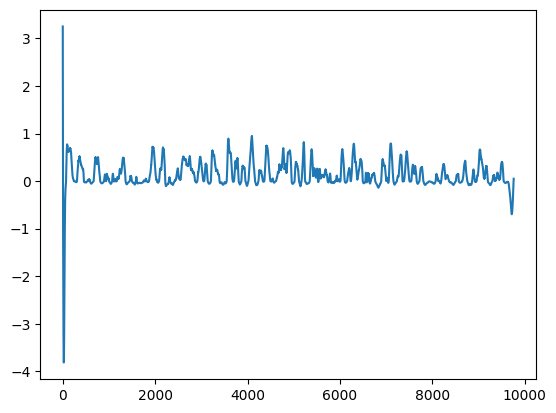

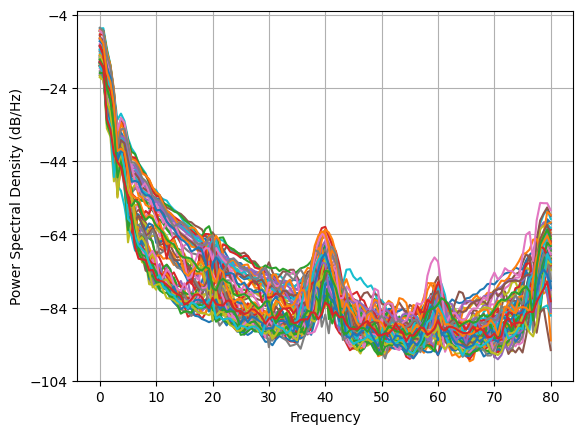

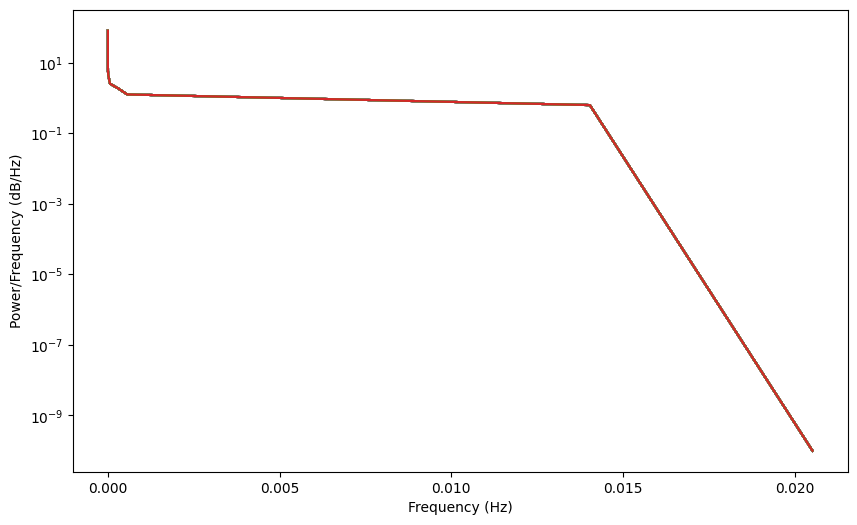

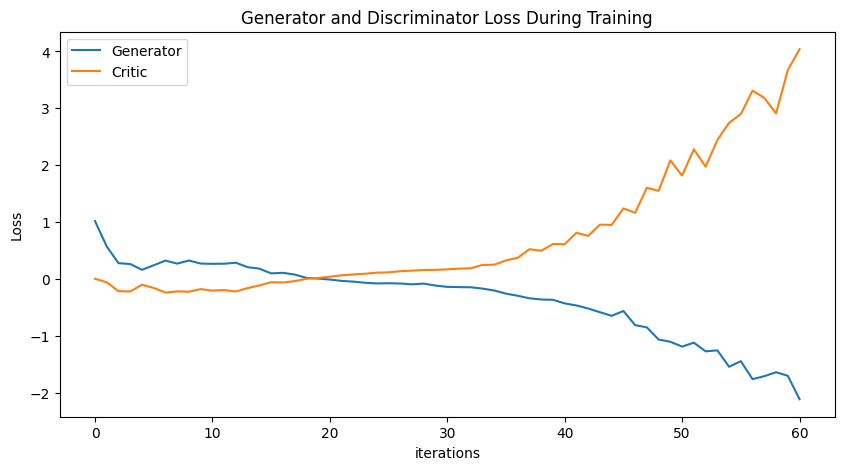

Epoch 70: Critic error ([1.021696020304355, 0.5751790099648636, 0.28241174729364693, 0.2671411554521002, 0.16571580514837497, 0.24568861597661698, 0.3278158144628937, 0.2741599461598232, 0.3287549453933505, 0.2755864759899904, 0.2705972449798348, 0.2729851596078793, 0.2900732391498444, 0.21192772622978023, 0.18585596222397838, 0.10299627371870293, 0.11265718278210908, 0.08287444210203201, 0.024252402105886806, 0.011330095416299715, -0.00525239867733697, -0.02905297038661378, -0.04174596744786184, -0.0617084636633795, -0.0736481869754706, -0.06987606024481585, -0.07489530999912447, -0.08887276613938691, -0.07662745968524705, -0.11120218262816847, -0.13357053300025334, -0.13752825256067444, -0.14061189603258686, -0.16444867069255342, -0.19728295204536384, -0.252883012515175, -0.2901617006441156, -0.33452732852185896, -0.3551721873182914, -0.36083041613811595, -0.42391723413793403, -0.4606565382901305, -0.5132359495855876, -0.5791282342751517, -0.6422781975985904, -0.5574482949995955, -0.

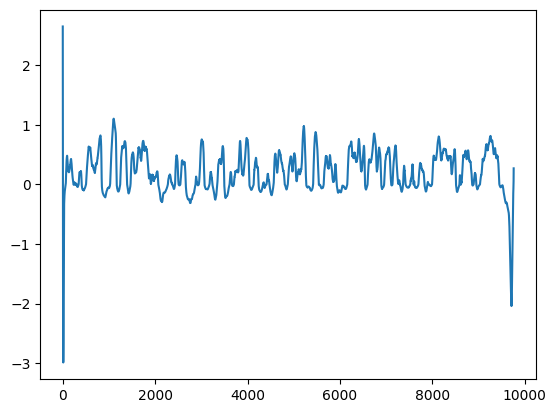

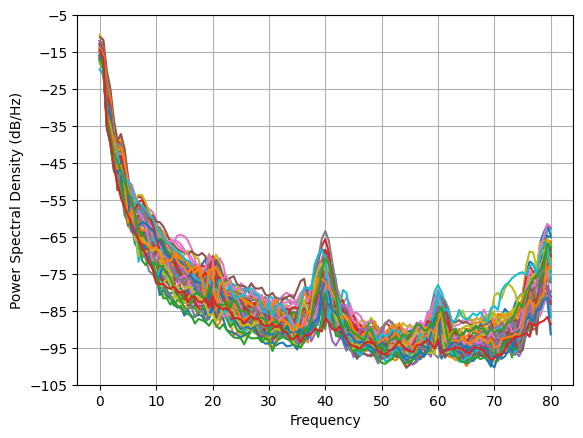

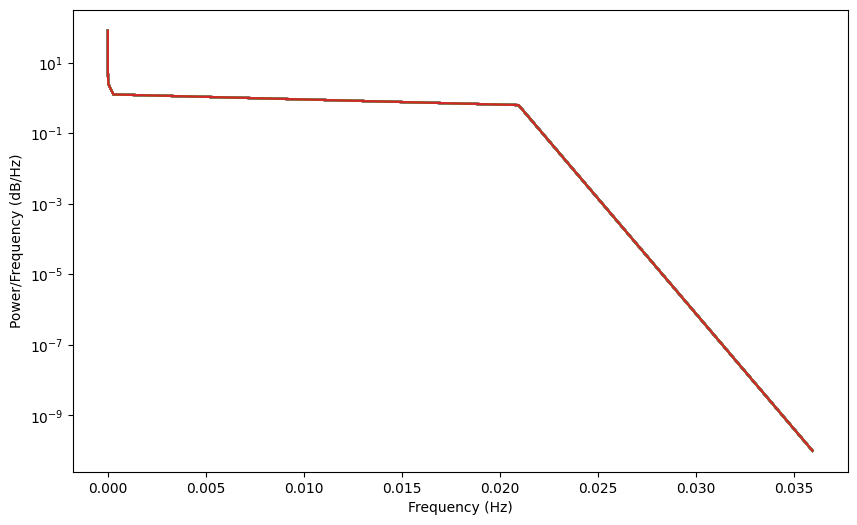

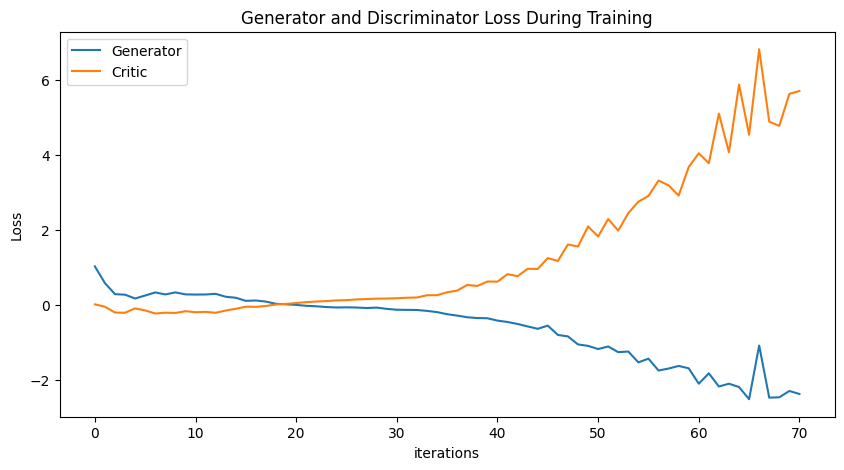

Epoch 80: Critic error ([1.021696020304355, 0.5751790099648636, 0.28241174729364693, 0.2671411554521002, 0.16571580514837497, 0.24568861597661698, 0.3278158144628937, 0.2741599461598232, 0.3287549453933505, 0.2755864759899904, 0.2705972449798348, 0.2729851596078793, 0.2900732391498444, 0.21192772622978023, 0.18585596222397838, 0.10299627371870293, 0.11265718278210908, 0.08287444210203201, 0.024252402105886806, 0.011330095416299715, -0.00525239867733697, -0.02905297038661378, -0.04174596744786184, -0.0617084636633795, -0.0736481869754706, -0.06987606024481585, -0.07489530999912447, -0.08887276613938691, -0.07662745968524705, -0.11120218262816847, -0.13357053300025334, -0.13752825256067444, -0.14061189603258686, -0.16444867069255342, -0.19728295204536384, -0.252883012515175, -0.2901617006441156, -0.33452732852185896, -0.3551721873182914, -0.36083041613811595, -0.42391723413793403, -0.4606565382901305, -0.5132359495855876, -0.5791282342751517, -0.6422781975985904, -0.5574482949995955, -0.

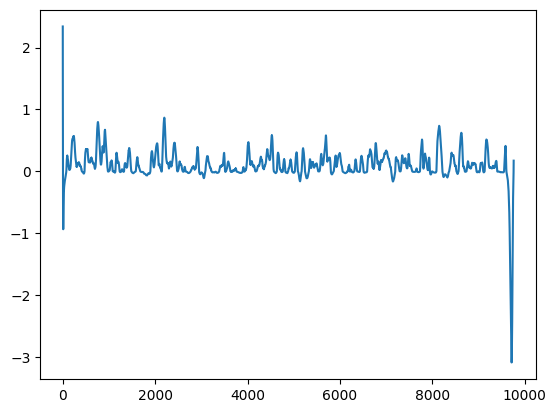

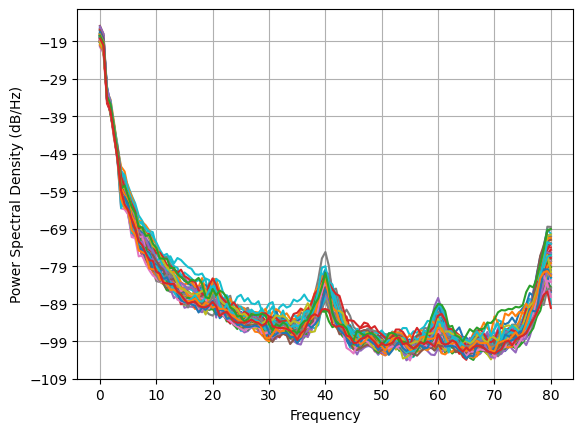

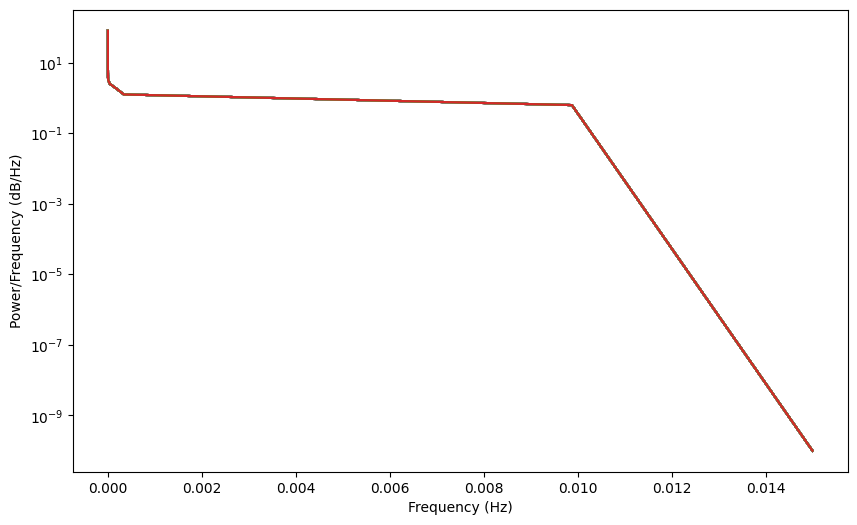

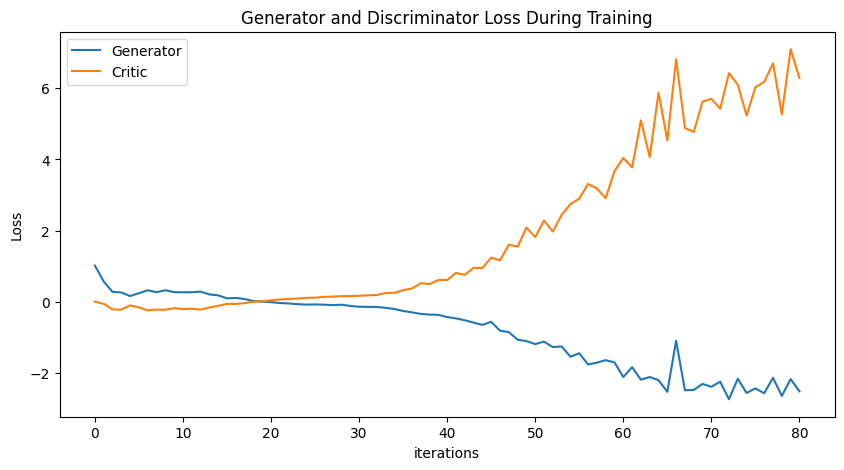

Epoch 90: Critic error ([1.021696020304355, 0.5751790099648636, 0.28241174729364693, 0.2671411554521002, 0.16571580514837497, 0.24568861597661698, 0.3278158144628937, 0.2741599461598232, 0.3287549453933505, 0.2755864759899904, 0.2705972449798348, 0.2729851596078793, 0.2900732391498444, 0.21192772622978023, 0.18585596222397838, 0.10299627371870293, 0.11265718278210908, 0.08287444210203201, 0.024252402105886806, 0.011330095416299715, -0.00525239867733697, -0.02905297038661378, -0.04174596744786184, -0.0617084636633795, -0.0736481869754706, -0.06987606024481585, -0.07489530999912447, -0.08887276613938691, -0.07662745968524705, -0.11120218262816847, -0.13357053300025334, -0.13752825256067444, -0.14061189603258686, -0.16444867069255342, -0.19728295204536384, -0.252883012515175, -0.2901617006441156, -0.33452732852185896, -0.3551721873182914, -0.36083041613811595, -0.42391723413793403, -0.4606565382901305, -0.5132359495855876, -0.5791282342751517, -0.6422781975985904, -0.5574482949995955, -0.

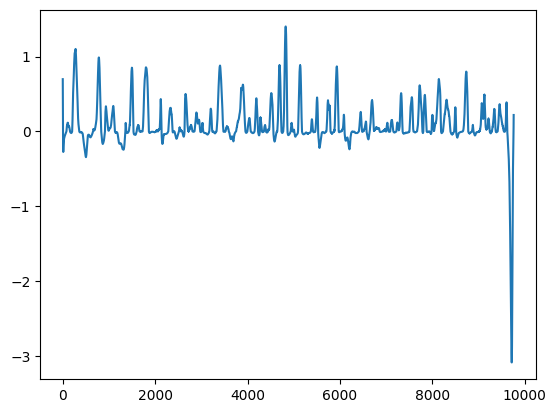

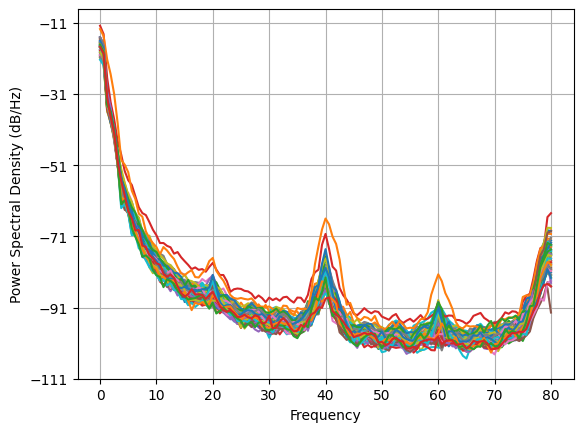

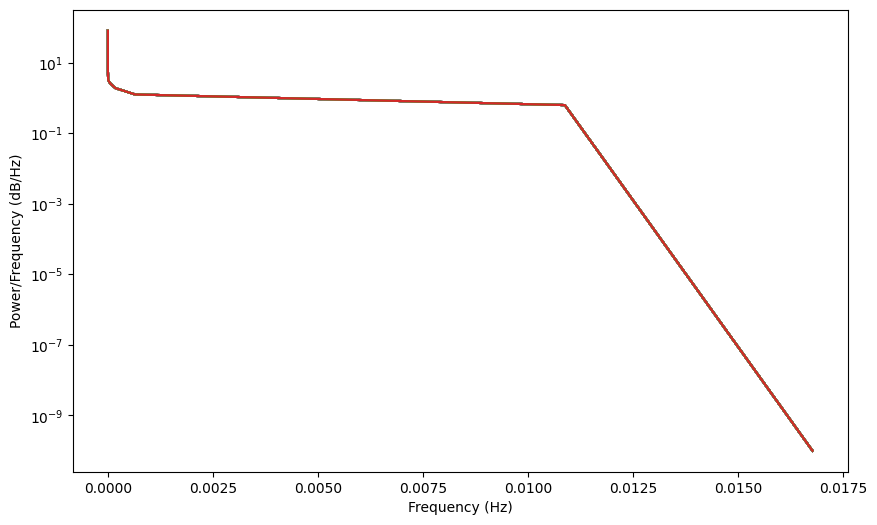

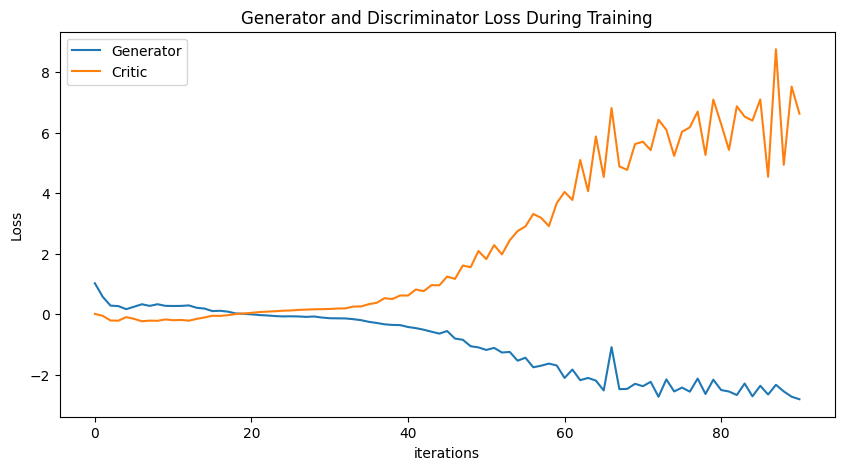

Epoch 100: Critic error ([1.021696020304355, 0.5751790099648636, 0.28241174729364693, 0.2671411554521002, 0.16571580514837497, 0.24568861597661698, 0.3278158144628937, 0.2741599461598232, 0.3287549453933505, 0.2755864759899904, 0.2705972449798348, 0.2729851596078793, 0.2900732391498444, 0.21192772622978023, 0.18585596222397838, 0.10299627371870293, 0.11265718278210908, 0.08287444210203201, 0.024252402105886806, 0.011330095416299715, -0.00525239867733697, -0.02905297038661378, -0.04174596744786184, -0.0617084636633795, -0.0736481869754706, -0.06987606024481585, -0.07489530999912447, -0.08887276613938691, -0.07662745968524705, -0.11120218262816847, -0.13357053300025334, -0.13752825256067444, -0.14061189603258686, -0.16444867069255342, -0.19728295204536384, -0.252883012515175, -0.2901617006441156, -0.33452732852185896, -0.3551721873182914, -0.36083041613811595, -0.42391723413793403, -0.4606565382901305, -0.5132359495855876, -0.5791282342751517, -0.6422781975985904, -0.5574482949995955, -0

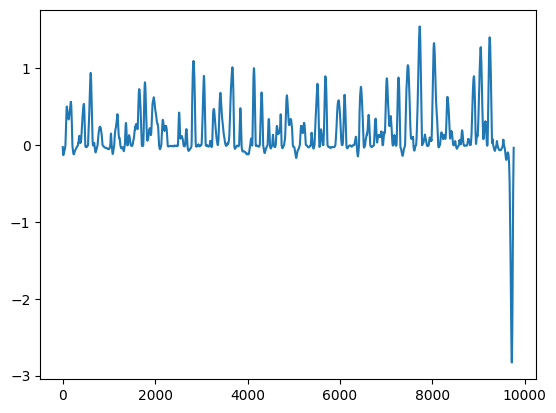

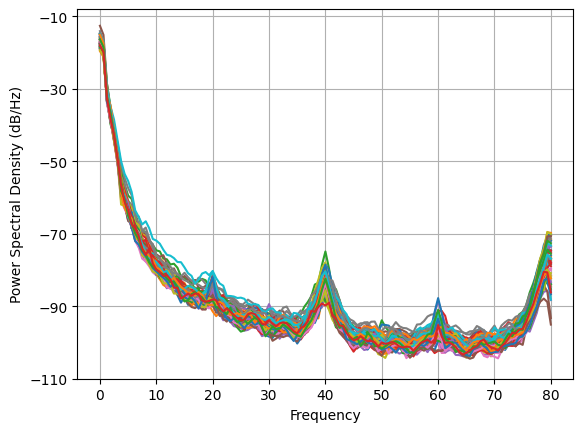

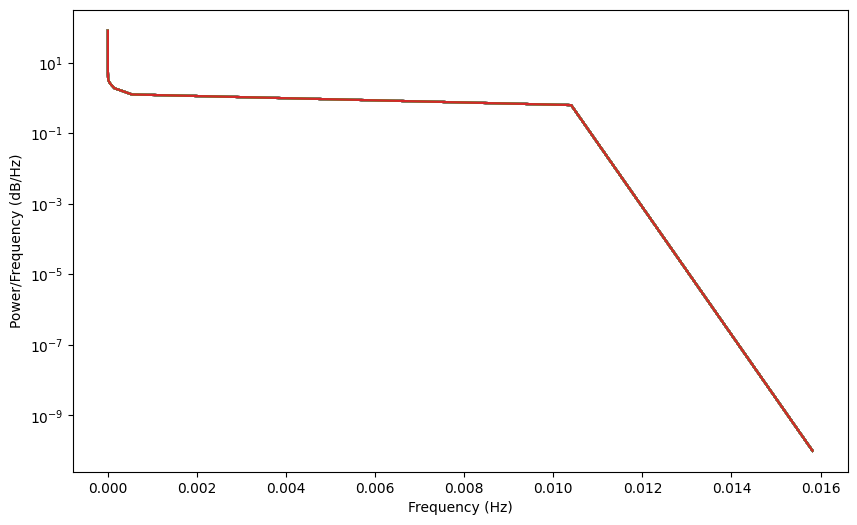

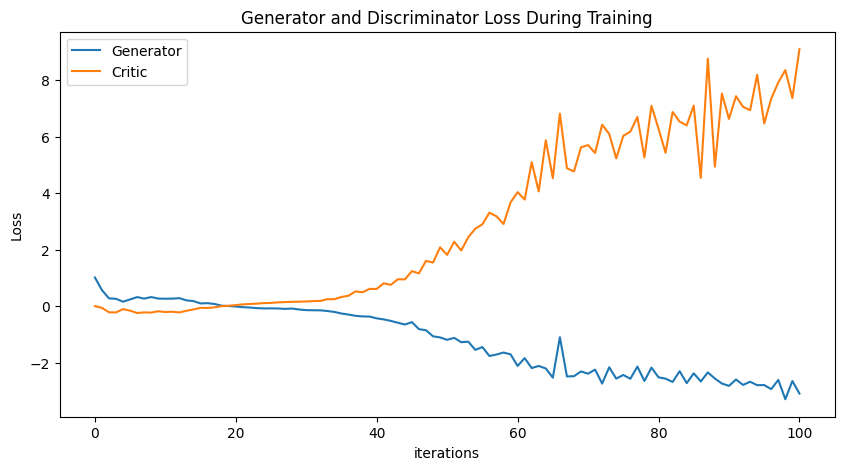

Epoch 110: Critic error ([1.021696020304355, 0.5751790099648636, 0.28241174729364693, 0.2671411554521002, 0.16571580514837497, 0.24568861597661698, 0.3278158144628937, 0.2741599461598232, 0.3287549453933505, 0.2755864759899904, 0.2705972449798348, 0.2729851596078793, 0.2900732391498444, 0.21192772622978023, 0.18585596222397838, 0.10299627371870293, 0.11265718278210908, 0.08287444210203201, 0.024252402105886806, 0.011330095416299715, -0.00525239867733697, -0.02905297038661378, -0.04174596744786184, -0.0617084636633795, -0.0736481869754706, -0.06987606024481585, -0.07489530999912447, -0.08887276613938691, -0.07662745968524705, -0.11120218262816847, -0.13357053300025334, -0.13752825256067444, -0.14061189603258686, -0.16444867069255342, -0.19728295204536384, -0.252883012515175, -0.2901617006441156, -0.33452732852185896, -0.3551721873182914, -0.36083041613811595, -0.42391723413793403, -0.4606565382901305, -0.5132359495855876, -0.5791282342751517, -0.6422781975985904, -0.5574482949995955, -0

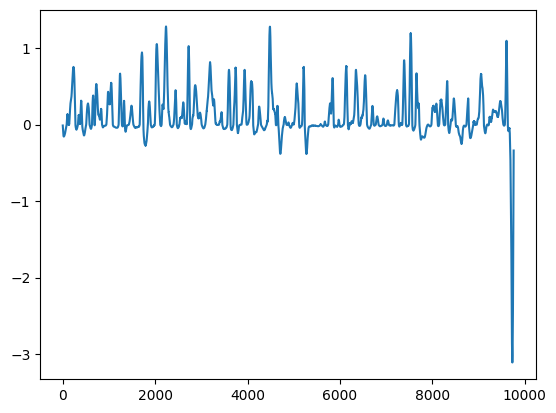

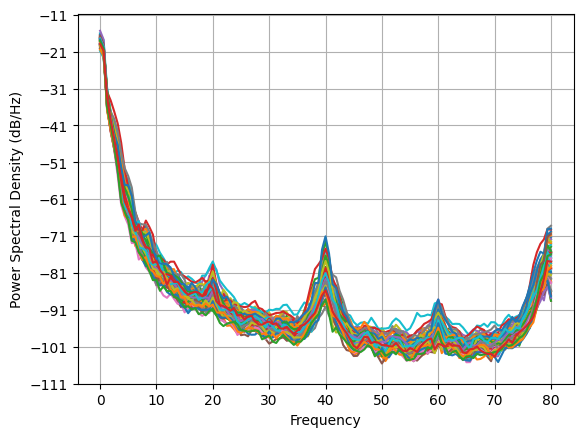

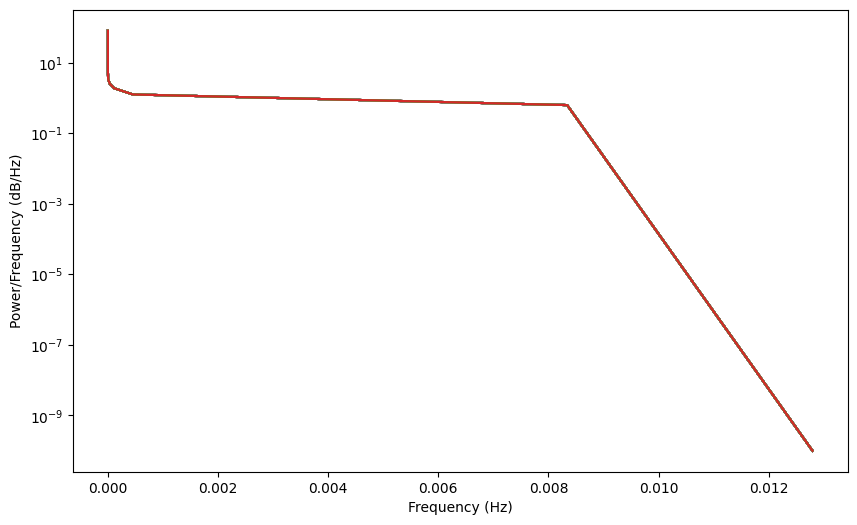

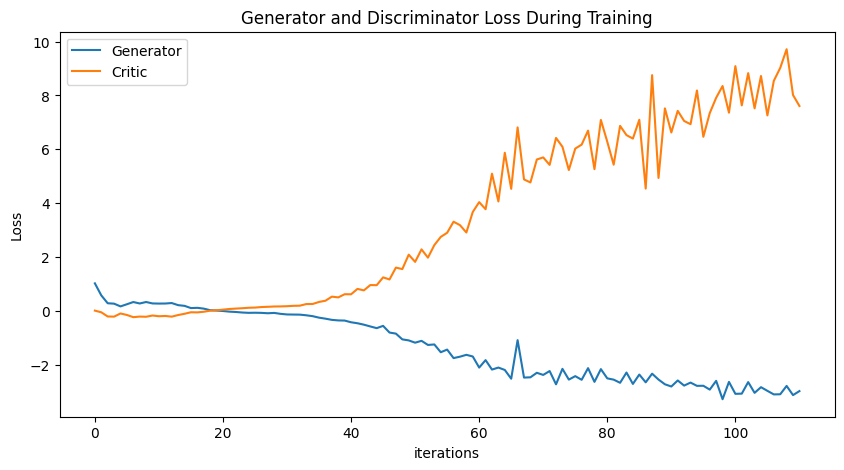

Epoch 120: Critic error ([1.021696020304355, 0.5751790099648636, 0.28241174729364693, 0.2671411554521002, 0.16571580514837497, 0.24568861597661698, 0.3278158144628937, 0.2741599461598232, 0.3287549453933505, 0.2755864759899904, 0.2705972449798348, 0.2729851596078793, 0.2900732391498444, 0.21192772622978023, 0.18585596222397838, 0.10299627371870293, 0.11265718278210908, 0.08287444210203201, 0.024252402105886806, 0.011330095416299715, -0.00525239867733697, -0.02905297038661378, -0.04174596744786184, -0.0617084636633795, -0.0736481869754706, -0.06987606024481585, -0.07489530999912447, -0.08887276613938691, -0.07662745968524705, -0.11120218262816847, -0.13357053300025334, -0.13752825256067444, -0.14061189603258686, -0.16444867069255342, -0.19728295204536384, -0.252883012515175, -0.2901617006441156, -0.33452732852185896, -0.3551721873182914, -0.36083041613811595, -0.42391723413793403, -0.4606565382901305, -0.5132359495855876, -0.5791282342751517, -0.6422781975985904, -0.5574482949995955, -0

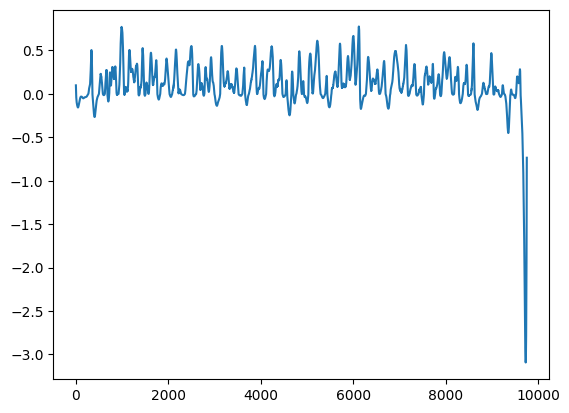

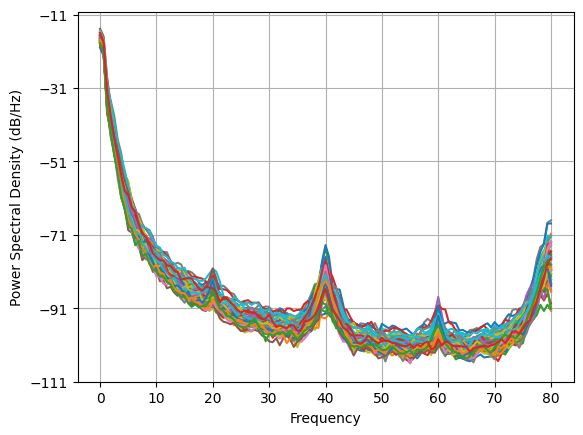

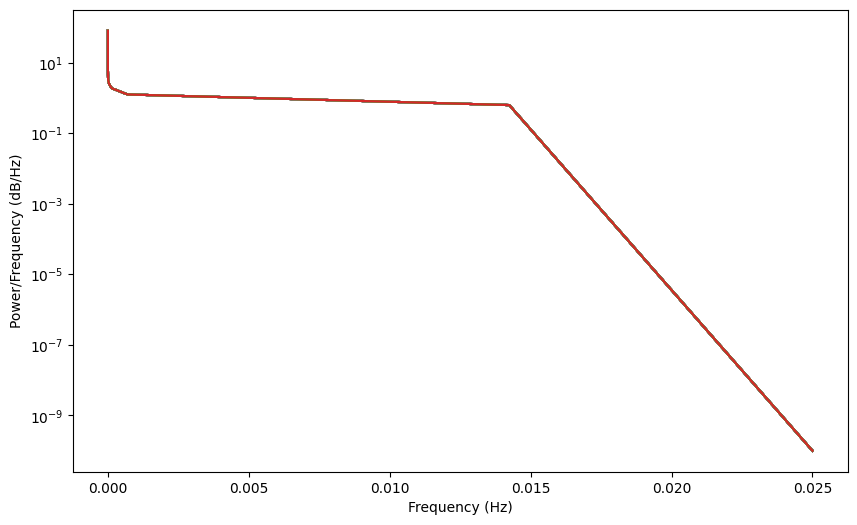

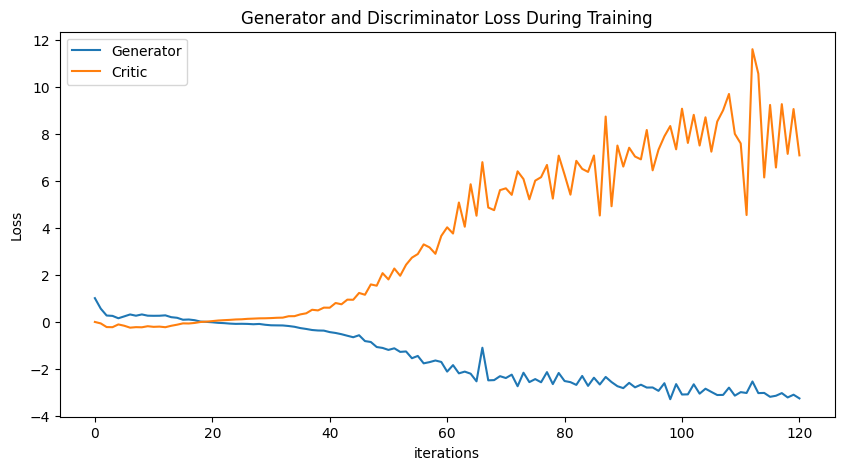

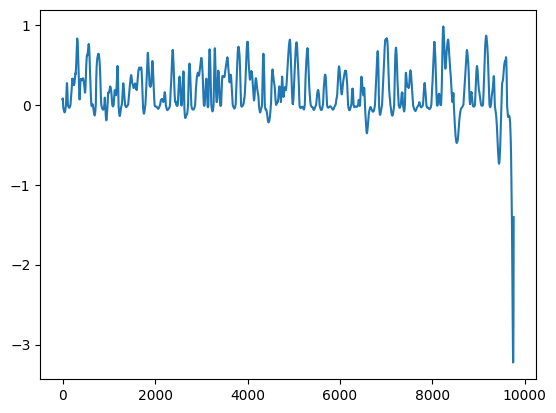

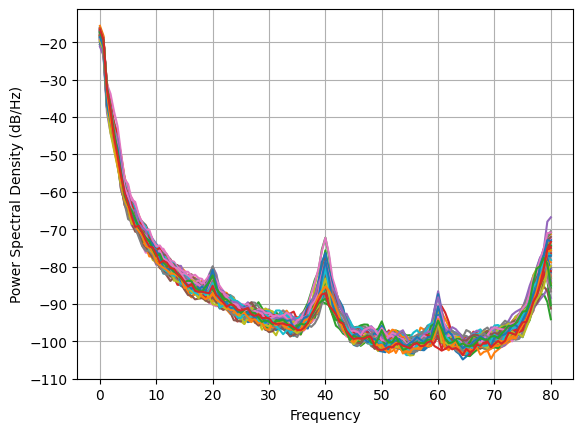

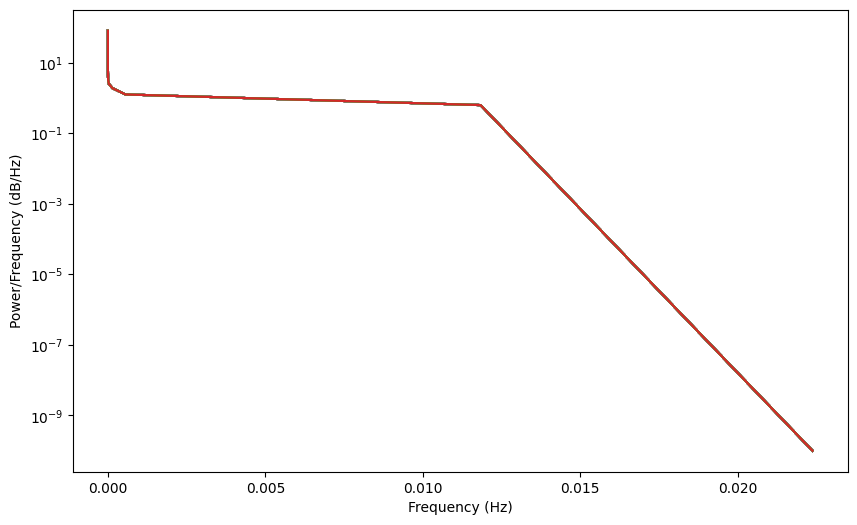

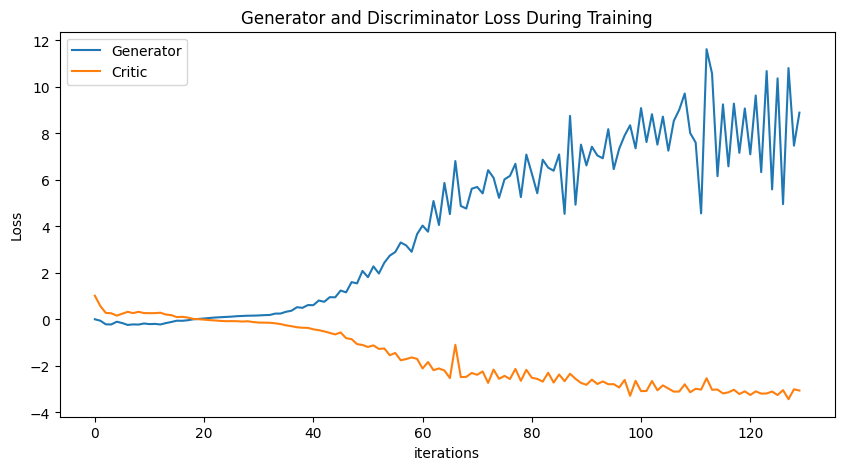

In [19]:
NUM_EPOCHS = 130
PRINT_INTERVAL = 10

training_data = np.load('training_open.npy')
scaler = MinMaxScaler(feature_range=(-1, 1))
normalized_data_open = np.zeros_like(training_data)
for i in range(training_data.shape[1]):
    scaler = scaler.fit(training_data[:, i])
    normalized_data_open[:, i] = scaler.transform(training_data[:, i])
training_data = torch.tensor(normalized_data_open)
BATCH_SIZE = np.shape(training_data)[0]

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            critic_real = D(real).reshape(-1)
            loss_critic_real = -torch.mean(critic_real)
            noise = sample_normal_distribution(BATCH_SIZE, 640, 305)
            fake = G(noise)
            critic_fake = D(fake).reshape(-1)
            loss_critic_fake = torch.mean(critic_fake)
            gp = gradient_penalty(D, real, fake) * LAMBDA_GP
            D.zero_grad()
            loss_critic = loss_critic_real + loss_critic_fake + gp
            loss_critic.backward()
            critic_optimizer.step()  

        noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
        fake = G(noise)
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G
    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated_data_open, disc, gen = train()

torch.save(gen, 'gen_FINAL1_open_norm.pt')
torch.save(disc, 'disc_FINAL1_open_norm.pt')
np.save('complex-open-norm.npy', generated_data_open.detach())
plot_everything(generated_data_open, gen_err, critic_err)
generated_data_open = None

Epoch 0: Critic error ([2.0763412048858267]) Generator err ([0.017341535538434982])


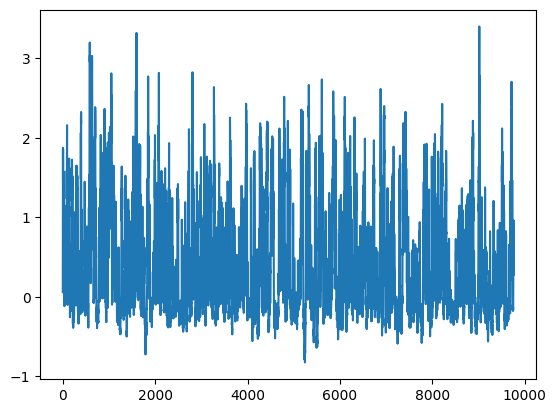

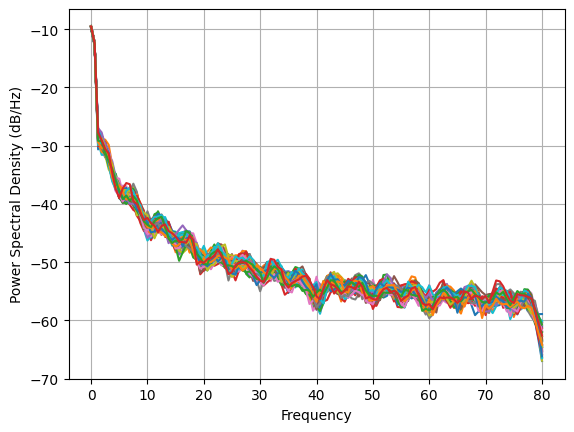

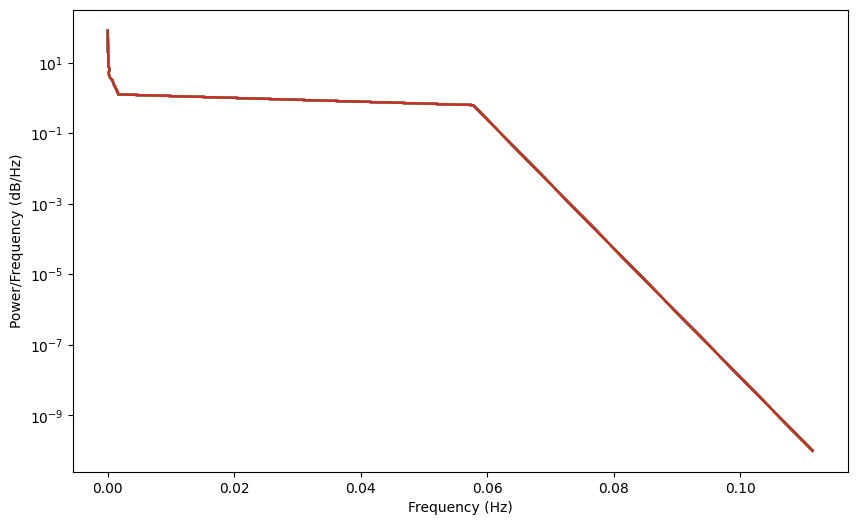

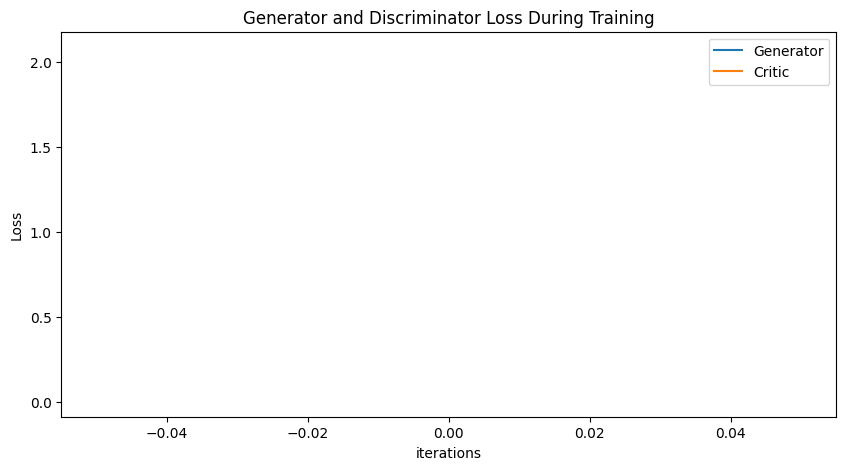

Epoch 10: Critic error ([2.0763412048858267, 0.9543210928162198, 0.15539726514542915, 0.111026260242055, 0.05452770899334504, 0.03293821142114653, 0.034469443186436605, 0.052338328862762844, 0.08828757090793743, 0.06463547060705113, -0.03174017260248815]) Generator err ([0.017341535538434982, -0.08464456349611282, -0.08592014759778976, -0.08696586638689041, -0.030911263078451157, -0.003661869093775749, 0.011906672269105911, -0.014048684388399124, -0.04392818734049797, -0.017418092116713524, 0.10173241794109344])


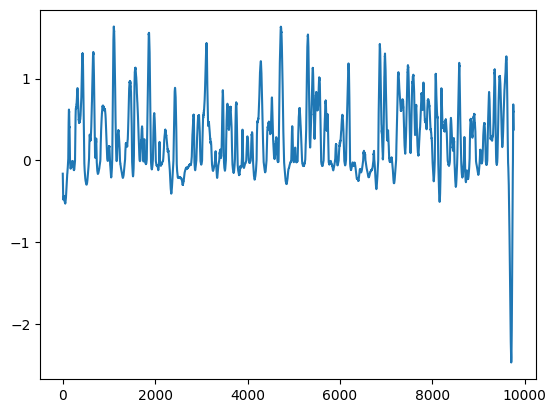

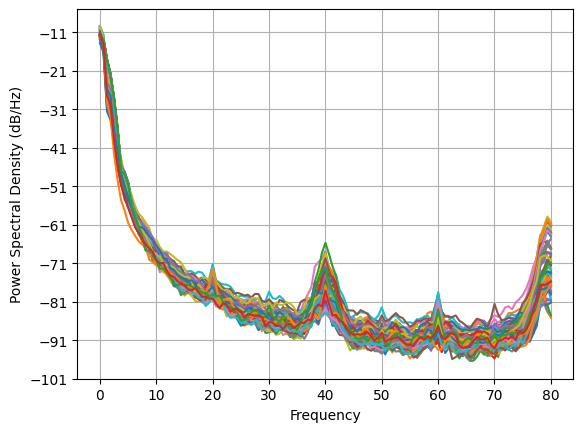

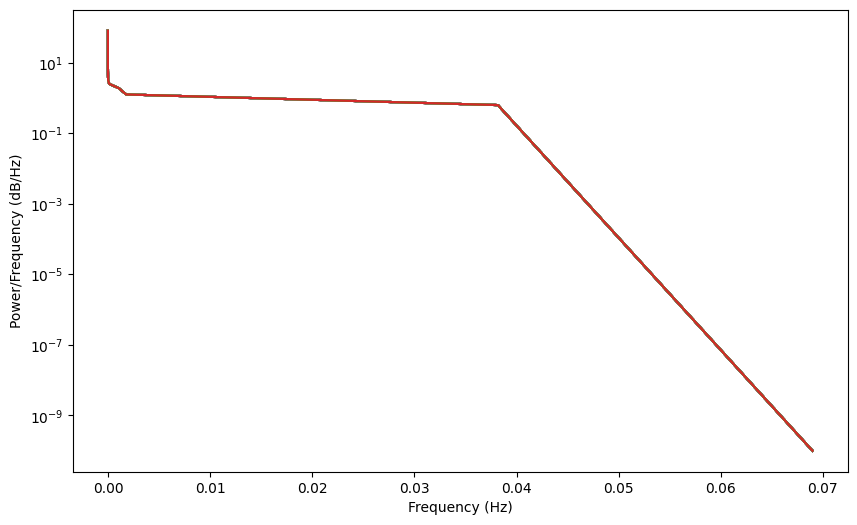

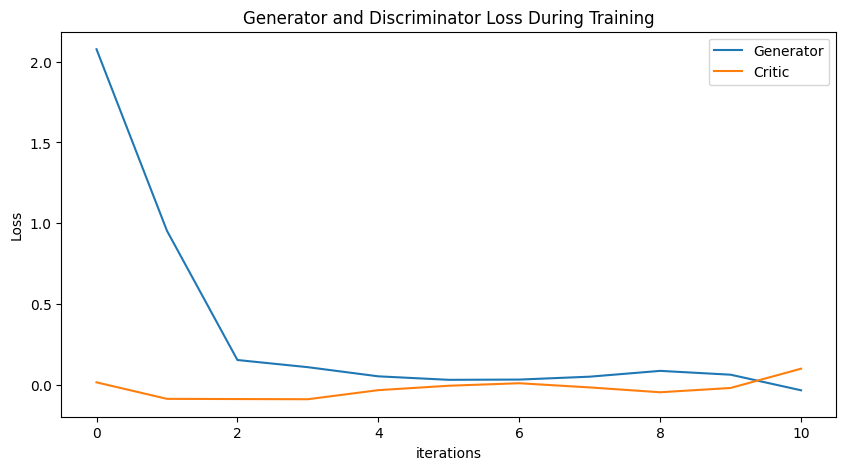

Epoch 20: Critic error ([2.0763412048858267, 0.9543210928162198, 0.15539726514542915, 0.111026260242055, 0.05452770899334504, 0.03293821142114653, 0.034469443186436605, 0.052338328862762844, 0.08828757090793743, 0.06463547060705113, -0.03174017260248815, 0.002859055150261511, -0.01022849086067554, -0.046677130405703676, -0.040301982609872194, -0.08858144576525509, -0.0559906472458273, -0.05875360774107374, -0.08264870684962214, -0.08692955243190542, -0.10451675435612552]) Generator err ([0.017341535538434982, -0.08464456349611282, -0.08592014759778976, -0.08696586638689041, -0.030911263078451157, -0.003661869093775749, 0.011906672269105911, -0.014048684388399124, -0.04392818734049797, -0.017418092116713524, 0.10173241794109344, 0.061890870332717896, 0.08211233466863632, 0.1273626685142517, 0.12670068442821503, 0.19369232654571533, 0.15543457865715027, 0.1575690507888794, 0.1855240911245346, 0.20375017821788788, 0.22425960004329681])


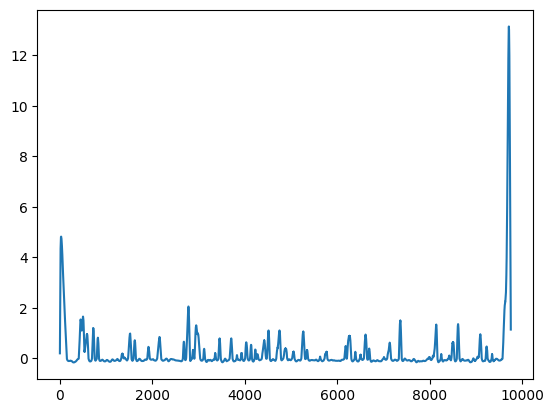

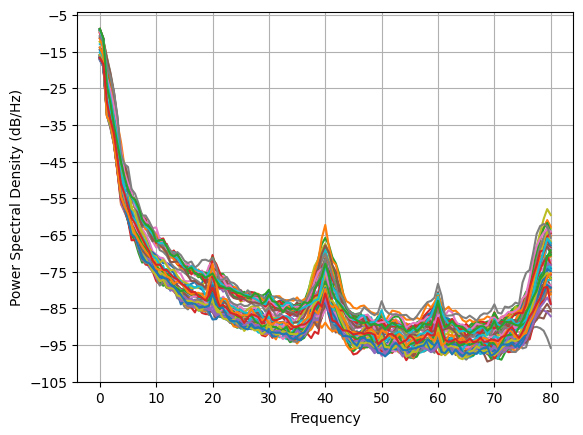

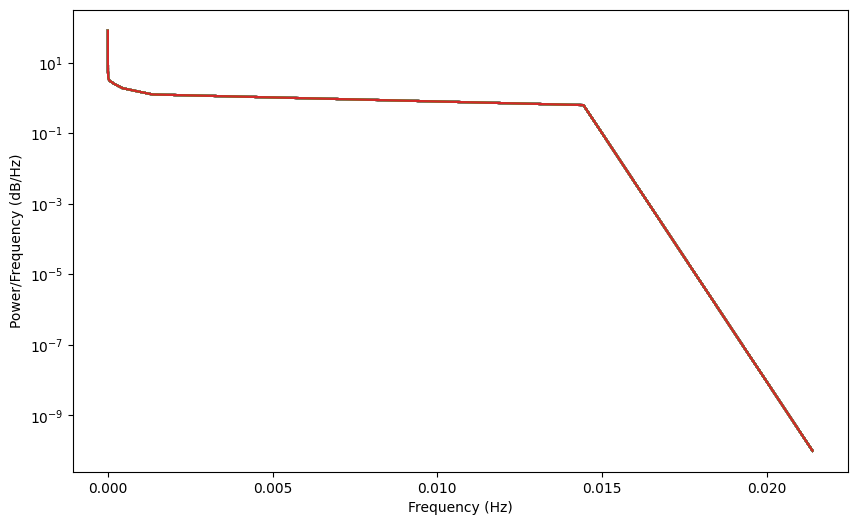

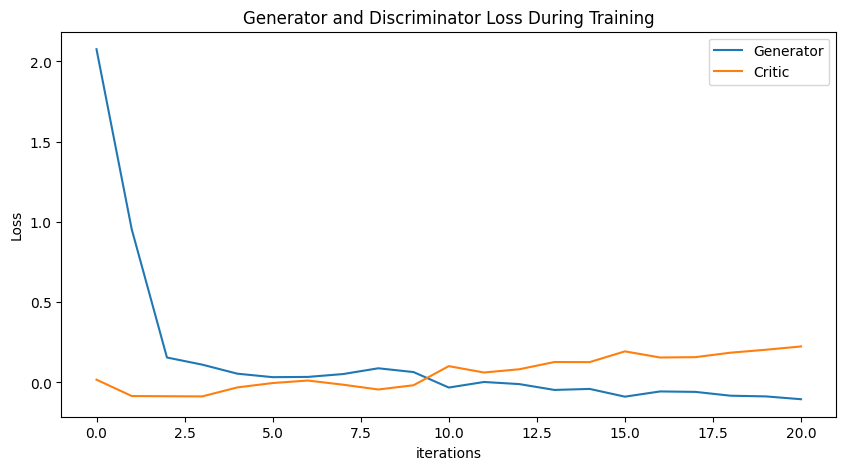

Epoch 30: Critic error ([2.0763412048858267, 0.9543210928162198, 0.15539726514542915, 0.111026260242055, 0.05452770899334504, 0.03293821142114653, 0.034469443186436605, 0.052338328862762844, 0.08828757090793743, 0.06463547060705113, -0.03174017260248815, 0.002859055150261511, -0.01022849086067554, -0.046677130405703676, -0.040301982609872194, -0.08858144576525509, -0.0559906472458273, -0.05875360774107374, -0.08264870684962214, -0.08692955243190542, -0.10451675435612552, -0.16857879428180067, -0.2940654377494536, -0.4588404794009882, -0.4134158428129313, -0.5717118916092077, -0.837368414189961, -1.0515692148766003, -0.8818134405123657, -0.992937853667913, -1.0395036921302623]) Generator err ([0.017341535538434982, -0.08464456349611282, -0.08592014759778976, -0.08696586638689041, -0.030911263078451157, -0.003661869093775749, 0.011906672269105911, -0.014048684388399124, -0.04392818734049797, -0.017418092116713524, 0.10173241794109344, 0.061890870332717896, 0.08211233466863632, 0.12736266

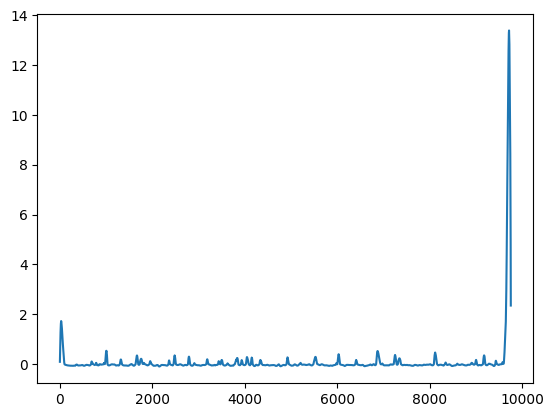

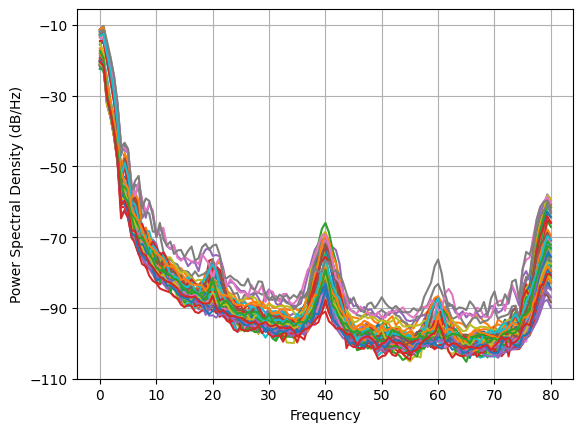

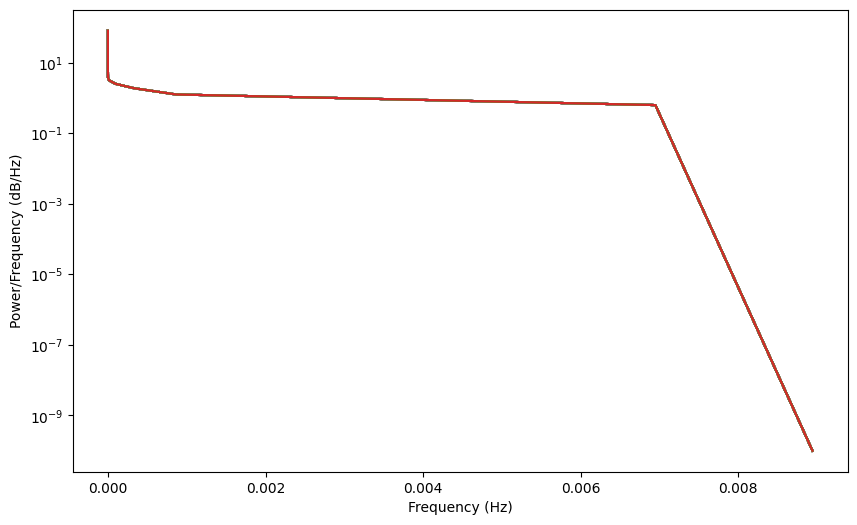

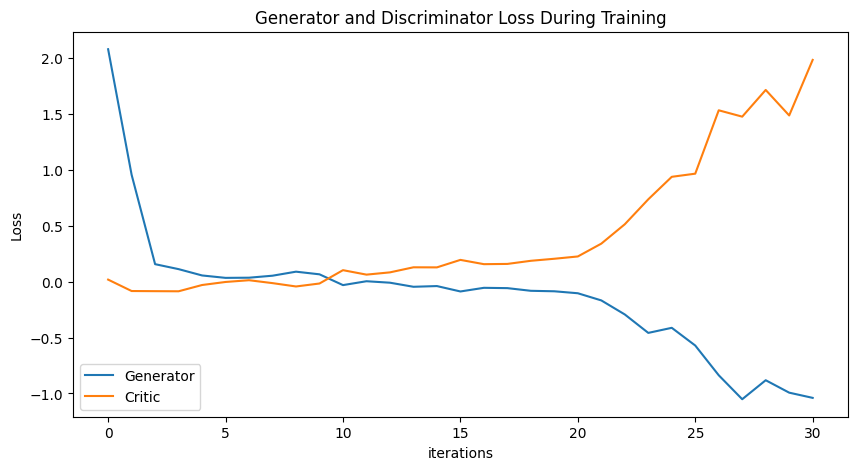

Epoch 40: Critic error ([2.0763412048858267, 0.9543210928162198, 0.15539726514542915, 0.111026260242055, 0.05452770899334504, 0.03293821142114653, 0.034469443186436605, 0.052338328862762844, 0.08828757090793743, 0.06463547060705113, -0.03174017260248815, 0.002859055150261511, -0.01022849086067554, -0.046677130405703676, -0.040301982609872194, -0.08858144576525509, -0.0559906472458273, -0.05875360774107374, -0.08264870684962214, -0.08692955243190542, -0.10451675435612552, -0.16857879428180067, -0.2940654377494536, -0.4588404794009882, -0.4134158428129313, -0.5717118916092077, -0.837368414189961, -1.0515692148766003, -0.8818134405123657, -0.992937853667913, -1.0395036921302623, -1.1275513113135633, -0.9100014424845917, -1.5238042136082908, -0.3420967023361706, -1.510716763641831, -1.280712116492168, -1.520621908978704, -1.1281032322460525, -1.4144589218408399, -1.1907257670547455]) Generator err ([0.017341535538434982, -0.08464456349611282, -0.08592014759778976, -0.08696586638689041, -0.

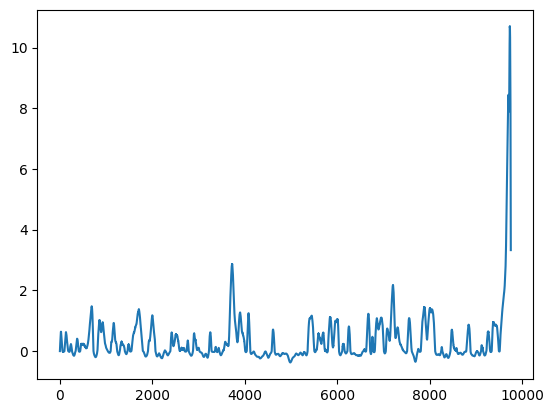

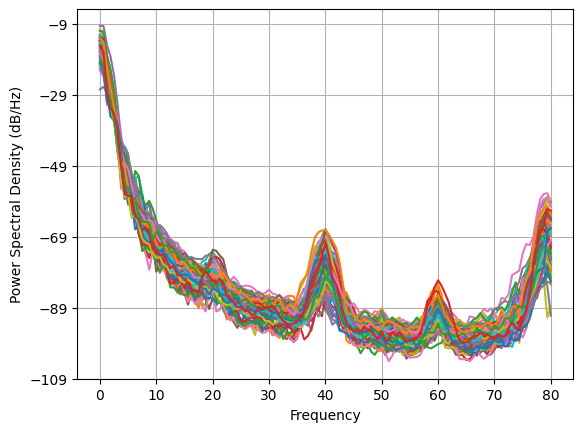

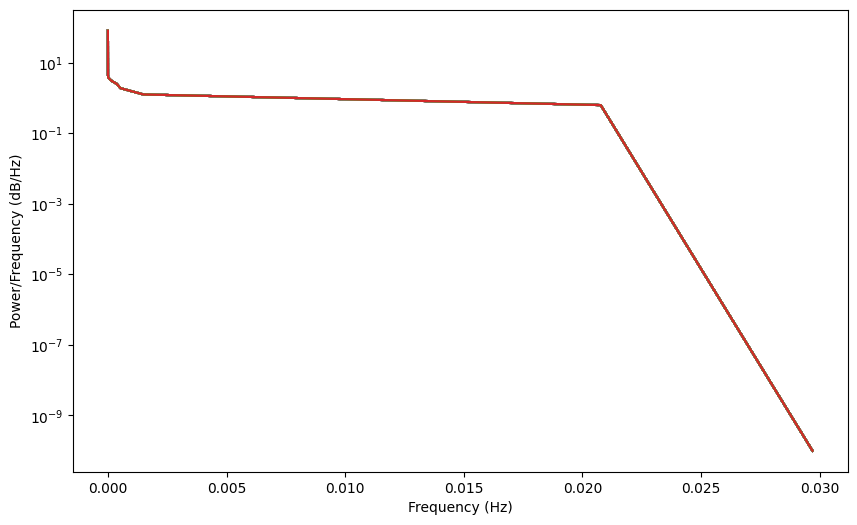

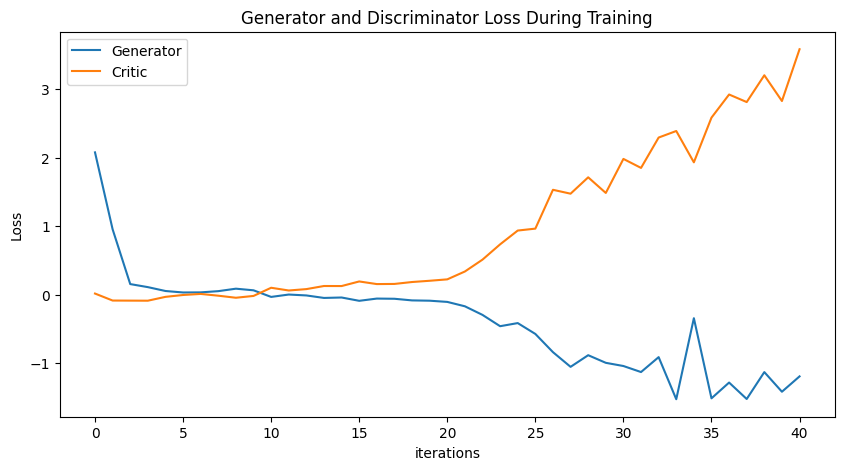

Epoch 50: Critic error ([2.0763412048858267, 0.9543210928162198, 0.15539726514542915, 0.111026260242055, 0.05452770899334504, 0.03293821142114653, 0.034469443186436605, 0.052338328862762844, 0.08828757090793743, 0.06463547060705113, -0.03174017260248815, 0.002859055150261511, -0.01022849086067554, -0.046677130405703676, -0.040301982609872194, -0.08858144576525509, -0.0559906472458273, -0.05875360774107374, -0.08264870684962214, -0.08692955243190542, -0.10451675435612552, -0.16857879428180067, -0.2940654377494536, -0.4588404794009882, -0.4134158428129313, -0.5717118916092077, -0.837368414189961, -1.0515692148766003, -0.8818134405123657, -0.992937853667913, -1.0395036921302623, -1.1275513113135633, -0.9100014424845917, -1.5238042136082908, -0.3420967023361706, -1.510716763641831, -1.280712116492168, -1.520621908978704, -1.1281032322460525, -1.4144589218408399, -1.1907257670547455, -1.7990623455190622, -1.3143053927133295, -1.8376274960791998, -1.7215544196598507, -2.128258655012015, -1.9

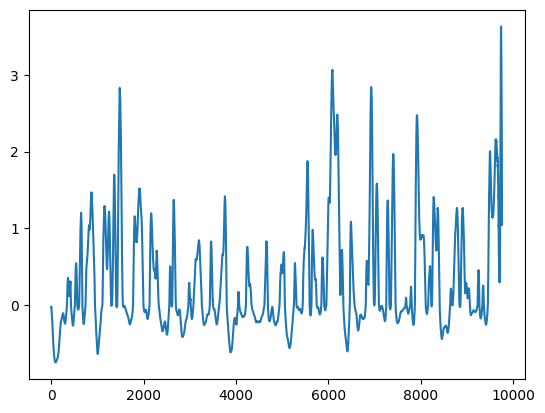

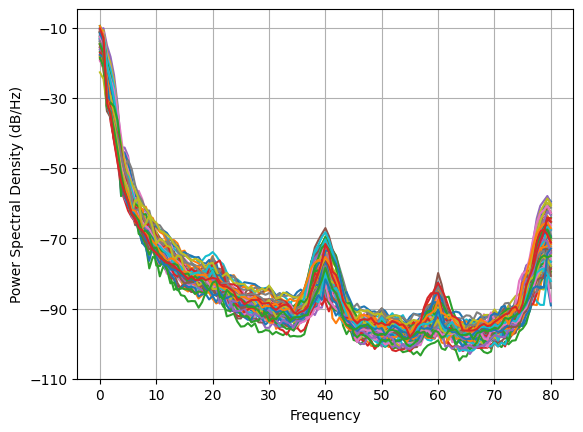

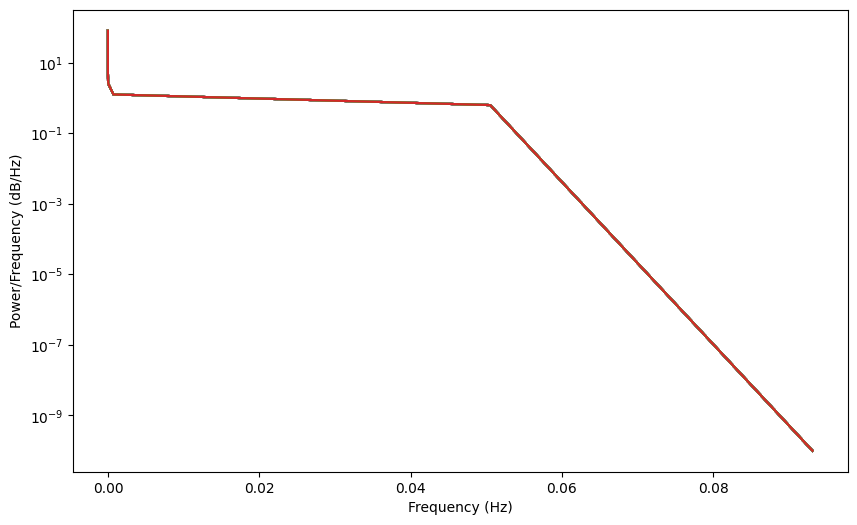

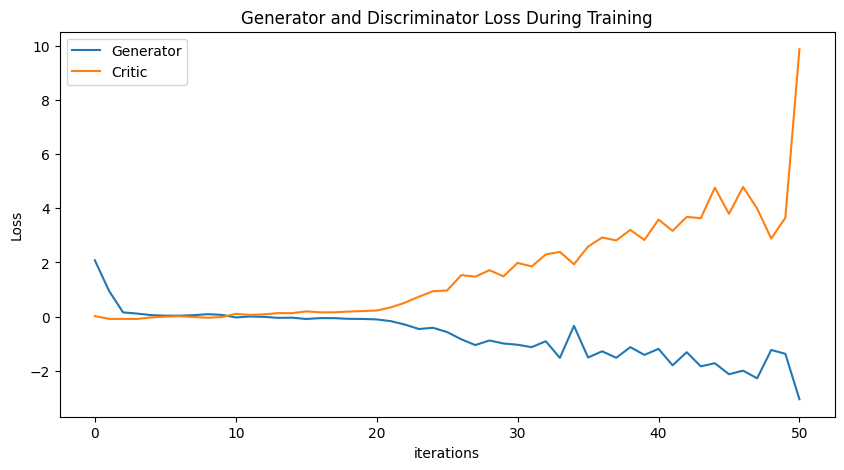

Epoch 60: Critic error ([2.0763412048858267, 0.9543210928162198, 0.15539726514542915, 0.111026260242055, 0.05452770899334504, 0.03293821142114653, 0.034469443186436605, 0.052338328862762844, 0.08828757090793743, 0.06463547060705113, -0.03174017260248815, 0.002859055150261511, -0.01022849086067554, -0.046677130405703676, -0.040301982609872194, -0.08858144576525509, -0.0559906472458273, -0.05875360774107374, -0.08264870684962214, -0.08692955243190542, -0.10451675435612552, -0.16857879428180067, -0.2940654377494536, -0.4588404794009882, -0.4134158428129313, -0.5717118916092077, -0.837368414189961, -1.0515692148766003, -0.8818134405123657, -0.992937853667913, -1.0395036921302623, -1.1275513113135633, -0.9100014424845917, -1.5238042136082908, -0.3420967023361706, -1.510716763641831, -1.280712116492168, -1.520621908978704, -1.1281032322460525, -1.4144589218408399, -1.1907257670547455, -1.7990623455190622, -1.3143053927133295, -1.8376274960791998, -1.7215544196598507, -2.128258655012015, -1.9

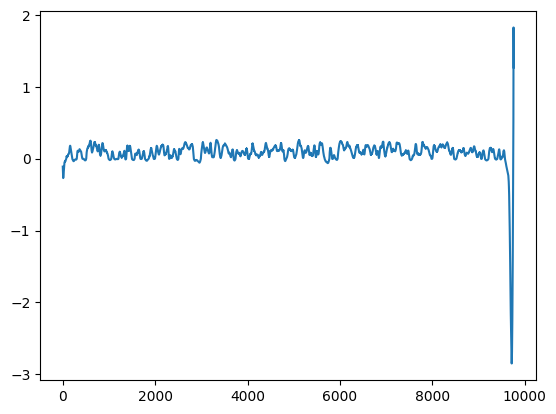

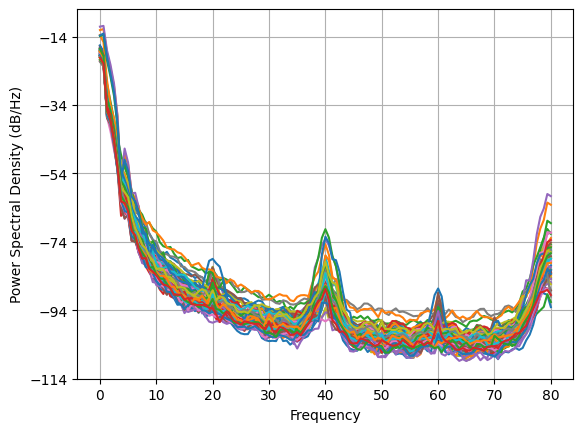

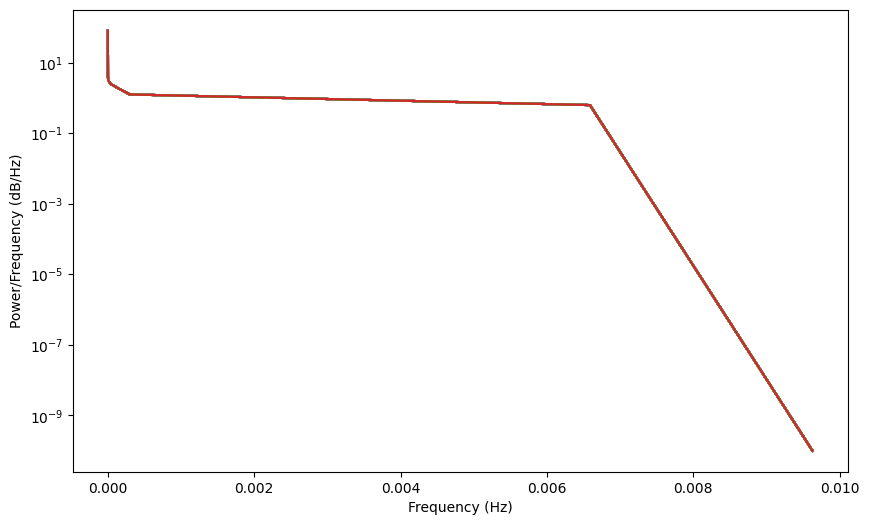

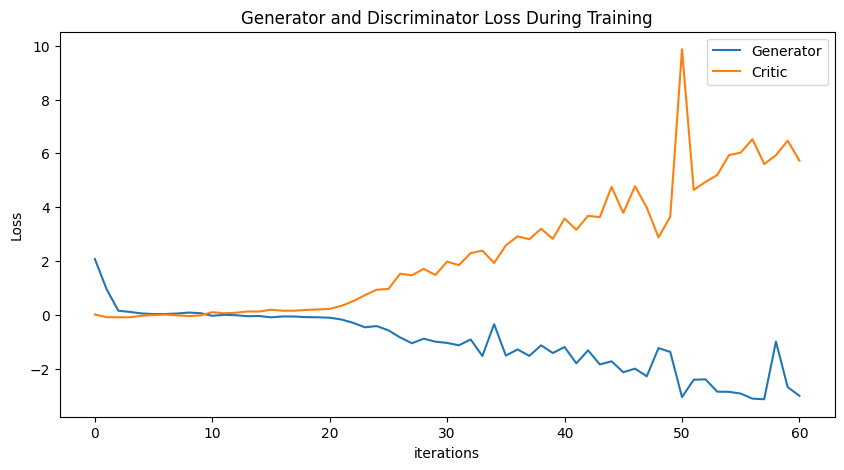

Epoch 70: Critic error ([2.0763412048858267, 0.9543210928162198, 0.15539726514542915, 0.111026260242055, 0.05452770899334504, 0.03293821142114653, 0.034469443186436605, 0.052338328862762844, 0.08828757090793743, 0.06463547060705113, -0.03174017260248815, 0.002859055150261511, -0.01022849086067554, -0.046677130405703676, -0.040301982609872194, -0.08858144576525509, -0.0559906472458273, -0.05875360774107374, -0.08264870684962214, -0.08692955243190542, -0.10451675435612552, -0.16857879428180067, -0.2940654377494536, -0.4588404794009882, -0.4134158428129313, -0.5717118916092077, -0.837368414189961, -1.0515692148766003, -0.8818134405123657, -0.992937853667913, -1.0395036921302623, -1.1275513113135633, -0.9100014424845917, -1.5238042136082908, -0.3420967023361706, -1.510716763641831, -1.280712116492168, -1.520621908978704, -1.1281032322460525, -1.4144589218408399, -1.1907257670547455, -1.7990623455190622, -1.3143053927133295, -1.8376274960791998, -1.7215544196598507, -2.128258655012015, -1.9

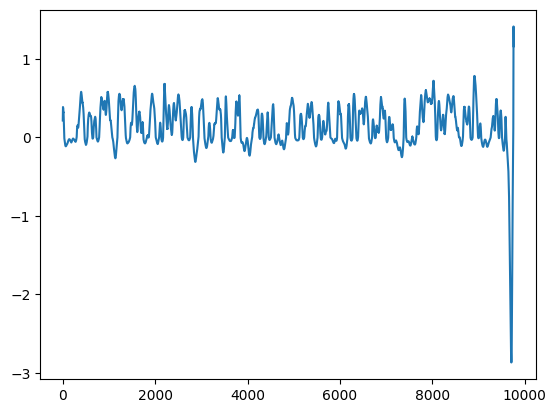

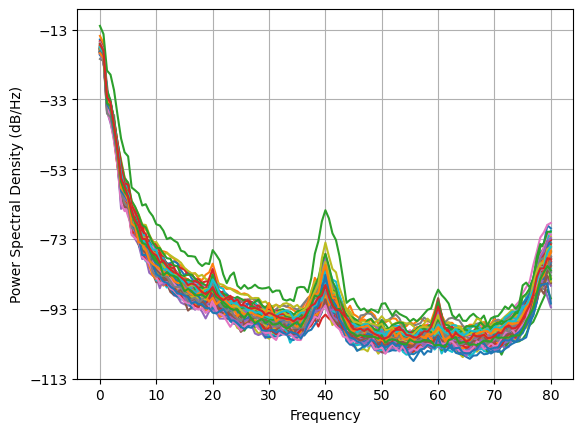

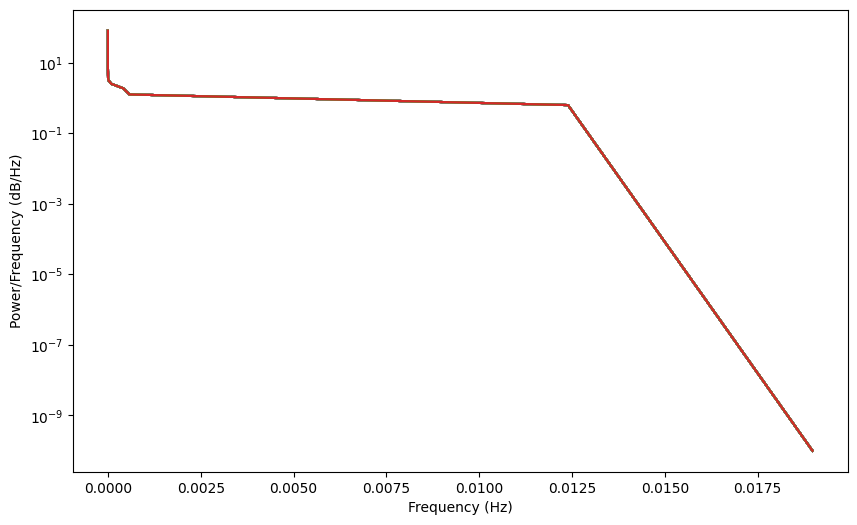

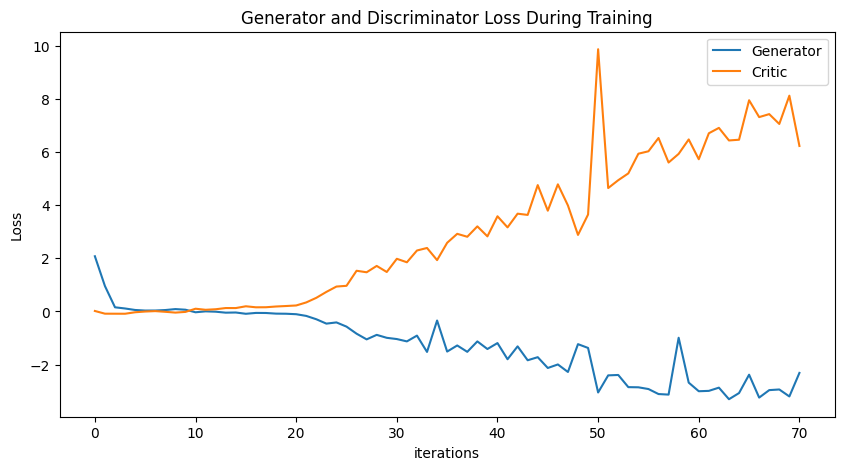

Epoch 80: Critic error ([2.0763412048858267, 0.9543210928162198, 0.15539726514542915, 0.111026260242055, 0.05452770899334504, 0.03293821142114653, 0.034469443186436605, 0.052338328862762844, 0.08828757090793743, 0.06463547060705113, -0.03174017260248815, 0.002859055150261511, -0.01022849086067554, -0.046677130405703676, -0.040301982609872194, -0.08858144576525509, -0.0559906472458273, -0.05875360774107374, -0.08264870684962214, -0.08692955243190542, -0.10451675435612552, -0.16857879428180067, -0.2940654377494536, -0.4588404794009882, -0.4134158428129313, -0.5717118916092077, -0.837368414189961, -1.0515692148766003, -0.8818134405123657, -0.992937853667913, -1.0395036921302623, -1.1275513113135633, -0.9100014424845917, -1.5238042136082908, -0.3420967023361706, -1.510716763641831, -1.280712116492168, -1.520621908978704, -1.1281032322460525, -1.4144589218408399, -1.1907257670547455, -1.7990623455190622, -1.3143053927133295, -1.8376274960791998, -1.7215544196598507, -2.128258655012015, -1.9

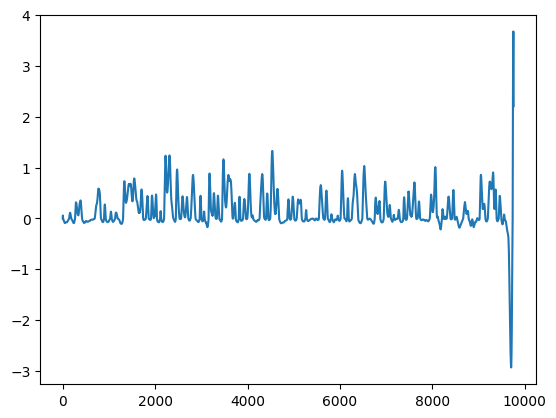

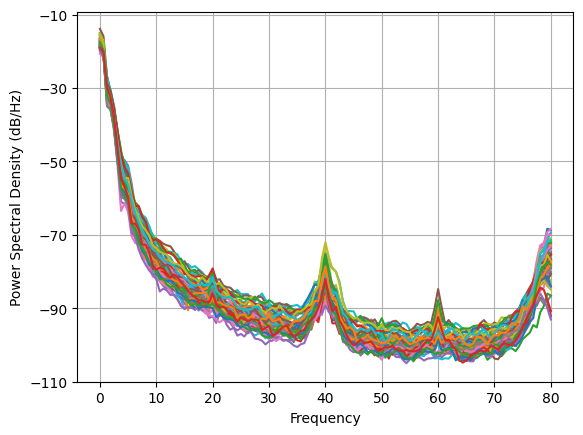

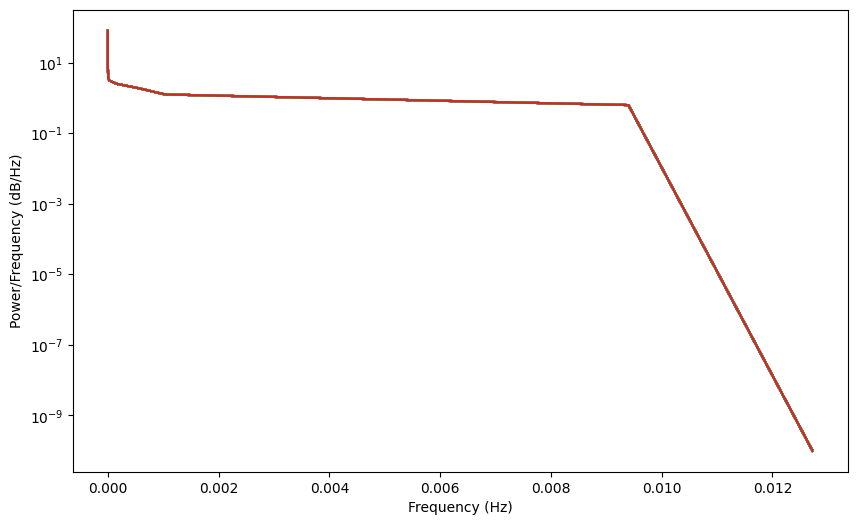

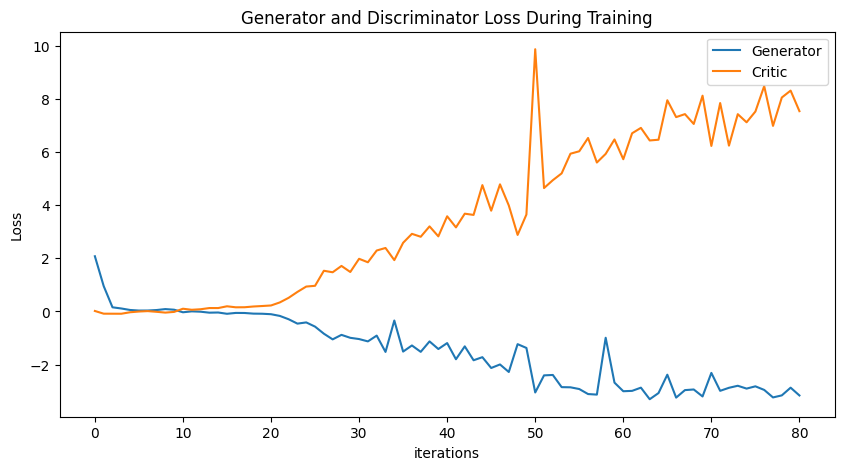

Epoch 90: Critic error ([2.0763412048858267, 0.9543210928162198, 0.15539726514542915, 0.111026260242055, 0.05452770899334504, 0.03293821142114653, 0.034469443186436605, 0.052338328862762844, 0.08828757090793743, 0.06463547060705113, -0.03174017260248815, 0.002859055150261511, -0.01022849086067554, -0.046677130405703676, -0.040301982609872194, -0.08858144576525509, -0.0559906472458273, -0.05875360774107374, -0.08264870684962214, -0.08692955243190542, -0.10451675435612552, -0.16857879428180067, -0.2940654377494536, -0.4588404794009882, -0.4134158428129313, -0.5717118916092077, -0.837368414189961, -1.0515692148766003, -0.8818134405123657, -0.992937853667913, -1.0395036921302623, -1.1275513113135633, -0.9100014424845917, -1.5238042136082908, -0.3420967023361706, -1.510716763641831, -1.280712116492168, -1.520621908978704, -1.1281032322460525, -1.4144589218408399, -1.1907257670547455, -1.7990623455190622, -1.3143053927133295, -1.8376274960791998, -1.7215544196598507, -2.128258655012015, -1.9

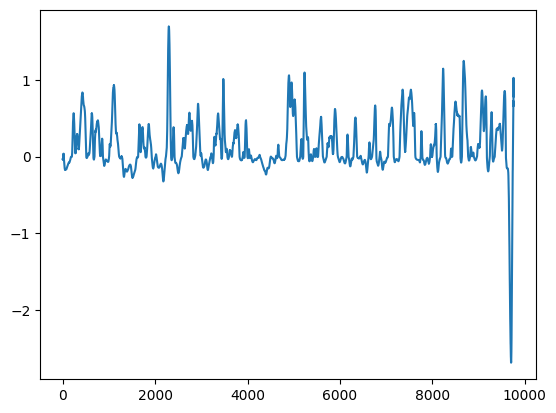

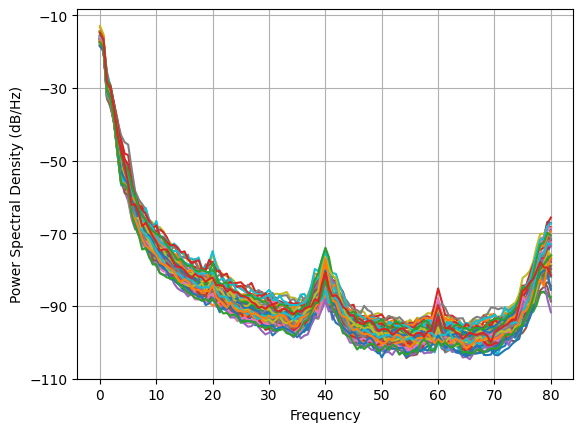

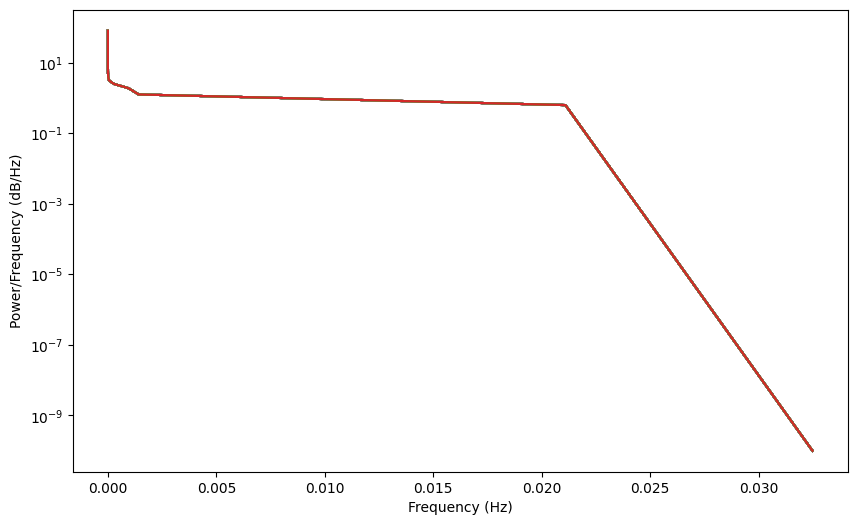

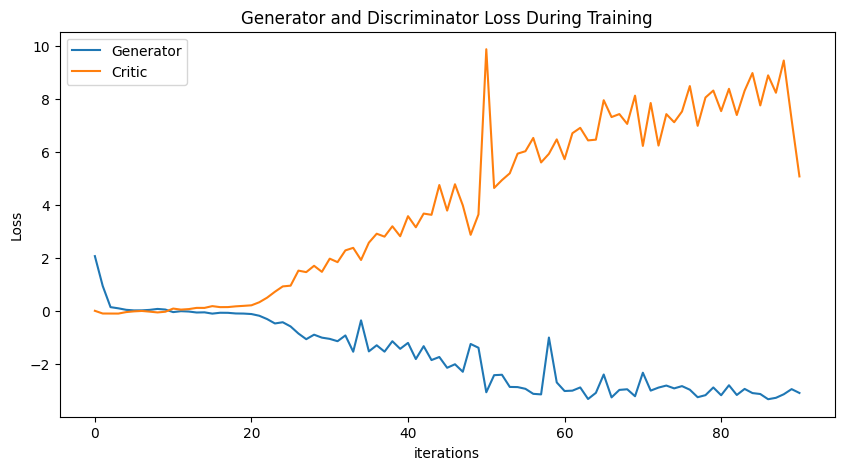

Epoch 100: Critic error ([2.0763412048858267, 0.9543210928162198, 0.15539726514542915, 0.111026260242055, 0.05452770899334504, 0.03293821142114653, 0.034469443186436605, 0.052338328862762844, 0.08828757090793743, 0.06463547060705113, -0.03174017260248815, 0.002859055150261511, -0.01022849086067554, -0.046677130405703676, -0.040301982609872194, -0.08858144576525509, -0.0559906472458273, -0.05875360774107374, -0.08264870684962214, -0.08692955243190542, -0.10451675435612552, -0.16857879428180067, -0.2940654377494536, -0.4588404794009882, -0.4134158428129313, -0.5717118916092077, -0.837368414189961, -1.0515692148766003, -0.8818134405123657, -0.992937853667913, -1.0395036921302623, -1.1275513113135633, -0.9100014424845917, -1.5238042136082908, -0.3420967023361706, -1.510716763641831, -1.280712116492168, -1.520621908978704, -1.1281032322460525, -1.4144589218408399, -1.1907257670547455, -1.7990623455190622, -1.3143053927133295, -1.8376274960791998, -1.7215544196598507, -2.128258655012015, -1.

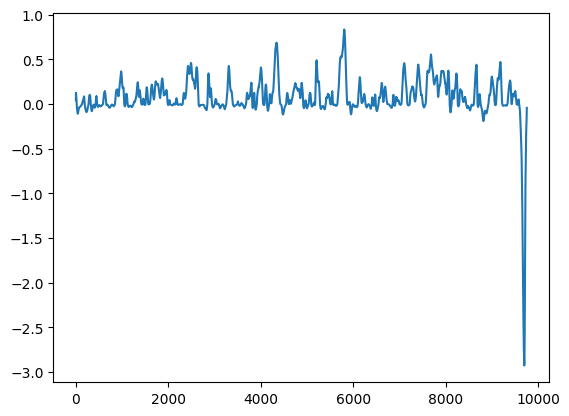

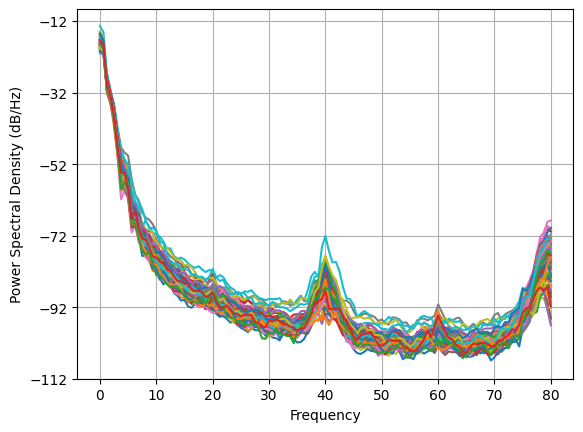

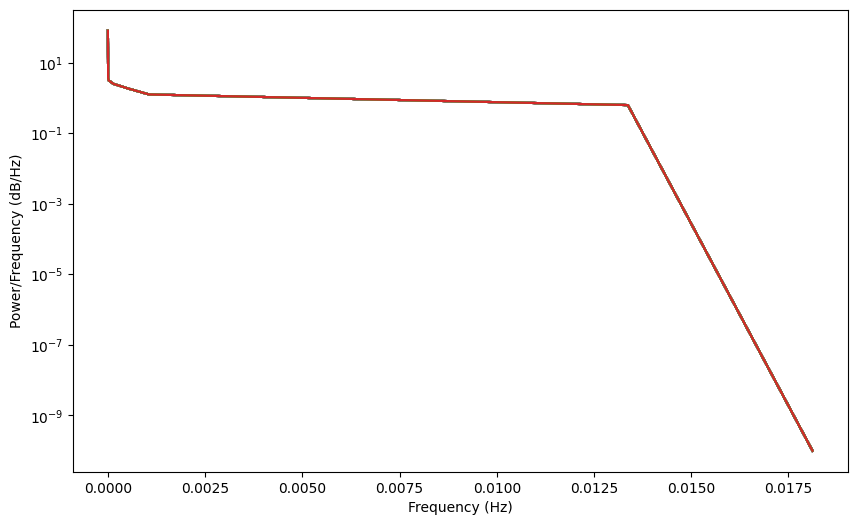

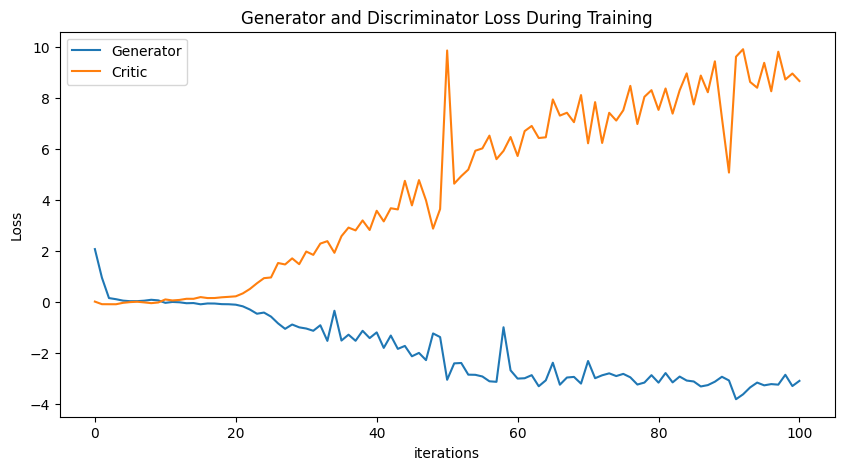

Epoch 110: Critic error ([2.0763412048858267, 0.9543210928162198, 0.15539726514542915, 0.111026260242055, 0.05452770899334504, 0.03293821142114653, 0.034469443186436605, 0.052338328862762844, 0.08828757090793743, 0.06463547060705113, -0.03174017260248815, 0.002859055150261511, -0.01022849086067554, -0.046677130405703676, -0.040301982609872194, -0.08858144576525509, -0.0559906472458273, -0.05875360774107374, -0.08264870684962214, -0.08692955243190542, -0.10451675435612552, -0.16857879428180067, -0.2940654377494536, -0.4588404794009882, -0.4134158428129313, -0.5717118916092077, -0.837368414189961, -1.0515692148766003, -0.8818134405123657, -0.992937853667913, -1.0395036921302623, -1.1275513113135633, -0.9100014424845917, -1.5238042136082908, -0.3420967023361706, -1.510716763641831, -1.280712116492168, -1.520621908978704, -1.1281032322460525, -1.4144589218408399, -1.1907257670547455, -1.7990623455190622, -1.3143053927133295, -1.8376274960791998, -1.7215544196598507, -2.128258655012015, -1.

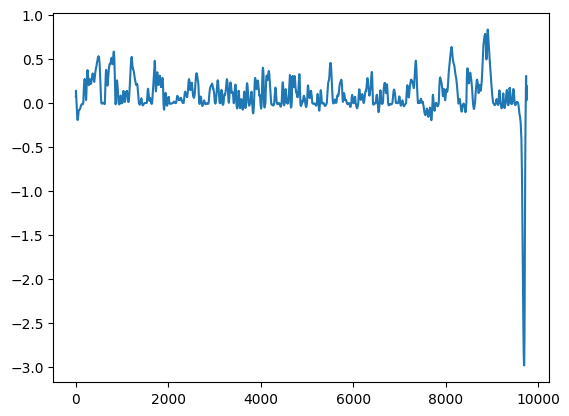

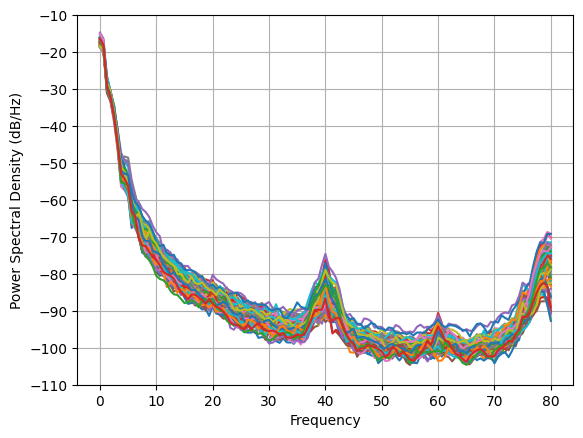

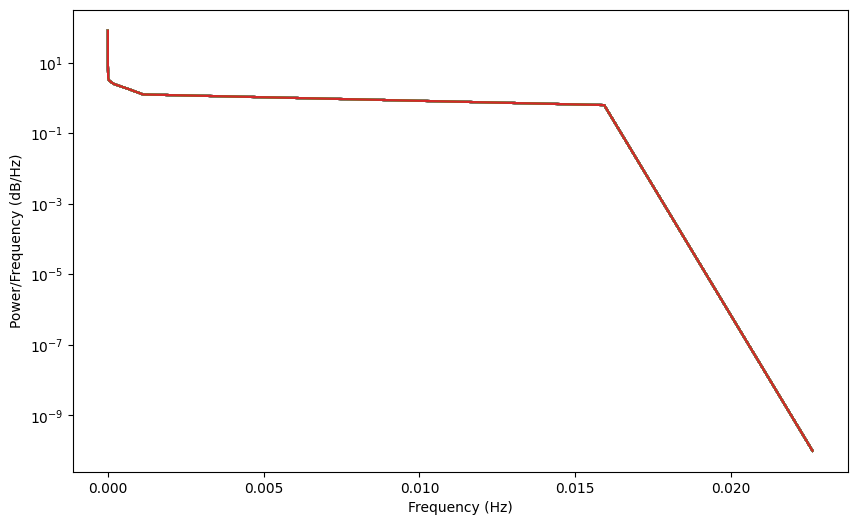

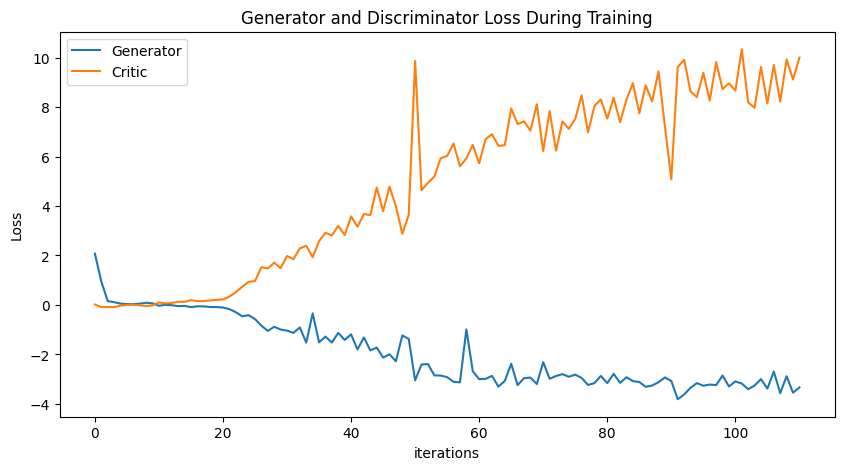

Epoch 120: Critic error ([2.0763412048858267, 0.9543210928162198, 0.15539726514542915, 0.111026260242055, 0.05452770899334504, 0.03293821142114653, 0.034469443186436605, 0.052338328862762844, 0.08828757090793743, 0.06463547060705113, -0.03174017260248815, 0.002859055150261511, -0.01022849086067554, -0.046677130405703676, -0.040301982609872194, -0.08858144576525509, -0.0559906472458273, -0.05875360774107374, -0.08264870684962214, -0.08692955243190542, -0.10451675435612552, -0.16857879428180067, -0.2940654377494536, -0.4588404794009882, -0.4134158428129313, -0.5717118916092077, -0.837368414189961, -1.0515692148766003, -0.8818134405123657, -0.992937853667913, -1.0395036921302623, -1.1275513113135633, -0.9100014424845917, -1.5238042136082908, -0.3420967023361706, -1.510716763641831, -1.280712116492168, -1.520621908978704, -1.1281032322460525, -1.4144589218408399, -1.1907257670547455, -1.7990623455190622, -1.3143053927133295, -1.8376274960791998, -1.7215544196598507, -2.128258655012015, -1.

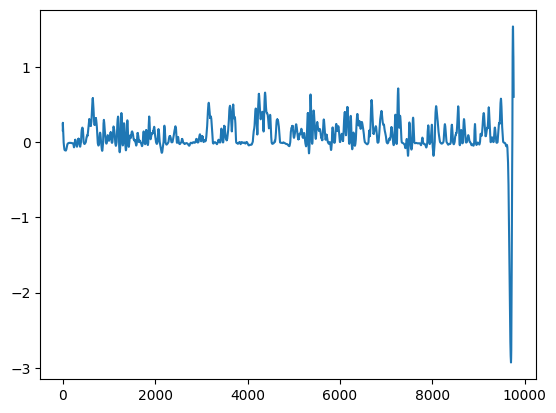

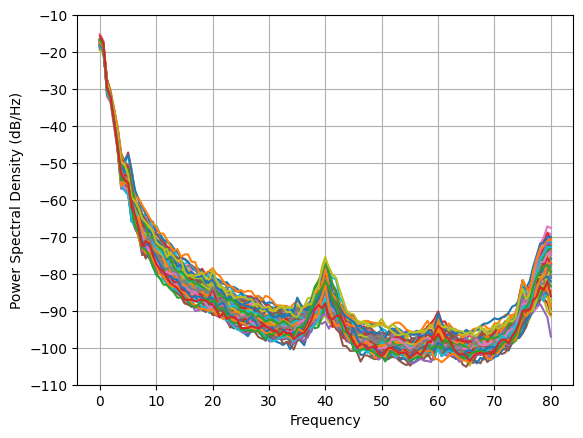

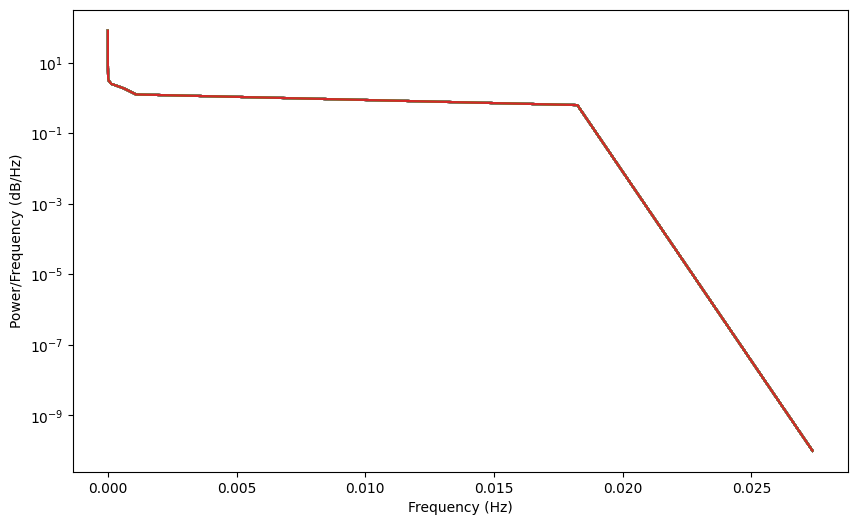

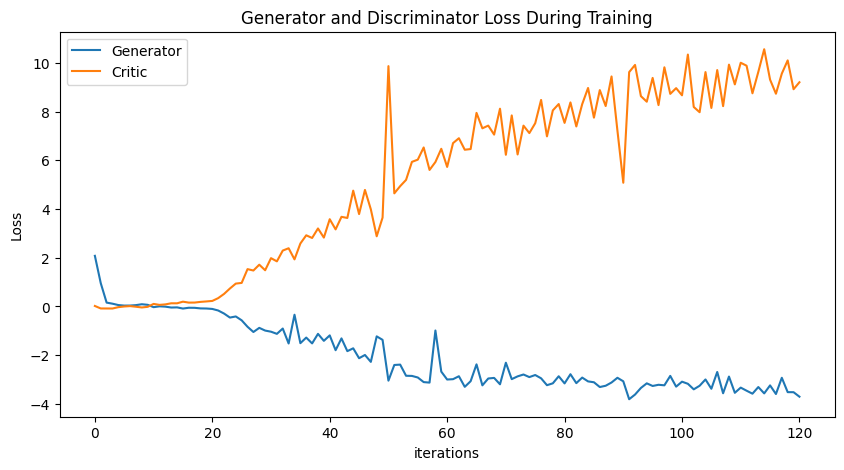

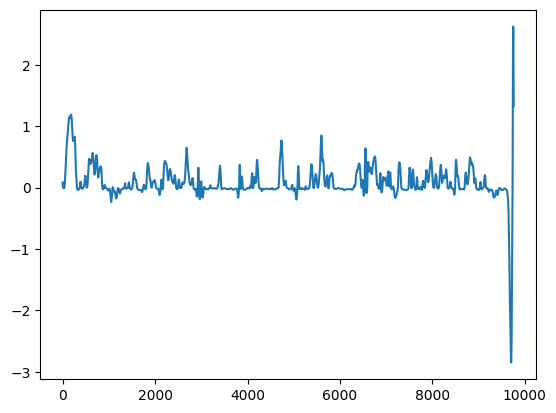

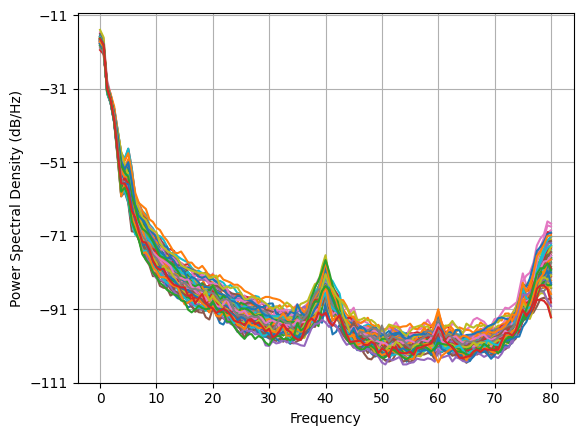

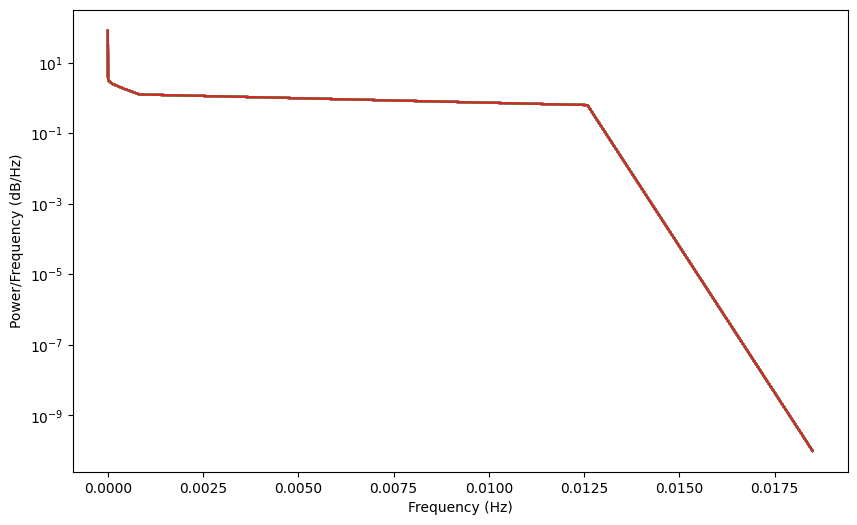

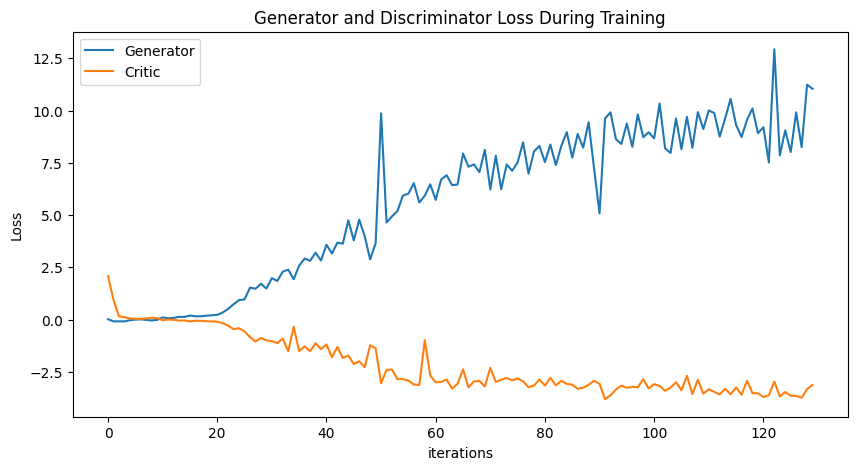

In [20]:
NUM_EPOCHS = 130
PRINT_INTERVAL = 10

training_data = np.load('training_closed.npy')
scaler = MinMaxScaler(feature_range=(-1, 1))
normalized_data_open = np.zeros_like(training_data)
for i in range(training_data.shape[1]):
    scaler = scaler.fit(training_data[:, i])
    normalized_data_open[:, i] = scaler.transform(training_data[:, i])
training_data = torch.tensor(normalized_data_open)
BATCH_SIZE = np.shape(training_data)[0]

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 640, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1)
            critic_fake = D(fake).reshape(-1)
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()
            critic_optimizer.zero_grad()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        gen_optimizer.zero_grad()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(generated_data, critic_err, gen_err)

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data_closed, disc, gen = train()

torch.save(gen, 'gen_FINA1L_closed_norm.pt')
torch.save(disc, 'disc_FINAL1_closed_norm.pt')
np.save('complex-closed-norm.npy', generated_data_closed.detach())
plot_everything(generated_data_closed, gen_err, critic_err)

In [21]:
generated_data_closed = None

# both models complex

Epoch 0: Critic error ([1.1757979870198134]) Generator err ([0.01347041130065918])


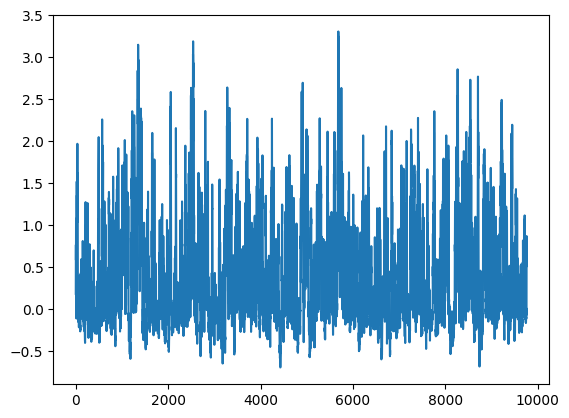

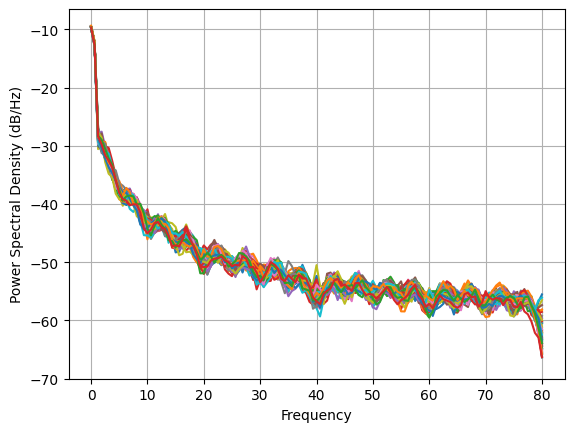

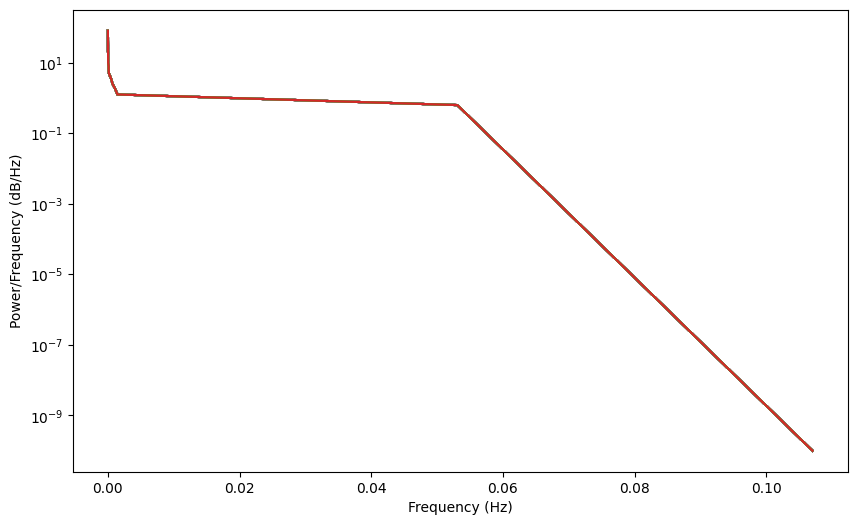

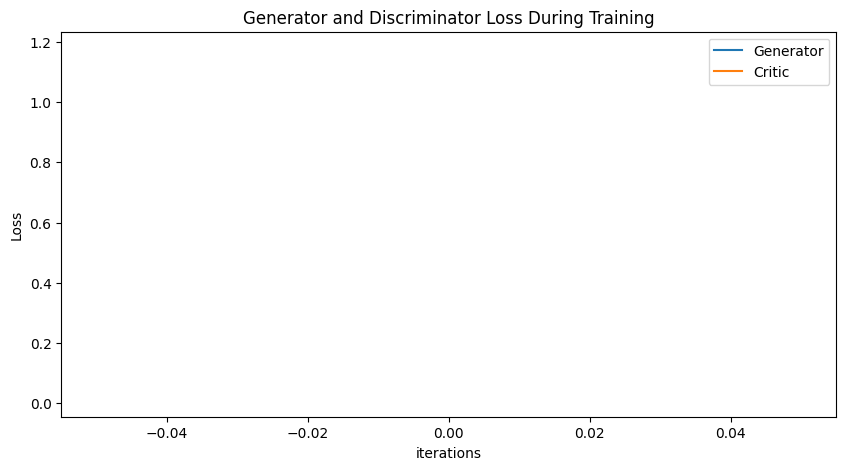

Epoch 10: Critic error ([1.1757979870198134, 0.319477265326286, 0.1389430877350568, 0.06465913293808404, 0.064459102834612, 0.10555812829934799, 0.12605127381406564, 0.14095589860337435, 0.07263318292315712, 0.13532834227763846, 0.1429700682435544]) Generator err ([0.01347041130065918, -0.006038880441337824, -0.002585703507065773, 0.0015928857028484344, -0.03651926666498184, -0.0840204581618309, -0.10241004824638367, -0.11356367915868759, -0.017291031777858734, -0.09794484078884125, -0.09893301874399185])


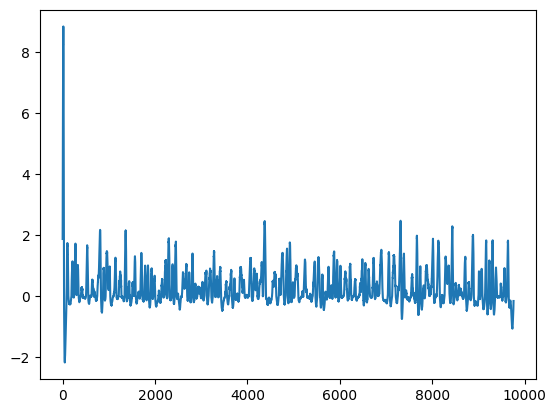

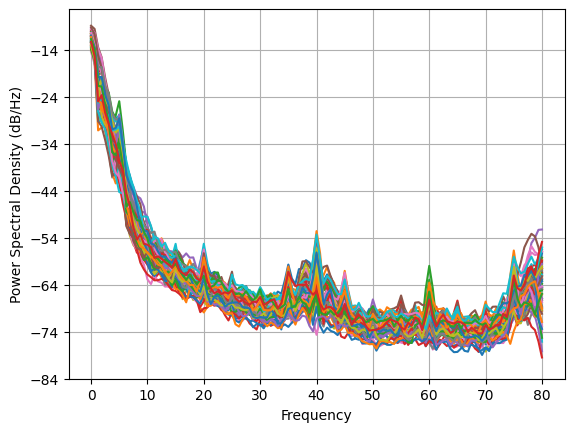

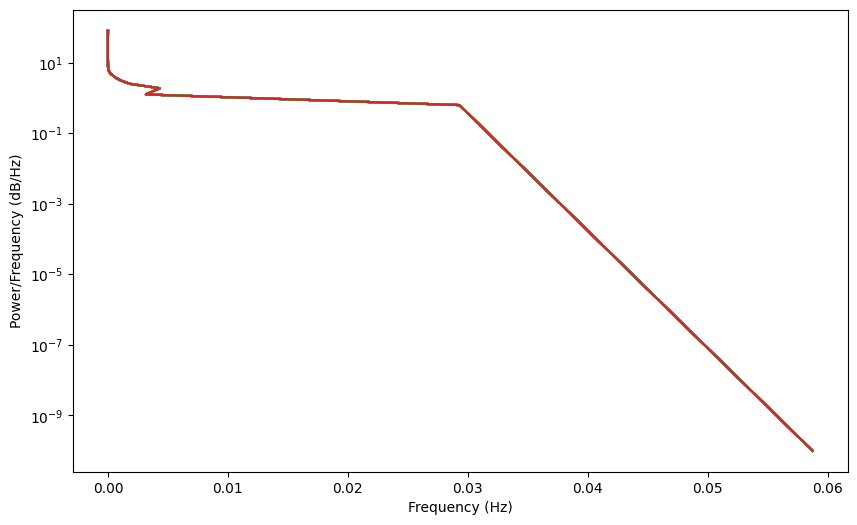

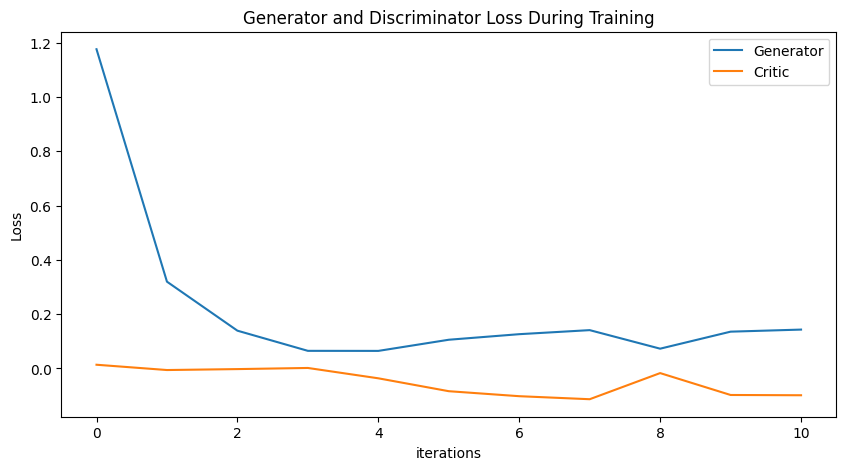

Epoch 20: Critic error ([1.1757979870198134, 0.319477265326286, 0.1389430877350568, 0.06465913293808404, 0.064459102834612, 0.10555812829934799, 0.12605127381406564, 0.14095589860337435, 0.07263318292315712, 0.13532834227763846, 0.1429700682435544, 0.11142557065433446, 0.07819845979885466, 0.059006937168429315, 0.01658835937177945, -0.02919521708459379, -0.031161248723638787, -0.038305065973364784, -0.06822495125154622, -0.05615216297209024, -0.08582565219550521]) Generator err ([0.01347041130065918, -0.006038880441337824, -0.002585703507065773, 0.0015928857028484344, -0.03651926666498184, -0.0840204581618309, -0.10241004824638367, -0.11356367915868759, -0.017291031777858734, -0.09794484078884125, -0.09893301874399185, -0.06911502033472061, -0.04453977942466736, -0.02694559656083584, 0.013093366287648678, 0.05651228129863739, 0.06408065557479858, 0.08168911188840866, 0.100748211145401, 0.10516732186079025, 0.12320665270090103])


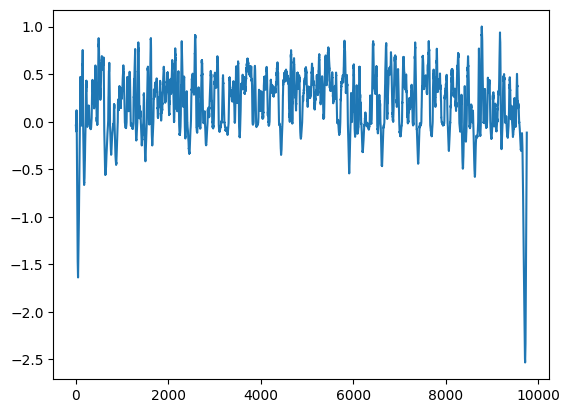

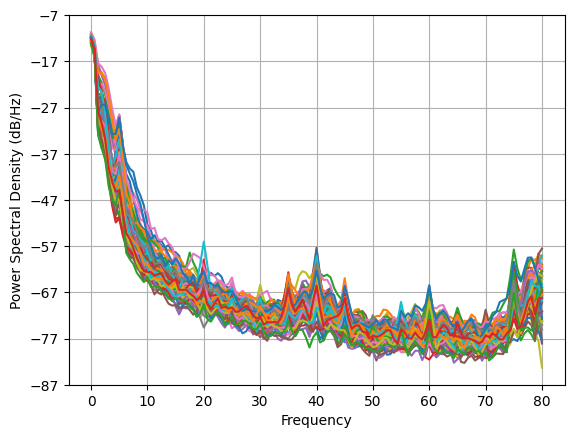

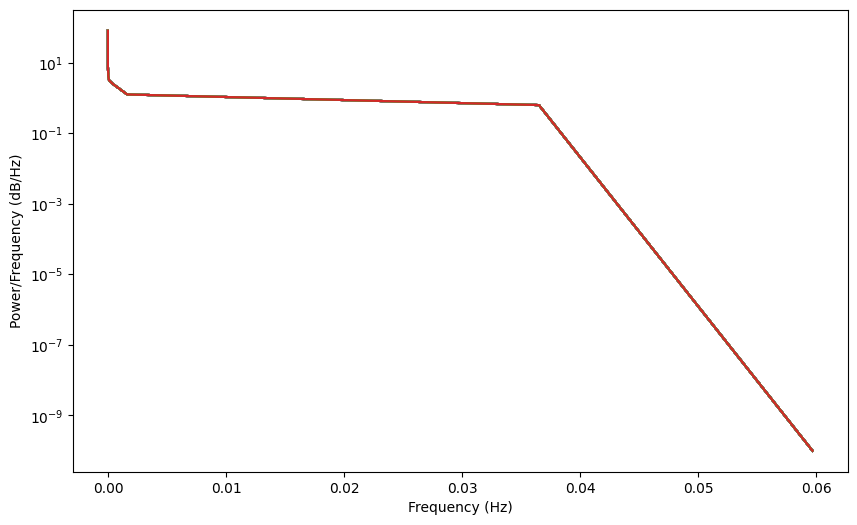

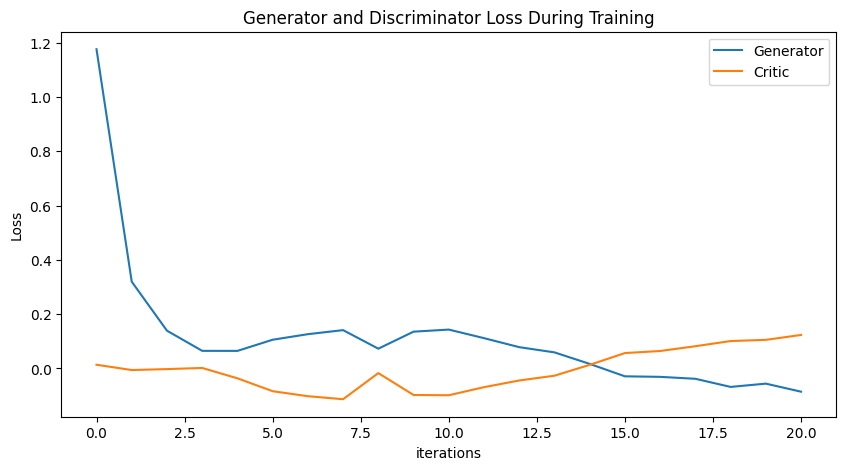

Epoch 30: Critic error ([1.1757979870198134, 0.319477265326286, 0.1389430877350568, 0.06465913293808404, 0.064459102834612, 0.10555812829934799, 0.12605127381406564, 0.14095589860337435, 0.07263318292315712, 0.13532834227763846, 0.1429700682435544, 0.11142557065433446, 0.07819845979885466, 0.059006937168429315, 0.01658835937177945, -0.02919521708459379, -0.031161248723638787, -0.038305065973364784, -0.06822495125154622, -0.05615216297209024, -0.08582565219550521, -0.07482079916081576, -0.08157847969453035, -0.08614790142110318, -0.11493035681432244, -0.1540209851739399, -0.1524654884442713, -0.19894652204016722, -0.2028784249357075, -0.19903160412962193, -0.2290662692411832]) Generator err ([0.01347041130065918, -0.006038880441337824, -0.002585703507065773, 0.0015928857028484344, -0.03651926666498184, -0.0840204581618309, -0.10241004824638367, -0.11356367915868759, -0.017291031777858734, -0.09794484078884125, -0.09893301874399185, -0.06911502033472061, -0.04453977942466736, -0.02694559

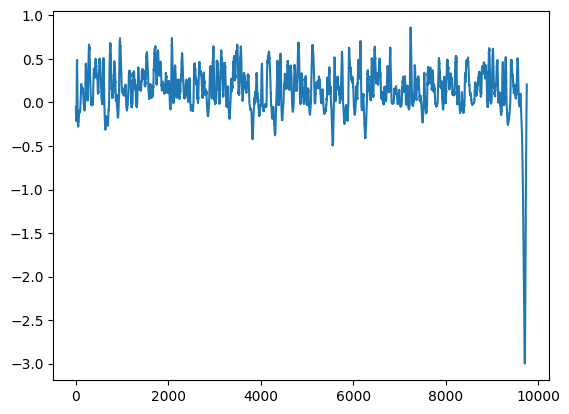

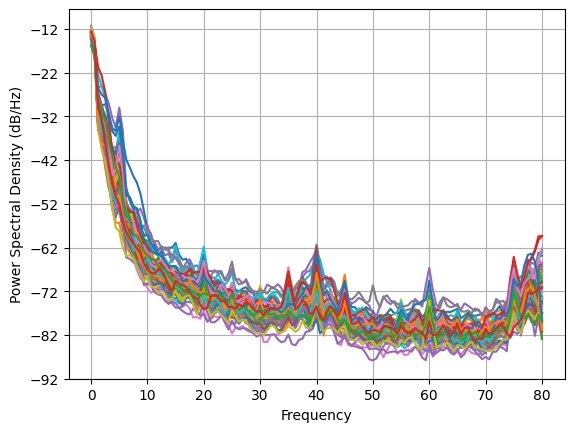

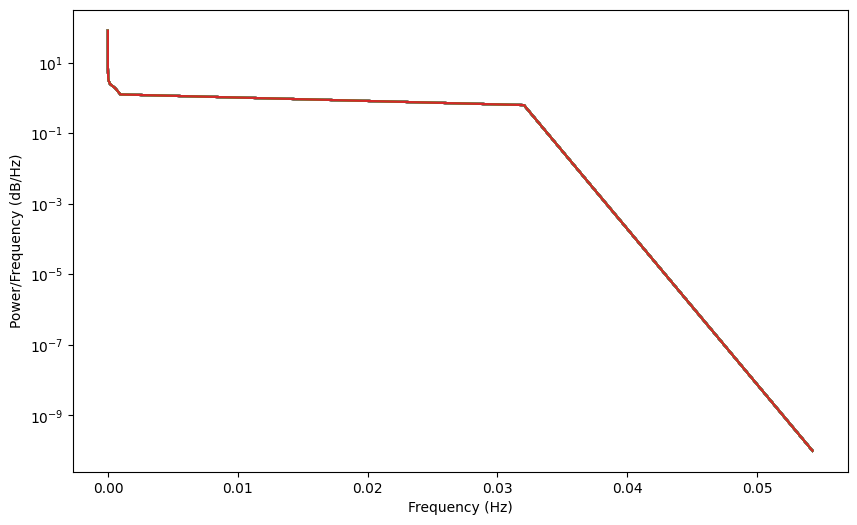

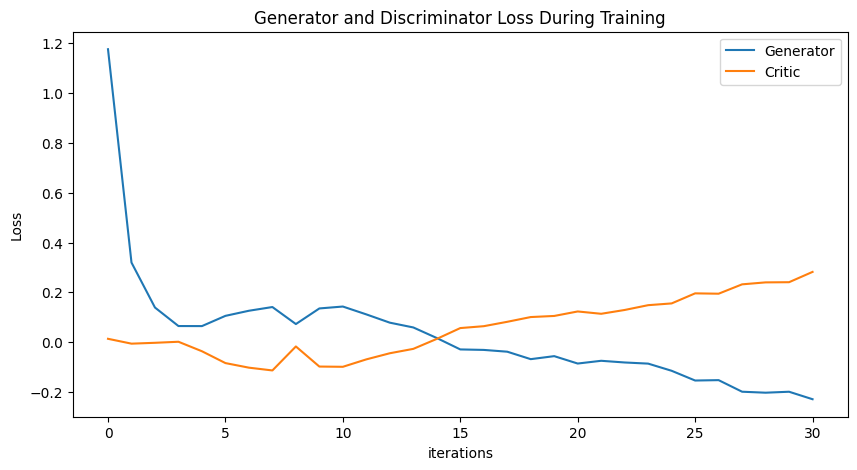

Epoch 40: Critic error ([1.1757979870198134, 0.319477265326286, 0.1389430877350568, 0.06465913293808404, 0.064459102834612, 0.10555812829934799, 0.12605127381406564, 0.14095589860337435, 0.07263318292315712, 0.13532834227763846, 0.1429700682435544, 0.11142557065433446, 0.07819845979885466, 0.059006937168429315, 0.01658835937177945, -0.02919521708459379, -0.031161248723638787, -0.038305065973364784, -0.06822495125154622, -0.05615216297209024, -0.08582565219550521, -0.07482079916081576, -0.08157847969453035, -0.08614790142110318, -0.11493035681432244, -0.1540209851739399, -0.1524654884442713, -0.19894652204016722, -0.2028784249357075, -0.19903160412962193, -0.2290662692411832, -0.26391235943088714, -0.27134258245993575, -0.31410296810547117, -0.3136724478285031, -0.3862318185685496, -0.4317216409280601, -0.5025407132393372, -0.5588359701809105, -0.5889737011980943, -0.5830178723171076]) Generator err ([0.01347041130065918, -0.006038880441337824, -0.002585703507065773, 0.00159288570284843

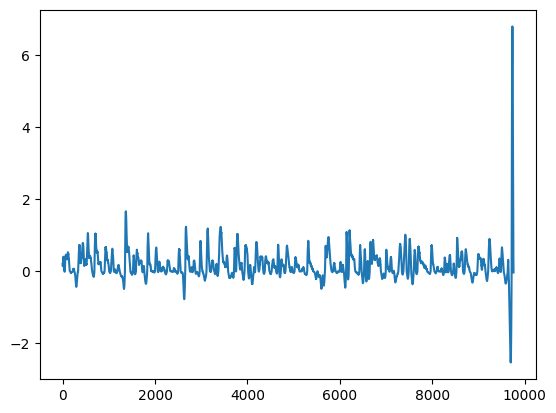

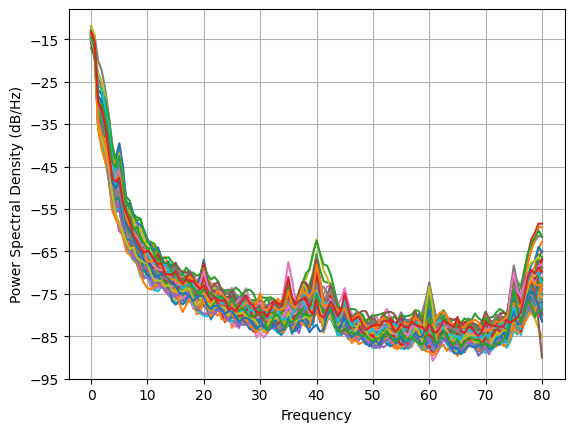

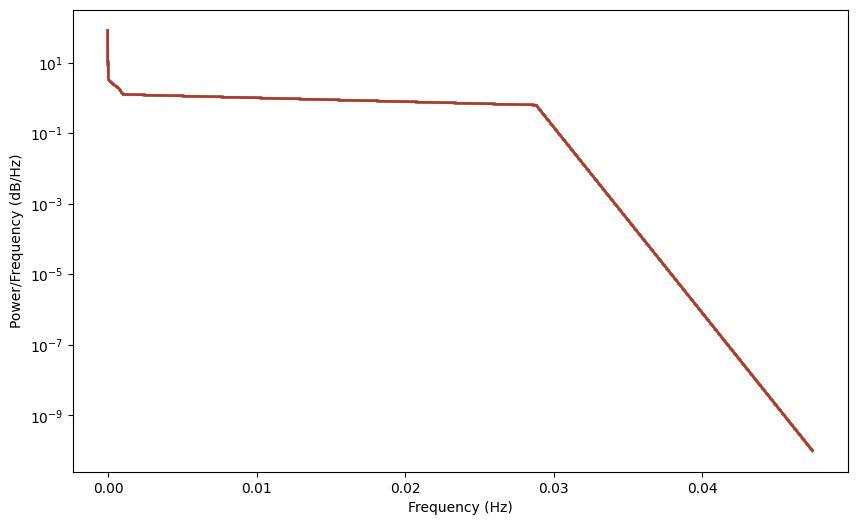

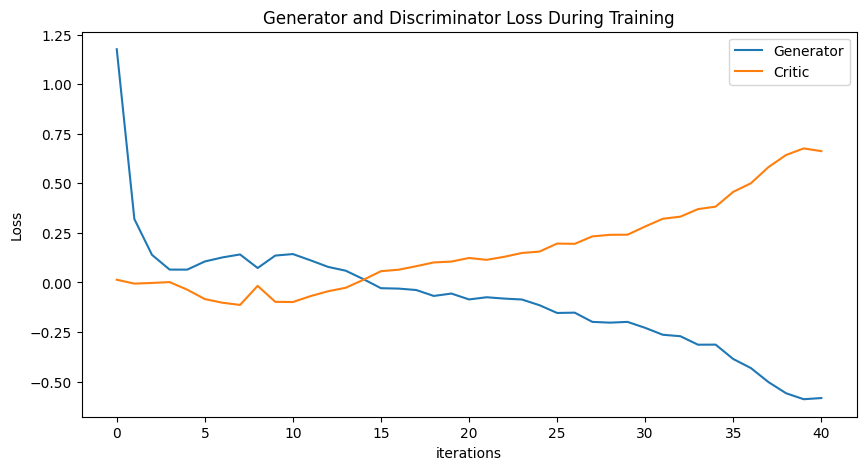

Epoch 50: Critic error ([1.1757979870198134, 0.319477265326286, 0.1389430877350568, 0.06465913293808404, 0.064459102834612, 0.10555812829934799, 0.12605127381406564, 0.14095589860337435, 0.07263318292315712, 0.13532834227763846, 0.1429700682435544, 0.11142557065433446, 0.07819845979885466, 0.059006937168429315, 0.01658835937177945, -0.02919521708459379, -0.031161248723638787, -0.038305065973364784, -0.06822495125154622, -0.05615216297209024, -0.08582565219550521, -0.07482079916081576, -0.08157847969453035, -0.08614790142110318, -0.11493035681432244, -0.1540209851739399, -0.1524654884442713, -0.19894652204016722, -0.2028784249357075, -0.19903160412962193, -0.2290662692411832, -0.26391235943088714, -0.27134258245993575, -0.31410296810547117, -0.3136724478285031, -0.3862318185685496, -0.4317216409280601, -0.5025407132393372, -0.5588359701809105, -0.5889737011980943, -0.5830178723171076, -0.6564969548407038, -0.6553808354742618, -0.6788793966833345, -0.7462808706532267, -0.7065922663220705

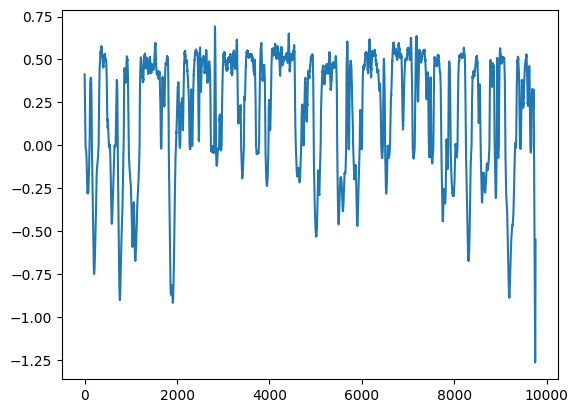

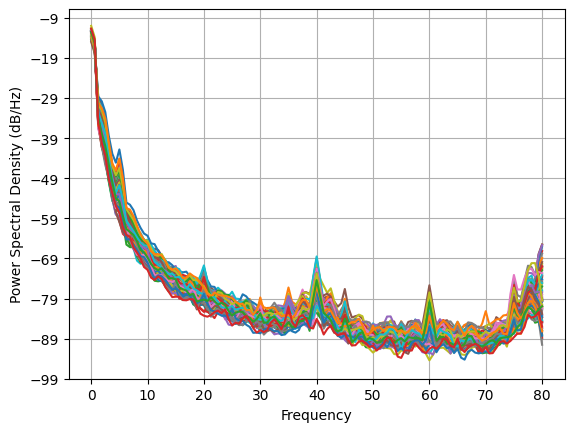

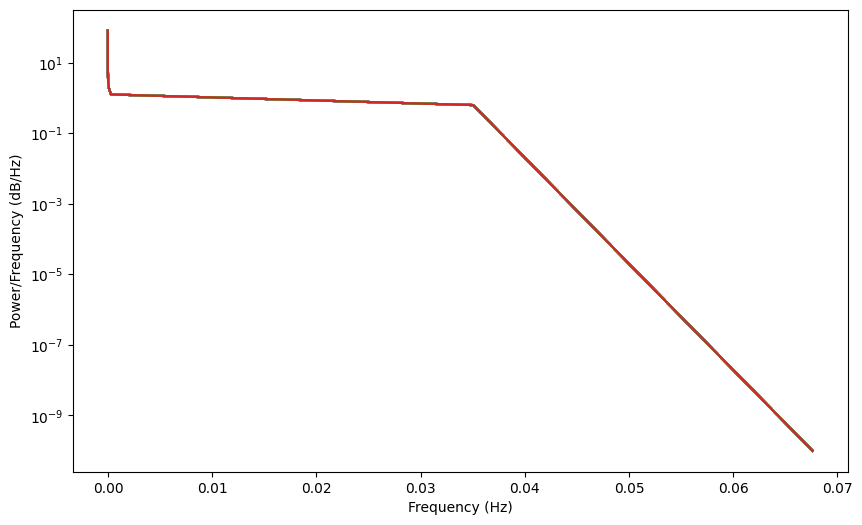

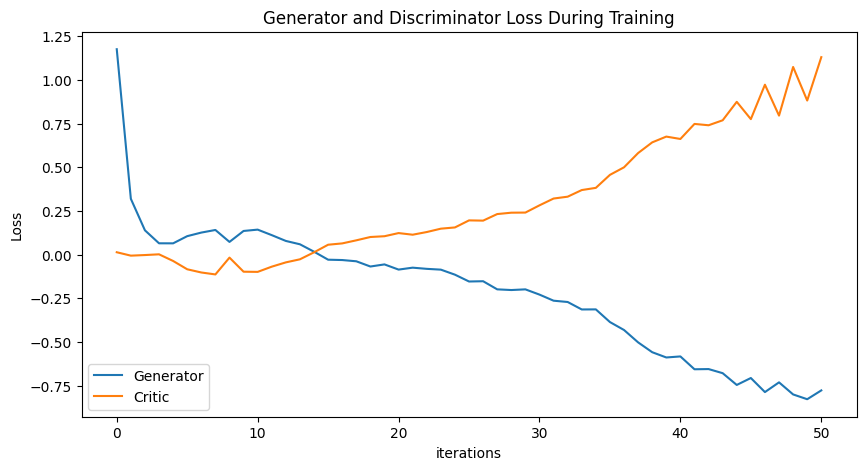

Epoch 60: Critic error ([1.1757979870198134, 0.319477265326286, 0.1389430877350568, 0.06465913293808404, 0.064459102834612, 0.10555812829934799, 0.12605127381406564, 0.14095589860337435, 0.07263318292315712, 0.13532834227763846, 0.1429700682435544, 0.11142557065433446, 0.07819845979885466, 0.059006937168429315, 0.01658835937177945, -0.02919521708459379, -0.031161248723638787, -0.038305065973364784, -0.06822495125154622, -0.05615216297209024, -0.08582565219550521, -0.07482079916081576, -0.08157847969453035, -0.08614790142110318, -0.11493035681432244, -0.1540209851739399, -0.1524654884442713, -0.19894652204016722, -0.2028784249357075, -0.19903160412962193, -0.2290662692411832, -0.26391235943088714, -0.27134258245993575, -0.31410296810547117, -0.3136724478285031, -0.3862318185685496, -0.4317216409280601, -0.5025407132393372, -0.5588359701809105, -0.5889737011980943, -0.5830178723171076, -0.6564969548407038, -0.6553808354742618, -0.6788793966833345, -0.7462808706532267, -0.7065922663220705

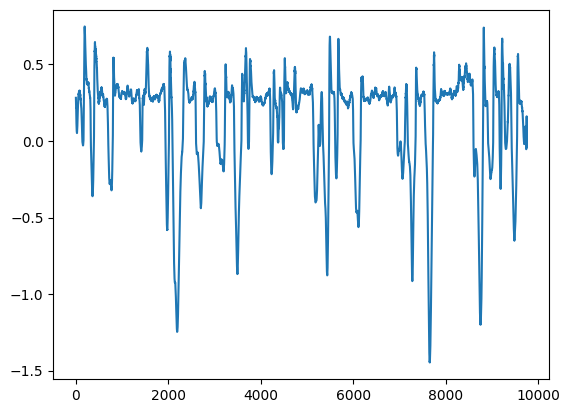

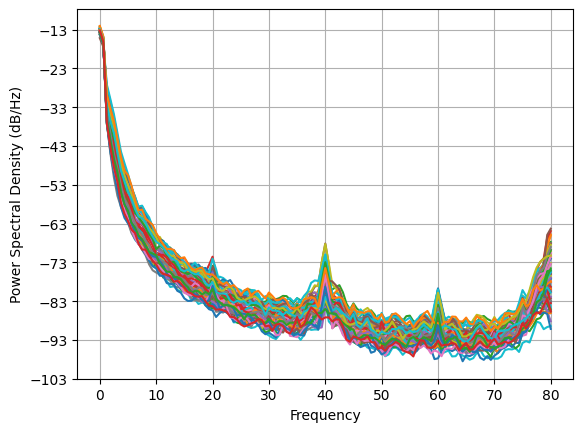

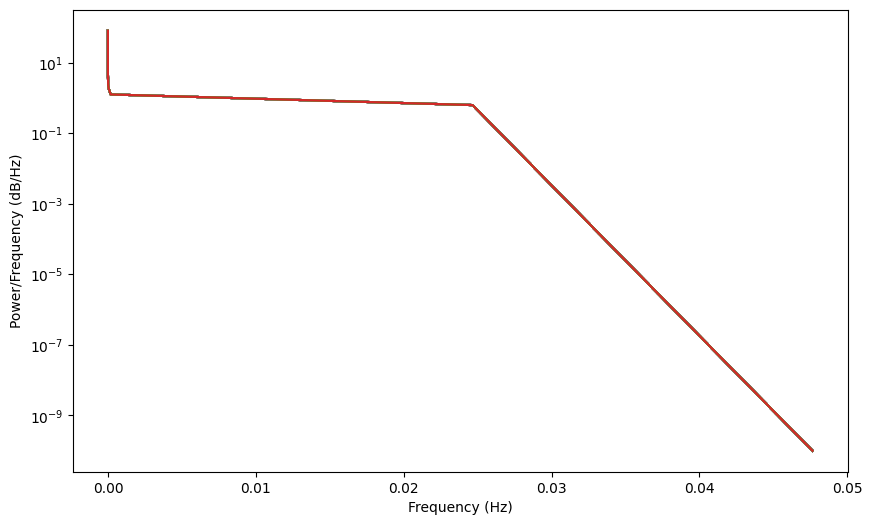

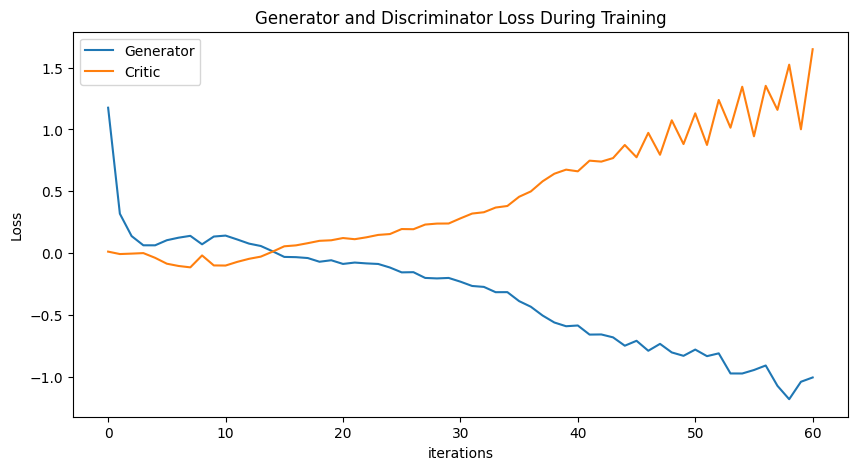

Epoch 70: Critic error ([1.1757979870198134, 0.319477265326286, 0.1389430877350568, 0.06465913293808404, 0.064459102834612, 0.10555812829934799, 0.12605127381406564, 0.14095589860337435, 0.07263318292315712, 0.13532834227763846, 0.1429700682435544, 0.11142557065433446, 0.07819845979885466, 0.059006937168429315, 0.01658835937177945, -0.02919521708459379, -0.031161248723638787, -0.038305065973364784, -0.06822495125154622, -0.05615216297209024, -0.08582565219550521, -0.07482079916081576, -0.08157847969453035, -0.08614790142110318, -0.11493035681432244, -0.1540209851739399, -0.1524654884442713, -0.19894652204016722, -0.2028784249357075, -0.19903160412962193, -0.2290662692411832, -0.26391235943088714, -0.27134258245993575, -0.31410296810547117, -0.3136724478285031, -0.3862318185685496, -0.4317216409280601, -0.5025407132393372, -0.5588359701809105, -0.5889737011980943, -0.5830178723171076, -0.6564969548407038, -0.6553808354742618, -0.6788793966833345, -0.7462808706532267, -0.7065922663220705

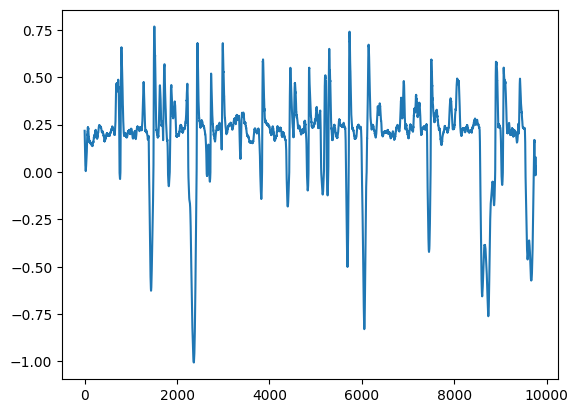

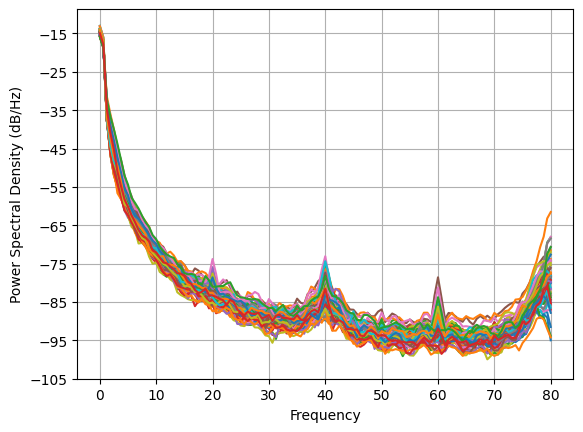

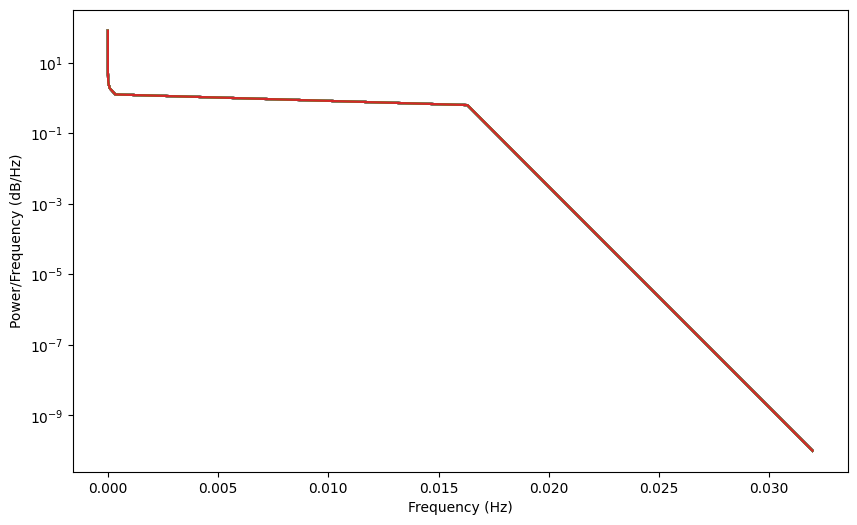

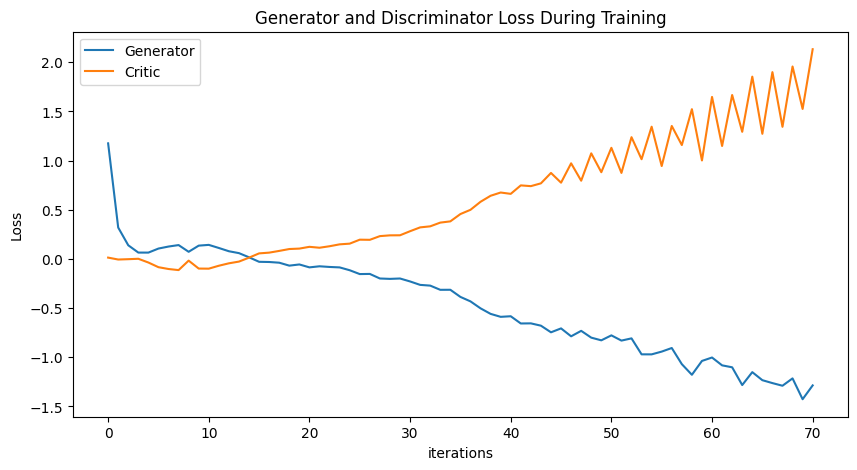

In [ ]:
NUM_EPOCHS = 80
PRINT_INTERVAL = 10
training_data = torch.tensor(np.load('training_closed.npy'))
BATCH_SIZE = np.shape(training_data)[0]

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(512, 512, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(512, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(512, 512, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(512, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(512, 512, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(512, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(512, 512, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(512, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(512, 512, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(512, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(512, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 512, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(512, 512, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(512, 512, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(512, 512, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(512, 512, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(512, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 512, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1)
            critic_fake = D(fake).reshape(-1)
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()
            critic_optimizer.zero_grad()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        gen_optimizer.zero_grad()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(generated_data, critic_err, gen_err)

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data_closed2, disc, gen = train()

torch.save(gen, 'gen_FINAL2_closed.pt')
torch.save(disc, 'disc_FINAL2_closed.pt')
np.save('complex-closed2.npy', generated_data_closed2.detach())
plot_everything(generated_data_closed2, gen_err, critic_err)

In [ ]:
generated_data_closed2 = None

In [ ]:
NUM_EPOCHS = 100
PRINT_INTERVAL = 5
training_data = torch.tensor(np.load('training_open.npy'))
BATCH_SIZE = np.shape(training_data)[0]

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(640, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(640, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 640, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(640, 640, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(640, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 640, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1)
            critic_fake = D(fake).reshape(-1)
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()
            critic_optimizer.zero_grad()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        gen_optimizer.zero_grad()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(generated_data, critic_err, gen_err)

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data_open2, disc, gen = train()

torch.save(gen, 'gen_FINAL2_open.pt')
torch.save(disc, 'disc_FINAL2_open.pt')
np.save('complex-open2.npy', generated_data_open2.detach())
plot_everything(generated_data_open2, gen_err, critic_err)

# inner channel size 64 * 11 or 64 * 12